# Documentation for Hydra Multi-Asset Verification Test
ACTION_LIST = [['test_add', 'test_q_for_r', 'test_r_for_r','test_r_for_q', 'test_remove']]



## Model Description

The methodology for the tests is to create two universes - one for Hydra and one for Uniswap - to subsequently be able to represent sequences of actions on each side. As the Hydra system is unique in its design and has no counterpart yet for approprate comparisons the role of the benchmark will be fulfilled by assembling several Uniswaps together in a way that everything that can be done in Hydra can be accordingly reproduced. This allows next to compare the implications on both systems and ultimately assess the quantitative and qualitative differences of results and impacts on the Hydra system and its agents. 

This approach necessitates the definition and specification of two models:
   - 1 Hydra Omnipool model with one instance that is defined in line with the [Hydra Mathematical Specification](https://hackmd.io/M7OeWimITKGVxBDHGQa6gQ?view)
   - 1 Uniswap model with several instances that each are responsible for a particular mechanism
        - which of 1 instance is used for liquidity provision in asset $R_i$: this is modeled as a Uniswap of $R_i$ and $Q$
        - which of 1 instance is used for liquidity provision in asset $R_j$: this is modeled as a Uniswap of $R_j$ and $Q$
        - which of 1 instance is used for swaps between assets $R_i$ and $R_j$: this is modeled as a Uniswap of $R_i$ and $R_j$
        
![](https://i.imgur.com/yb6Zh3T.png)
        
## Test cases

A variety of testcases can be explored with this model resulting from a combination of the following parameters
   
   - Event: Add Liquidity, Remove Liquidity, Swap Asset, Swap Asset for Base
   - Asset: $R_i$, $R_j$, $R_k$, $Q$
   - Multiple Action Type: Alternating, $i$ only, $j$ only
   - Composite Action Type: Alternating, Trade Bias
   - Enable Symmetric Liquidity: True, False
    
In addition to these settings also a fee structure can be imposed:

   - Fixed Fee

## Test agents

The model specifies a number of eight agents that each have their local balances, can interact with the system and are modeled to be responsible for **one action only**. This allows to track for each testcase how the balances will develop and to show independently which events will trigger changes to local and global states. Most importantly directly and indirectly affected variables can be easily identified.

Two dataframes of agents are initialized identically for both the Uniswap and the Hydra world and then work their way through on each side according to the testcase. Afterwards the effects on both sides can be compared.

![](https://i.imgur.com/r9IAJMr.png)



## Composite Action Tests

Besides being able to test all mechanisms individually also compositions of actions can be performed. This means selecting and combining two from the above testcases and letting the respective agents take the actions repeadetly. A composition action test therefore is defined as two actions which each can be a combination of *event* and *asset* selected from the list of testcases above, for example:
- Add liquidity in $R_i$ and Add liquidity in $R_j$
- Add liquidity in $R_i$ and Swap $R_i$ for $Q$
- Remove liquidity in $R_j$ and Swap $R_i$ for $Q$
- ...

In total there would be 28 composit pairs which can be derived from this decision tree:
selecting any one of the four primitive mechanisms of: **trade in/out** or **add/remove liquidity** of some given asset and then the subsequent action could be the three remaining mechanisms of the same asset or doing anyone of the four mechanisms in another asset.  

These basic combinations can be explored before further proceeding with
- trade sizes,
- trade frequencies,
- randomization,...



## Introduction to Uniswap
>Uniswap is an automated market maker for exchanging ERC20 tokens. Anyone can become a liquidity provider, and invest in the liquidity pool of an ERC20 token. This allows other users to trade that token for other tokens at an exchange rate based on their relative availibility. When a token trade is executed, a small fee is paid to the liquidity providers that enabled the transaction.
https://uniswap.io/

There are basically eight ways (_mechanisms_) in which an agent can interact with an instance of Uniswap (https://github.com/Uniswap/uniswap-v1/blob/master/contracts/uniswap_exchange.vy):
1. `addLiquidity`: deposit ETH and tokens in the liquidity pool; mint UNI tokens - "shares" of that Uniswap instance - in exchange;
1. `removeLiquidity`: burn UNI tokens; withdraw a proportional amount of ETH and tokens in exchange;
1. `ethToTokenInput`: user specifies an exact amount of ETH they send; receives corresponding amount of tokens
1. `ethToTokenOutput`: user sends some ETH and specifies an exact amount of tokens they want to buy; Uniswap refunds ETH sent in excess
1. `tokenToEthInput`: user specifies an exact amount of tokens they send; receives corresponding amount of ETH
1. `tokenToEthOutput`: user specifies an exact amount of ETH they want to buy; Uniswap takes the corresponding amount of tokens from the user account
1. `tokenToTokenInput`: user specifies an exact amount of "token A" they send; receives corresponding amount of "token B" (effectively a `tokenToEthInput` in instance A combined with a `ethToTokenInput` in instance B)
1. `tokenToTokenOutput`: user specifies an exact amount of "token B˜ they want to buy; Uniswap takes the corresponding amount of "token A" from the user account (effectively a `ethToTokenOutput` in instance B combined with a `tokenToEthOutput` in instance A)

## Limitations and simplifications of this model
* When triggering mechanisms, Uniswap users may include conditions they would like to apply to the transaction. For example, they could define a minimum amount of UNI tokens they wish to receive as a result of adding liquidity to the pool; or the maximum number of tokens they are willing to pay for the amount of ETH requested in a `tokenToEthOutput` operation; or a deadline after which the transaction should not be processed. **This simplified model does not account for this kind conditioning.**

* The `ethToTokenOutput`, `tokenToEthOutput` mechanisms are not implemented. **All swaps are treated as of the "input defined" type.**

* The `tokenToToken` mechanism are not implemented, as they are merely a `tokenToEth` in the context of a single Uniswap instance.

* **User _behavior_ has not been modeled**. User _actions_ are derived from the history of events of the Uniswap instance being analyzed.

## Introduction to Hydra
>Hydra is an automated market maker that generalizes the concept of Uniswap and Balancer to a) an arbitrary number of dimensions and b) a variant weight distaribution of assets in the pool that changes in accordance with action sequences in the pool. Anyone can become a liquidity provider, and invest in the 'Omnipool'. This allows other users to trade that token for other tokens at an exchange rate based on their relative availibility. When a token trade is executed, a small fee is paid to the liquidity providers that enabled the transaction.
https://hydradx.io/

There is a predefined set of (_mechanisms_) in which an agent can interact with an the Hydra Protocol :
1. `addLiquidity`: deposit a risk asset in the omnipool; mint HDX tokens - "shares" of this risk asset - in exchange;
1. `removeLiquidity`: burn HDX tokens; withdraw a proportional amount of the risk asset in exchange;
1. `tokenToTokenInput`: user specifies an exact amount of "token A" they send; receives corresponding amount of "token B" 
1. `tokenToTokenOutput`: user specifies an exact amount of "token B˜ they want to buy; Hydra takes the corresponding amount of "token A" from the user account 



## Model File structure

The folder **model** contains:

 - a file config.py: 

    This file configures the simulation experiments by setting the number of monte carlo runs, the number of timesteps for the simulation and the simulation parameters. It also aggregates the partial states and the initial state variables.
    
    The purpose of this file is to *configure and initialize* the experiment.
    
    
 - a file partial_state_update_block.py

    This file defines each partial state update block individually. This feature allows cadCAD to divide each simulation timestep into several 'blocks' where different state variables are mutated conditioned upon the policy input.
    
    In the current setting 
    - the first block maps the user action to the appropriate mechanism in the uniswap world
    - the second block maps the user action to the appropriate mechanism in the hydra world
    - the third block resolves the quantities of HDX and weights in the hydra world
    - the forth block calculates the metrics: the swap prices in the uniswap world and the pool prices in the hydra world

    This file corresponds to the system specification diagram, where each column is one partial state update block 
    
    The purpose of this file is to *define* the sequence and details of state updates for each simulation timestep. The relevant mechanisms are imported from the files in the **parts** folder
    
    
 - a file plot_utils.py

    This file defines all plot functions that can be called in the jupyter notebook to visualize the results. In general there are three types of plots:
    - plots related to the uniswap world (do not contain the word 'hydra')
    - plots related to the hydra world (contain the word 'hydra')
    - general plots applicable to both worlds (f.e Impermanent Loss)

    It also can be distinguished between plots related to global system variables and local agent variables:
    - global variables (do not contain the word 'agent')
    - local variables (contain the word 'agent')

    The purpose of this file is to *define* the way how particular properties can be plotted over time.
    

 - a file run.py

    This file *defines* the run and postprocessing methods and is used to execute the simulation run:
    - run() is used to execute the simulation and create a dataframe
    - postprocessing is used to extract relevant metrics from the simulation output in the dataframe

     The purpose of this file is to *execute* the simulation and *create* metrics.
     
     
 - a file state_variables.py

    This file *sets* the number of agents and *defines* the local (agent-level) state variables, *sets* the number of assets and *defines* the global (system-state) variables of the system, *computes* the prices of the assets and *defines* the initial state object
    - the agent states describe their holdings of assets that agents have contributed to the pool or still hold outside as well as their quantities of shares they received for their contribution
    - the global states describe the quantities of assets in the system
    - price variables are computed from the states both in the uniswap and hydra world
    - the initial state object consists of 
        - two agent dataframes, one for each world respectively
        - two sets of global variables, one for each world respectively
        - prices for each world (? is pool = prices ?)

    The purpose of this file is to *define* the global and local states of the system.
    
    
 - a file sys_params.py

    This file *contains* the system parameters and allows to select items from a list for them. Following parameters can be defined:
    - trade action type
    - liquidity action type
    - multiple asset action type
    - composite action type
    - liquidity add type (symmetry)

    In addition the following is set
    - initial values for assets 
    - hard coded fee value
    - choice of the system parameters from the list above
    

 - a folder **parts** which itself contains general files relevant for both instances, files related specifically to Uniswap and files related specifically to Hydra 
      - [action.py](model/parts/action.py)
       This is an action dictionary which drives the model. As there are no behavioral assumptions in the model yet, currently actions are prescribed actions in testing mode derived from events. However, action schema respects https://www.kaggle.com/markusbkoch/uniswap-ethdai-exchange as much as possible, allowing for future analysis against uniswap transaction datasets.
        This file contains a function called 'actionDecoder' which takes its inputs from the file sys_params.py and maps those encoded events to agent actions. At first an arbitrary action dictionary is defined which then is adapted according to the choices of system parameters. In particular relevant are the parameter definitions of the asset, the composite and whether there is a trade or liquidity event defined.
        
    - [uniswap.py](model/parts/uniswap.py)
     Reads in action output and directs the action to the appropriate Uniswap mechanism for each corresponding Uniswap instance. Currently there are two instances in place, namely the R_i<>Q pair and the R_j<>Q pair. Both instances have their respective requisite state variables: UNI_Qx, UNI_Rx, and UNI_Sx.

    - [utils.py](model/parts/utils.py)
    Computes the state update for each Uniswap state variable and outputs the updated global state variables.
        
     - [agent_utils.py](model/parts/agent_utils.py)
     Computes the corresponding agent local state for each Uniswap agent resolving their action and outputs the updates local state variables.

      -  [hydra.py](model/prts/hydra.py)
     Reads in action output and directs the action to the appropriate Hydra mechanism for each state variable: Q, Sq, and pool.
    
      - [hydra_utils.py](model/parts/hydra_utils.py)
     Computes the state update for each Hydra state variable

    -  [asset_utils.py](model/parts/asset_utils.py)
     Computes the state update for each Reserve Asset in a Hydra Omnipool

    -  [hydra_agent_utils_class.py](model/parts/hydra_agent_utils_class.py)
     Computes the corresponding agent local state for each Hydra agent resolving their action and outputs the updates local state variables.
     
     #### The interrelations between the files are shown here:
     
    ![](https://i.imgur.com/mNhfQE4.png)



# Testcase Definition

#### Simulation Settings
- There are 100 timesteps for each simulation run
- Each testcase has 100 MC runs with different randomized variables
- Block 1 randomizes starting liquidity balances (explained below in section 'Block 1')



#### Agent Activities - Action Sequence

There are two agents acting during the simulation. The trading agent performs "R-for-R" trades of equal size but varying direction over most simulation timesteps. The liquidity agent provides liquidity to the pool at timestep 10 and removes the liquidity from the pool at timestep 90.

##### Trading agent

- One Agent performs random "R-for-R" trades during the simulation. 
- The direction of the trade is a random coin flip for each timestep.
- The size of the trade is fixed at $1000$ for each timestep.
- The agent does not act at timestep 10 nor timestep 90.

##### Liquidity agent

- One Agent provides liquidity in Asset "i" to the pool 
- He provides the liquidity at timestep 10
- He removes the liquidity at timestep 90
- He does not act at other timesteps

#### Block 1:

| #   |   Run   | a  | $\mu_i$ |          $\sigma_i$          | $\mu_j$ |          $\sigma_j$          | $\mu$ | $\sigma$ | Total runs         |
| --- |:-------:|:-------:|:-------:|:----------------------------:|:-------:|:----------------------------:| ----- | -------- | ------------------ |
| 1   | 001-100 |   0.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 2   | 101-200 |   0.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |
| 3   | 201-300 |    1    |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 4   | 301-400 |    1    |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$  | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |
| 5   | 401-500 |   1.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 6   | 501-600 |   1.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |

All tests in block 1 are performed as 100 **MonteCarlo Experiments** with the following randomization:
- The initial balances of the liquidity pools are drawn randomly for each MC run from the same lognormal distribution with $\mu_i$ and $\mu_j$ fixed at $100000$
    - The underlying mean for the lognormal liquidity draw is $\log{100000}$
    - The underlying standard deviation for the lognormal liquidity draw is $\sqrt{\log{1 + \frac{2000^2}{100000^2}}}$
- The action sequence of the agents is randomized in that sense that:
    - For each individual MC run the sequence is identical for the Uniswap and Hydra side of the model. For each timestep of the simulation exactly the same event takes place on both sides.
    - For each individual MC run the trading directions are randomized for each timestep. Therefore the event sequence for each run will be different.
    - For all MC runs the trading amount is always equal to $1000$




# Testcase in this notebook


This notebook documents the results of the following experiment:
- Settings from Block 1 as outlined above
- Testcases **2**, **4** and **6**
- Sweep over three values for $a \in \{0.5, 1, 1.5 \}$ with a fixed $\mu$-to-$\sigma$-ratio of $50$.

The experiment result dataframe is saved into a pickle file and analyzed throughout this notebook.

## Run Model

The following command lines import all packages, experiments and run the model 

This is the execution of cadcad. This writes the config object, does the execution and returns the rdf - which is a data object that shows the rows and columns of results in a dataframe

Here is one additional option as well. The postprocessing causes the index of the results to be every forth because of the cadcad architecture where the partial state updates are the substeps. With this option selected we see only the end of each timestep - the last substep. Therefore only final results are shown. To get a line for each substep the postprocessing needs to be deactivated. 

In [1]:
from model.config_wrapper import ConfigWrapper

from model import run_wrapper
from cadCAD import configs

# parametric_experiment = ConfigWrapper()
# get_keys = parametric_experiment.get_config()
# get_keys[0]['M']
# parametric_experiment.get_config()

running file: config_wrapper.py
end of file: config_wrapper.py
running file: run_wrapper.py
end of file: run_wrapper.py


In [2]:
# import model as model


In [3]:
# parametric_experiment = ConfigWrapper(model)


In [4]:
# del configs[:]

# parametric_experiment.append()

In [5]:
# get_keys = parametric_experiment.get_config()
# get_keys[0]['M']

In [6]:
# Dependences
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Experiments
from model import run
from model.parts.utils import *
from model.plot_utils import *

pd.options.display.float_format = '{:.2f}'.format

%matplotlib inline

# df = run.run()
# rdf = run.postprocessing(df)
# rdf = df # debugging substeps
# pd.set_option("mode.chained_assignment", None)


running file: run.py
running file: state_variables.py
running file: initialize_liquidity.py
end of file: initialize_liquidity.py
running file: asset_utils.py
end of file: asset_utils.py
end of file: state_variables.py
running file: partial_state_update_block.py
end of file: action_list.py
end of file: partial_state_update_block.py
running file: sim_setup.py
end of file: sim_setup.py
[100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000.
 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000.
 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000.
 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000.
 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000.
 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000.
 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000.
 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000.
 100000. 100000. 100000. 10000

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.As

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.As

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.As

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.As

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.As

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.As

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.As

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.

config_param a value =============  0.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_s

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.

In [7]:
(data, tensor_field, sessions) = run_wrapper.run(drop_midsteps=True)

experiments = data



                  ___________    ____
  ________ __ ___/ / ____/   |  / __ \
 / ___/ __` / __  / /   / /| | / / / /
/ /__/ /_/ / /_/ / /___/ ___ |/ /_/ /
\___/\__,_/\__,_/\____/_/  |_/_____/
by cadCAD

Execution Mode: local_proc
Configuration Count: 100
Dimensions of the first simulation: (Timesteps, Params, Runs, Vars) = (100, 16, 3, 22)
Execution Method: local_simulations
SimIDs   : [0, 0, 0, 1, 1, 1, 2, 2, 2, 3, 3, 3, 4, 4, 4, 5, 5, 5, 6, 6, 6, 7, 7, 7, 8, 8, 8, 9, 9, 9, 10, 10, 10, 11, 11, 11, 12, 12, 12, 13, 13, 13, 14, 14, 14, 15, 15, 15, 16, 16, 16, 17, 17, 17, 18, 18, 18, 19, 19, 19, 20, 20, 20, 21, 21, 21, 22, 22, 22, 23, 23, 23, 24, 24, 24, 25, 25, 25, 26, 26, 26, 27, 27, 27, 28, 28, 28, 29, 29, 29, 30, 30, 30, 31, 31, 31, 32, 32, 32, 33, 33, 33, 34, 34, 34, 35, 35, 35, 36, 36, 36, 37, 37, 37, 38, 38, 38, 39, 39, 39, 40, 40, 40, 41, 41, 41, 42, 42, 42, 43, 43, 43, 44, 44, 44, 45, 45, 45, 46, 46, 46, 47, 47, 47, 48, 48, 48, 49, 49, 49, 50, 50, 50, 51, 51, 51, 52, 52, 52, 53, 

delta_Ri =  -13802.767164657616
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1568 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 13802.767164657616 from reserve 100000.00000000001
**********
H_agent r out = q_sold = 
   882
758
H_chosen_agentq_sold = H_chosen_agent   882
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 90594.17 110000.00 136456.00 170000.00 150000.00 0.00 98930.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 80945.64 110000.00 137743.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
 109297.05215419501q_sold = delta_Ri =  -6626.866321013816
H_agent r out =  90594.1715773951
**********
Q ADDED INTO POOL: 843 to existing amount 23544.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6626.866321013

H_agent r out = H_chosen_agent  138964.15301254345
**********
Q ADDED INTO POOL: 1203 to existing amount 25084
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7390.1026824915225 from reserve 81035.84698745658
**********
H_chosen_agent delta_Ri =      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129353.43 110000.00 131149.00 170000.00 150000.00 0.00 153240.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   2062101441.66757260046   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138630.94 110000.00 131628.00 170000.00 150000.00 0.00 139740.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  2803.674894922829
H_agent r out =  138630.93557777608
**********
Q ADDED INTO POOL: 758 to existing amount 28372
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2803.674894922829 from reserve 61369.06442222395
**********

-3555.439206988465
H_chosen_a

POOL RESERVE ONE REMOVING ASSET i in amount 5679.687676235604 from reserve 114553.57802058719
**********
q_sold =  1374

 H_chosen_agent586
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 75349.60 110000.00 131274.00 170000.00 150000.00 0.00 84192.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = 
delta_Ri =  -7562.827615195566
H_agent r out =  75349.6015076085
**********
Q ADDED INTO POOL: 1407 to existing amount 37498.44188123881
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7562.827615195566 from reserve 125349.60150760852
**********
 -2708.295360231751
H_agent r out =  H_chosen_agentH_agent r out =   163664.19975246742
**********
Q ADDED INTO POOL: 754 to existing amount 42055.418792313925
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2353.1471965854576 from reserve 56335.80024753258
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0

588927   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137932.53 110000.00 126707.00 170000.00 150000.00 0.00 163577.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57479.36 110000.00 125611.00 170000.00 150000.00 0.00 76363.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
**********
H_chosen_agent
delta_Ri =  -3246.5068543035677
H_agent r out = q_sold =  
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40430.98 110000.00 118217.00 170000.00 150000.00 0.00 72346.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
Q ADDED INTO POOL: 1396 to existing amount 55426.638642829
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2884.30157200316 from reserve 85291.40661598682
********** H_chosen_agentdelta_Ri = 76363.00329892422
**********
Q ADDED INTO POOL: 

1092delta_Ri = **********
delta_Ri = **********
POOL RESERVE ONE REMOVING ASSET i in amount 2243.5315984937874 from reserve 79344.21321031752
**********
 
 2978.650228179012
H_agent r out =  165178.12424206658
**********
Q ADDED INTO POOL: 1437 to existing amount 57322.523657432015
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2978.650228179012 from reserve 84821.87575793345
**********
delta_Ri =  1791.894384164736
H_agent r out =  157136.89929462192
**********
Q ADDED INTO POOL: 617 to existing amount 54019.418792313925
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1791.894384164736 from reserve 92863.10070537808
**********
 
5002.631602168616
H_agent r out =  169437.85743744802
**********
Q ADDED INTO POOL: 2077 to existing amount 46441.4541803593
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5002.631602168616 from reserve 50562.142562552035
**********
q_sold =  738

-4722.661380307623q_sold = q_sold = delta_Ri =  H_chosen_a

 H_chosen_agent 1058    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42904.63 110000.00 114886.00 170000.00 150000.00 0.00 61226.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold = -3081.0180585963861776

delta_Ri =  -2809.5504209680958
H_agent r out =  42904.62855670097
**********
Q ADDED INTO POOL: 1034 to existing amount 57154.151040897224
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2809.5504209680958 from reserve 92904.62855670099
**********
 626

q_sold =  
H_chosen_agent1590
 2031
H_agent r out = H_chosen_agentH_chosen_agent  H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149267.09 110000.00 115690.00 170000.00 150000.00 0.00 181916.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169531.42 110000.00 112531.00 170000.00 150000.00 

     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177178.27 110000.00 105786.00 170000.00 150000.00 0.00 176076.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   402
delta_Ri =  985.1429745610407
H_agent r out =  176076.64487428791
**********
Q ADDED INTO POOL: 508 to existing amount 68518.52365743202
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 985.1429745610407 from reserve 43923.355125712114
**********
 delta_Ri = H_chosen_agentq_sold =  1411.036001499901
H_agent r out =  173989.53012773156
**********
Q ADDED INTO POOL: 724 to existing amount 62725.418792313925
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1411.036001499901 from reserve 76010.46987226843
**********
 1018
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157592.73 110000.00 109488.00 170000.00 150000.00 0.00 186806.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  947
  

H_chosen_agentq_sold = q_sold =  
**********
Q ADDED INTO POOL: 570 to existing amount 67680.41879231393
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 852.8443881538223 from reserve 38608.28987408188
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13068.48 110000.00 95937.00 170000.00 150000.00 0.00 57324.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 

delta_Ri =  -1734.6911744570918
H_agent r out =  57324.4199781108
**********
Q ADDED INTO POOL: 1270 to existing amount 75997.27264022929
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1734.6911744570918 from reserve 37324.419978110804
**********
 675
 H_chosen_agent 563 q_sold = H_chosen_agent
301   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 182430.56 110000.00 100679.00 170000.00 150000.00 0.00 178921.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
 19

q_sold =  1265

H_chosen_agent

     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9811.62 110000.00 89968.00 170000.00 150000.00 0.00 53168.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = **********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31011.34 110000.00 101468.00 170000.00 150000.00 0.00 50068.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  H_chosen_agent H_chosen_agent 1721

  q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 165406.75 110000.00 99953.00 170000.00 150000.00 0.00 193067.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -2881.027325671679
delta_Ri =  3541.1389728537747
H_agent r out =  165406.75094637202
**********
Q ADDED INTO POOL: 1418 to existing amount 69093.4541803593
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3541.1389728537747 from reserve 8

0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent
delta_Ri =  -69.52452662029067
H_agent r out = 
   194599.4831874251
**********
Q ADDED INTO POOL: -105 to existing amount 74268.4541803593
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount -69.52452662029067 from reserve 25400.516812574897
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19708.80 110000.00 100173.00 170000.00 150000.00 0.00 53996.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1758.428434910507
H_agent r out =  53996.447001690554
**********
Q ADDED INTO POOL: 1572 to existing amount 68599.4418812388
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1758.428434910507 from reserve 33996.44700169058
**********
q_sold = 
H_chosen_agent q_sold =  1317**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20490.70 110000.00 94948.00 170000.00 150000.00 0.00 51345.8

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17703.28 110000.00 94109.00 170000.00 150000.00 0.00 49056.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = **********192536.949473719H_chosen_agent
delta_Ri =  -370.3327056661739
H_agent r out =  49056.72122746042
**********
Q ADDED INTO POOL: 438 to existing amount 74663.4418812388
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 370.3327056661739 from reserve 29056.721227460446
**********
q_sold = 
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4156.77 110000.00 81102.00 170000.00 150000.00 0.00 49724.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16036.84 110000.00 88997.00 170000.00 150000.00 0.00 48919.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 
1112H_chosen_agent 605
1241
   m  r_i_

H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 174683.20 110000.00 88115.00 170000.00 150000.00 0.00 197889.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent984
delta_Ri =  2019.77057593796
H_agent r out =  174683.19660714126

**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10911.93 110000.00 84303.00 170000.00 150000.00 0.00 48786.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 

delta_Ri =  -1125.4000979366876
H_agent r out =  10911.927074265686
**********
Q ADDED INTO POOL: 1100 to existing amount 92252.65352625152
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1125.4000979366876 from reserve 60911.92707426569
**********
q_sold = H_chosen_agentq_sold =  H_chosen_agent   928
1054
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12739.66 110000.00 83507.00 17000

delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180149.29 110000.00 84831.00 170000.00 150000.00 0.00 198106.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    q_sold = q_sold = 745.4963730470649
H_agent r out =  191462.01373350192
**********
Q ADDED INTO POOL: 908 to existing amount 94525.52365743202
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 745.4963730470649 from reserve 28537.986266498112
**********

296 1463

H_chosen_agentdelta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7373.09 110000.00 79643.00 170000.00 150000.00 0.00 47895.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00     560.8022111800583
H_agent r out =  198106.2153510712
**********
Q ADDED INTO POOL: 1164 to existing amount 84215.4541803593
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 560.8022111800583 from reserve 21893.784648928788
**********

delta_

0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7402.12 110000.00 76179.00 170000.00 150000.00 0.00 43036.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181723.67 110000.00 82070.00 170000.00 150000.00 0.00 198984.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 

delta_Ri =  488.39612658281163
H_agent r out =  198984.53826670707
**********
Q ADDED INTO POOL: 1098 to existing amount 86976.4541803593
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 488.39612658281163 from reserve 21015.461733292927
**********
 15081833q_sold = 587.0830797851443
H_agent r out =  197973.47617810706
**********
Q ADDED INTO POOL: 1205 to existing amount 93600.41879231393
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 587.0830797851443 from reserve 22026.523821892933
**********




q_sold =  719
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1464.92 110000.00 68381.00 170000.00 150000.00 0.00 41011.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -317.65254874807835
H_agent r out =  41011.20603151119
**********
Q ADDED INTO POOL: 719 to existing amount 100391.4418812388
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 317.65254874807835 from reserve 21011.206031511214
**********
q_sold =  1317
q_sold =  1317
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1464.92 110000.00 67662.00 170000.00 150000.00 0.00 40693.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

192329.0649130993**********
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 905.4945142908776 from reserve 23758.012655023642
**********


**********
q_sold =  1311
 42652.89569873417
**********
Q ADDED INTO POOL: 1237 to e

1025.5581305986482
 H_agent r out = H_chosen_agentH_chosen_agentH_chosen_agent q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   720.54 110000.00 62279.00 170000.00 150000.00 0.00 38865.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3897.37 110000.00 69113.00 170000.00 150000.00 0.00 41201.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196603.69 110000.00 69823.00 170000.00 150000.00 0.00 198729.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 187760.96824634264    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6895.70 110000.00 55934.00 170000.00 150000.00 0.00 42581.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  1409.2030366870943
H_agent r out =  196

 -8014.23532446801   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1481.42 110000.00 64899.00 170000.00 150000.00 0.00 40500.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -318.0684425477245   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200634.55 110000.00 63877.00 170000.00 150000.00 0.00 199415.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  463.0534846710966
H_agent r out =  199415.8532024324
**********
Q ADDED INTO POOL: 1084 to existing amount 106395.41879231393



**********
**********
Q ADDED INTO POOL: 1338 to existing amount 120398.27264022929
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 740.7000040931295 from reserve 41985.764675531995
**********

q_sold = H_agent r out =  38865.46105579988
**********
Q ADDED INTO POOL: 894 to existing amount 112179.4418812388
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 318.06844


delta_Ri =  2131.441791382694
H_agent r out =  198162.90368311058
**********
Q ADDED INTO POOL: 2264 to existing amount 103449.4541803593
**********
**********
POOL REMOVE LIQUIDITY Timestep ===  q_sold = q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 2131.441791382694 from reserve 51837.096316889474delta_Ri =  1595
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5350.81 110000.00 51548.00 170000.00 150000.00 0.00 37716.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00   992   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -195.31 110000.00 58777.00 170000.00 150000.00 0.00 38832.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
90
H_chosen_agent
 
delta_Ri =  -268.5804115566903
H_agent r out =  38832.831287672634
**********
Q ADDED INTO POOL: 735 to existing amount 113263.15104089722
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 268.5804115566

0 180000.00 160000.00   1098

POOL REMOVE LIQUIDITY Timestep === H_chosen_agent 90 delta W  24295.289355948018 delta S  5097
POOL REMOVE LIQUIDITY share fraction of pool = 0.19523000777434293
POOL REMOVE LIQUIDITY share fraction of reserve = 0.38125542788160255
POOL REMOVE LIQUIDITY weight fraction of pool = 0.38125542788160255
delta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200294.35 110000.00 59271.00 170000.00 150000.00 0.00 202013.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    1537

q_sold = 155097.0-927.2786195146263 1067
H_chosen_agent
H_agent r out =  -2238.4341160652048
**********
Q ADDED INTO POOL: 1304 to existing amount 98196.73643256392
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 927.2786195146263 from reserve 31525.361191819185
**********
q_sold = delta_Ri = H_chosen_agent
  650
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5357.64 110000.00

0 130000.00 180000.00 160000.00  Q ADDED INTO POOL: 1924 to existing amount 97715.67923901322H_chosen_agent
1322delta_Ri =  806.8115606404261
H_agent r out =  202085.3217556288
**********
Q ADDED INTO POOL: 1229 to existing amount 104761.66982808059
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 806.8115606404261 from reserve 32772.492921248486
**********


q_sold =  H_chosen_agentq_sold =  1355
 H_chosen_agent**********H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -12342.99 110000.00 36065.00 170000.00 150000.00 0.00 38564.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   
delta_Ri =  -479.2575889468937
H_agent r out =  -12342.994307888446
**********
Q ADDED INTO POOL: 1099 to existing amount 112094.10077210798
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 479.2575889468937 from reserve 26317.05156514569
**********
1721
   m  r_i_out    r_i_in        h       q_i       s_i  s_

 H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7540.35 110000.00 37864.00 170000.00 150000.00 0.00 34896.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 114500.25 110000.00 138340.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =  -9189.903189179362
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9189.903189179362 from reserve 100000.00000000001
**********
-8430.91688459341700   m   r_i_out    r_i_in         h       q_i     

10406.68700530144   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 75517.09 110000.00 136793.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -11925.867788669831
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1324 to existing amount 23207.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 11925.867788669831 from reserve 100000.00000000001
**********
 
 q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 122372.10 110000.00 134776.00 170000.00 150000.00 0.00 139934.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agentH_agent r out = H_chosen_agent
 759
delta_Ri =  9786.143917379333
H_agent r out =  122372.09580395647
**********
Q ADDED INTO POOL: 1787 to existing amount 25224
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9786.143917379333 from reserve 77627.90419604

0 130000.00 180000.00 160000.00    
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155413.63 110000.00 125681.00 170000.00 150000.00 0.00 139934.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
754delta_Ri = 
delta_Ri =  6370.923817197128
H_agent r out =  139934.41998189053
**********
Q ADDED INTO POOL: 1039 to existing amount 53651.28777991959
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6370.923817197128 from reserve 80065.5800181095
**********
H_chosen_agentq_sold =   786

-1621.70065321352
H_agent r out =  67831.27982226436
**********
Q ADDED INTO POOL: 359 to existing amount 27106.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1621.70065321352 from reserve 67831.27982226438
**********
 H_chosen_agent 977
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 83751.90 110000.00 135015.00 170000.00 150000.00 0.00 95111.21 130000.00   

        q

0 180000.00 160000.00  H_chosen_agent  
delta_Ri =  -6046.63576078236
H_agent r out =  68801.98446063741
**********
Q ADDED INTO POOL: 1183 to existing amount 39652.043459598564
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6046.63576078236 from reserve 118801.98446063742
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137174.69 110000.00 126286.00 170000.00 150000.00 0.00 165033.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent 
delta_Ri =  4161.890970402003
H_agent r out =  165033.61248333813
**********
Q ADDED INTO POOL: 1436 to existing amount 44842.198591819906
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4161.890970402003 from reserve 54966.387516661904
**********
  1076   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56175.97 110000.00 128537.00 170000.00 150000.00 0.00 91346.96 130000.00   

        q_j       s_j 

q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 142936.05 110000.00 119800.00 170000.00 150000.00 0.00 177294.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169087.73 110000.00 113976.00 170000.00 150000.00 0.00 162742.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     
delta_Ri =  1883.7841917800627
H_agent r out =  162742.7573683675
**********
Q ADDED INTO POOL: 577 to existing amount 65356.28777991959
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1883.7841917800627 from reserve 57257.24263163252
**********


1505
H_chosen_agent1822q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49411.81 110000.00 121148.00 170000.00 150000.00 0.00 70935.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167815.26 110000.00 110995.00 170000.00 150000.00 0.00 175399.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40668.94 110000.00 118315.00 170000.00 150000.00 0.00 71135.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent q_sold = 
q_sold = delta_Ri =  -1167.697581705141
H_agent r out =  35693.61515741255
**********
Q ADDED INTO POOL: 506 to existing amount 58592.99131756844
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1167.697581705141 from reserve 85693.61515741257
**********

-1515.690490424791
H_agent r out = delta_Ri =  1680.5475763714705
H_agent r out = delta_Ri =  -2795.9091349130813
H_agent r out =  40668.94393247476
**********
Q ADDED INTO POOL: 1053 to existing amount 52488.11753794175
**********
**********
POOL RESERVE ONE REMOVING ASSET i 


delta_Ri =  2389.7395313507254
H_agent r out = -3076.574736228071 37110.66665307661
**********
Q ADDED INTO POOL: 583 to existing amount 55061.11753794175
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1449.401862618977 from reserve 87110.6666530766
**********
q_sold =  927
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174257.32 110000.00 104970.00 170000.00 150000.00 0.00 179899.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1490.9452339325271
H_agent r out =  179899.45799105274
**********
Q ADDED INTO POOL: 927 to existing amount 70608.0134241698
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1490.9452339325271 from reserve 40100.54200894723
**********
q_sold =  2106
q_sold =  2106
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174257.32 110000.00 104043.00 170000.00 150000.00 0.00 181390.40   

     r_j_in       q

q_sold =   1280
delta_Ri =  -1285.3634956708347
H_agent r out =  64786.58945731081
**********
Q ADDED INTO POOL: 648 to existing amount 58549.11753794175
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1285.3634956708347 from reserve 44786.589457310845
**********

H_chosen_agent
 delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162993.05 110000.00 109059.00 170000.00 150000.00 0.00 184091.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1284.664422769899
H_agent r out =  180031.8270573354
**********
Q ADDED INTO POOL: 1039 to existing amount 78917.2877799196
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1284.664422769899 from reserve 69968.17294266459
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21553.65 110000.00 106511.00 170000.00 150000.00 0.00 59202.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delt


    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164370.78 110000.00 106462.00 170000.00 150000.00 0.00 186613.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -3698.41032642346
delta_Ri =  1603.7773644986275
H_agent r out =  186613.05335652732
**********
Q ADDED INTO POOL: 1460 to existing amount 64666.198591819906
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1603.7773644986275 from reserve 33386.94664347272
**********
H_agent r out = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21790.82 110000.00 106141.00 170000.00 150000.00 0.00 63865.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1407.7125181652502
H_agent r out =  21790.818260860906
**********
Q ADDED INTO POOL: 855 to existing amount 65223.6697266991
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1407.7125181652502 from reserve 71790.81826086089
***



Q ADDED INTO POOL: 1265 to existing amount 82329.0134241698H_chosen_agent**********
H_chosen_agent delta_Ri = delta_Ri = q_sold = H_chosen_agent 1219
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 170573.53 110000.00 98097.00 170000.00 150000.00 0.00 192049.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
 q_sold = **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1618.4550091145816 from reserve 67631.25055660236
**********
-1211.198504830722
H_agent r out =  1086
H_chosen_agent 
 17495.523833514893
**********
Q ADDED INTO POOL: 849 to existing amount 77487.99131756843
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1211.198504830722 from reserve 67495.52383351493
**********
delta_Ri =  2207.350112825958q_sold = 
H_agent r out =  170573.52901210354
**********
Q ADDED INTO POOL: 1081 to existing amount 73031.1985918199
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2207.35011

delta_Ri =  1471.3297134904838
H_agent r out =  187968.7506109442
**********
Q ADDED INTO POOL: 1520 to existing amount 92821.2877799196
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1471.3297134904838 from reserve 62031.2493890558
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186950.56 110000.00 87859.00 170000.00 150000.00 0.00 189802.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10792.34 110000.00 91387.00 170000.00 150000.00 0.00 48845.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = q_sold = 
q_sold = delta_Ri =  -2185.9517993935087
H_agent r out =  56046.645448995434
**********
Q ADDED INTO POOL: 1736 to existing amount 75129.6697266991
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2185.9517993935087 from reserve 36046.64544899545
**********

delta_Ri =  
 q_sol

H_chosen_agent1228q_sold = 
  1464
 H_chosen_agent  7858.223489371816   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16580.16 110000.00 87843.00 170000.00 150000.00 0.00 46501.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193039.28 110000.00 80169.00 170000.00 150000.00 0.00 191414.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182988.95 110000.00 89074.00 170000.00 150000.00 0.00 193592.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 1259.4163512708838**********
delta_Ri =  2989.895554966789   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10674.03 110000.00 86357.00 170000.00 150000.00 0.00 48889.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_

 **********
Q ADDED INTO POOL: 352 to existing amount 102355.2877799196
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 307.6634325354921 from reserve 58476.95807049713
**********
 1011
 44815.11798898918
**********
Q ADDED INTO POOL: 1332 to existing amount 90921.20232261054
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 839.4054562404826 from reserve 24815.11798898921
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13755.94 110000.00 89476.00 170000.00 150000.00 0.00 49080.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
 q_sold = 
delta_Ri =  -960.8782656781592
H_agent r out =  13755.937984150842
**********
Q ADDED INTO POOL: 736 to existing amount 81888.6697266991
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 960.8782656781592 from reserve 63755.937984150834
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in 

1864 814
q_sold = 
delta_Ri =  648.9270573428531
H_agent r out =  196023.4846576258
**********
Q ADDED INTO POOL: 1113 to existing amount 108307.0134241698
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 648.9270573428531 from reserve 23976.51534237415
**********
H_chosen_agent238q_sold = 

  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11149.08 110000.00 81271.00 170000.00 150000.00 0.00 44315.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent
 
delta_Ri =  -796.2847362663445
H_agent r out =  44315.710925508865
**********
Q ADDED INTO POOL: 1362 to existing amount 89532.11753794175
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 796.2847362663445 from reserve 24315.710925508905
**********
   725
291   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192819.89 110000.00 72482.00 170000.00 150000.00 0.00 194993.73   

     r_j_in   

H_chosen_agent  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   405.14 110000.00 72088.00 170000.00 150000.00 0.00 41877.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -844.4269449980925
H_agent r out =  405.1399634781012
**********
Q ADDED INTO POOL: 887 to existing amount 96094.04345959856
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 844.4269449980925 from reserve 50405.13996347809
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194008.24 110000.00 70852.00 170000.00 150000.00 0.00 195113.98   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6196.49 110000.00 75597.00 170000.00 150000.00 0.00 43519.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -955.0326540962348
H_agent r out =  4

 627
q_sold = 
 990
 1443
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203129.75 110000.00 58708.00 170000.00 150000.00 0.00 197075.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out =  43462.518760674524
**********
Q ADDED INTO POOL: 1184 to existing amount 98317.6697266991
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 649.8964985372598 from reserve 23462.51876067453
**********
H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193985.88 110000.00 67893.00 170000.00 150000.00 0.00 200269.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 
delta_Ri =  680.0599935604486
H_agent r out = q_sold = H_chosen_agent 
delta_Ri =  322.31940175527944
H_agent r out =  197075.37058576514
**********
Q ADDED INTO POOL: 599 to existing amount 116870.0134241698
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amou

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2798.52 110000.00 64289.00 170000.00 150000.00 0.00 39910.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1089.69461059306
H_agent r out =  -2798.515087105535
**********
Q ADDED INTO POOL: 1310 to existing amount 103893.04345959856
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1089.69461059306 from reserve 47201.484912894455
**********
42265.190135757875q_sold = delta_Ri = **********q_sold = H_chosen_agentH_chosen_agent 636
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4724.41 110000.00 63605.00 170000.00 150000.00 0.00 39252.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195412.10 110000.00 63069.00 170000.00 150000.00 0.00 201558.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
********

833q_sold = 14271515H_agent r out =  799

q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199078.01 110000.00 55264.00 170000.00 150000.00 0.00 199696.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1701.71 110000.00 61123.00 170000.00 150000.00 0.00 41304.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1243 


delta_Ri =  -645.8931387869787
H_agent r out =  41303.996150568535
**********
Q ADDED INTO POOL: 1427 to existing amount 110868.99131756843
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 645.8931387869787 from reserve 21303.996150568546
**********
delta_Ri = H_chosen_agentq_sold = H_chosen_agent199331.4169210106 799

**********
Q ADDED INTO POOL: 1460 to existing amount 126970.0134241698
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 631.8272889086927 from rese

q_sold = q_sold = 155187.0  805
 
817
 H_chosen_agent39820.72976289818-242.46762410252336    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198664.76 110000.00 49533.00 170000.00 150000.00 0.00 204526.78   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  POOL REMOVE LIQUIDITY Timestep === q_sold = q_sold =  90 delta W  23464.377416045303 delta S  5187
POOL REMOVE LIQUIDITY share fraction of pool = 0.1748137460928731
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2825875379066673
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2825875379066673
q_sold = 
 881
 817

 805
H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1149.83 110000.00 59923.00 170000.00 150000.00 0.00 38810.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  155187.0H_chosen_agent 38298.53942726872
**********
Q ADDED INTO POOL: 697 to existing amount 110822.04345959856
**********
*******


 934delta_Ri =  -706.7694791085976
H_agent r out =  39136.55134201413
**********
Q ADDED INTO POOL: 1950 to existing amount 115822.6697266991
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 706.7694791085976 from reserve 19136.551342014132
**********
-86
 delta_Ri = H_chosen_agent

  -316.14141346306826
H_agent r out =  38869.722143100094
**********
Q ADDED INTO POOL: 880 to existing amount 119523.99131756843
**********
**********H_chosen_agentq_sold =  940
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199598.40 110000.00 45693.00 170000.00 150000.00 0.00 205178.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent
delta_Ri =  268.12434707706626
H_agent r out = q_sold =  205178.7216045139
**********
Q ADDED INTO POOL: 1205 to existing amount 102703.52021339448
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 268.12434707706626 from reserve 14821.278395486152
**********
  1554
POOL RES



delta_Ri =  -498.06304479214805
H_agent r out =  -9951.569926691809
**********
Q ADDED INTO POOL: 849 to existing amount 96071.36297340674
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 498.06304479214805 from reserve 25312.772679228994
**********



H_chosen_agentdelta_Ri = q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 1073.475137299278 from reserve 30214.822425071587
**********
q_sold = H_agent r out =        m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3992.88 110000.00 48841.00 170000.00 150000.00 0.00 37781.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -547.0867303140195
H_agent r out =  -3905.163788623042
**********H_agent r out =  916
H_chosen_agent201283.07613126055
**********
Q ADDED INTO POOL: 1400 to existing amount 113256.55920998762
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 831.7287562299609 from reserve 35472.067563122095
**********
1856 
 209703.1174549194
*******

0 180000.00 160000.00  q_sold =  H_chosen_agentH_chosen_agent 
delta_Ri =  -62.24304615511637
H_agent r out =  37482.671747516186
**********
Q ADDED INTO POOL: 200 to existing amount 101860.02004758283
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 62.24304615511637 from reserve 17482.671747516186
**********
 689 H_chosen_agentq_sold = 
 340

    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76110.47 110000.00 136914.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1022q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11816.92 110000.00 42789.00 170000.00 150000.00 0.00 36971.71 130000.00   

        q_j    

q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   120000.0
delta_Ri =  6164.441048496972
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 646 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6164.441048496972 from reserve 100000.00000000001
**********
q_sold =  1255
99
H_chosen_agent**********
Q ADDED INTO POOL: 841 to existing amount 21846.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7849.509493074082 from reserve 100000.00000000001
**********
H_chosen_agent

 H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3704.94 110000.00 40829.00 170000.00 150000.00 0.00 35559.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -126.15741458131231
H_agent r out = 

0 130000.00 180000.00 160000.00  delta_Ri =  
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9405.828422604902 from reserve 100000.00000000001
**********
  
q_sold = 1047 1080


-12396.420573922438
H_agent r out =  115575.26095736616
**********
Q ADDED INTO POOL: 1477 to existing amount 21455.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 12396.420573922438 from reserve 95575.26095736618
**********
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 64731.85 110000.00 133086.00 170000.00 150000.00 0.00 106643.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -5957.615625303061
H_agent r out =  101659.91445657451
**********
Q ADDED INTO POOL: 936 to existing amount 48040.412517628254
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5957.615625303061 from 

 
 **********q_sold = H_chosen_agent1698
 719

**********
POOL RESERVE ONE REMOVING ASSET j in amount 5122.470088861522 from reserve 76977.47822885729
**********
**********H_chosen_agent  H_chosen_agent
Q ADDED INTO POOL: 795 to existing amount 25512.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4692.108702500083 from reserve 77846.04209741476
**********
q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45427.12 110000.00 121636.00 170000.00 150000.00 0.00 78664.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00   598   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 63647.92 110000.00 127427.00 170000.00 150000.00 0.00 78367.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 delta_Ri =  -396.56659584165897
H_agent r out =  45427.12023074819
**********
Q ADDED INTO POOL: 159 to existing amount 54907.412517628254
**********
**********
POOL RESERVE ONE REMOVIN

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 144694.04 110000.00 130000.00 170000.00 150000.00 0.00 137963.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66199.01 110000.00 128849.00 170000.00 150000.00 0.00 80288.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 
 100
H_chosen_agentH_chosen_agent
 delta_Ri =  -3827.890501916369
H_agent r out =  delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60042.98 110000.00 127791.00 170000.00 150000.00 0.00 81928.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00   2116  q_sold = 

delta_Ri =  -4903.229781058724
H_agent r out =  100
80288.69084950181 81928.33119779878
**********
Q ADDED INTO POOL: 1320 to existing amount 45799.2644714785
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4903.229781058724 

H_chosen_agent
 q_sold =  975
H_chosen_agent 1189
H_chosen_agentdelta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44479.74 110000.00 119845.00 170000.00 150000.00 0.00 71097.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00      H_chosen_agent
delta_Ri =  -347.0756234069997
H_agent r out =  44479.74312401635
**********
Q ADDED INTO POOL: 114 to existing amount 50263.06468730213
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 347.0756234069997 from reserve 94479.74312401637
**********
-2968.6104423610323    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55265.90 110000.00 119368.00 170000.00 150000.00 0.00 63165.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53751.03 110000.00 122830.00 170000.00 150000.00 0.00 70879.45 130000.00   

        q_j       s_j  
0 180000.00 1600

H_chosen_agent********** q_sold =  
Q ADDED INTO POOL: 614 to existing amount 57739.95779006101
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1860.0625473848224 from reserve 98206.990580091
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48172.84 110000.00 118056.00 170000.00 150000.00 0.00 63568.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00   55998.977115490976
**********
Q ADDED INTO POOL: 1563 to existing amount 69695.41251762825
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1983.144222352153 from reserve 35998.977115491
**********
 delta_Ri = q_sold = H_chosen_agent
 680
 -2063.1287910986566
H_agent r out =  74980.09931243406
**********
Q ADDED INTO POOL: 687 to existing amount 42444.73871686983
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2063.1287910986566 from reserve 54980.09931243411
**********
q_sold =  1259   m   r_i_out    r_i_in         h       q_i

0 180000.00 160000.00  
 q_sold = 
delta_Ri =  1387.787874013963
H_agent r out =  40454.953131086215
**********
Q ADDED INTO POOL: -509 to existing amount 58394.25371782908
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount -1387.787874013963 from reserve 90454.95313108625
**********
-1126.3353202878598 346
H_chosen_agent  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 161315.75 110000.00 114709.00 170000.00 150000.00 0.00 175782.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 1901
H_agent r out = q_sold = q_sold =  66205.86705918958
**********
Q ADDED INTO POOL: 531 to existing amount 57961.06468730213
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1126.3353202878598 from reserve 46205.8670591896
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30213.23 110000.00 101203.00 170000.00 150000.00 0.00 52494.98 130000.00   

        q_j    

H_chosen_agent 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52379.72 110000.00 118581.00 170000.00 150000.00 0.00 62172.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22877.08 110000.00 107178.00 170000.00 150000.00 0.00 63185.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42575.14 110000.00 107549.00 170000.00 150000.00 0.00 52130.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
1097
delta_Ri =  -3011.153282536196
H_agent r out =  42575.14098436088
**********
Q ADDED INTO POOL: 1132 to existing amount 64336.95779006101
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3011.153282536196 from reserve 92575.14098436089
**********
H_chosen_agent
932
delta_Ri =  -2505.7892080295605
H_agent r out =  22877.075886469

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23864.49 110000.00 92921.00 170000.00 150000.00 0.00 48322.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = H_chosen_agentdelta_Ri =  -762.65153817698
H_agent r out =  H_chosen_agent 49509.587150659696
**********
Q ADDED INTO POOL: 224 to existing amount 53716.73871686983
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 762.65153817698 from reserve 99509.5871506597
**********
q_sold = q_sold = delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36546.04 110000.00 104032.00 170000.00 150000.00 0.00 49938.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00      1189
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178156.14 110000.00 104160.00 170000.00 150000.00 0.00 180328.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1336 
-351.141686

823q_sold = 


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33259.27 110000.00 96828.00 170000.00 150000.00 0.00 45845.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
H_chosen_agent   1296
q_sold = delta_Ri = q_sold = delta_Ri = q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 180406.73 110000.00 101049.00 170000.00 150000.00 0.00 182967.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19787.28 110000.00 88298.00 170000.00 150000.00 0.00 46943.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00   714-1050.2783711060217  
 
delta_Ri =  -2304.3360384305206
H_agent r out =  19787.281954780905
**********
Q ADDED INTO POOL: 1775 to existing amount 88245.41251762825
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2304.3360384305206 

0 180000.00 160000.00    
delta_Ri =  -1664.7714700000279
H_agent r out =  13559.623946937707
**********
Q ADDED INTO POOL: 1234 to existing amount 77447.06468730213
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1664.7714700000279 from reserve 63559.62394693774
-746.3660992472321
H_agent r out =  44207.09884251167
**********
Q ADDED INTO POOL: 1250 to existing amount 77169.25371782908
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 746.3660992472321 from reserve 24207.098842511678
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17482.95 110000.00 85963.00 170000.00 150000.00 0.00 46531.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1494   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38078.41 110000.00 107029.00 170000.00 150000.00 0.00 52196.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1076
delta_Ri =  -625.4729331959833
H_agen

delta_Ri =  H_chosen_agentq_sold = 522
delta_Ri =   1178
H_chosen_agentH_chosen_agent  q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 175618.12 110000.00 93867.00 170000.00 150000.00 0.00 192145.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   495.36254739427983q_sold = -629.297180823573
H_agent r out =  42254.46233322587
**********
Q ADDED INTO POOL: 1244 to existing amount 81202.25371782908
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 629.297180823573 from reserve 22254.462333225885
**********

delta_Ri =    844
1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25399.41 110000.00 100726.00 170000.00 150000.00 0.00 51276.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15546.06 110000.00 83157.00 170000.00 150000.00 0.00 45676.95 130000.00   

   

q_sold = 

 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17557.19 110000.00 81439.00 170000.00 150000.00 0.00 42161.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 551
H_chosen_agent1053delta_Ri =  -1280.445854727982
H_agent r out = 
H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27707.37 110000.00 86508.00 170000.00 150000.00 0.00 40968.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   
delta_Ri =  -807.3342691929229
H_agent r out =  40968.23257343017
**********
Q ADDED INTO POOL: 1809 to existing amount 84754.25371782908
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 807.3342691929229 from reserve 20968.23257343018
**********
 delta_Ri =  -517.2990063605996
H_agent r out =  42161.38049323863
**********
Q ADDED INTO POOL: 1053 to existing amount 90446.95779006102
**********
   m   r_i_out    r_i_in        h     

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186228.87 110000.00 87061.00 170000.00 150000.00 0.00 193236.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17157.59 110000.00 78658.00 170000.00 150000.00 0.00 40969.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
H_agent r out = 
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25367.16 110000.00 81597.00 170000.00 150000.00 0.00 39377.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   848.76 110000.00 76729.00 170000.00 150000.00 0.00 47321.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  
426 871.4730692747572
H_agent r out =  186228.867905714
**********
Q ADDED INTO POOL: 662 to existing amount 84376.1

  delta_Ri =  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12531.60 110000.00 85140.00 170000.00 150000.00 0.00 44925.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  6613.349597563252delta_Ri =  1102.5658584511866
H_agent r out =  194636.13675240235
**********
Q ADDED INTO POOL: 1116 to existing amount 92108.16577330546
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1102.5658584511866 from reserve 55363.863247597605
**********
1420q_sold = 
q_sold =  

q_sold =  1333
H_chosen_agentdelta_Ri = ********** 13004.016673728278
**********
Q ADDED INTO POOL: 1268 to existing amount 96868.95779006102
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1575.601745774567 from reserve 63004.01667372826
**********
-1532.6872468420147
H_agent r out =  -707.108339111767
**********
Q ADDED INTO POOL: 1898 to existing amount 97684.06468730213
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1532.6

H_chosen_agentq_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22189.71 110000.00 72534.00 170000.00 150000.00 0.00 36866.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186989.44 110000.00 75296.00 170000.00 150000.00 0.00 198566.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -216.7911311279207
H_agent r out =  36866.2373055465
**********
Q ADDED INTO POOL: 737 to existing amount 98728.25371782908
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 216.7911311279207 from reserve 16866.237305546492
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7585.56 110000.00 80233.00 170000.00 150000.00 0.00 44293.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1754.033034309318
H_agent r out =  7585.563136743035
**

 H_chosen_agentH_chosen_agent1017   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3315.00 110000.00 58853.00 170000.00 150000.00 0.00 39632.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16007.61 110000.00 67614.00 170000.00 150000.00 0.00 36557.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -250.55487221227017
H_agent r out =  36557.85357237286
**********
Q ADDED INTO POOL: 885 to existing amount 103648.25371782908
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 250.55487221227017 from reserve 16557.853572372853
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4059.88 110000.00 64130.00 170000.00 150000.00 0.00 43134.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1446 H_chosen_agent
H_chosen_agent 526.74050

H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1685.98 110000.00 54366.00 170000.00 150000.00 0.00 38743.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1258
1585delta_Ri = 36180.9557102736   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193371.72 110000.00 68540.00 170000.00 150000.00 0.00 198883.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
**********
Q ADDED INTO POOL: 1509 to existing amount 111805.2644714785
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 404.2319696706956 from reserve 16180.955710273607
**********
 -889.9357718556215
H_agent r out = 4446.67310120655
**********
Q ADDED INTO POOL: 235 to existing amount 110464.95779006102
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 222.2813924834088 from reserve 54446.673101206536
**********
H_chosen_agent
H_chosen_agentdelta_Ri =  1189.5309823755194
H_agent r out 

**********
H_chosen_agentH_agent r out =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9150.91 110000.00 57001.00 170000.00 150000.00 0.00 35685.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -170.2427834092614
H_agent r out =  40979.89190820686
**********
Q ADDED INTO POOL: 382 to existing amount 114921.06468730213
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 170.2427834092614 from reserve 20979.891908206875
**********
 
34661.23655445455
**********
Q ADDED INTO POOL: 710 to existing amount 113397.25371782908
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 158.19451016467585 from reserve 14661.236554454545
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3450.03 110000.00 58423.00 170000.00 150000.00 0.00 37784.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1284.879273648395
H_agent r

0 180000.00 160000.00    
694H_chosen_agentdelta_Ri =  -1124.270385658435
H_agent r out =  6372.249446349987
**********
Q ADDED INTO POOL: 1171 to existing amount 120448.2644714785
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1124.270385658435 from reserve 56372.24944635003
**********
H_chosen_agent
H_chosen_agentq_sold = 1623    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198946.92 110000.00 55081.00 170000.00 150000.00 0.00 201672.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10659.83 110000.00 54159.00 170000.00 150000.00 0.00 34216.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00   325



   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1632.30 110000.00 53636.00 170000.00 150000.00 0.00 36940.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  6

H_chosen_agentH_chosen_agent H_chosen_agent846
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9432.15 110000.00 50383.00 170000.00 150000.00 0.00 33655.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1403.62 110000.00 54210.00 170000.00 150000.00 0.00 37017.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205225.89 110000.00 50210.00 170000.00 150000.00 0.00 201672.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202738.37 110000.00 48540.00 170000.00 150000.00 0.00 202086.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6499.69 110000.00 43419.00 170000.00 150000.00 0.00 32879.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1880H_chosen_agent
H_chosen_agent
delta_Ri =  -430.32508485578256
H_agent r out =  36368.952743917725
**********
Q ADDED INTO POOL: 1612 to existing amount 100600.94670913239
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 430.32508485578256 from reserve 16368.952743917762
**********


 H_chosen_agent delta_Ri =  -318.06353005603876
H_agent r out =  6499.694257289226
**********
Q ADDED INTO POOL: 341 to existing amount 105569.71918645853
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 318.06353005603876 from reserve 29328.76118723499
**********
 H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.

H_chosen_agent delta_Ri = q_sold = 
delta_Ri =  -9189.903189179362
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9189.903189179362 from reserve 100000.00000000001
**********
 1349
 -6785.81603848201
H_agent r out =  82578.39422843169
**********
Q ADDED INTO POOL: 1042 to existing amount 25444.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6785.81603848201 from reserve 82578.3942284317
**********
q_sold = H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 116983.51 110000.00 138003.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 73383.42 110000.00 135661.00 170000.00 150000.00 0.00 111844.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  570
delta_Ri =  -9720

H_chosen_agentq_sold = 136181.18898131457addliq - Sq delta Sq   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 124456.16 110000.00 132265.00 170000.00 150000.00 0.00 152079.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  6958.059522211559
H_agent r out =  124456.16113003323
**********
Q ADDED INTO POOL: 1299 to existing amount 27735
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6958.059522211559 from reserve 75543.83886996678
**********
  1425
q_sold = q_sold = q_sold =  384
H_chosen_agent 317
 1232

     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 66894.01 110000.00 135335.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   8035.649803823448H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 74777.96 110000.00 129240.00 170000.00 150000.00 0.00 76981.52 130000.00   

q_sold = H_chosen_agentq_sold =  1523

 H_chosen_agent 2007
 **********
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48165.73 110000.00 123185.00 170000.00 150000.00 0.00 76469.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1716 to existing amount 44179.746051348324 
delta_Ri =  -4820.130124651112
H_agent r out =  48165.733406034975
**********
Q ADDED INTO POOL: 1512 to existing amount 47135.68156869561
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4820.130124651112 from reserve 98165.73340603498
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56009.55 110000.00 127008.00 170000.00 150000.00 0.00 83610.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61824.91 110000.00 129423.00 170000.00 150000.0

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45941.45 110000.00 120227.00 170000.00 150000.00 0.00 70388.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -3216.0864052932147
H_agent r out =  70388.88732481186
**********
Q ADDED INTO POOL: 1280 to existing amount 52576.900260849136
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3216.0864052932147 from reserve 50388.88732481189
**********
q_sold = H_chosen_agent 768
1878 H_chosen_agent 
H_chosen_agentH_chosen_agentq_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43256.86 110000.00 122739.00 170000.00 150000.00 0.00 82276.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149007.26 110000.00 121700.00 170000.00 150000.00 0.00 169674.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 16000


H_agent r out =  157482.79077178595
**********
Q ADDED INTO POOL: 676 to existing amount 52228.776518758415
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1926.487019201809 from reserve 92517.20922821408
**********

 
 delta_Ri =  1605.2515672431848
H_agent r out =  171896.25808919632
**********
Q ADDED INTO POOL: 825 to existing amount 59297.746051348324
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1605.2515672431848 from reserve 78103.74191080368
**********
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46636.11 110000.00 111758.00 170000.00 150000.00 0.00 54722.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent-1294.3874644983737
H_agent r out =  39259.53146055713
**********
Q ADDED INTO POOL: 479 to existing amount 52435.68156869561
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1294.3874644983737 from reserve 89259.53146055713
**********
H_chos

delta_Ri = H_chosen_agentH_chosen_agentq_sold =  -1584.6347885731723
H_agent r out =  62703.64306633102
**********
Q ADDED INTO POOL: 861 to existing amount 61999.900260849136
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1584.6347885731723 from reserve 42703.643066331046
**********
 1853

H_chosen_agentH_agent r out =  52982.43272233037
**********
Q ADDED INTO POOL: 1197 to existing amount 60224.7043151284
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1272.498736368019 from reserve 32982.43272233038
**********
q_sold =    H_chosen_agent 1476
 q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178010.14 110000.00 107826.00 170000.00 150000.00 0.00 173440.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentq_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164503.58 110000.00 115191.00 170000.00 150000.00 0.00 172702.78   

     r_j_in     


delta_Ri =   
-1676.4953661257161
H_agent r out =  28239.03078787427
**********
Q ADDED INTO POOL: 885 to existing amount 68371.90026084913
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1676.4953661257161 from reserve 78239.03078787429
**********
744-2645.051422925056q_sold = 
H_agent r out =  61081.099729808855
**********
Q ADDED INTO POOL: 1590 to existing amount 65176.08371736645
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2645.051422925056 from reserve 41081.099729808884
**********
delta_Ri = H_chosen_agentq_sold =   -2222.8974539979677
H_agent r out =  65313.955100164305
**********
Q ADDED INTO POOL: 1111 to existing amount 60490.21974982207
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2222.8974539979677 from reserve 45313.95510016433
**********
449

H_chosen_agent  q_sold = delta_Ri =  -583.3351817498714
H_agent r out = 1341

  50228.891614609005
**********
Q ADDED INTO POOL: 642 to existing amount 62944.7043151284
*

0 130000.00 180000.00 160000.00   
**********q_sold = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23986.22 110000.00 106410.00 170000.00 150000.00 0.00 61115.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent

delta_Ri =  1089.6305549123958
H_agent r out =  188167.54425269648
**********
Q ADDED INTO POOL: 978 to existing amount 72216.24644289084
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1089.6305549123958 from reserve 61832.4557473036
**********
Q ADDED INTO POOL: 808 to existing amount 66239.7043151284857 q_sold = 

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2023.7545861580852 from reserve 84173.74883625675
**********
q_sold = 
delta_Ri =  -4629.261728261737
H_agent r out = H_chosen_agentq_sold =    61115.974762640966
**********
Q ADDED INTO POOL: 2964 to existing amount 64072.21974982207
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4629.2

H_chosen_agent    H_chosen_agent699
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25763.56 110000.00 97935.00 170000.00 150000.00 0.00 50081.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 179654.65 110000.00 103568.00 170000.00 150000.00 0.00 180841.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189257.17 110000.00 97726.00 170000.00 150000.00 0.00 173097.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agentdelta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11269.06 110000.00 95819.00 170000.00 150000.00 0.00 55809.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  1352.495504434301
H_agent r out =  180841.88356168946
**********
Q ADDED 

H_chosen_agentq_sold = q_sold = H_agent r out =   1053
1456
H_chosen_agent q_sold =   19575.678692776917
**********
Q ADDED INTO POOL: 1136 to existing amount 74272.21974982208
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1809.3928495202815 from reserve 69575.67869277693
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18373.48 110000.00 92084.00 170000.00 150000.00 0.00 47174.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00    q_sold = q_sold = 
delta_Ri =  -855.8845448002515
H_agent r out =  47174.457170640184
**********
Q ADDED INTO POOL: 1177 to existing amount 76823.7043151284
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 855.8845448002515 from reserve 27174.45717064019
**********
q_sold = q_sold =   1456
H_chosen_agent10531994   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11269.06 110000.00 91223.00 170000.00 150000.00 0.00 50516.21 130000.0

0 130000.00 180000.00 160000.00  q_sold =   954
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17567.78 110000.00 88193.00 170000.00 150000.00 0.00 46342.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  12263.260496256973 
delta_Ri =  2113.459935201266
H_agent r out =  185599.44426970417
**********
Q ADDED INTO POOL: 1542 to existing amount 78471.77651875842
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2113.459935201266 from reserve 64400.55573029589
**********


**********
Q ADDED INTO POOL: 47 to existing amount 82535.7043151284
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 65.81565471476976 from reserve 62263.26049625699
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195359.96 110000.00 90240.00 170000.00 150000.00 0.00 175896.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out

0 180000.00 160000.00  

q_sold = delta_Ri =  1034.1603377784224
H_agent r out =  189202.69223025147
**********
Q ADDED INTO POOL: 1086 to existing amount 83493.74605134832
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1034.1603377784224 from reserve 30797.30776974851
**********
 H_chosen_agentH_chosen_agent
q_sold = 1213
delta_Ri =  -409.0668383117105
H_agent r out =  44080.15124710666
**********
Q ADDED INTO POOL: 707 to existing amount 86308.7043151284
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 409.0668383117105 from reserve 24080.151247106667
**********
q_sold = 
 315
 delta_Ri =  -301.82540073714523
H_agent r out =  43717.46441673111
**********
Q ADDED INTO POOL: 519 to existing amount 87359.90026084913
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 301.82540073714523 from reserve 23717.464416731134
**********
     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188682.99 110000.00 88899.00 170

 
delta_Ri =  -1750.020986700597
H_agent r out =  15113.711248425114
**********
Q ADDED INTO POOL: 1388 to existing amount 92049.08371736645
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1750.020986700597 from reserve 65113.71124842511
**********
442H_chosen_agent1910

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192393.83 110000.00 85839.00 170000.00 150000.00 0.00 190894.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********H_chosen_agent
delta_Ri =  746.3026533261328
H_agent r out =  190894.94515301453
**********
Q ADDED INTO POOL: 876 to existing amount 84685.77651875842
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 746.3026533261328 from reserve 29105.054846985455
**********
H_chosen_agent
q_sold =  
   442
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8198.40 110000.00 80698.00 170000.00 150000.00 0.00 45233.10 130000.00   

 

H_chosen_agent -643.5049288926984
H_agent r out =  8198.39809412755
**********
Q ADDED INTO POOL: 569 to existing amount 91694.21974982208
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 643.5049288926984 from reserve 58198.39809412756
**********
q_sold =  1825


H_agent r out =  5268.395448566069
**********
Q ADDED INTO POOL: 1210 to existing amount 93979.7043151284
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1308.1991351771148 from reserve 55268.39544856609
**********
q_sold =  1536
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8749.25 110000.00 77083.00 170000.00 150000.00 0.00 43050.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1825
H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193671.88 110000.00 83783.00 170000.00 150000.00 0.00 191661.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -1475.4019673878227


0 180000.00 160000.00  1222q_sold =  

  q_sold =  993.0377686339483
H_agent r out =  195546.90095611685
**********
Q ADDED INTO POOL: 1660 to existing amount 91986.74605134832
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 993.0377686339483 from reserve 24453.09904388317
**********
 1476
H_chosen_agent  1237delta_Ri = 7410.442003556271
**********
Q ADDED INTO POOL: 135 to existing amount 100279.08371736645
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 134.58620188883086 from reserve 57410.442003556265
**********
1748   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195426.51 110000.00 78649.00 170000.00 150000.00 0.00 194274.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 490
 1222
 
delta_Ri =  974.759386074832
H_agent r out = H_chosen_agent
 194274.24973344538
**********
Q ADDED INTO POOL: 1476 to existing amount 91875.77651875842
**********
**********
POOL RESERVE ONE REMOVING ASSET

0 180000.00 160000.00  q_sold = **********H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194278.16 110000.00 74512.00 170000.00 150000.00 0.00 196850.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
499
H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3014.08 110000.00 66588.00 170000.00 150000.00 0.00 40695.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
 -1092.7636748220007
H_agent r out =  -1392.6290711378792
**********
Q ADDED INTO POOL: 1305 to existing amount 106071.7043151284
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1092.7636748220007 from reserve 48607.37092886214
**********
 q_sold =  267
Q ADDED INTO POOL: 528 to existing amount 99588.24644289084H_chosen_agentdelta_Ri = H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2610.76 110000.00 69219.00 17000

0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  610.1579503433701
H_agent r out =  196660.5670065901
**********
Q ADDED INTO POOL: 1112 to existing amount 97253.77651875842
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 610.1579503433701 from reserve 23339.432993409882
**********
q_sold = H_chosen_agent 1592
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3646.24 110000.00 64652.00 170000.00 150000.00 0.00 40225.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00    q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203572.47 110000.00 70602.00 170000.00 150000.00 0.00 188507.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1136.20 110000.00 63752.00 170000.00 150000.00 0.00 39296.94 130000.00   

        q_j       s_j  
0 180000.00 160000

0 180000.00 160000.00  
delta_Ri =  -1848.183006744986
H_agent r out =  172.13300549990663
H_agent r out =  198743.3263433221
**********
Q ADDED INTO POOL: 373 to existing amount 101665.77651875842
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 172.13300549990663 from reserve 21256.673656677885
**********
 155082.0q_sold = 
**********H_chosen_agent
   q_sold = -2490.461857769817   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4318.49 110000.00 55840.00 170000.00 150000.00 0.00 40164.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 1221


delta_Ri =  -109.03517627311604
H_agent r out =  -4318.489488408268
**********
Q ADDED INTO POOL: 166 to existing amount 116963.90026084913
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 109.03517627311604 from reserve 45681.51051159175
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3835.00 110000

q_sold =  H_chosen_agent

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6068.27 110000.00 53021.00 170000.00 150000.00 0.00 38720.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET j in amount 267.7606266785927 from reserve 17913.01454674846 POOL RESERVE ONE REMOVING ASSET j in amount 849.8962859518545 from reserve 20797.836065996566q_sold =  
**********
 542
H_chosen_agent
q_sold =  **********
 1016
570
delta_Ri =  -567.5338040056647
H_agent r out =  38720.40094721596
**********
Q ADDED INTO POOL: 1586 to existing amount 117299.68156869561
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 567.5338040056647 from reserve 18720.400947215963
**********
H_chosen_agentq_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6609.85 110000.00 52595.00 170000.00 150000.00 0.00 39736.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
    m   r

192188.1239241944q_sold =   1612.5820463959242
H_agent r out =  199866.1315034682
**********
Q ADDED INTO POOL: 2044 to existing amount 93784.86883850233
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1612.5820463959242 from reserve 33337.32450521579
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -863.46 110000.00 50601.00 170000.00 150000.00 0.00 37146.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9548.20 110000.00 46374.00 170000.00 150000.00 0.00 39242.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
 q_sold = **********
Q ADDED INTO POOL: 1109 to existing amount 116176.24644289084
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 863.8605453451484 from reserve 27811.8760758056
**********
1209
 974
-153.17881730580302

   m  r_i_out    r_i_in        h       q_i       s_i 

0 180000.00 160000.00  H_agent r out = 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202406.24 110000.00 51749.00 170000.00 150000.00 0.00 202464.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 
delta_Ri =  713.2493918523055
H_agent r out =  202406.24104890085
**********
Q ADDED INTO POOL: 1039 to existing amount 99321.86883850233
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 713.2493918523055 from reserve 30797.21495978314
**********
1215 H_chosen_agent
 q_sold =  -4336.540011906487   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210427.05 110000.00 52391.00 170000.00 150000.00 0.00 193435.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  704 
delta_Ri =  421.0857349131043
H_agent r out =  210427.0470058613
**********
Q ADDED INTO POOL: 918 to existing amount 100874.66393186894
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 421

q_sold =  q_sold = -459.12494345731807q_sold = 
H_agent r out =  36784.775262401214
**********
Q ADDED INTO POOL: 1596 to existing amount 110566.70414621016
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 459.12494345731807 from reserve 16784.775262401257
**********
  q_sold = 
963
q_sold =  964
 424.95592094449626 1987
599
H_agent r out =  193435.0368816629
**********
Q ADDED INTO POOL: 592 to existing amount 104620.66393186894
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 424.95592094449626 from reserve 26564.963118337106
**********
1431   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = 
q_sold =  964
delta_Ri =  -9764.143068776244
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1040 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in am

0 130000.00 180000.00 160000.00  
1219.36213100727
H_agent r out =  200499.34118627792

H_chosen_agent**********
Q ADDED INTO POOL: 584 to existing amount 106738.66393186894
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 399.4502805448459 from reserve 25924.78048106931
**********
delta_Ri =  7305.685805073565
H_agent r out =  130209.89118701869
**********
Q ADDED INTO POOL: 962 to existing amount 22903
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7305.685805073565 from reserve 89790.10881298133
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 87736.90 110000.00 138646.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentq_sold =  1674

q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53672.66 110000.00 122142.00 170000.00 150000.00 0.00 69999.44 130000.00   

        q_j       s_j  
0 180000.0

0 130000.00 180000.00 160000.00   H_chosen_agentH_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 133809.74 110000.00 131272.00 170000.00 150000.00 0.00 147866.24   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
 delta_Ri =  -10661.549156738518
H_agent r out =  87953.88067761842
**********
Q ADDED INTO POOL: 1545 to existing amount 21786.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 10661.549156738518 from reserve 87953.88067761844
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 138280.00 170000.00 150000.00 0.00 113109.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  9329.870848794619
H_agent r out =  147866.242888688
**********
Q ADDED INTO POOL: 1949 to existing amount 40049.907551335746
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9329.870848794619 fr

q_sold =  H_chosen_agent********** 
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4116.988006909188 from reserve 75273.16247220778
**********
822
 1408
 H_chosen_agent687q_sold = H_chosen_agent
  q_sold = H_chosen_agent 1591    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 74426.15 110000.00 135431.00 170000.00 150000.00 0.00 109400.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36581.83 110000.00 113014.00 170000.00 150000.00 0.00 62270.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45181.24 110000.00 125436.00 170000.00 150000.00 0.00 97558.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137927.99 110000.00 125715.00 170000.00 

delta_Ri =  -4305.132222194101
H_agent r out =  67096.70322771516
**********
Q ADDED INTO POOL: 949 to existing amount 36850.64401917808
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4305.132222194101 from reserve 117096.70322771519
**********
delta_Ri = H_chosen_agentH_chosen_agentH_chosen_agent
      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150336.73 110000.00 119309.00 170000.00 150000.00 0.00 174207.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54074.88 110000.00 127856.00 170000.00 150000.00 0.00 90137.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = 
delta_Ri =  -1946.782600113755
H_agent r out =  54074.88005606167
**********
Q ADDED INTO POOL: 594 to existing amount 45434.11894600738
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1946.782600113755 from 

H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170324.66 110000.00 109113.00 170000.00 150000.00 0.00 179226.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  2063
H_chosen_agent q_sold =   H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40450.95 110000.00 117816.00 170000.00 150000.00 0.00 68591.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28881.75 110000.00 104043.00 170000.00 150000.00 0.00 53944.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47949.92 110000.00 122097.00 170000.00 150000.00 0.00 74708.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

1666
     m  r_i_out    r_i_in         h       q_i   

q_sold = q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28192.86 110000.00 114946.00 170000.00 150000.00 0.00 87620.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = delta_Ri = 
-2194.5258161084303
delta_Ri =  -2144.7850207160855
H_agent r out =  28192.859591822205
**********
Q ADDED INTO POOL: 1368 to existing amount 63022.75104914991
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2144.7850207160855 from reserve 78192.85959182227
**********
 -1840.890205773847
H_agent r out = delta_Ri =  -891.5182105999268
H_agent r out =  H_chosen_agent
 q_sold =  21990.720486781283
**********
Q ADDED INTO POOL: 508 to existing amount 72500.83766151995
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 891.5182105999268 from reserve 71990.72048678128
**********
  314
1598  1448
H_chosen_agentH_agent r out = 1569.8933660942744
68066.07536495346 59805.359843436134
**********
Q ADDED INTO POOL: 13

  2107

H_chosen_agent  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13501.68 110000.00 90871.00 170000.00 150000.00 0.00 49602.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1081
delta_Ri =  59.45638144461894
H_agent r out =  13501.682996009115
**********
Q ADDED INTO POOL: -43 to existing amount 79271.83766151995
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount -59.45638144461894 from reserve 63501.68299600912
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29612.16 110000.00 110686.00 170000.00 150000.00 0.00 64812.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********1075

delta_Ri =  -1923.794161991274
H_agent r out =  29612.157501490965
**********
Q ADDED INTO POOL: 1004 to existing amount 62604.11894600738
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1923.794161991274 from reserve 79612.15750149095
*********

0 180000.00 160000.00   q_sold = H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178879.25 110000.00 95290.00 170000.00 150000.00 0.00 190716.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  1898.0157209025833
H_agent r out =  178879.2478529531
**********
Q ADDED INTO POOL: 1167 to existing amount 76031.90755133575
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1898.0157209025833 from reserve 71120.75214704688
**********
H_agent r out = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19026.82 110000.00 107268.00 170000.00 150000.00 0.00 67885.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   1727
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27688.36 110000.00 107129.00 170000.00 150000.00 0.00 60020.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00 

-88delta_Ri = 
503delta_Ri =   -1286.84310874197
H_agent r out =  12854.702412380813
**********
Q ADDED INTO POOL: 1261 to existing amount 78143.75104914991
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1286.84310874197 from reserve 62854.70241238088
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38457.21 110000.00 105954.00 170000.00 150000.00 0.00 51162.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 -401.03382495949387
H_agent r out =  46135.38294590466
**********
Q ADDED INTO POOL: 586 to existing amount 85417.83766151995
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 401.03382495949387 from reserve 26135.38294590466
**********

q_sold = q_sold = 
q_sold = delta_Ri =  -1142.331258686409
H_agent r out =  51162.01990240118
**********
Q ADDED INTO POOL: 1161 to existing amount 65680.38366435439
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1142.331258686409 fr

H_chosen_agentdelta_Ri =  -1128.5188520235934
H_agent r out =  17850.89271326413
**********
Q ADDED INTO POOL: 725 to existing amount 72474.64401917809
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1128.5188520235934 from reserve 67850.89271326418
**********

H_chosen_agent q_sold = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186083.99 110000.00 92553.00 170000.00 150000.00 0.00 190545.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23181.18 110000.00 95418.00 170000.00 150000.00 0.00 48905.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = H_chosen_agent
delta_Ri =  -783.3373566609021
H_agent r out =  23181.181797257625
**********
Q ADDED INTO POOL: 479 to existing amount 77872.11894600738
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 783.3373566609021 from reserve 73

0 180000.00 160000.00   delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6824.43 110000.00 77826.00 170000.00 150000.00 0.00 44050.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = -2403.6311788770518550.030426418166
H_agent r out =  196437.7002982327
**********
Q ADDED INTO POOL: 978 to existing amount 93166.90755133575
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 550.030426418166 from reserve 23562.299701767253
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190394.84 110000.00 87011.00 170000.00 150000.00 0.00 192556.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  609.5895578464362
H_agent r out =  192556.64240692393
**********
Q ADDED INTO POOL: 801 to existing amount 82236.15291044994
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 609.5895578464362 from reserve 27443.357593076023
**********


 H_chosen_agent997    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191944.86 110000.00 81917.00 170000.00 150000.00 0.00 195271.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14376.10 110000.00 89754.00 170000.00 150000.00 0.00 47939.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent636H_chosen_agent  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9643.76 110000.00 86787.00 170000.00 150000.00 0.00 48126.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195529.26 110000.00 71744.00 170000.00 150000.00 0.00 197832.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4269.32 110000.00 7

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12806.56 110000.00 86442.00 170000.00 150000.00 0.00 47497.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -620.7560011371345
H_agent r out =  47497.51963541866
**********
Q ADDED INTO POOL: 804 to existing amount 86848.11894600738
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 620.7560011371345 from reserve 27497.519635418652
**********
1835H_chosen_agent1808
H_chosen_agent 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12402.79 110000.00 84460.00 170000.00 150000.00 0.00 45147.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1124.2669094809798
H_agent r out =  45147.12535039166
**********
Q ADDED INTO POOL: 1808 to existing amount 85555.64401917809
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1124.2669094809798 from reserve 25147.125350391685
**********
5

delta_Ri =  1132.9904162129287
H_agent r out =  198076.1555993024
**********
Q ADDED INTO POOL: 1190 to existing amount 99753.15291044994
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1132.9904162129287 from reserve 51923.8444006976
**********
 794
 q_sold =  H_chosen_agent-407.1240243838701
H_agent r out =  43733.80873870897
**********
Q ADDED INTO POOL: 702 to existing amount 93383.38366435439
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 407.1240243838701 from reserve 23733.808738708984
**********
 1381    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199209.15 110000.00 68304.00 170000.00 150000.00 0.00 198943.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent
1616
delta_Ri =  1106.9398833021273
H_agent r out =  199209.14601551535
**********
Q ADDED INTO POOL: 1215 to existing amount 100943.15291044994
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amo


delta_Ri =  589.5999395536336
H_agent r out =  201353.2497011464
**********
Q ADDED INTO POOL: 1682 to existing amount 112171.90755133575
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 589.5999395536336 from reserve 18646.750298853563
**********
delta_Ri = H_chosen_agent -1032.692510179974
H_agent r out =  -282.8425978930279
**********
Q ADDED INTO POOL: 1254 to existing amount 101817.59735557875
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1032.692510179974 from reserve 49717.15740210699
**********
  -185.76142175023497
H_agent r out =  39675.72905568847
**********
Q ADDED INTO POOL: 476 to existing amount 110023.83766151995
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 185.76142175023497 from reserve 19675.72905568846
**********
H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7947.53 110000.00 76028.00 170000.00 150000.00 0.00 42344.02 130000.00   

        q_j       s_j 

q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1871.30 110000.00 70157.00 170000.00 150000.00 0.00 42344.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -677.9266820895408
H_agent r out =  -1077.103034012879661
H_chosen_agent H_chosen_agentH_chosen_agent  H_chosen_agent
 q_sold = 1871.300012259406   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202792.92 110000.00 64161.00 170000.00 150000.00 0.00 198943.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1738.15 110000.00 66345.00 170000.00 150000.00 0.00 49451.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
**********75

delta_Ri =  -578.6242985800242
H_agent r out =  49451.026903370024
**********
Q ADDED INTO POOL: 661 to existing amount 111623.75104914991
**********
**********
POOL RESE

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8623.36 110000.00 50296.00 170000.00 150000.00 0.00 39575.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   754.53 110000.00 65232.00 170000.00 150000.00 0.00 40596.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = H_chosen_agent 684
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2458.72 110000.00 69687.00 170000.00 150000.00 0.00 43078.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -443.0334793272479
H_agent r out =  2458.718244962409
**********
Q ADDED INTO POOL: 525 to existing amount 103603.11894600738
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 443.0334793272479 from reserve 52458.71824496241
**********
 1481

delta_Ri = H_chosen_agent   H_chosen_agent   m   r

0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -536.2727087171692
H_agent r out =  -10431.477688172301
**********
Q ADDED INTO POOL: 1037 to existing amount 101033.02512717902
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 536.2727087171692 from reserve 27184.48473937969
**********
     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205423.50 110000.00 43212.00 170000.00 150000.00 0.00 203826.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = -682.87215522551431676 
H_agent r out =  40037.86077760394
**********
Q ADDED INTO POOL: 1711 to existing amount 110003.64401917809
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 682.8721552255143 from reserve 20037.86077760399
**********
611

q_sold =  
 H_chosen_agent969    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4035.12 110000.00 57628.00 170000.00 150000.00 0.00 45704.60 130000.00   

        q_j      

0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3882.36 110000.00 52634.00 170000.00 150000.00 0.00 37989.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -722.9373368138495
H_agent r out =  -3882.3569561287195
**********
Q ADDED INTO POOL: 1003 to existing amount 117381.64401917809
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 722.9373368138495 from reserve 46117.64304387134
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5308.78 110000.00 51858.00 170000.00 150000.00 0.00 43571.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = q_sold = 
 1820
 1169
delta_Ri = delta_Ri = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  806H_chosen_

H_chosen_agent 1140
 q_sold =  996
H_chosen_agentH_chosen_agentq_sold =    q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3242.17 110000.00 57703.00 170000.00 150000.00 0.00 40827.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  829
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6186.92 110000.00 46752.00 170000.00 150000.00 0.00 37185.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_chosen_agent
delta_Ri =  -467.2283925939332
H_agent r out =  -6186.920700971098
**********  1140
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206200.96 110000.00 43381.00 170000.00 150000.00 0.00 204443.06   

     r_j_in       q_j 

0 130000.00 180000.00 160000.00  delta_Ri = 1399q_sold = 
delta_Ri =  -9189.903189179362
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9189.903189179362 from reserve 100000.00000000001
**********
 760
H_chosen_agent -247.14868430129277
H_agent r out = q_sold = 
H_chosen_agent  760   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5999.62 110000.00 44380.00 170000.00 150000.00 0.00 36557.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
q_sold = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 78643.80 110000.00 134395.00 170000.00 150000.00 0.00 96064.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
 -7668.727250215154
**********
Q ADDED INTO POOL: 437 to existing amount 104608.39963563428
**********
**********
POOL RESERVE ONE REMOVING ASSET i in 

Q ADDED INTO POOL: 1538 to existing amount 26904455q_sold = 
 1117
 H_chosen_agentq_sold = 1105  1117

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47006.09 110000.00 117925.00 170000.00 150000.00 0.00 63600.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 81827.11 110000.00 136273.00 170000.00 150000.00 0.00 106445.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
H_chosen_agent 455

delta_Ri =  -7649.116744612523
H_agent r out =  106445.44286482279
**********
Q ADDED INTO POOL: 1106 to existing amount 23727.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7649.116744612523 from reserve 86445.4428648228
**********
delta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 111043.83 110000.00 135893.00 170000.00 150000.00 0.00 142832.66   

     r_j_in      

0 130000.00 180000.00 160000.00  
delta_Ri =  6820.07142364844
H_agent r out =  155642.85206191064
**********
Q ADDED INTO POOL: 1755 to existing amount 43606.22170986669
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6820.07142364844 from reserve 64357.147938089365   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43173.78 110000.00 124895.00 170000.00 150000.00 0.00 98796.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

q_sold = H_chosen_agentQ ADDED INTO POOL: 1005 to existing amount 39282.77606735604
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4860.006879340018 from reserve 70483.74025204091
**********
**********  
1303
delta_Ri =  -6428.665798247078
H_agent r out =  98796.32612021027
**********
Q ADDED INTO POOL: 1093 to existing amount 51550.80680054205
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6428.665798247078 from reserve 78796.32612021029
**********
   m  r_i_o

0 180000.00 160000.00  q_sold = H_chosen_agent
1428.7045830074537  **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9091.130551153557 from reserve 80057.62280210185
**********
delta_Ri = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 68380.89 110000.00 132926.00 170000.00 150000.00 0.00 99760.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -3160.8634333304294
H_agent r out =  68380.88677000327
**********
Q ADDED INTO POOL: 703 to existing amount 27074.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3160.8634333304294 from reserve 68380.88677000329
**********
 -5319.784659694118
H_agent r out =  q_sold = 619q_sold = -10852.521511312121
H_agent r out =  105309.18251735374
**********
Q ADDED INTO POOL: 1611 to existing amount 26934.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 10852.521511312121 from reserve 85309.18251735375
**********

q_sold =   800

q_sold = 
H_agent r out =  57332.39885375199
**********
Q ADDED INTO POOL: 1296 to existing amount 45743.77606735604
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4868.537150948004 from reserve 107332.39885375198
**********
       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52590.15 110000.00 127628.00 170000.00 150000.00 0.00 91551.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  5186.421458295899delta_Ri = 
delta_Ri =  -2973.5941251214354
H_agent r out =  91551.82833184907
**********
Q ADDED INTO POOL: 588 to existing amount 46395.59634090452
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2973.5941251214354 from reserve 71551.82833184907
**********
 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 111043.83 110000.00 129334.00 170000.00 150000.00 0.00 169281.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = -2079.1093944935

0 180000.00 160000.00   H_chosen_agent  delta_Ri = 734
 3503.3019034827585
H_agent r out =  169326.62734576876
**********
Q ADDED INTO POOL: 1410 to existing amount 46995.84563781852
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3503.3019034827585 from reserve 50673.37265423126
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33966.96 110000.00 111474.00 170000.00 150000.00 0.00 65241.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47384.69 110000.00 121063.00 170000.00 150000.00 0.00 70968.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00   550
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32417.93 110000.00 102194.00 170000.00 150000.00 0.00 49447.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = delta_Ri =  -2

H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167156.71 110000.00 109436.00 170000.00 150000.00 0.00 180820.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  -257.32331228240776
H_agent r out =  167156.71133070596
**********
Q ADDED INTO POOL: 1473 to existing amount 56570.59634090452   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42046.00 110000.00 117797.00 170000.00 150000.00 0.00 67162.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -313.1053086505477
H_agent r out =  42046.000979797565
**********
Q ADDED INTO POOL: 110 to existing amount 52953.77606735604
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 313.1053086505477 from reserve 92046.00097979754
**********
H_chosen_agent-2163.0769370958988**********
H_agent r out =  65943.56475152151
**********
Q ADDED INTO POOL: 1052 to existing amount 53220.59409287079
**

 1209159052.89517945016
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37145.77 110000.00 113471.00 170000.00 150000.00 0.00 63718.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 
delta_Ri =  -1341.2244161657954
H_agent r out =  63718.425495610994
**********
Q ADDED INTO POOL: 710 to existing amount 58238.59409287079
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1341.2244161657954 from reserve 43718.42549561102
**********
 **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35210.26 110000.00 113311.00 170000.00 150000.00 0.00 65166.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 
delta_Ri =  -3030.134201015516
H_agent r out =  35210.258466675485
**********
Q ADDED INTO POOL: 1426 to existing amount 60712.59634090452
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3030.134201015516 from reserve 85210.25846667548
***

0 180000.00 160000.00  H_chosen_agentH_chosen_agent 

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30569.62 110000.00 106722.00 170000.00 150000.00 0.00 55636.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -753.7390946327829
H_agent r out =  22792.81671747747
**********
Q ADDED INTO POOL: 521 to existing amount 77138.80680054205
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 753.7390946327829 from reserve 72792.81671747752
**********
q_sold =  q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 3312.7311851741974 from reserve 83366.5476561861 1329
  893
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16032.17 110000.00 85688.00 170000.00 150000.00 0.00 43707.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1133
H_chosen_agent
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 171636.36 110000.00 104241.00

q_sold = H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30569.62 110000.00 105017.00 170000.00 150000.00 0.00 53515.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 1384
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 158649.81 110000.00 106509.00 170000.00 150000.00 0.00 190545.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  956.2211754325365
H_agent r out =  190545.66117998277
**********
Q ADDED INTO POOL: 1109 to existing amount 59794.66615742376
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 956.2211754325365 from reserve 29454.338820017263
**********

 q_sold =  90
1973   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8822.36 110000.00 80121.00 170000.00 150000.00 0.00 43585.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri = 
delta_Ri =

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6747.10 110000.00 75499.00 170000.00 150000.00 0.00 42037.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -686.1052930115526
H_agent r out =  6747.097414470732
**********
Q ADDED INTO POOL: 626 to existing amount 94913.63719139094
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 686.1052930115526 from reserve 56747.097414470736
**********
 H_chosen_agent
168511.92224472543q_sold =  q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26736.63 110000.00 102513.00 170000.00 150000.00 0.00 52736.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent Q ADDED INTO POOL: 1396 to existing amount 74614.22170986669
delta_Ri =  -1509.5282681202664
H_agent r out =  52736.52853787382
**********
Q ADDED INTO POOL: 1405 to existing amount 68237.77606735604
**********
**********
POOL RESERV

0 130000.00 180000.00 160000.00  q_sold = 

q_sold = 190488.89796973544 1344
 744
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1416.57947084618 from reserve 31403.884985770892
**********

H_chosen_agent
q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24313.25 110000.00 98843.00 170000.00 150000.00 0.00 50218.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  **********q_sold = -9
 581
delta_Ri = 
 H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14246.04 110000.00 83818.00 170000.00 150000.00 0.00 47070.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181696.18 110000.00 89968.00 170000.00 150000.00 0.00 193910.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 delta_Ri = 1028q_sold = 2560.237824994363

 45384.62643363038H_chosen_agent q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10408.49 110000.00 77253.00 170000.00 150000.00 0.00 44992.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3975.91 110000.00 67256.00 170000.00 150000.00 0.00 39492.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  192
H_chosen_agentdelta_Ri =  -974.422612900067
H_agent r out = 
delta_Ri =  -657.895604458388
H_agent r out =  39492.53322305861
**********
Q ADDED INTO POOL: 1695 to existing amount 103156.63719139094
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 657.895604458388 from reserve 19492.533223058595
**********
**********q_sold = 
Q ADDED INTO POOL: 661 to existing amount 84384.59634090452
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 437.4876590018792 from reserve 25384.626433630383
**********
q_s

q_sold = delta_Ri =  -302.92204605988263
H_agent r out =  43797.98291572818
**********
Q ADDED INTO POOL: 519 to existing amount 86889.59634090452
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 302.92204605988263 from reserve 23797.982915728175
**********
 -1835.0595339074353
H_agent r out =  20051.083336556894
**********
Q ADDED INTO POOL: 1126 to existing amount 81020.77606735604
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1835.0595339074353 from reserve 70051.08333655688
**********
1553
H_chosen_agentdelta_Ri = delta_Ri = q_sold =  -136.56814679249985
H_agent r out =  47003.77543876023
**********
Q ADDED INTO POOL: 185 to existing amount 81921.5940928708
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 136.56814679249985 from reserve 27003.77543876026
**********
q_sold =     1333
H_chosen_agent262.997405267873712 
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188943.89 110000.00 8

H_chosen_agentq_sold =  1041
H_chosen_agent q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15944.77 110000.00 81772.00 170000.00 150000.00 0.00 41847.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -775.09 110000.00 57304.00 170000.00 150000.00 0.00 37751.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
1205 
delta_Ri =  -338.52911531527127
H_agent r out =  37751.47760109471
**********
Q ADDED INTO POOL: 1041 to existing amount 113108.63719139094
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 338.52911531527127 from reserve 17751.4776010947
**********
1056   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192068.57 110000.00 79158.00 170000.00 150000.00 0.00 195286.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in 

0 180000.00 160000.00   q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194528.78 110000.00 75255.00 170000.00 150000.00 0.00 196236.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   883
-359.794369011372872797
delta_Ri = 

-811.3371147084883
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5294.69 110000.00 62844.00 170000.00 150000.00 0.00 40353.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -436.4712627448168
H_agent r out =  40353.108154167334
**********
Q ADDED INTO POOL: 1049 to existing amount 113601.80680054205
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 436.4712627448168 from reserve 20353.10815416736
**********
H_agent r out = 
delta_Ri =  q_sold =   872
H_chosen_agent-1952.1315024457301 H_agent r out = q_sold =  H_chosen_agent-2006.594447632997  797
 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  

H_chosen_agent  -673.5683772969048
H_agent r out =  44381.95880156808
**********
Q ADDED INTO POOL: 1140 to existing amount 91515.5940928708
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 673.5683772969048 from reserve 24381.958801568107
**********
H_chosen_agent511 H_chosen_agent 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196842.59 110000.00 70788.00 170000.00 150000.00 0.00 197391.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191382.51 110000.00 72482.00 170000.00 150000.00 0.00 201457.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17802.85 110000.00 76935.00 170000.00 150000.00 0.00 40021.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  1902.66381870967
H_agent r out =  191

 H_chosen_agent delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3188.77 110000.00 64124.00 170000.00 150000.00 0.00 38820.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -550.2576125756552
H_agent r out =  3188.773258255567
**********
Q ADDED INTO POOL: 578 to existing amount 106626.77606735604
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 550.2576125756552 from reserve 53188.773258255555
**********
 H_chosen_agent921 **********q_sold = -231.08751413239023
H_agent r out =  35953.512154102325
**********
Q ADDED INTO POOL: 877 to existing amount 100472.76207981972
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 231.08751413239023 from reserve 15953.512154102313
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9584.68 110000.00 74903.00 170000.00 150000.00 0.00 41983.30 130000.00   

        q_j       s_j  
0 180

0 180000.00 160000.00   
1066
q_sold = delta_Ri = H_chosen_agentH_chosen_agentdelta_Ri = H_chosen_agent  -388.7260309529189
H_agent r out =  377.48472641453446
H_agent r out =  201388.46834330304
**********
Q ADDED INTO POOL: 1075 to existing amount 110946.22170986669
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 377.48472641453446 from reserve 18611.53165669704
**********
 35414.713666208045
**********
Q ADDED INTO POOL: 1591 to existing amount 104938.76207981972
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 388.7260309529189 from reserve 15414.713666208034
**********
 q_sold =   2172
 587
H_chosen_agentH_chosen_agentq_sold = H_chosen_agent
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   470.49 110000.00 58769.00 170000.00 150000.00 0.00 37973.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8495.10 11000

H_agent r out =   470.4861843359631
**********
Q ADDED INTO POOL: 938 to existing amount 116318.77606735604
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 801.5572941118187 from reserve 50470.486184335954
**********
156H_chosen_agent 
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198861.81 110000.00 56979.00 170000.00 150000.00 0.00 202202.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    q_sold = delta_Ri =  389.61095476088497
H_agent r out =  202904.74534323465
**********
q_sold = 37863.17456079271
**********
Q ADDED INTO POOL: 763 to existing amount 105357.44510311642
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 245.97519209043392 from reserve 17863.174560792744
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 116875.33 110000.00 136323.00 170000.00 150000.00 0.00 134852.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 1

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194931.42 110000.00 55415.00 170000.00 150000.00 0.00 204221.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = delta_Ri =  H_chosen_agent -147.67110883696355
H_agent r out =  40275.88384110204
**********
Q ADDED INTO POOL: 355 to existing amount 107168.5940928708
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 147.67110883696355 from reserve 20275.88384110209
**********
 -95 q_sold =  -3753.9288082482844
**********
Q ADDED INTO POOL: 1294 to existing amount 99528.41427732247
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 869.4072944201637 from reserve 28533.75805608899
**********

1768
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204906.64 110000.00 53996.00 170000.00 150000.00 0.00 203407.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i     

 H_chosen_agent 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2861.89 110000.00 60562.00 170000.00 150000.00 0.00 38731.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = 
delta_Ri =  -9189.903189179362
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9189.903189179362 from reserve 100000.00000000001
**********
  883
-1081.9089363846713
H_agent r out =  6130.807166594389
**********
Q ADDED I

0 180000.00 160000.00  H_chosen_agentq_sold = 
Q ADDED INTO POOL: 576 to existing amount 121729.59634090452
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 161.13100583198354 from reserve 16430.172676888727
**********
     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  789
delta_Ri =  1022.221710218374
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 103 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1022.221710218374 from reserve 100000.00000000001
**********
774
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 142119.74 110000.00 125454.00 170000.00 150000.00 0.00 164140.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -806.8449827866381
H_agent r out =  37983.01462721019
**********
Q ADDE

q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159880.78 110000.00 117103.00 170000.00 150000.00 0.00 172719.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  348.56231383429827H_chosen_agent delta_Ri =  3885.8198362084513
H_agent r out =  141887.7956279605
**********
Q ADDED INTO POOL: 657 to existing amount 25571
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3885.8198362084513 from reserve 78112.20437203949
**********
1415
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -205.64 110000.00 46296.00 170000.00 150000.00 0.00 35723.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out = H_chosen_agent 172719.27569257154
**********
Q ADDED INTO POOL: 154 to existing amount 52908.486214482946
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 348.56231383429827 from reserve 47280.7243074285
**********

    m  r_i_out 

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 64926.98 110000.00 132044.00 170000.00 150000.00 0.00 98841.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1021
delta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167843.89 110000.00 113472.00 170000.00 150000.00 0.00 173935.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 132639.84 110000.00 131098.00 170000.00 150000.00 0.00 150562.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = -3051.8331639422427-6992.158563029815q_sold = 
delta_Ri =  5966.110208248495
H_agent r out =  150562.3362007195
**********
Q ADDED INTO POOL: 1305 to existing amount 37165.72916780481
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5966.110208248495 from reserve 69437.66379928049
**********

delta_Ri =  2

0 130000.00 180000.00 160000.00  
delta_Ri =  -6753.935989777398
H_agent r out =  104881.87150052385
**********
Q ADDED INTO POOL: 981 to existing amount 25033.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6753.935989777398 from reserve 84881.87150052388
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 119306.02 110000.00 137660.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149657.74 110000.00 124912.00 170000.00 150000.00 0.00 160588.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  2632.3357867835603
H_agent r out =  160588.2694263574
**********
Q ADDED INTO POOL: 760 to existing amount 43351.72916780481
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2632.3357867835603 from reserve 59411.73057364257
**********


H_chosen_agent

H_chosen_agent
delta_Ri =  -4575.910005844552
H_agent r out =  91466.61245568743
**********
Q ADDED INTO POOL: 938 to existing amount 42858.01610118346
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4575.910005844552 from reserve 71466.61245568746
**********
 574
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37465.51 110000.00 116325.00 170000.00 150000.00 0.00 70454.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 delta_Ri = 
delta_Ri =  -5088.575553692761
H_agent r out =  70454.95732732679
**********
Q ADDED INTO POOL: 2138 to existing amount 56424.33319985059
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5088.575553692761 from reserve 50454.95732732678
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 63477.38 110000.00 121289.00 170000.00 150000.00 0.00 61933.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m 

0 180000.00 160000.00   70577

delta_Ri =  -3901.944158261658
H_agent r out =  33992.51908354647
  **********
Q ADDED INTO POOL: 1866 to existing amount 63923.33319985059
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3901.944158261658 from reserve 83992.5190835465
**********
786
q_sold = 
H_chosen_agent 1279
q_sold = H_chosen_agent q_sold =  832
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59599.65 110000.00 116290.00 170000.00 150000.00 0.00 55536.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -1248.389801077177
H_agent r out =  55536.70611610164
**********
Q ADDED INTO POOL: 980 to existing amount 54188.1085179427
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1248.389801077177 from reserve 35536.706116101675
**********
 542 
786
H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 140558.39 110000.00 126903


H_chosen_agentq_sold = H_chosen_agentH_chosen_agent       m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177495.51 110000.00 109282.00 170000.00 150000.00 0.00 175469.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2520.118606600818
H_agent r out =  175469.74453528711
**********
Q ADDED INTO POOL: 1301 to existing amount 58981.72916780481
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2520.118606600818 from reserve 44530.25546471289
**********
q_sold = 
q_sold = 1154  1904
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27768.16 110000.00 101730.00 170000.00 150000.00 0.00 53184.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52163.16 110000.00 122326.00 170000.00 150000.00 0.00 70926.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent


q_sold = q_sold = 68366.6925747695 333


**********
Q ADDED INTO POOL: 1596 to existing amount 53518.75900973358
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3652.081959060364 from reserve 48366.69257476954
**********

H_chosen_agent delta_Ri =  -1146.7272016097509
H_agent r out =  21854.52167793075
**********
Q ADDED INTO POOL: 727 to existing amount 74426.33319985059
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1146.7272016097509 from reserve 71854.5216779308
**********
 H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43341.58 110000.00 118424.00 170000.00 150000.00 0.00 69330.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36769.51 110000.00 110700.00 170000.00 150000.00 0.00 59058.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 2294q_sold =  delta_Ri =  -455.912

0 180000.00 160000.00   q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34242.14 110000.00 111786.00 170000.00 150000.00 0.00 62686.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
35187.024504089015 q_sold = 
delta_Ri =  -1162.7149007230164
H_agent r out =  34242.14094416591
**********
Q ADDED INTO POOL: 511 to existing amount 59701.01610118346
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1162.7149007230164 from reserve 84242.14094416593
**********
621
delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 180767.39 110000.00 100630.00 170000.00 150000.00 0.00 186248.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
  delta_Ri =  -881.4359377819353
H_agent r out =  20707.794476320996
**********
Q ADDED INTO POOL: 575 to existing amount 78776.33319985059
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 881.435937

 q_sold = 1307
 731
**********delta_Ri =  -434.88388440917157
H_agent r out =  42512.76203315875
**********
Q ADDED INTO POOL: 836 to existing amount 79488.1085179427
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 434.88388440917157 from reserve 22512.76203315878
**********
H_chosen_agentH_chosen_agent
Q ADDED INTO POOL: -100 to existing amount 62308.01610118346
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount -178.6132894888427 from reserve 41957.4435087261
**********
H_chosen_agentq_sold =    1582

 H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28714.44 110000.00 106566.00 170000.00 150000.00 0.00 56999.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24203.24 110000.00 99504.00 170000.00 150000.00 0.00 52395.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

H_agent r out =  18285.973591799997
**********
Q ADDED INTO POOL: 1305 to existing amount 79283.77762678721
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1905.022311813003 from reserve 68285.97359179998
**********
q_sold =   **********
delta_Ri =  1843 244
 -1797.749005884101
H_agent r out =  14690.964272345655
**********
Q ADDED INTO POOL: 1422 to existing amount 83935.33319985059
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1797.749005884101 from reserve 64690.9642723457
**********
167642077.878148749581012
delta_Ri = 
 703.2879246941638
H_agent r out =  188578.53849581987
**********
Q ADDED INTO POOL: 707 to existing amount 64675.17181736551
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 703.2879246941638 from reserve 31421.461504180228
**********
q_sold = 
Q ADDED INTO POOL: 546 to existing amount 99505.48621448295
 335
q_sold = 
**********
Q ADDED INTO POOL: -124 to existing amount 83525.1085179427
**********
**********q_

q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186379.55 110000.00 90563.00 170000.00 150000.00 0.00 192620.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********
47379.31111369304 delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25715.29 110000.00 102654.00 170000.00 150000.00 0.00 55017.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
809    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17570.69 110000.00 96347.00 170000.00 150000.00 0.00 52062.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
-1092.8194833934285q_sold = delta_Ri = 

Q ADDED INTO POOL: 1560 to existing amount 87033.33319985059
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1152.6892190067554 from reserve 27379.31111369302
**********
 988.2747309194497
H_agent r out =  192620.76246497524
**********
Q ADDED I

q_sold = H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13663.45 110000.00 85201.00 170000.00 150000.00 0.00 46017.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -922.5405186200798
H_agent r out =  46017.781473832794
**********
Q ADDED INTO POOL: 1378 to existing amount 86583.77762678721
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 922.5405186200798 from reserve 26017.78147383281
**********

H_chosen_agent     **********
Q ADDED INTO POOL: 684 to existing amount 69005.17181736551
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 598.1418560642047 from reserve 29428.030180550264
**********
-578.6436511093492194396.7395167489651374.37942426943   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15806.13 110000.00 80645.00 170000.00 150000.00 0.00 41245.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_ag

H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187500.16 110000.00 83432.00 170000.00 150000.00 0.00 196810.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1550H_chosen_agent
991   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14688.05 110000.00 92528.00 170000.00 150000.00 0.00 50194.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = 

 **********

delta_Ri =  -1254.0685581423124
H_agent r out =  14688.054800719905
**********
Q ADDED INTO POOL: 916 to existing amount 78699.75900973358
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1254.0685581423124 from reserve 64688.05480071994
**********
 H_agent r out = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182815.66 110000.00 94564.00 170000.00 150000.00 0.00 191696.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_

q_sold =  1365
delta_Ri = 

H_chosen_agentH_agent r out = 309**********  q_sold = 
Q ADDED INTO POOL: 675 to existing amount 92939.77762678721
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 801.9595170580529 from reserve 61157.90270842814
**********
 1365

 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12265.29 110000.00 88382.00 170000.00 150000.00 0.00 48094.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  19154.122190851464delta_Ri = 
**********
Q ADDED INTO POOL: 759 to existing amount 76295.01610118346
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1161.128630337379 from reserve 69154.1221908515
**********
q_sold = 
H_chosen_agentq_sold = -184.4950394835079 930
  
delta_Ri =  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5980.44 110000.00 72829.00 170000.00 150000.00 0.00 43112.18 130000.00   

        q_j       s_j  
0 180000.00 160000

0 180000.00 160000.00  
  

delta_Ri =  -1428.112973156824
H_agent r out =  49827.684802067015
**********
Q ADDED INTO POOL: 1647 to existing amount 79437.01610118346
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1428.112973156824 from reserve 29827.68480206702
**********
q_sold = 473
**********2698.6167224504497H_agent r out = ********** 
H_chosen_agent 190814.3774624868
**********
Q ADDED INTO POOL: 1658 to existing amount 83342.17181736551
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2177.147117861855 from reserve 59185.62253751325
**********
824    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208047.47 110000.00 50440.00 170000.00 150000.00 0.00 200864.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1477H_chosen_agent**********
POOL RESERVE ONE REMOVING ASSET j in amount 339.67183076369383 from reserve 18107.243723690975
**********
 q_sold = 


delta_Ri =  231.05027622100928
H_agent r o

0 180000.00 160000.00     -485.8729093995528
H_agent r out =  42175.84490876404
**********
Q ADDED INTO POOL: 987 to existing amount 98939.77762678721
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 485.8729093995528 from reserve 22175.844908764062
**********
q_sold = 501**********

Q ADDED INTO POOL: 1525 to existing amount 88672.75900973358
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 937.6080464658174 from reserve 24643.428996078597
**********

q_sold = delta_Ri = -683.3634860142074-1111.4832441613614 -665.8644678930816
H_agent r out =  40819.87384830967
**********
Q ADDED INTO POOL: 1544 to existing amount 106624.33319985059
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 665.8644678930816 from reserve 20819.873848309642
**********

 
H_agent r out = 999 q_sold =  3822.286043790672
**********
Q ADDED INTO POOL: 1137 to existing amount 111405.1085179427
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1111.483

-1147.2574241229877H_chosen_agentdelta_Ri =  -1002.9713341799693
H_agent r out =  8098.321886577885
**********
Q ADDED INTO POOL: 906 to existing amount 93769.75900973358
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1002.9713341799693 from reserve 58098.32188657792

**********
H_agent r out =  5237.200635789955
**********
Q ADDED INTO POOL: 1192 to existing amount 102295.77762678721
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1147.2574241229877 from reserve 55237.20063578994
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196700.00 110000.00 72702.00 170000.00 150000.00 0.00 198555.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  q_sold =  H_agent r out = q_sold =  -9189.903189179362
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9189.903189179362 from r

 
delta_Ri =  -1080.9634499528088
H_agent r out =  1214.4907866926774
**********
Q ADDED INTO POOL: 1354 to existing amount 114418.33319985059
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1080.9634499528088 from reserve 51214.49078669273
**********
q_sold = 609 
 delta_Ri = 1076
4949.821839254383
**********
Q ADDED INTO POOL: 630 to existing amount 98052.75900973358
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 626.4826779470541 from reserve 54949.821839254415
**********
 831H_chosen_agent q_sold = H_chosen_agent-652.9635478741751q_sold = 1116
 497
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198487.62 110000.00 69377.00 170000.00 150000.00 0.00 199737.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 
 H_agent r out =  43917.09793820323
**********
Q ADDED INTO POOL: 1150 to existing amount 93797.01610118346
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount

0 180000.00 160000.00  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200876.25 110000.00 64053.00 170000.00 150000.00 0.00 200469.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   665.64 110000.00 60616.00 170000.00 150000.00 0.00 39685.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  2249H_chosen_agent
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 74624.32 110000.00 130554.00 170000.00 150000.00 0.00 81640.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201643.66 110000.00 65619.00 170000.00 150000.00 0.00 199945.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

q_sold = delta_Ri = delta_Ri =  -4861.126360274399
H_agent r out =  81640.845722021

H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201104.29 110000.00 60780.00 170000.00 150000.00 0.00 201592.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out =  delta_Ri =  
delta_Ri =  325.3905093250681
H_agent r out =  201592.63038921932
**********
Q ADDED INTO POOL: 948 to existing amount 107483.72916780482
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 325.3905093250681 from reserve 18407.369610780708
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5480.08 110000.00 41526.00 170000.00 150000.00 0.00 35237.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  829q_sold = 
delta_Ri =  -411.82500084993023
H_agent r out =  -5480.080179604374
**********
Q ADDED INTO POOL: 699 to existing amount 106536.64619810304
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 411.82500084993023 from reserve 25922.84710273922
*

delta_Ri = H_chosen_agentH_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1113.71 110000.00 62979.00 170000.00 150000.00 0.00 41577.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204774.63 110000.00 57808.00 170000.00 150000.00 0.00 201531.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  369.3395105540789
H_agent r out =  201531.23355799814
**********
Q ADDED INTO POOL: 1068 to existing amount 109838.17181736551
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 369.3395105540789 from reserve 18468.76644200194
**********

 q_sold =  5651.208350654727
H_agent r out =  118971.08231599578
**********
Q ADDED INTO POOL: 905 to existing amount 22977
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5651.208350654727 from reserve 81028.91768400423
**********
delta_Ri =  

 1435.3651841644255
189

H_agent r out =  205753.3977898003
**********
Q ADDED INTO POOL: 1945 to existing amount 114437.17181736551
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1435.3651841644255 from reserve 44246.602210199715
**********
H_agent r out = 
q_sold = 
delta_Ri =  -399.716719130853
H_agent r out =  37427.29188561405
**********
Q ADDED INTO POOL: 1314 to existing amount 104267.26215327869
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 399.716719130853 from reserve 17427.291885614028
**********
 delta_Ri =  q_sold = 202573.20596198697
**********
Q ADDED INTO POOL: 841 to existing amount 91263.93144342426
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 259.1189824339876 from reserve 17426.79403801307
**********
H_chosen_agent 1227
349
q_sold = addliq - Sq delta Sq    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2670.77 110000.00 48105.00 170000.00 150000.00 0.00 36905.14 130000.00

H_chosen_agentq_sold =  580
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 141924.39 110000.00 127525.00 170000.00 150000.00 0.00 156067.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 82287.91 110000.00 134702.00 170000.00 150000.00 0.00 94352.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  155122.0
q_sold =  delta_Ri =  
delta_Ri =  -8295.205989916036
H_agent r out =  94352.57967276702
**********
Q ADDED INTO POOL: 1589 to existing amount 25298.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8295.205989916036 from reserve 74352.57967276702
**********

 885
q_sold =    m 

0 130000.00 180000.00 160000.00   540
delta_Ri = q_sold = delta_Ri =  326.16032739714643
H_agent r out =  72847.93224273053
**********
Q ADDED INTO POOL: -61 to existing amount 24872.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount -326.16032739714643 from reserve 72847.93224273055
**********
 -397.5494263790756
H_agent r out =  38126.38912084535
**********
Q ADDED INTO POOL: 1180 to existing amount 101151.67575926229
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 397.5494263790756 from reserve 18126.389120845368
**********
 

1361
delta_Ri =  delta_Ri =  185.28013973189934
H_agent r out =  204204.38940155425
**********
Q ADDED INTO POOL: 728 to existing amount 100151.22821955221
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 185.28013973189934 from reserve 15795.610598445843
**********
 -1417.0894249797293
H_agent r out =  -5865.506080490948
**********
Q ADDED INTO POOL: 2464 to existing amount 102031.92059958655
**********
****

0 130000.00 180000.00 160000.00   q_sold =   85249.71857471635
**********
Q ADDED INTO POOL: 1697 to existing amount 22415.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 11338.034472146168 from reserve 85249.71857471636
**********
q_sold = H_chosen_agentq_sold = 
-133    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59527.77 110000.00 126957.00 170000.00 150000.00 0.00 77197.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208765.79 110000.00 41043.00 170000.00 150000.00 0.00 204799.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 delta_Ri = 
delta_Ri =  -4280.115633021237
H_agent r out =  77197.83640008197
**********
Q ADDED INTO POOL: 1337 to existing amount 40377.00551161813
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4280.115633021237 from reserve 57197.83640008197
**********
q_sold = 

1081H_chosen_agentq_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 115597.19 110000.00 138193.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    1041


delta_Ri =  12680.431142459482
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1399 to existing amount 21807
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 12680.431142459482 from reserve 100000.00000000001
**********
q_sold =  1323
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54456.97 110000.00 127108.00 170000.00 150000.00 0.00 87404.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 56847.81 110000.00 130738.00 170000.00 150000.00 0.00 101547.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  -5851.3217589750175
H_agent

H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 73911.68 110000.00 129403.00 170000.00 150000.00 0.00 76863.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  778


 
delta_Ri =  -4416.622168896294
H_agent r out =  76863.67221568455
**********
Q ADDED INTO POOL: 1405 to existing amount 39642.25459157752
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4416.622168896294 from reserve 56863.67221568458
**********
delta_Ri = q_sold = q_sold =  778
H_chosen_agent  delta_Ri =  939
H_chosen_agent -1733.7502319799576q_sold =  
H_agent r out =  44300.160066238226
**********
Q ADDED INTO POOL: 642 to existing amount 49535.23402874713
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1733.7502319799576 from reserve 94300.16006623824
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32993.34 110000.00 108053.00 170000.00 150000.00 0.00 55970.53 130000.

0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -2766.8449385146127
H_agent r out =  32400.51386008362
**********
Q ADDED INTO POOL: 1269 to existing amount 53348.123499906076
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2766.8449385146127 from reserve 82400.51386008365
**********
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29576.95 110000.00 102954.00 170000.00 150000.00 0.00 51702.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -602.0444973011026
H_agent r out =  51702.5524327141
**********
Q ADDED INTO POOL: 602 to existing amount 65976.73441425918
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 602.0444973011026 from reserve 31702.55243271414
**********
H_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35561.28 110000.00 118145.00 170000.00 150000.00 0.00 78724.24 130000.00   

        q_j       s_j  
0 180000.00

q_sold = -2667.3697827089964q_sold = 

**********
Q ADDED INTO POOL: 1059 to existing amount 54968.00551161813
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2643.0017380818767 from reserve 80522.52509623676
**********
 1252
 H_agent r out = 
q_sold = H_agent r out =  q_sold =  184
H_chosen_agentH_chosen_agentH_chosen_agent   173086.675000951143236.45010805033 788   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28798.20 110000.00 113138.00 170000.00 150000.00 0.00 73120.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
18
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27879.52 110000.00 111307.00 170000.00 150000.00 0.00 61363.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
q_sold = 
delta_Ri =  -520.4180504077199
H_agent r out =  73120.18348194714
**********
Q ADDED INTO POOL: 184 to existing amount 59655.23402874713
**********
**********
POOL RESERVE ONE REM

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66932.70 110000.00 123419.00 170000.00 150000.00 0.00 65203.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold = delta_Ri = 
delta_Ri =  -3057.7764727296412
H_agent r out =  66932.69820965972
**********
Q ADDED INTO POOL: 583 to existing amount 43716.121863170636
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3057.7764727296412 from reserve 116932.69820965975
**********

818 delta_Ri =  -4344.303071017921
H_agent r out =  74258.49842086803
**********
Q ADDED INTO POOL: 1513 to existing amount 62915.123499906076
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4344.303071017921 from reserve 54258.49842086804
**********
-1650.2567665916636 q_sold =  
 752
-3062.057922118436H_chosen_agent
H_agent r out =  29690.949455654267
**********
Q ADDED INTO POOL: 1362 to existing amount 55484.25459157752
**********
**********
POOL RESERVE ONE REMO

q_sold =  H_chosen_agent 1532

1175553   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48211.16 110000.00 116579.00 170000.00 150000.00 0.00 60202.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 

 964.5184130284008
H_agent r out =  183578.89107969208
**********
Q ADDED INTO POOL: 707 to existing amount 77533.82864936205
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 964.5184130284008 from reserve 66421.10892030787
**********
H_chosen_agentq_sold = 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13513.66 110000.00 101816.00 170000.00 150000.00 0.00 64388.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentq_sold =   1116
delta_Ri = 
delta_Ri =  -2983.5921153505865
H_agent r out = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17961.93 110000.00 105064.00 170000.00 150000.00 0.00 61237.

  H_chosen_agentq_sold = q_sold =  978
  1342
H_chosen_agent H_chosen_agentq_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185999.69 110000.00 89549.00 170000.00 150000.00 0.00 190594.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16801.57 110000.00 102746.00 170000.00 150000.00 0.00 58563.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -1992.1698716439869
H_agent r out =  58563.30745232169
**********
Q ADDED INTO POOL: 1342 to existing amount 66299.25459157751
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1992.1698716439869 from reserve 38563.30745232172
**********
1022
Q ADDED INTO POOL: 1545 to existing amount 62447.71059536995q_sold =  H_chosen_agentdelta_Ri =  890
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9498.92 110000.00 96485.00 170000.

q_sold = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191437.63 110000.00 84933.00 170000.00 150000.00 0.00 190594.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36204.25 110000.00 107838.00 170000.00 150000.00 0.00 53199.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -943.8091284154568
H_agent r out =  53199.24615901665
**********
Q ADDED INTO POOL: 869 to existing amount 59297.121863170636
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 943.8091284154568 from reserve 33199.24615901665
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14167.34 110000.00 96962.00 170000.00 150000.00 0.00 53065.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1439
delta_Ri =  -1954.9829423554518
H_agent r out =  53065.3696300111
*********

 q_sold = H_chosen_agentH_chosen_agent

H_agent r out =  188992.1180737918
**********
Q ADDED INTO POOL: 801 to existing amount 68805.71059536995
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 774.4451668451262 from reserve 31007.88192620829
**********
 762
  -203.28597127493097   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31226.74 110000.00 103281.00 170000.00 150000.00 0.00 50371.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
delta_Ri =  -1416.5806803020994
H_agent r out =  31226.73734100566
**********
Q ADDED INTO POOL: 554 to existing amount 63854.121863170636
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1416.5806803020994 from reserve 81226.73734100569
**********
H_agent r out =  H_agent r out =  41155.88144225471
**********
Q ADDED INTO POOL: 452 to existing amount 93483.73441425918
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 203.28597127493097 fr

 q_sold = q_sold = 1504 822
  1151
H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8855.22 110000.00 87421.00 170000.00 150000.00 0.00 46054.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00    550.2374442615405
delta_Ri =  -878.166885839921
H_agent r out =  46054.294680474035
**********
Q ADDED INTO POOL: 1269 to existing amount 79913.00551161813
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 878.166885839921 from reserve 26054.294680474006
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   748.86 110000.00 79966.00 170000.00 150000.00 0.00 50290.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2254.61 110000.00 81853.00 170000.00 150000.00 0.00 53806.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -129.7

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22882.27 110000.00 93921.00 170000.00 150000.00 0.00 45773.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
**********
Q ADDED INTO POOL: 1093 to existing amount 96157.23402874713
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 861.5605464949538 from reserve 50902.23786579148
**********
  **********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   619.10 110000.00 76709.00 170000.00 150000.00 0.00 47559.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 175938.32 110000.00 93725.00 170000.00 150000.00 0.00 193485.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1039.149451993568-1870.8509923480917

H_agent r out = 


delta_Ri = 
H_chosen_agent H_agent r out =      m  r_i_out    r_i_in        h       q_i 

  294
 **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1486.327579882583 from reserve 52123.50421375603
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   298.40 110000.00 73181.00 170000.00 150000.00 0.00 45253.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_Ri = 
delta_Ri =  -958.6944348691827
H_agent r out =  45253.32182009048
**********
Q ADDED INTO POOL: 1479 to existing amount 98341.12349990607
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 958.6944348691827 from reserve 25253.32182009048
**********
 delta_Ri = q_sold =  -609.2501207585921
H_agent r out =  44850.951303508176
**********
Q ADDED INTO POOL: 997 to existing amount 77491.12186317064
**********
**********742
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185664.98 110000.00 87663.00 170000.00 150000.00 0.00 193485.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.0

H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186998.86 110000.00 84041.00 170000.00 150000.00 0.00 195281.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1356.8202542683425
H_agent r out =  186998.85727568905
**********
Q ADDED INTO POOL: 1038 to existing amount 86808.71059536995
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1356.8202542683425 from reserve 63001.142724310885
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1751.92 110000.00 78762.00 170000.00 150000.00 0.00 45838.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  155082.0H_agent r out =  201348.338216277
**********
Q ADDED INTO POOL: 538 to existing amount 107291.82864936205
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 396.34126994253995 from reserve 48651.66178372288
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s

delta_Ri =  delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1593.79 110000.00 63848.00 170000.00 150000.00 0.00 41290.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4651.73 110000.00 59769.00 170000.00 150000.00 0.00 43468.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =  H_chosen_agent 511.5838633423514
H_agent r out =  202916.32898746847
**********
Q ADDED INTO POOL: 743 to existing amount 110771.82864936205
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 511.5838633423514 from reserve 47083.67101253143
**********
 -268.51961047668914-752.8878710699826q_sold = 
H_agent r out =  42516.24216227085
**********
Q ADDED INTO POOL: 1454 to existing amount 95841.00551161813
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 752.8878710699826 from reserve 22516.24216227082
**********


q_sold = 1246
1183q_sold =  1652
H_chosen_agent
H_chosen_agent q_sold = 590 H_chosen_agent q_sold = 
H_chosen_agent  886
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7342.91 110000.00 77129.00 170000.00 150000.00 0.00 41599.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  H_chosen_agent
delta_Ri =  -574.4239742777762
H_agent r out =  41599.11138208142
**********
Q ADDED INTO POOL: 1246 to existing amount 90006.12186317064
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 574.4239742777762 from reserve 21599.111382081428
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193650.35 110000.00 74572.00 170000.00 150000.00 0.00 197523.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1069 
delta_Ri =  601.820144941345
H_agent r out =  197523.67571649226
**********
Q ADDED INTO POOL: 1183 to existing amount 96277.71059536995
**********
**********
PO

0 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5601.26 110000.00 56804.00 170000.00 150000.00 0.00 40635.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  155166.0533.4230877045397

delta_Ri =  -219.63705378258064
H_agent r out =  40635.6697116252
**********
Q ADDED INTO POOL: 498 to existing amount 114718.12349990607
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 219.63705378258064 from reserve 20635.669711625207
**********
 **********q_sold = 
H_agent r out =  198719.25580940754
**********
Q ADDED INTO POOL: 1168 to existing amount 99290.71059536995
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 533.4230877045397 from reserve 21280.744190592548
**********
POOL REMOVE LIQUIDITY Timestep === 
H_chosen_agent
 90 delta W  21726.44307674415 delta S  5166
POOL REMOVE LIQUIDITY share fraction of pool = 0.1766173097632499
POOL REMOVE LIQUIDITY share fraction of res

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6926.94 110000.00 53560.00 170000.00 150000.00 0.00 40135.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -707.0733797193849
H_agent r out =  -6946.181055788209
**********
Q ADDED INTO POOL: 1055 to existing amount 107939.25459157751
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 707.0733797193849 from reserve 43053.81894421186
**********
H_chosen_agent

delta_Ri =   delta_Ri =  -233.72657589879213
H_agent r out =  40135.51409854534
**********
Q ADDED INTO POOL: 557 to existing amount 96792.86441073964
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 233.72657589879213 from reserve 20135.514098545336
**********
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6303.86 110000.00 47807.00 170000.00 150000.00 0.00 39187.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = 

H_agent r out = delta_Ri = 980   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 125624.52 110000.00 131560.00 170000.00 150000.00 0.00 154409.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205950.48 110000.00 49083.00 170000.00 150000.00 0.00 200986.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  303.2979398286953
H_agent r out =  200986.104737086
**********
Q ADDED INTO POOL: 826 to existing amount 102318.36354595184
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 303.2979398286953 from reserve 19013.89526291405
**********
q_sold =  
q_sold =   H_chosen_agent  -394.24517612175873   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7074.06 110000.00 41575.00 170000.00 150000.00 0.00 37508.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -7

POOL RESERVE ONE REMOVING ASSET i in amount 920.7287380647855 from reserve 38762.440496548385 H_chosen_agentH_chosen_agent 1110    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
 

   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 79241.81 110000.00 135433.00 170000.00 150000.00 0.00 103222.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 131058.28 110000.00 128269.00 170000.00 150000.00 0.00 163133.07   

     r_j_in       q_j       s_j  
0 130000.00

0 130000.00 180000.00 160000.00  delta_Ri = H_agent r out =   -175.12296082225052
H_agent r out =  -13275.030313275623
**********
Q ADDED INTO POOL: 356 to existing amount 122056.25459157751
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 175.12296082225052 from reserve 36724.96968672445
**********
 
 delta_Ri =  -9096.27512435953
H_agent r out =  90810.09681082064
**********delta_Ri = q_sold = 204999.36597682763
**********
Q ADDED INTO POOL: 697 to existing amount 95832.09050404874
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 465.21660689642255 from reserve 29938.43453065626
**********
 3072.9828778057395
H_agent r out =  173299.37989864204
**********
Q ADDED INTO POOL: 1457 to existing amount 46791.68152301605
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3072.9828778057395 from reserve 46700.62010135798
**********
q_sold =  607
 
150q_sold = H_chosen_agentq_sold = 1094
    m  r_i_out    r_i_in         h       q_i       s_i  

0 180000.00 160000.00  delta_Ri = q_sold =  3290.044283505852
H_agent r out =  142155.25285721838
**********
Q ADDED INTO POOL: 802 to existing amount 52130.68152301605
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3290.044283505852 from reserve 107844.74714278163
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55220.63 110000.00 127911.00 170000.00 150000.00 0.00 89000.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 130771.67 110000.00 131000.00 170000.00 150000.00 0.00 152779.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1899
574
delta_Ri =  1633.7692932802868
H_agent r out =  130771.6658740558
**********
Q ADDED INTO POOL: 344 to existing amount 29000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1633.7692932802868 from reserve 69228.33412594421
**********
q_sold = 
delta_Ri

q_sold = q_sold = H_chosen_agent      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58333.98 110000.00 125808.00 170000.00 150000.00 0.00 76447.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  8431469 
q_sold = 
delta_Ri =  -2498.790739355237
H_agent r out =  58333.98073000024
**********
Q ADDED INTO POOL: 674 to existing amount 46211.11079820871
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2498.790739355237 from reserve 108333.98073000027
**********
1358q_sold = 1016 1135
 726
H_chosen_agentH_chosen_agent
H_chosen_agent  
q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -16060.62 110000.00 36519.00 170000.00 150000.00 0.00 38537.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -400.55391461542825
H_agent r out =  38537.34886306574
**********
Q ADDED INTO POOL: 1135 to existing amount 108299.25868917012
**********
**********
POOL RESERVE ON

H_agent r out =  H_chosen_agent  6356.428683090205
H_agent r out = q_sold =  131525.7860798471
**********
Q ADDED INTO POOL: 855 to existing amount 23137
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6356.428683090205 from reserve 88474.2139201529
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 57838.81 110000.00 131546.00 170000.00 150000.00 0.00 106942.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     
delta_Ri =  -6954.214829409812
H_agent r out =  106942.25734816844
**********
Q ADDED INTO POOL: 960 to existing amount 43151.74318494445
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6954.214829409812 from reserve 86942.25734816845
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155050.76 110000.00 111268.00 170000.00 150000.00 0.00 185696.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  146017.66564257318H_chosen_

 30
  H_chosen_agent q_sold = -5810.807562632769
H_agent r out =  62745.160468093905
**********
Q ADDED INTO POOL: 1448 to existing amount 48741.68325599668
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5810.807562632769 from reserve 112745.16046809392
**********
H_chosen_agent1174    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42870.99 110000.00 115422.00 170000.00 150000.00 0.00 62308.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168693.66 110000.00 104386.00 170000.00 150000.00 0.00 188022.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   868

H_chosen_agentdelta_Ri =  31.306864943222706
H_agent r out =  188022.00567695295
**********
Q ADDED INTO POOL: 30 to existing amount 64582.68152301605
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 31.306864943222706 from reserve 31977.994323047118

0 180000.00 160000.00  H_agent r out =  61882.46426063546
**********
Q ADDED INTO POOL: 434 to existing amount 58367.39278712572
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 759.363944605693 from reserve 41882.46426063546
**********


q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61604.88 110000.00 131251.00 170000.00 150000.00 0.00 99115.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold =    -1709.6385372985405
H_agent r out =  62745.13020906949
**********
Q ADDED INTO POOL: 956 to existing amount 55165.68325599668
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1709.6385372985405 from reserve 42745.13020906949
**********
697
 1277.1740733616964q_sold = 
1344
H_chosen_agent
H_agent r out =  149491.99176035452
**********
Q ADDED INTO POOL: 451 to existing amount 49509.08821882251
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1277.1740733616964 from

729
delta_Ri =  1086.3645267658496
H_agent r out =  176873.59913338747
**********
Q ADDED INTO POOL: 567 to existing amount 71916.68152301604
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1086.3645267658496 from reserve 73126.40086661256
**********
  q_sold = 1997
H_chosen_agent  702

H_chosen_agent H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50640.04 110000.00 126347.00 170000.00 150000.00 0.00 89489.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29556.98 110000.00 109342.00 170000.00 150000.00 0.00 61213.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164938.37 110000.00 111358.00 170000.00 150000.00 0.00 179975.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out   

q_sold = 
H_chosen_agent H_chosen_agent 1967
59010.8402120554
**********
Q ADDED INTO POOL: 504 to existing amount 60654.68325599668
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 764.1301580696864 from reserve 39010.8402120554
**********
delta_Ri =  H_chosen_agent   q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 161838.31 110000.00 116493.00 170000.00 150000.00 0.00 169002.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   POOL RESERVE ONE REMOVING ASSET i in amount 1035.9940104910615 from reserve 70482.40607656386
**********
1129   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28656.45 110000.00 100947.00 170000.00 150000.00 0.00 50691.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183771.53 110000.00 92325.00 170000.00 150000.00 0.00 192048.65   

     r_j_in       q_j    

q_sold = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23437.90 110000.00 96582.00 170000.00 150000.00 0.00 49208.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  
767
     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187711.32 110000.00 85329.00 170000.00 150000.00 0.00 195191.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =  32141.339373670362
**********
Q ADDED INTO POOL: 438 to existing amount 64146.68325599668
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 969.3631591658003 from reserve 82141.3393736704
**********
H_chosen_agent -2504.2849830041373
H_agent r out =  1212640
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164672.47 110000.00 111098.00 170000.00 150000.00 0.00 178189.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  H_chosen_agent -1398.535

q_sold = 1481-1802.1484520715824H_chosen_agent 103
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23362.61 110000.00 100137.00 170000.00 150000.00 0.00 53177.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
 350
 
H_chosen_agent H_agent r out =  17701.0059597934
**********
Q ADDED INTO POOL: 1241 to existing amount 80447.11079820871
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1802.1484520715824 from reserve 67701.00595979347
**********
H_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38002.08 110000.00 112539.00 170000.00 150000.00 0.00 62062.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167451.46 110000.00 107969.00 170000.00 150000.00 0.00 181130.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri = 
 -1378.5844972153177


0 180000.00 160000.00    delta_Ri = 343

delta_Ri =  -1776.5330811344988
H_agent r out =  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35149.03 110000.00 109829.00 170000.00 150000.00 0.00 59566.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  192093.74510659307  1781

delta_Ri =  -3212.0348759446647
H_agent r out =  35149.032706873084
**********
Q ADDED INTO POOL: 1502 to existing amount 63288.46815836516
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3212.0348759446647 from reserve 85149.03270687313
**********
q_sold =  H_chosen_agent781.9264450229117H_chosen_agent
  1655
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7562.54 110000.00 83577.00 170000.00 150000.00 0.00 47959.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -275.33203202892105
H_agent r out =  47959.70487549822
**********
Q ADDED INTO POOL: 

delta_Ri = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183605.66 110000.00 88807.00 170000.00 150000.00 0.00 193878.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      -1608.1897061307125
H_agent r out =  53512.123410254106
**********
Q ADDED INTO POOL: 1437 to existing amount 76236.74318494444
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1608.1897061307125 from reserve 33512.12341025409
**********
 delta_Ri = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194159.70 110000.00 71602.00 170000.00 150000.00 0.00 199691.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
q_sold =  
delta_Ri =  945.2161142477289
H_agent r out =  194159.70249989157
**********
Q ADDED INTO POOL: 846 to existing amount 97366.68152301604
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 945.2161142477289 from reserve 55840.297500108456


H_chosen_agent  **********H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3043.12 110000.00 75634.00 170000.00 150000.00 0.00 45437.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14196.02 110000.00 91343.00 170000.00 150000.00 0.00 50175.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190286.40 110000.00 82245.00 170000.00 150000.00 0.00 194951.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

delta_Ri =  935.8002580149705
H_agent r out =  194951.25312789838
**********
Q ADDED INTO POOL: 1484 to existing amount 88601.2862630298
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 935.8002580149705 from reserve 25048.74687210165
**********
   m  r_i_out    r_i_in        h       q_i       


delta_Ri =  1521.8130653982535
H_agent r out =  201679.36313402792
**********
Q ADDED INTO POOL: 1839 to existing amount 107084.68152301604
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1521.8130653982535 from reserve 48320.63686597211
**********
q_sold =  1338    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -578.95 110000.00 72585.00 170000.00 150000.00 0.00 45753.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1070
delta_Ri =  35.11103425430711
H_agent r out =  45753.789104135874
**********
Q ADDED INTO POOL: -52 to existing amount 97750.39278712572
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount -35.11103425430711 from reserve 25753.789104135878
**********

**********H_chosen_agent
q_sold = 
H_chosen_agent H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20270.79 110000.00 85624.00 170000.00 150000.00 0.00 43820.72 130000.00   

        q_

 H_chosen_agent155083.0
delta_Ri =  -1690.5959779468465
H_agent r out =  16708.48633336999
**********
Q ADDED INTO POOL: 1313 to existing amount 93648.74318494444
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1690.5959779468465 from reserve 66708.48633337
**********
q_sold = ********** q_sold = delta_Ri = -1612.6716942219693  908
 -822.3979669311439
H_agent r out =  -696.4967880610153
**********
Q ADDED INTO POOL: 1012 to existing amount 99847.39278712572
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 822.3979669311439 from reserve 49303.50321193903
**********
784.5166256575179
H_agent r out =  194290.43225089044

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4481.95 110000.00 63496.00 170000.00 150000.00 0.00 43807.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********

Q ADDED INTO POOL: 762 to existing amount 96765.2862630298
**********
**********
POOL RESERVE ONE REMOVING ASSET i in a

0 180000.00 160000.00  q_sold =  
  
delta_Ri =  -186.80729105273622
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3012.85 110000.00 66323.00 170000.00 150000.00 0.00 43764.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185649.50 110000.00 80771.00 170000.00 150000.00 0.00 195969.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2384.01 110000.00 73931.00 170000.00 150000.00 0.00 44911.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7172.86 110000.00 57483.00 170000.00 150000.00 0.00 42804.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  
  
delta_Ri =  -371.06573587564094
H_agent r ou

0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26082.27 110000.00 84352.00 170000.00 150000.00 0.00 41408.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri = 
 q_sold = 
delta_Ri =  -1013.9728763904182
H_agent r out =  26082.273647952767
**********
Q ADDED INTO POOL: 579 to existing amount 88765.46815836517
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1013.9728763904182 from reserve 76082.27364795282
**********
delta_Ri =  -417.69922963126265
H_agent r out =  129
H_agent r out =  40776.54514550936
**********
Q ADDED INTO POOL: 948 to existing amount 102592.74318494444
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 417.69922963126265 from reserve 20776.545145509335
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4432.47 110000.00 61699.00 170000.00 150000.00 0.00 42314.74 1300

502
 delta_Ri =  -1620.3618910816194
H_agent r out =  18878.073811027207
**********
Q ADDED INTO POOL: 1139 to existing amount 94949.46815836517
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1620.3618910816194 from reserve 68878.07381102727
**********
H_chosen_agentq_sold =  q_sold =  679
H_chosen_agentH_chosen_agent q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198734.14 110000.00 62215.00 170000.00 150000.00 0.00 200865.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold =  502
679
 H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188044.03 110000.00 72850.00 170000.00 150000.00 0.00 199028.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1345H_chosen_agent
delta_Ri =  467.6178988015481
H_agent r out =  198734.1386277717
**********
Q ADDED INTO POOL: 534 to existing amount 108631.2862630298
**********
**********
POOL RESERVE ONE

0 180000.00 160000.00    POOL RESERVE ONE REMOVING ASSET j in amount 483.09527385214096 from reserve 20345.875567200295959q_sold = 
**********
 1719

 649
-53.936178349911856
H_chosen_agent
H_agent r out =  39180.7988734539
**********
Q ADDED INTO POOL: 142 to existing amount 111489.74318494444
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 53.936178349911856 from reserve 19180.79887345388
**********
H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8143.72 110000.00 54538.00 170000.00 150000.00 0.00 41607.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  
delta_Ri =  -560.6862259185968
H_agent r out =  -8143.723671311296
**********
Q ADDED INTO POOL: 967 to existing amount 94129.07127182174
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 560.6862259185968 from reserve 28709.640243346275
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_

 37731.504279417444
**********
Q ADDED INTO POOL: 1719 to existing amount 115565.74318494444
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 548.6746941976157 from reserve 17731.504279417426
**********
27



q_sold =  1178
addliq - Sq delta S 10544.307786447074
POOL ADD LIQUIDITY Timestep ===  10 delta W  16504.477762736282
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55354.59 110000.00 128412.00 170000.00 150000.00 0.00 91381.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -5370.183361301786
H_agent r out =  91380.9989494905
**********
Q ADDED INTO POOL: 1112 to existing amount 42260.64121791903
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5370.183361301786 from reserve 71380.99894949052
**********
H_agent r out = 
q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3738.06 110000.00 49488.00 170000.00 15

q_sold = 
delta_Ri =  482.58652217848373
H_agent r out =  199742.12420133728
**********
Q ADDED INTO POOL: 1154 to existing amount 114323.08821882251
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 482.58652217848373 from reserve 20257.875798662753
**********


delta_Ri = delta_Ri =  -101.56009852958158
H_agent r out =  36605.13015867826
**********
Q ADDED INTO POOL: 357 to existing amount 120580.74318494444
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 101.56009852958158 from reserve 16605.130158678236
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 75120.11 110000.00 136236.00 170000.00 150000.00 0.00 114316.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********H_chosen_agent
delta_Ri =  -11774.399013657081
H_agent r out = 
Q ADDED INTO POOL: 1710 to existing amount 104187.46815836517
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 601.0758125043611 from rese

delta_Ri =  391.99269308487897
H_agent r out =  200636.11462508456
**********
Q ADDED INTO POOL: 1023 to existing amount 118594.08821882251
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 391.99269308487897 from reserve 19363.88537491548
**********
 107290 delta W  21482.23760382482 delta S  5202
POOL REMOVE LIQUIDITY share fraction of pool = 0.1715083761107976
POOL REMOVE LIQUIDITY share fraction of reserve = 0.33971132164408113
POOL REMOVE LIQUIDITY weight fraction of pool = 0.33971132164408113

q_sold = 

q_sold = delta_Ri =  1683
155202.0 -2098.2130219301503
H_agent r out =  65482.44989711744
**********
Q ADDED INTO POOL: 1040 to existing amount 54230.64121791903
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2098.2130219301503 from reserve 45482.44989711745
**********
q_sold = 
q_sold =   1191
H_chosen_agent 1288
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 68483.25 110000.00 130429.00 170

0 180000.00 160000.00    q_sold = **********q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159958.34 110000.00 117509.00 170000.00 150000.00 0.00 168081.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3683.72 110000.00 44324.00 170000.00 150000.00 0.00 34366.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -165.107381893859
H_agent r out =  59827.47339031919
**********
Q ADDED INTO POOL: 103 to existing amount 59225.64121791903
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 165.107381893859 from reserve 39827.473390319195
**********

Q ADDED INTO POOL: 877 to existing amount 108155.58927197987
delta_Ri =  -187.8674084257604
H_agent r out =  3683.7166536723494
**********
Q ADDED INTO POOL: 222 to existing amount 108891.50558111962
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 187.86

0 180000.00 160000.00  q_sold =  790

 -1353.4021290483802
H_agent r out =  57362.96251670974
**********
Q ADDED INTO POOL: 984 to existing amount 66135.64121791904
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1353.4021290483802 from reserve 37362.96251670975
**********
delta_Ri =  -439.9853841723001
H_agent r out =  8322.603784883797
**********
Q ADDED INTO POOL: 425 to existing amount 118933.46815836517
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 439.9853841723001 from reserve 58322.60378488387
**********
H_chosen_agentq_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49811.21 110000.00 120318.00 170000.00 150000.00 0.00 67080.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent H_chosen_agentq_sold =    570
 1475

q_sold = H_chosen_agentq_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159958.34 110000.00 114135.00 170000.00 150000.00

delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6877.09 110000.00 51805.00 170000.00 150000.00 0.00 35336.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 q_sold = H_chosen_agent q_sold = H_chosen_agent
-17489.626890886626   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 78919.68 110000.00 130391.00 170000.00 150000.00 0.00 77576.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
H_chosen_agent 127186.58520288824  
delta_Ri =  -2202.4200898767363
H_agent r out =  77576.21846167707
**********
Q ADDED INTO POOL: 667 to existing amount 37581.029031976526
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2202.4200898767363 from reserve 57576.21846167709
**********
H_agent r out =  1061 q_sold =  120000.0
**********
Q ADDED INTO POOL: 2063 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 17489.626890886626

 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4013.55 110000.00 47443.00 170000.00 150000.00 0.00 35061.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 70601.54 110000.00 133820.00 170000.00 150000.00 0.00 102510.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 63262.89 110000.00 130974.00 170000.00 150000.00 0.00 94872.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri =  -7292.370568990773
H_agent r out =  94872.59859455704
**********
Q ADDED INTO POOL: 1398 to existing amount 41449.554605631456
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7292.370568990773 from reserve 74872.59859455706
**********
H_chosen_agentdelta_Ri = delta_Ri =    m  r_i_out    r_i_in         h       q_i       

0 180000.00 160000.00    
delta_Ri =  -4055.353916447814
H_agent r out =  50490.74920933785
**********
Q ADDED INTO POOL: 1334 to existing amount 47606.554605631456
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4055.353916447814 from reserve 100490.74920933788
**********
H_chosen_agent

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36263.89 110000.00 108627.00 170000.00 150000.00 0.00 54687.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00    -5585.375004469568
H_agent r out =  96077.31826991105
**********
Q ADDED INTO POOL: 1015 to existing amount 40997.9441255622
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5585.375004469568 from reserve 76077.31826991108
**********
1332
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 77507.75 110000.00 122521.00 170000.00 150000.00 0.00 59380.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delt

H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54722.19 110000.00 127437.00 170000.00 150000.00 0.00 88144.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2741.706456769875
H_agent r out =  54722.188159147474
**********
Q ADDED INTO POOL: 805 to existing amount 44502.9441255622
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2741.706456769875 from reserve 104722.18815914748
**********
H_agent r out = 11406.407326394605
**********
Q ADDED INTO POOL: 460 to existing amount 85744.64121791904
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 576.9487734941748 from reserve 61406.40732639465
**********
H_chosen_agentq_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33570.46 110000.00 105160.00 170000.00 150000.00 0.00 51924.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  68095.56335379335   m   r_i_out

q_sold = q_sold =  1242
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28089.94 110000.00 100482.00 170000.00 150000.00 0.00 49686.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00    969
 
q_sold = 834
H_chosen_agentH_chosen_agentH_chosen_agent433.0956507529814    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10094.09 110000.00 82268.00 170000.00 150000.00 0.00 45318.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   
H_chosen_agent delta_Ri = 1542

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 74233.08 110000.00 128489.00 170000.00 150000.00 0.00 73968.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2411.174308015727
H_agent r out = delta_Ri =  -619.2579791161731
H_agent r out =  45318.175499322046
**********
Q ADDED INTO POOL: 969 to existing amount 88404.64121791904
**********
**********
POOL RE

delta_Ri =  -1061.2602427617771
H_agent r out =  44698.917520205876
**********
Q ADDED INTO POOL: 1772 to existing amount 93159.64121791904
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1061.2602427617771 from reserve 24698.91752020588
**********
H_chosen_agent5927.465259194374

H_agent r out =  155633.3928861908
**********
Q ADDED INTO POOL: 1498 to existing amount 61179.23957337202
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5927.465259194374 from reserve 64366.60711380926
**********
q_sold =    902
702
delta_Ri = q_sold =  1807.3842239308058
H_agent r out =  177653.5608404308
**********
Q ADDED INTO POOL: 1272 to existing amount 84930.47776273628
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1807.3842239308058 from reserve 72346.43915956923
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33204.69 110000.00 117748.00 170000.00 150000.00 0.00 79989.39 130000.00   

        q_

  1084   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173392.83 110000.00 111410.00 170000.00 150000.00 0.00 164649.98   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59225.79 110000.00 119192.00 170000.00 150000.00 0.00 59830.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -578.5880419824825
H_agent r out =  59830.848960753145
**********
Q ADDED INTO POOL: 358 to existing amount 49804.662408687516
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 578.5880419824825 from reserve 39830.84896075316
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20427.23 110000.00 92732.00 170000.00 150000.00 0.00 46621.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181859.21 11000

q_sold = q_sold = delta_Ri =   488
q_sold = q_sold = H_chosen_agent 985
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183259.13 110000.00 82029.00 170000.00 150000.00 0.00 196032.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 527.4348049194368-244.70240388535822
H_agent r out =  41554.86395165555
**********
Q ADDED INTO POOL: 522 to existing amount 103986.64121791904
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 244.70240388535822 from reserve 21554.86395165555
**********
 985
H_chosen_agent1304 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11997.19 110000.00 92220.00 170000.00 150000.00 0.00 48793.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  H_chosen_agent
delta_Ri =  -830.2896937859547
H_agent r out =  48793.45860951803
**********
Q ADDED INTO POOL: 985 to existing amount 75752.02903197653
**********
**********
POOL RESERVE ONE 

0 180000.00 160000.00   
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 182493.91 110000.00 103602.00 170000.00 150000.00 0.00 168710.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -1186.5949001841693
H_agent r out =  17357.742608119723
**********
Q ADDED INTO POOL: 775 to existing amount 84681.36023229474
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1186.5949001841693 from reserve 67357.74260811973
**********

delta_Ri =  1419.2875449786793
H_agent r out =  168710.17476343887
**********
Q ADDED INTO POOL: 538 to existing amount 73486.23957337202
**********
**********
H_chosen_agent 
delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185257.38 110000.00 77576.00 170000.00 150000.00 0.00 197603.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  528.4889520946033
H_agent r out =  197603.38828787027
**********
Q ADDED INTO POOL: 1037 to 

H_agent r out = H_chosen_agentH_chosen_agent 865  55667.160967694406
**********
Q ADDED INTO POOL: 1118 to existing amount 71896.94412556221
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1400.5267018263946 from reserve 35667.16096769444
**********
 delta_Ri = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183305.84 110000.00 99579.00 170000.00 150000.00 0.00 176500.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  2931.061562276171
H_agent r out =  176500.076679685
**********
Q ADDED INTO POOL: 1583 to existing amount 77509.23957337202
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2931.061562276171 from reserve 43499.92332031505
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29413.48 110000.00 104117.00 170000.00 150000.00 0.00 52117.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h 

0 130000.00 180000.00 160000.00   delta_Ri =  -318.1316146256643
H_agent r out =  -2522.11993541436
**********
Q ADDED INTO POOL: 423 to existing amount 117038.64121791904
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 318.1316146256643 from reserve 47477.8800645857
**********
1952H_chosen_agent
  1551.98144988121
H_agent r out =  185686.2669561302
**********
Q ADDED INTO POOL: 1406 to existing amount 82979.23957337202
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1551.98144988121 from reserve 64313.73304386983
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4190.39 110000.00 79752.00 170000.00 150000.00 0.00 44097.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18598.13 110000.00 96263.00 170000.00 150000.00 0.00 52800.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 

delt

**********q_sold = q_sold = 438 965
 

H_chosen_agent414
**********
POOL RESERVE ONE REMOVING ASSET j in amount 426.87423589525076 from reserve 18733.770051505227
**********
q_sold =  H_chosen_agent  965
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9459.95 110000.00 82210.00 170000.00 150000.00 0.00 46852.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent189104.5527306662

**********
Q ADDED INTO POOL: 726 to existing amount 88585.23957337202
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 726.1890103266367 from reserve 60895.447269333825
**********
 delta_Ri = H_chosen_agentdelta_Ri =  q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14918.01 110000.00 92265.00 170000.00 150000.00 0.00 51317.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1043 
delta_Ri =  -408.77724414216533
H_agent r out =  51317.59190311621
**********
Q

delta_Ri = delta_Ri =  -1129.5805870353245
H_agent r out = 738.9860953192565 46038.95002779056
**********
Q ADDED INTO POOL: 1656 to existing amount 76165.66240868752
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1129.5805870353245 from reserve 26038.950027790583
**********
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1261.86 110000.00 74061.00 170000.00 150000.00 0.00 42418.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14918.01 110000.00 90459.00 170000.00 150000.00 0.00 49601.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -428.89715328343885
H_agent r out =  42418.80345816164
**********
Q ADDED INTO POOL: 832 to existing amount 93911.02903197653
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 428.89715328343885 from reserve 22418.803458161652
**********

H_agent r 

0 180000.00 160000.00  2050q_sold = q_sold = -840.6261653248689
H_agent r out =  43898.945978600816
**********
Q ADDED INTO POOL: 1489 to existing amount 98150.55460563145
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 840.6261653248689 from reserve 23898.945978600852
********** 
q_sold = 
 
1677
H_chosen_agentq_sold =   q_sold = delta_Ri =  -925.9159579257412
H_agent r out =  2853.4428872800872
**********
Q ADDED INTO POOL: 980 to existing amount 102519.36023229474
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 925.9159579257412 from reserve 52853.44288728011
**********
H_chosen_agent306   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14544.94 110000.00 87606.00 170000.00 150000.00 0.00 47461.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
810
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190988.23 110000.00 82985.00 170000.00 150000.00 0.00

delta_Ri =  
delta_Ri =  -2168.1150776281816
H_agent r out =  18640.33645974599
**********
Q ADDED INTO POOL: 1291 to existing amount 85819.66240868752
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2168.1150776281816 from reserve 68640.33645974602
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5352.82 110000.00 61182.00 170000.00 150000.00 0.00 39886.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_agent r out = 
  647

delta_Ri =  -1205.7501498620823
H_agent r out =  -5352.818179339751
**********
Q ADDED INTO POOL: 1605 to existing amount 106790.02903197653
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1205.7501498620823 from reserve 44647.181820660255
**********
 38968.88226752265
**********
Q ADDED INTO POOL: 580 to existing amount 109038.36023229474
**********
**********
H_chosen_agent1455q_sold =  POOL RESERVE ONE REMOVING ASSET j in amount 216.17100306802223 from r

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196794.88 110000.00 73050.00 170000.00 150000.00 0.00 192397.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  330.1192432579221
H_agent r out =  196794.8786440903
**********
Q ADDED INTO POOL: 430 to existing amount 104038.23957337202
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 330.1192432579221 from reserve 53205.12135590978
**********
-569   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4314.31 110000.00 64397.00 170000.00 150000.00 0.00 39887.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
q_sold = 

delta_Ri =  -209.6310698042336
H_agent r out =  39887.32662977451
**********
Q ADDED INTO POOL: 525 to existing amount 108026.55460563145
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 209.6310698042336 from reserve 19887.326629774536
**********
 
378.46

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7921.09 110000.00 51112.00 170000.00 150000.00 0.00 37494.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent POOL RESERVE ONE REMOVING ASSET j in amount 381.12489136231375 from reserve 18406.13330520581     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0    59.17 110000.00 58896.00 170000.00 150000.00 0.00 39677.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -195.16153435442476
H_agent r out =  59.17028697531521
**********
Q ADDED INTO POOL: 249 to existing amount 113527.55460563145
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 195.16153435442476 from reserve 50059.17028697535
**********


delta_Ri =  -159.95239443332397
H_agent r out =  37494.407229623015
**********
Q ADDED INTO POOL: 505 to existing amount 116860.02903197653
**********
**********
POOL RESERVE ONE REMOVING ASSET j

0 180000.00 160000.00  q_sold = delta_Ri = H_chosen_agent1084
H_chosen_agent
  
delta_Ri =  -461.1938933538005
H_agent r out =  36884.256279482295
**********
Q ADDED INTO POOL: 1582 to existing amount 96092.23435044412
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 461.1938933538005 from reserve 16884.256279482306
**********
-239.5314890168139
 
H_agent r out =  37497.91796408776
**********
Q ADDED INTO POOL: 756 to existing amount 97065.13418423076
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 239.5314890168139 from reserve 17497.91796408778
**********
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199148.08 110000.00 37180.00 170000.00 150000.00 0.00 205902.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri = q_sold =  
delta_Ri =  -138.5789140252112
H_agent r out =  199148.0758178224
**********
Q ADDED INTO POOL: -198 to existing amount 117208.10540657601
**********


0 180000.00 160000.00   H_chosen_agent  939   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203139.46 110000.00 58865.00 170000.00 150000.00 0.00 195797.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3434.46 110000.00 52957.00 170000.00 150000.00 0.00 39225.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -336.91811757698235
H_agent r out =  39225.53579681905
**********
Q ADDED INTO POOL: 909 to existing amount 97878.3003160002
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 336.91811757698235 from reserve 19225.535796819084
**********
 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46200.90 110000.00 122514.00 170000.00 150000.00 0.00 76329.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 546delta_Ri = 


delta_Ri =  -3914.0632110789074
H

H_chosen_agentq_sold = 2497 H_chosen_agent
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205072.35 110000.00 53520.00 170000.00 150000.00 0.00 196952.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri = 1379 -1350.5255836462816
H_agent r out =  31969.82029405746
**********
Q ADDED INTO POOL: 608 to existing amount 56081.912598278876
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1350.5255836462816 from reserve 81969.82029405748
**********

H_chosen_agent
 delta_Ri = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 73576.01 110000.00 132815.00 170000.00 150000.00 0.00 93011.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 954.5109898174767
H_agent r out =  205072.35341377885
**********
Q ADDED INTO POOL: 1765 to existing amount 123568.23957337202
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 954.5109898174767 

0 130000.00 180000.00 160000.00  H_chosen_agent 

delta_Ri =  -9405.828422604902
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9405.828422604902 from reserve 100000.00000000001
**********
POOL REMOVE LIQUIDITY Timestep ===   H_chosen_agent87285.83019402853   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123470.30 110000.00 135375.00 170000.00 150000.00 0.00 134841.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25485.23 110000.00 109833.00 170000.00 150000.00 0.00 65035.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_chosen_agent-472.0795112881588
H_agent r out =  38915.55706481205
**********
Q ADDED INTO POOL: 1321 to existing amount 115709.94412556221
**********
**********
POOL 

0 130000.00 180000.00 160000.00  
delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1099.40 110000.00 48673.00 170000.00 150000.00 0.00 34440.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  488.9948372340323
H_agent r out =  198199.21598373158
**********
Q ADDED INTO POOL: 1010 to existing amount 112440.13579165222
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 488.9948372340323 from reserve 21800.78401626852
**********
delta_Ri = 
 H_chosen_agentH_chosen_agent-9425.915618277188
H_agent r out =  106616.41528270268
**********
Q ADDED INTO POOL: 1339 to existing amount 23506.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9425.915618277188 from reserve 86616.4152827027
**********
q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62897.28 110000.00 127015.00 170000.00 150000.00 0.00 77707.78 130000.00   

        q_j       s_j  
0 180000.00 1

0 180000.00 160000.00  
delta_Ri =  -399.81635704481846
H_agent r out =  -99.43605188886318
**********
Q ADDED INTO POOL: 498 to existing amount 101056.15232713807
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 399.81635704481846 from reserve 26527.641266705417
**********
-471   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53851.08 110000.00 122433.00 170000.00 150000.00 0.00 70796.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent**********
delta_Ri =  -3812.5650790139816
H_agent r out =  53851.077236180965
**********
Q ADDED INTO POOL: 1076 to existing amount 47838.61169680573
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3812.5650790139816 from reserve 103851.07723618096
**********
q_sold = 158402.58155090697H_chosen_agent

   **********H_chosen_agentq_sold = 956 684
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 71803.70 110000.00 136122.00 170000.

938 POOL RESERVE ONE REMOVING ASSET i in amount -16.684514305359656 from reserve 98368.1575813283H_chosen_agentq_sold = 
 H_chosen_agent 1076
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71803.70 110000.00 130632.00 170000.00 150000.00 0.00 84117.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -3461.765616871653
H_agent r out =  84117.21153760163
**********
Q ADDED INTO POOL: 879 to existing amount 29368.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3461.765616871653 from reserve 64117.211537601666
**********
 
893   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2897.58 110000.00 44939.00 170000.00 150000.00 0.00 36210.53 130000.00   

0 180000.00 160000.00  q_sold =  

 
delta_Ri =  -2950.829098530909
H_agent r out =  40959.53612709689
**********
Q ADDED INTO POOL: 1119 to existing amount 53730.842279701275
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2950.829098530909 from reserve 90959.53612709693
**********
-4979.5231193037041285
delta_Ri = q_sold =  -4346.5447504048525
H_agent r out =  35929.986966103446
**********
Q ADDED INTO POOL: 1814 to existing amount 60092.61169680573
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4346.5447504048525 from reserve 85929.98696610346
**********
 
H_chosen_agent 807
H_agent r out = q_sold =  543
H_chosen_agent H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149746.50 110000.00 118825.00 170000.00 150000.00 0.00 175797.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1125   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76226.04

0 130000.00 180000.00 160000.00  927q_sold = 
delta_Ri =  257.1186407592569
H_agent r out =  178759.9227730559
**********
Q ADDED INTO POOL: 148 to existing amount 58051.93204739875
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 257.1186407592569 from reserve 41240.07722694412
**********

  

delta_Ri =  -5039.997248342457
H_agent r out =  45261.78251543455
**********
Q ADDED INTO POOL: 1677 to existing amount 48524.84680393815
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5039.997248342457 from reserve 95261.78251543456
**********
61347.96199233934-3866.2327524672123q_sold = 980
H_agent r out =  26667.78489879679
**********
Q ADDED INTO POOL: 2027 to existing amount 65928.61169680573
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3866.2327524672123 from reserve 76667.7848987968
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154040.54 110000.00 115190.00 170000.00 150000.0

 H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30777.38 110000.00 107153.00 170000.00 150000.00 0.00 56540.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4322.852110707983
H_agent r out =  30777.37508144859
**********
Q ADDED INTO POOL: 2105 to existing amount 64489.842279701275
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4322.852110707983 from reserve 80777.37508144861
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170964.75 110000.00 108878.00 170000.00 150000.00 0.00 180255.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri =  
H_chosen_agentq_sold = delta_Ri =  264.6320137345392
H_agent r out =  170964.74686476425
**********
Q ADDED INTO POOL: 123 to existing amount 61152.93204739875
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 264.6320137345392 from reserve 79035.2531

q_sold = H_chosen_agentH_chosen_agentq_sold =   515
 H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 151135.77 110000.00 117244.00 170000.00 150000.00 0.00 178688.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    H_chosen_agent 
delta_Ri =  584.3161156463601
H_agent r out =  178688.44673790177
**********
Q ADDED INTO POOL: 338 to existing amount 52238.61751227332
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 584.3161156463601 from reserve 41311.55326209826
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40961.79 110000.00 121636.00 170000.00 150000.00 0.00 82054.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22804.27 110000.00 100592.00 170000.00 150000.00 0.00 53366.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -11

delta_Ri =  -878.3253820968985
H_agent r out =  48040.206849845556
**********
Q ADDED INTO POOL: 1101 to existing amount 94115.91259827887
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 878.3253820968985 from reserve 28040.206849845563
**********

q_sold = H_chosen_agentH_chosen_agent delta_Ri =  656.7757568069985
H_agent r out =  182949.83339741844
**********
Q ADDED INTO POOL: 473 to existing amount 55644.61751227332
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 656.7757568069985 from reserve 37050.16660258161
**********
 1106     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26548.01 110000.00 105465.00 170000.00 150000.00 0.00 56841.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00   681.5375451061296q_sold = 279839

delta_Ri =  -1129.9456949980756
H_agent r out =  26548.006557223653
**********
Q ADDED INTO POOL: 560 to existing amount 64198.84680393815
**********
**********
POOL RESERVE ONE RE

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4945.00 110000.00 81029.00 170000.00 150000.00 0.00 47548.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1616.212063478964
H_agent r out =  4945.001996744973
**********
Q ADDED INTO POOL: 1616 to existing amount 89242.61169680573
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1616.212063478964 from reserve 54945.00199674499
**********
139  
delta_Ri = q_sold = -699.5957218637943
H_agent r out =  49270.99150311612
**********
Q ADDED INTO POOL: 800 to existing amount 80973.84227970128
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 699.5957218637943 from reserve 29270.991503116118
**********
1105H_chosen_agent  H_chosen_agent
q_sold =  H_chosen_agent  375.120668204442151206q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 176377.34 110000.00 94383.00 170000.00 150000.00 0.00 192784.91   

     r_j_in

0 130000.00 180000.00 160000.00  194502.3645367763   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31273.09 110000.00 109098.00 170000.00 150000.00 0.00 60194.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_Ri = 

  
delta_Ri =  519.9422318445847
H_agent r out =  31273.090700365632
**********
Q ADDED INTO POOL: -254 to existing amount 64011.64494795163
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount -519.9422318445847 from reserve 81273.09070036566
**********
 1291
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4571.87 110000.00 64908.00 170000.00 150000.00 0.00 43721.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********delta_Ri = 
Q ADDED INTO POOL: 1307 to existing amount 75066.84680393816
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1285.2878884905706 from reserve 31656.136478952165
**********
********** 4281.059412321

0 130000.00 180000.00 160000.00   q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13028.98 110000.00 90448.00 170000.00 150000.00 0.00 49142.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6469.07 110000.00 59983.00 170000.00 150000.00 0.00 42553.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  
 1465.817848758749
H_agent r out =  191378.8773685967
**********
Q ADDED INTO POOL: 1809 to existing amount 70746.61751227331
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1465.817848758749 from reserve 28621.12263140337
**********
1124 q_sold = 
890
delta_Ri = H_chosen_agent 15
H_chosen_agentdelta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26139.53 110000.00 104082.00 170000.00 150000.00 0.00 56533.79 130000.00   

        q_j       s_j  
0 180000.00 16

delta_Ri =  -164.3965154944936
H_agent r out =  6610.139264101073
**********
Q ADDED INTO POOL: 157 to existing amount 97297.84227970128
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 164.3965154944936 from reserve 56610.13926410109
**********
H_chosen_agent 
H_chosen_agentH_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189966.83 110000.00 77954.00 170000.00 150000.00 0.00 197956.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  412.39354151622945
delta_Ri =  218.1840347604755
H_agent r out =  197956.0584045992
**********
Q ADDED INTO POOL: 438 to existing amount 92076.93204739875
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 218.1840347604755 from reserve 22043.941595400804
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9943.79 110000.00 84223.00 170000.00 150000.00 0.00 46113.28 130000.00   

        q_j       s_j  


q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9067.65 110000.00 49124.00 170000.00 150000.00 0.00 39534.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00     1161
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186740.84 110000.00 77178.00 170000.00 150000.00 0.00 199024.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19745.71 110000.00 94017.00 170000.00 150000.00 0.00 49476.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent2794.6259152882194
delta_Ri =  1106.3844465741847
H_agent r out =  186740.83831141258
**********
Q ADDED INTO POOL: 846 to existing amount 93965.49906282104
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1106.3844465741847 from reserve 63259.161688587345
**********
 

H_chosen_agent
    m   r_i_out    r_i_in        h   

********** 190019.1149631558
**********
Q ADDED INTO POOL: 672 to existing amount 98575.49906282104
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 792.8297763934173 from reserve 59980.88503684412
**********


delta_Ri = 
delta_Ri = q_sold = delta_Ri =  -1526.048885586995
H_agent r out =  18035.144013519253
**********
Q ADDED INTO POOL: 1082 to existing amount 83991.64494795163
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1526.048885586995 from reserve 68035.14401351927
**********
 H_agent r out = q_sold = q_sold =  delta_Ri = 1731
 407
H_chosen_agent  353
39042.27209812303
**********
Q ADDED INTO POOL: 813 to existing amount 103364.59121058183
**********370.97150651845345  
H_agent r out =  197985.53059137615
**********
Q ADDED INTO POOL: 752 to existing amount 92092.61751227331
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 370.97150651845345 from reserve 22014.469408623918
**********
q_sold = q_sold = 472.6996219462138 1731
H

q_sold = delta_Ri =  23.64224325553875
H_agent r out =  40210.218403563485
**********
Q ADDED INTO POOL: -57 to existing amount 110282.61169680573
**********
********** 93


POOL RESERVE ONE REMOVING ASSET j in amount -23.64224325553875 from reserve 20210.218403563504
**********
 q_sold =  593
 delta_Ri =  174.27167502648607
H_agent r out = H_chosen_agentH_chosen_agent1594
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193027.43 110000.00 71991.00 170000.00 150000.00 0.00 199857.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   897.9070080000059 
H_agent r out =  194834.75042217743
**********
Q ADDED INTO POOL: 863 to existing amount 106443.93204739875
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 897.9070080000059 from reserve 55165.249577822644
**********
H_chosen_agent
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -351.15 110000.00 64610.00 170000.00 150

0 130000.00 180000.00 160000.00  
delta_Ri =  7691.585423230304
H_agent r out =  142088.80925620085
q_sold = 1711   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11135.61 110000.00 78995.00 170000.00 150000.00 0.00 43295.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -834.5609707862828
H_agent r out =  11135.61291903545
**********
Q ADDED INTO POOL: 728 to existing amount 94114.64494795163
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 834.5609707862828 from reserve 61135.61291903547
**********
326
H_chosen_agentH_chosen_agent q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5040.16 110000.00 53416.00 170000.00 150000.00 0.00 39095.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -119.98864914507513
H_agent r out =  39095.91127731606
**********
Q ADDED INTO POOL: 326 to existing amount 116855.61169680573
**********
**********

 1023H_chosen_agent H_chosen_agent 
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2070.63 110000.00 58692.00 170000.00 150000.00 0.00 39491.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1041 
delta_Ri =  -87.23838133894242
H_agent r out =  -2070.6320108290497
**********
Q ADDED INTO POOL: 116 to existing amount 112950.84227970128
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 87.23838133894242 from reserve 47929.36798917096
**********
 850q_sold = 
H_chosen_agent 1232
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7359.49 110000.00 47741.00 170000.00 150000.00 0.00 38370.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137766.06 110000.00 128364.00 170000.00 150000.00 0.00 157346.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

0 180000.00 160000.00  12831081delta_Ri = delta_Ri =  

delta_Ri =  -948.4982370231448
H_agent r out =  -3704.6307613869976
**********
Q ADDED INTO POOL: 1368 to existing amount 117225.84227970128
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 948.4982370231448 from reserve 46295.36923861301
**********
H_chosen_agent-1511.609156130009
   589.1590597250274   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195857.06 110000.00 64591.00 170000.00 150000.00 0.00 201704.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_agent r out =  80881.34143638727
**********
Q ADDED INTO POOL: 232 to existing amount 22738.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1511.609156130009 from reserve 80881.34143638729
**********
3851.3168782172834

H_chosen_agentH_agent r out =  202318.2750845259
**********
Q ADDED INTO POOL: 789 to existing amount 113061.49906282104
**********
**********
POOL RESERVE ONE REMOVING 

0 180000.00 160000.00    q_sold =  
delta_Ri =  1654.6659696816735
H_agent r out =  197202.22495958794
**********
Q ADDED INTO POOL: 1708 to existing amount 111022.61751227331
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1654.6659696816735 from reserve 52797.775040412045
**********
790.5509776484338
H_agent r out = 506 1174


delta_Ri =  -767.4628634814671
H_agent r out =  38863.47918135521
**********
Q ADDED INTO POOL: 2121 to existing amount 112593.64494795163
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 767.4628634814671 from reserve 18863.47918135521
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4304.98 110000.00 51579.00 170000.00 150000.00 0.00 37707.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -667.676014290813
H_agent r out =  -4304.979141841004
**********
Q ADDED INTO POOL: 927 to existing amount 118084.84680393816
**********
**********
P

H_agent r out =  1685 201983.0360389334
**********
Q ADDED INTO POOL: 1154 to existing amount 98898.00873598295
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 380.2741424941181 from reserve 18016.963961066685
**********
q_sold = -654.4957799123963 951

H_agent r out =  -8858.596239408911
**********
Q ADDED INTO POOL: 1313 to existing amount 105193.36566680844
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 654.4957799123963 from reserve 26364.56142889159
**********

q_sold = q_sold = H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 152900.51 110000.00 113033.00 170000.00 150000.00 0.00 183355.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   888

delta_Ri =  1276.8308551708337
H_agent r out =  183355.2879454947
**********
Q ADDED INTO POOL: 951 to existing amount 59755.84149577895
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1276.8308551708337 from reserve 3664

H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 93002.71 110000.00 139260.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  633   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206533.69 110000.00 42524.00 170000.00 150000.00 0.00 204468.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
512 delta_Ri =  -7205.5149143935005
H_agent r out =  93002.70802037678
**********
Q ADDED INTO POOL: 894 to existing amount 20740.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7205.5149143935005 from reserve 93002.7080203768
**********



 delta_Ri = q_sold = 1095  633
H_chosen_agent858.0300382384243
H_agent r out =  206533.68981868288
**********
Q ADDED INTO POOL: 1333 to existing amount 102041.50955618222
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 858.0300382384243 from reserve 261

H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -13007.38 110000.00 31037.00 170000.00 150000.00 0.00 36132.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -245.34 110000.00 53943.00 170000.00 150000.00 0.00 37642.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -388.4854482799064
H_agent r out =  37642.416980290494
**********
Q ADDED INTO POOL: 1212 to existing amount 119166.64494795163
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 388.4854482799064 from reserve 17642.416980290498
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 72297.14 110000.00 130218.00 170000.00 150000.00 0.00 82040.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -668.2817951744266
H_agent r out =  72297.1416596895
*******


delta_Ri =  -466.0395193946928
H_agent r out =  36637.990596522286
**********
Q ADDED INTO POOL: 1641 to existing amount 104193.66924288079
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 466.0395193946928 from reserve 16637.99059652229
**********
q_sold = delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138232.83 110000.00 128766.00 170000.00 150000.00 0.00 155065.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      386   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54864.36 110000.00 128094.00 170000.00 150000.00 0.00 89242.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  830

-4134.93737558316751   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 90594.17 110000.00 136285.00 170000.00 150000.00 0.00 97931.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  1548.1864192206438
H_agent r out 

-5837.444603956808735

H_agent r out =  92989.43458885686
**********
Q ADDED INTO POOL: 1137 to existing amount 44378.18244996103
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5837.444603956808 from reserve 72989.4345888569
**********

 
q_sold = 
H_chosen_agentdelta_Ri =  -4194.049065305257
H_agent r out =  67212.36146825655
**********
Q ADDED INTO POOL: 2007 to existing amount 50063.34761274874
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4194.049065305257 from reserve 47212.36146825655
**********
H_chosen_agent q_sold =  -2839.6774740637993    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 171026.74 110000.00 93452.00 170000.00 150000.00 0.00 194867.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri = 
delta_Ri =  577.9805365944226
H_agent r out =  194867.14609310098
**********
Q ADDED INTO POOL: 904 to existing amount 79336.84149577895
**********
**********
POOL RESERVE ONE REMOVING

 1137
H_chosen_agent1316H_chosen_agentq_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149395.40 110000.00 120864.00 170000.00 150000.00 0.00 171115.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold =  
425H_chosen_agent 451

delta_Ri =  3266.9074753927725
H_agent r out =  149395.4008953729
**********
Q ADDED INTO POOL: 1023 to existing amount 50771.961831283144
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3266.9074753927725 from reserve 100604.59910462714
**********

H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 81013.39 110000.00 135944.00 170000.00 150000.00 0.00 105055.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37340.96 110000.00 111368.00 170000.00 150000.00 0.00 58592.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00

0 180000.00 160000.00  q_sold = -3162.223301070808  
delta_Ri =  -384.2456590818764
 1444
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 81013.39 110000.00 132226.00 170000.00 150000.00 0.00 84399.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 

delta_Ri =  -5878.912669017759
H_agent r out =  84399.13956873058
**********
Q ADDED INTO POOL: 1527 to existing amount 35378.298198883895
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5878.912669017759 from reserve 64399.13956873056
**********
 275
H_chosen_agent
H_chosen_agentH_agent r out =  63224.582086788825
**********
Q ADDED INTO POOL: 1769 to existing amount 60957.27690010806
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3162.223301070808 from reserve 43224.58208678884
**********
********** 296.24472884548265H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36030.34 110000.00 10966

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128788.04 110000.00 127630.00 170000.00 150000.00 0.00 166439.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30123.71 110000.00 104756.00 170000.00 150000.00 0.00 53706.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri =  -1049.6429872195727
H_agent r out =  55243.43906201988
**********
Q ADDED INTO POOL: 851 to existing amount 67327.27690010806
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1049.6429872195727 from reserve 35243.4390620199
**********
H_chosen_agentdelta_Ri = Q ADDED INTO POOL: 968 to existing amount 92692.84149577895Q ADDED INTO POOL: 1035 to existing amount 58210.961831283144
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1569.6155332991675 from reserve 72756.46817649277
**********
 
q_sold = **********
***

H_chosen_agent
 H_chosen_agent579delta_Ri = 
H_chosen_agent  1110.5401838673429
H_agent r out =  181492.67810262533
**********
Q ADDED INTO POOL: 769 to existing amount 97863.84149577895
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1110.5401838673429 from reserve 68507.32189737466
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149960.96 110000.00 122463.00 170000.00 150000.00 0.00 167731.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28299.21 110000.00 100926.00 170000.00 150000.00 0.00 50536.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
delta_Ri =  -2817.6920899247793
H_agent r out =  579
H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164701.34 110000.00 109788.00 170000.00 150000.00 0.00 181881.57   

     r_j_in       q_j 


delta_Ri =  -1474.8560883235507
H_agent r out =  24553.089400325855
**********
delta_Ri =  1404.0039213872365
H_agent r out = 57066.24653023355
**********
Q ADDED INTO POOL: 1540 to existing amount 62516.18244996103
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2098.1981763392164 from reserve 37066.24653023355
**********
H_chosen_agent   232
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7385.25 110000.00 90346.00 170000.00 150000.00 0.00 52875.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  162060.8174224924
**********
Q ADDED INTO POOL: 502 to existing amount 51869.91435129818
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1404.0039213872365 from reserve 87939.18257750757
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28510.67 110000.00 98005.00 170000.00 150000.00 0.00 49697.91 130000.00   

        q_j       s_j  
0 180000.00 1600

 H_chosen_agentH_chosen_agentq_sold = 2714.2954658415847H_chosen_agent 1331
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179248.63 110000.00 98395.00 170000.00 150000.00 0.00 187086.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  1286.1001887011225
H_agent r out =  179248.6259902341
**********
Q ADDED INTO POOL: 803 to existing amount 73240.96183128314
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1286.1001887011225 from reserve 70751.37400976595
**********
 H_chosen_agent  q_sold =  **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1383.8827050092746 from reserve 60355.156796059004
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49223.69 110000.00 119358.00 170000.00 150000.00 0.00 65089.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = 
H_agent r out =  169102.77573440564
**********
Q ADDED INTO POOL:

********** H_chosen_agent q_sold = 1319
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11739.86 110000.00 88285.00 170000.00 150000.00 0.00 47992.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177847.00 110000.00 107566.00 170000.00 150000.00 0.00 177787.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  985
delta_Ri =  3235.221217346818
H_agent r out =  177846.9989311361
**********
Q ADDED INTO POOL: 1758 to existing amount 61108.91435129818
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3235.221217346818 from reserve 72153.00106886387
**********
q_sold = 
Q ADDED INTO POOL: 498 to existing amount 83139.27690010806
 1351
delta_Ri =  -694.7345067092233
H_agent r out =  47992.3743115056
**********
Q ADDED INTO POOL: 891 to existing amount 81242.34761274874
**********
**********
POOL RESERVE ONE REMOVING ASSET j 

 q_sold =  860
H_chosen_agentH_chosen_agent 585-1613.5122037379683 H_chosen_agent-1604.5209529650504    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20652.88 110000.00 86728.00 170000.00 150000.00 0.00 44802.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 185482.27 110000.00 102721.00 170000.00 150000.00 0.00 178506.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196260.52 110000.00 54968.00 170000.00 150000.00 0.00 203348.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  



H_chosen_agentH_agent r out =  48371.79550328793
**********
Q ADDED INTO POOL: 2014 to existing amount 76626.18244996102
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1613.5122037379683 from reserve 28371.795503287936
**********


delta_Ri =

0 180000.00 160000.00   H_agent r out = delta_Ri =  1130
 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196874.93 110000.00 52977.00 170000.00 150000.00 0.00 203714.98   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
 q_sold = -1134.563747019894
H_agent r out =  14095.517121890154
**********
Q ADDED INTO POOL: 952 to existing amount 93846.27690010806
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1134.563747019894 from reserve 64095.51712189019
**********

delta_Ri = q_sold = 46319.088717280814
**********
Q ADDED INTO POOL: 1391 to existing amount 81887.18244996102
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 972.5428456070725 from reserve 26319.088717280818
**********
delta_Ri =  265.1129035760553
H_agent r out =      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185759.31 110000.00 86442.00 170000.00 150000.00 0.00 193834.23   

     r_j_in       q

********** 1033
H_chosen_agentdelta_Ri =  H_chosen_agent -1130.3004801667255H_chosen_agent
H_chosen_agent549.8714317820111H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190102.82 110000.00 81781.00 170000.00 150000.00 0.00 194662.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  997.5549145460069
H_agent r out =  190102.82320816384
**********
Q ADDED INTO POOL: 867 to existing amount 89854.96183128314
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 997.5549145460069 from reserve 59897.17679183618
**********
H_agent r out = Q ADDED INTO POOL: 784 to existing amount 93133.34761274874
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 879.403477364981 from reserve 56882.87076263175
**********
q_sold =      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196874.93 110000.00 49066.00 170000.00 150000.00 0.00 204725.49   

     r_j_in       q_j       

 H_agent r out = H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188827.61 110000.00 96014.00 170000.00 150000.00 0.00 185077.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    H_chosen_agentq_sold = delta_Ri = 
delta_Ri =  498.931659467325
H_agent r out =  185077.21682421042
**********
Q ADDED INTO POOL: 406 to existing amount 72660.91435129818
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 498.931659467325 from reserve 34922.78317578964
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198530.29 110000.00 44695.00 170000.00 150000.00 0.00 205295.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   44755.55799129365
**********
Q ADDED INTO POOL: 1088 to existing amount 111976.76924461024
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 678.6593685205421 from reserve 24755.55799129366
**********
 
delta_Ri =  308.5236477177

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13660.38 110000.00 75418.00 170000.00 150000.00 0.00 40576.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -1000.9586006357334
H_agent r out =  13660.378760975727
**********
Q ADDED INTO POOL: 810 to existing amount 97909.18244996102
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1000.9586006357334 from reserve 63660.378760975735
**********
 H_chosen_agent  839.3017354778509-470.47939174236006   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2364.34 110000.00 68416.00 170000.00 150000.00 0.00 41003.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
H_agent r out =  48052.582437993144
**********
Q ADDED INTO POOL: 599 to existing amount 77360.29819888389
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 470.47939174236006 from reserve 28052.58243799312
**********
H

0 180000.00 160000.00  q_sold = 206213.30294601864H_chosen_agent 1429

H_chosen_agentH_agent r out = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202601.41 110000.00 62983.00 170000.00 150000.00 0.00 197765.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
 -432.39963419453824
H_agent r out =  -11334.032394639895
**********
Q ADDED INTO POOL: 838 to existing amount 117009.76924461024
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 432.39963419453824 from reserve 38665.96760536012
**********
**********
Q ADDED INTO POOL: 1569 to existing amount 111942.17802472494
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 302.6708410784488 from reserve 13786.69705398136
**********
  delta_Ri = q_sold = q_sold = q_sold =  -1192.4195386637825
H_agent r out =  9798.407985772843
**********
Q ADDED INTO POOL: 1096 to existing amount 102231.18244996102
**********
**********
POOL RESERVE ONE REMOVING A

0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6055.13 110000.00 80213.00 170000.00 150000.00 0.00 44076.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold = 
H_chosen_agent
delta_Ri =  -828.4555122356077
H_agent r out =  6055.129574793285
**********
Q ADDED INTO POOL: 695 to existing amount 87391.29819888389
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 828.4555122356077 from reserve 56055.12957479328
**********
  delta_Ri =    H_chosen_agentH_chosen_agent  -351.279535780868   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -12678.10 110000.00 49484.00 170000.00 150000.00 0.00 42153.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  851   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5226.67 110000.00 79518.00 170000.00 150000.00 0.00 44076.95 130000.00   

        q_j       s_j  
0 180000.

********** 
Q ADDED INTO POOL: 1094 to existing amount 92134.91435129818
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 893.0902869507219 from reserve 47483.199326141075
**********
H_agent r out = 
 q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 297.42392601609487 from reserve 23483.429669798315
**********
1195   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 67606.03 110000.00 133315.00 170000.00 150000.00 0.00 102314.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -1374.2716051887248q_sold = 
  1313

delta_Ri =  -4998.349952966043
H_agent r out =  67606.03437337278
**********
Q ADDED INTO POOL: 1135 to existing amount 26685.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4998.349952966043 from reserve 67606.0343733728
**********
 38302.95147044712H_chosen_agentH_chosen_agent 
q_sold = 487
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -13721.10 1100

H_chosen_agentH_chosen_agent delta_Ri =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   536.59 110000.00 55483.00 170000.00 150000.00 0.00 37943.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  328
 -5315.770499935629
H_agent r out =  99071.1463797496
**********
Q ADDED INTO POOL: 878 to existing amount 40891.717152439305
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5315.770499935629 from reserve 79071.14637974961
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   994.59 110000.00 71137.00 170000.00 150000.00 0.00 41695.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207792.82 110000.00 51327.00 170000.00 150000.00 0.00 199514.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
    m   r_i_out    r_i_in        h       q_i       s_i  s_q

 q_sold = q_sold = H_chosen_agent37067.794318780485  270
1287

**********
Q ADDED INTO POOL: 1462 to existing amount 120944.18244996102
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 435.03976391428677 from reserve 17067.794318780496
**********
q_sold =   942

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208646.70 110000.00 48207.00 170000.00 150000.00 0.00 200194.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  155195.0H_chosen_agentq_sold = 
H_chosen_agent 1287
  H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3879.15 110000.00 47554.00 170000.00 150000.00 0.00 38441.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 POOL REMOVE LIQUIDITY Timestep ===    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62607.68 110000.00 129454.00 170000.00 150000.00 0.00 86873.44 130000.00   

        q_j       

delta_Ri = H_chosen_agent  -2635.330820366992
H_agent r out =  76062.23419619874
**********
Q ADDED INTO POOL: 849 to existing amount 48092.717152439305
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2635.330820366992 from reserve 56062.234196198755
**********
q_sold =  772
 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210521.29 110000.00 41686.00 170000.00 150000.00 0.00 201319.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentq_sold =  60.625292781646394 
delta_Ri =  519.6689896817453
H_agent r out =  210521.29186480676
**********
Q ADDED INTO POOL: 1083 to existing amount 107580.0136450443
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 519.6689896817453 from reserve 27026.70623713505

H_agent r out =  197175.41770627996
**********
Q ADDED INTO POOL: 114 to existing amount 109020.91435129818
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 60.625292781

H_chosen_agentH_chosen_agent H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4989.47 110000.00 52974.00 170000.00 150000.00 0.00 37332.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48694.90 110000.00 118691.00 170000.00 150000.00 0.00 65385.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 212052.54 110000.00 51308.00 170000.00 150000.00 0.00 198638.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  -2165.118539200454
H_agent r out =  48694.89826948456
**********
Q ADDED INTO POOL: 719 to existing amount 53893.717152439305
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2165.118539200454 from reserve 98694.89826948459
**********

delta_Ri = delta_Ri =  -269.5477845878059
H_agent r out = 

0 180000.00 160000.00  
delta_Ri =  -617.5740348659002
H_agent r out =  52221.83507078869
**********
Q ADDED INTO POOL: 586 to existing amount 73007.7171524393
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 617.5740348659002 from reserve 32221.835070788693
**********
q_sold =  1343
q_sold =  1343
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24306.33 110000.00 98991.00 170000.00 150000.00 0.00 51604.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1342.2353752984557
H_agent r out =  51604.26103592279
**********
Q ADDED INTO POOL: 1343 to existing amount 73593.7171524393
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1342.2353752984557 from reserve 31604.26103592279
**********
q_sold =  681
q_sold =  681
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24306.33 110000.00 97648.00 170000.00 150000.00 0.00 50262.03 1300

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5736.76 110000.00 75724.00 170000.00 150000.00 0.00 44283.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -377.4286205331799
H_agent r out =  5736.76110293447
**********
Q ADDED INTO POOL: 387 to existing amount 96860.7171524393
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 377.4286205331799 from reserve 55736.761102934506
**********
q_sold =  841
q_sold =  841
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5359.33 110000.00 75337.00 170000.00 150000.00 0.00 44283.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -504.64274978548247
H_agent r out =  44283.56611114433
**********
Q ADDED INTO POOL: 841 to existing amount 97247.7171524393
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 504.64274978548247 from reserve 24283.566111144344
********

H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148369.07 110000.00 126769.00 170000.00 150000.00 0.00 150404.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  4254.746746558178
H_agent r out =  148369.07042176696
**********
Q ADDED INTO POOL: 1484 to existing amount 48401.92531060966
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4254.746746558178 from reserve 101630.92957823303
**********
q_sold =  642
q_sold =  642
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 152623.82 110000.00 125285.00 170000.00 150000.00 0.00 150404.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  3052.420686972418
H_agent r out =  150404.21488095305
**********
Q ADDED INTO POOL: 642 to existing amount 49885.92531060966
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3052.420686972418 from reserve 69595.7851190

0 130000.00 180000.00 160000.00  
delta_Ri =  1081.9726823351425
H_agent r out =  185046.149957962
**********
Q ADDED INTO POOL: 901 to existing amount 84224.92531060966
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1081.9726823351425 from reserve 64953.85004203796
**********
q_sold =  1651
q_sold =  1651
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186128.12 110000.00 90045.00 170000.00 150000.00 0.00 188379.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1631.2462932039466
H_agent r out =  188379.70187626954
**********
Q ADDED INTO POOL: 1651 to existing amount 85125.92531060966
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1631.2462932039466 from reserve 31620.298123730405
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186128.12 110000.00 88394.00 170000.00 150000.00 0.00 190010.95   

     r_j_in       

H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202974.22 110000.00 52262.00 170000.00 150000.00 0.00 200291.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  72.10168140292922
H_agent r out =  202974.21633430984
**********
Q ADDED INTO POOL: 113 to existing amount 122908.92531060966
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 72.10168140292922 from reserve 47025.78366569007
**********
155219.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  21418.41663774213 delta S  5219
POOL REMOVE LIQUIDITY share fraction of pool = 0.17410243404713618
POOL REMOVE LIQUIDITY share fraction of reserve = 0.29052586488533916
POOL REMOVE LIQUIDITY weight fraction of pool = 0.29052586488533916
155219.0
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203046.32 110000.00 52149.00 170000.00 150000.00 0.00 200291.46   

     r_j_in       q_j       s_j  
0 130000.00

q_sold =  1739
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44729.18 110000.00 112159.00 170000.00 150000.00 0.00 56672.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2250.1173332081044
H_agent r out =  56672.27449226224
**********
Q ADDED INTO POOL: 1739 to existing amount 59013.04705445749
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2250.1173332081044 from reserve 36672.274492262266
**********
q_sold =  1123
q_sold =  1123
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44729.18 110000.00 110420.00 170000.00 150000.00 0.00 54422.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1307.2224352755657
H_agent r out =  54422.157159054135
**********
Q ADDED INTO POOL: 1123 to existing amount 60752.04705445749
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1307.2224352755657 from reserv

0 180000.00 160000.00  
delta_Ri =  -2205.7077802951317
H_agent r out =  19129.811324760198
**********
Q ADDED INTO POOL: 1443 to existing amount 93772.0470544575
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2205.7077802951317 from reserve 69129.81132476022
**********
q_sold =  1891
q_sold =  1891
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16924.10 110000.00 75957.00 170000.00 150000.00 0.00 39741.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -725.2965193640382
H_agent r out =  39741.663364337524
**********
Q ADDED INTO POOL: 1891 to existing amount 95215.0470544575
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 725.2965193640382 from reserve 19741.66336433756
**********
q_sold =  318
q_sold =  318
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16924.10 110000.00 74066.00 170000.00 150000.00 0.00 39016.37 13

0 180000.00 160000.00  
delta_Ri =  -733.2328512365634
H_agent r out =  5426.798512320047
**********
Q ADDED INTO POOL: 800 to existing amount 106208.90651291271
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 733.2328512365634 from reserve 30595.67519231171
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -9405.828422604902
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9405.828422604902 from reserve 100000.00000000001
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri

0 180000.00 160000.00  
delta_Ri =  -247.2214792509082
H_agent r out =  73831.44880342341
**********
Q ADDED INTO POOL: 84 to existing amount 68166.39179736265
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 247.2214792509082 from reserve 53831.44880342342
**********
q_sold =  1509
q_sold =  1509
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19539.52 110000.00 107130.00 170000.00 150000.00 0.00 73584.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4213.021474855686
H_agent r out =  73584.2273241725
**********
Q ADDED INTO POOL: 1509 to existing amount 68250.39179736265
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4213.021474855686 from reserve 53584.227324172505
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19539.52 110000.00 105621.00 170000.00 150000.00 0.00 69371.21 130000.00   

        q_j     

0 180000.00 160000.00  
delta_Ri =  -824.4964798915281
H_agent r out =  -504.68823956736105
**********
Q ADDED INTO POOL: 1179 to existing amount 100841.39179736265
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 824.4964798915281 from reserve 49495.31176043263
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1329.18 110000.00 73360.00 170000.00 150000.00 0.00 51477.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -455.3593234810426
H_agent r out =  -1329.184719458889
**********
Q ADDED INTO POOL: 670 to existing amount 102020.39179736265
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 455.3593234810426 from reserve 48670.8152805411
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1784.54 110000.00 72690.00 170000.00 150000.00 0.00 51477.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00

0 130000.00 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 9189.903189179362 from reserve 100000.00000000001
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
10281245 

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 118046.55 110000.00 137854.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  9297.05215419502
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9297.05215419502 from reserve 100000.00000000001
**********
q_sold = 
q_sold = q_sold =  H_chosen_agentdelta_Ri =   H_chosen_agent
  1245 10286979.807493623806
H_agent r out =  118046.5542247
**********
Q ADDED INTO POOL: 1108 

H_chosen_agent 448
  677
H_chosen_agent H_chosen_agentH_chosen_agentH_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 134544.03 110000.00 133753.00 170000.00 150000.00 0.00 130575.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =   **********
delta_Ri =  5222.334459720606
H_agent r out =  130575.86673999157
**********
Q ADDED INTO POOL: 677 to existing amount 26247
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5222.334459720606 from reserve 89424.13326000844
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 77490.17 110000.00 135816.00 170000.00 150000.00 0.00 108274.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 9504.17570081408 from reserve 75324.21530555263
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 116600.31 110000.00 

0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59810.57 110000.00 130695.00 170000.00 150000.00 0.00 98379.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 1158

delta_Ri =  -5895.2100989058035
H_agent r out =  59810.57143558781
**********
Q ADDED INTO POOL: 1595 to existing amount 40789.353059874105
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5895.2100989058035 from reserve 109810.57143558782
**********
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53788.92 110000.00 127514.00 170000.00 150000.00 0.00 90822.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold =  4474.76829958816
H_agent r out =  134544.0275110325
**********
Q ADDED INTO POOL: 1069 to existing amount 41731.26176583936
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4474.76829958816 from reserve 115455.97248896


 H_chosen_agentdelta_Ri =  5391.026023054601
H_agent r out =  160889.63818271572
**********
Q ADDED INTO POOL: 1612 to existing amount 46755.26176583936
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5391.026023054601 from reserve 59110.36181728429
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65592.94 110000.00 128512.00 170000.00 150000.00 0.00 79373.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 1300
delta_Ri =  -7479.367905270407
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46884.20 110000.00 122988.00 170000.00 150000.00 0.00 81401.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent 
H_chosen_agent
delta_Ri =  65592.94438087678   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50781.12 110000.00 125846.00 170000.00 150000.00 0.00 86047.46 130000.00   

        q_j       s_j

q_sold =  820
H_chosen_agent 
q_sold = H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159713.43 110000.00 121071.00 170000.00 150000.00 0.00 164555.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  1734.7735491488938
H_agent r out =  164555.56515220218
**********
Q ADDED INTO POOL: 570 to existing amount 46486.08395081377
**********
**********delta_Ri =  H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40949.78 110000.00 120671.00 170000.00 150000.00 0.00 78577.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1062 
-2811.8914878625055
H_agent r out =  76870.90629902127
**********
Q ADDED INTO POOL: 893 to existing amount 56854.110547040735
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2811.8914878625055 from reserve 56870.906299021284
**********

delta_Ri =  -2741.728059928154
H_agent r out = H_chosen_agent
88987.6

H_agent r out = 
delta_Ri =  -3030.7906285225777
H_agent r out =  68893.32551234917
**********
Q ADDED INTO POOL: 1290 to existing amount 47996.22668417629
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3030.7906285225777 from reserve 48893.325512349205
**********
delta_Ri =  q_sold =  1750
q_sold =  q_sold =  821
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34217.42 110000.00 114443.00 170000.00 150000.00 0.00 71418.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  135978093.62289128533865

delta_Ri =  -2128.4754537889307
H_agent r out =  71418.42579860955
**********
Q ADDED INTO POOL: 821 to existing amount 61008.110547040735
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2128.4754537889307 from reserve 51418.42579860956
**********

765  

-3469.747974590642q_sold = q_sold = 571 765
**********H_chosen_agentq_sold =  
H_chosen_agentq_sold = 

   m   r_i_out    r_i_in  

 
delta_Ri =  -2256.860950657404
H_agent r out =  38114.737827866295
**********
Q ADDED INTO POOL: 789 to existing amount 54366.22668417629
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2256.860950657404 from reserve 88114.7378278663
**********
2199.251725363038 q_sold = 820.8141326483118  
H_agent r out =  167919.3212416962
**********
Q ADDED INTO POOL: 375 to existing amount 63702.45682062325
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 820.8141326483118 from reserve 82080.67875830388
**********
 1514-2945.2669251668813
H_agent r out =  172952.45229267213
**********
Q ADDED INTO POOL: 980 to existing amount 55290.08395081377
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2199.251725363038 from reserve 77047.54770732787
**********

q_sold = q_sold = 1126 1090
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27238.26 110000.00 110254.00 170000.00 150000.00 0.00 68153.97 130000.00   

      

 H_chosen_agent 752
delta_Ri =  1580q_sold = 1262
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33350.99 110000.00 110587.00 170000.00 150000.00 0.00 62239.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold =  q_sold = 
delta_Ri =  -3302.3672290055224
H_agent r out =  33350.98703042594
**********
Q ADDED INTO POOL: 1612 to existing amount 62464.52743809577
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3302.3672290055224 from reserve 83350.98703042594
**********
q_sold =  1475
H_chosen_agent  
 H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177784.17 110000.00 108414.00 170000.00 150000.00 0.00 177852.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  2547.9161893803393
H_agent r out =  177852.60958941927
**********
Q ADDED INTO POOL: 1475 to existing amount 59143.08395081377
**********
**********
POOL RESERVE ON

delta_Ri = H_chosen_agent -1901.0561779037848
H_agent r out =  67136.1297053294
**********
Q ADDED INTO POOL: 870 to existing amount 70572.3530598741
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1901.0561779037848 from reserve 47136.12970532937
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30896.83 110000.00 103586.00 170000.00 150000.00 0.00 50569.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 183332.17 110000.00 102530.00 170000.00 150000.00 0.00 182615.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
-1049.3018214062165
delta_Ri =  1706.3242514110473
H_agent r out =  183332.1650283073
**********
Q ADDED INTO POOL: 1012 to existing amount 65027.08395081377
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1706.3242514110473 from reserve 66667.83497

0 180000.00 160000.00   delta_Ri = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181665.14 110000.00 93592.00 170000.00 150000.00 0.00 190773.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  944.6392737253614
H_agent r out =  190773.6547558091
**********
Q ADDED INTO POOL: 1093 to existing amount 77972.26176583936
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 944.6392737253614 from reserve 29226.34524419091
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17170.87 110000.00 96122.00 170000.00 150000.00 0.00 54889.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent  867
 234.44251109236018
H_agent r out =  185021.4538657236
**********
Q ADDED INTO POOL: 189 to existing amount 71709.08395081377
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 234.44251109236018 from reserve 34978.54613427644
******

q_sold = 62279.91843664681delta_Ri =  -1892.5620438737058
H_agent r out =  52787.80535882608
**********
Q ADDED INTO POOL: 1815 to existing amount 76662.11054704073
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1892.5620438737058 from reserve 32787.80535882608
**********
 

1217
H_chosen_agent q_sold =   1195
q_sold = q_sold = **********
Q ADDED INTO POOL: 396 to existing amount 80970.3530598741
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 709.6525441299843 from reserve 42279.91843664678
**********
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183818.52 110000.00 89828.00 170000.00 150000.00 0.00 192699.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26131.35 110000.00 96497.00 170000.00 150000.00 0.00 46325.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00   757


delta_Ri =  -

 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184756.81 110000.00 86911.00 170000.00 150000.00 0.00 194346.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   


delta_Ri =  766.3181724944475
H_agent r out =  194346.17784433806
**********
Q ADDED INTO POOL: 1148 to existing amount 84653.26176583936
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 766.3181724944475 from reserve 25653.82215566198
**********
   Q ADDED INTO POOL: 1595 to existing amount 74716.22668417629delta_Ri = 790q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180645.96 110000.00 91160.00 170000.00 150000.00 0.00 193178.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1229 

H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195770.58 110000.00 86545.00 170000.00 150000.00 0.00 190710.34   

     r_j_in       q_j       s_j  
0 1300


q_sold = 
-141.04646527686165delta_Ri = H_chosen_agent 315.7871442582405
H_agent r out =  196781.02613265204
**********
Q ADDED INTO POOL: 575 to existing amount 85823.45682062325
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 315.7871442582405 from reserve 23218.973867348108
**********

 delta_Ri = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15757.69 110000.00 85463.00 170000.00 150000.00 0.00 46914.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00    H_agent r out = H_chosen_agent2224.417229358505
H_agent r out =  186279.320926662
**********
Q ADDED INTO POOL: 1728 to existing amount 90206.26176583936
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2224.417229358505 from reserve 63720.679073337975
**********

1337    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8851.95 110000.00 85144.00 170000.00 150000.00 0.00 50207.94 130000.00   

       

q_sold = H_chosen_agent 2075
q_sold =  1343
delta_Ri =  1562.8630833566128
H_agent r out =  196407.8348692006
**********
Q ADDED INTO POOL: 1436 to existing amount 86296.08395081377
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1562.8630833566128 from reserve 53592.16513079947
**********
H_chosen_agent
 H_chosen_agent delta_Ri = q_sold =  2075
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186822.10 110000.00 77891.00 170000.00 150000.00 0.00 198555.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  217.12836418048312
H_agent r out =  198555.44638583477
**********
Q ADDED INTO POOL: 462 to existing amount 93523.45682062325
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 217.12836418048312 from reserve 21444.553614165387
**********
q_sold =  1307
 H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1365.96 

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2627.62 110000.00 71977.00 170000.00 150000.00 0.00 48512.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188239.75 110000.00 74206.00 170000.00 150000.00 0.00 199718.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  -638.1876741200259
H_agent r out =  48512.8738419983
**********
Q ADDED INTO POOL: 783 to existing amount 99507.3530598741
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 638.1876741200259 from reserve 28512.87384199828
**********
delta_Ri =  -843.9164826120082
H_agent r out = 581.0804012811137
H_chosen_agent-97.64017008476169 48616.60062079679
**********
Q ADDED INTO POOL: 1036 to existing amount 92695.52743809577
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 843.9164826120082 from reserve 28616.600620796802
**********
 

0 180000.00 160000.00  H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192289.69 110000.00 69338.00 170000.00 150000.00 0.00 200308.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201576.12 110000.00 74559.00 170000.00 150000.00 0.00 195400.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 
delta_Ri =  883.9446337671864
H_agent r out =  195400.87336491424
**********
Q ADDED INTO POOL: 1467 to existing amount 92998.08395081377
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 883.9446337671864 from reserve 24599.126635085828
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3531.53 110000.00 73304.00 170000.00 150000.00 0.00 45249.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 

delta_Ri =  -1238.0062928995665
H_a

POOL RESERVE ONE REMOVING ASSET i in amount 1171.7445977492941 from reserve 52293.527715756805
delta_Ri =  -451.49536525621426
H_agent r out =  45011.39503258038
**********
Q ADDED INTO POOL: 717 to existing amount 105278.3530598741
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 451.49536525621426 from reserve 25011.39503258036
**********
H_chosen_agentq_sold = 670delta_Ri =  680

delta_Ri = 
q_sold =   1466
H_chosen_agent H_chosen_agent q_sold = -450.90071682231564
H_agent r out =  39623.6984920834
**********
Q ADDED INTO POOL: 1146 to existing amount 93610.22668417629
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 450.90071682231564 from reserve 19623.698492083433
**********
 670
q_sold = 481.10311137779763 ********** 
H_agent r out =  198375.82827397258
**********
Q ADDED INTO POOL: 1022 to existing amount 99375.08395081377
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 481.10311137779763 from reserve 21624.171726027475
******

155175.0q_sold = delta_Ri = 
   502.8195864210221
H_agent r out =  201511.73070398346
**********
Q ADDED INTO POOL: 656 to existing amount 115624.45682062325
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 502.8195864210221 from reserve 48488.26929601662
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1309.61 110000.00 63126.00 170000.00 150000.00 0.00 42805.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent3920.1605588828625 
delta_Ri =  -506.3175478737921
H_agent r out =  -1309.6081433800418
**********
Q ADDED INTO POOL: 703 to existing amount 109925.52743809577
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 506.3175478737921 from reserve 48690.39185661996
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200482.96 110000.00 55322.00 170000.00 150000.00 0.00 202298.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.

  636
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204206.08 110000.00 61207.00 170000.00 150000.00 0.00 200499.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 261122 
delta_Ri =  568.3973767019653
H_agent r out =  200499.55049855835
**********
Q ADDED INTO POOL: 1492 to existing amount 106350.08395081377
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 568.3973767019653 from reserve 19500.4495014417
**********
 331
575q_sold = H_chosen_agent q_sold = 
H_chosen_agent 636
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4417.16 110000.00 53303.00 170000.00 150000.00 0.00 40636.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   599.67 110000.00 58540.00 170000.00 150000.00 0.00 40689.09 130000.00   

        q_j       s_j  
0

0 130000.00 180000.00 160000.00  q_sold =  587.5880906177239983delta W 
 
 21222.93572968656 delta S  5187
POOL REMOVE LIQUIDITY share fraction of pool = 0.17410960738333878
POOL REMOVE LIQUIDITY share fraction of reserve = 0.301170778738551
POOL REMOVE LIQUIDITY weight fraction of pool = 0.301170778738551
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5269.50 110000.00 56434.00 170000.00 150000.00 0.00 41235.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00   155187.0H_agent r out = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5042.15 110000.00 49998.00 170000.00 150000.00 0.00 39678.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1276
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5888.06 110000.00 53178.00 170000.00 150000.00 0.00 41305.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -129.98291329375724
H_

delta_Ri = 124496.16529891701q_sold =  
delta_Ri =  -356.1109071358707
H_agent r out =  -6615.351371074603
**********
Q ADDED INTO POOL: 623 to existing amount 100670.66784558998
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 356.1109071358707 from reserve 30807.42294084932
**********
**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204622.82 110000.00 45646.00 170000.00 150000.00 0.00 203529.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  534.0604371079035q_sold = 
H_agent r out =  201768.48417452705
**********
Q ADDED INTO POOL: 1606 to existing amount 91431.83036334241
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 534.0604371079035 from reserve 18231.51582547299
**********
 1397

q_sold = 

H_chosen_agent 1422
Q ADDED INTO POOL: 827 to existing amount 21943delta_Ri =      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203937.51 110000.00 46002.00 170000.0

**********
Q ADDED INTO POOL: 1916 to existing amount 22208
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 14436.278658527603 from reserve 92305.22247549814
**********
  q_sold =  delta_Ri = delta_Ri = 911
 -390.95291223197654
H_agent r out =  -8855.368610540685
**********
Q ADDED INTO POOL: 797 to existing amount 104844.66784558998
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 390.95291223197654 from reserve 28567.405701383235
**********
q_sold = -44.170746281738346 1403
q_sold = 
H_agent r out =  204259.4881491155
**********
Q ADDED INTO POOL: -171 to existing amount 107338.94563325972
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount -44.170746281738346 from reserve 15740.511850884532
**********
  911
q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -604.54 110000.00 54026.00 170000.00 150000.00 0.00 35927.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00 

0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  -2522.4973486542503
H_agent r out =   189
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10296.85 110000.00 41005.00 170000.00 150000.00 0.00 39708.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

  **********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9297.05215419502 from reserve 100000.00000000001
**********
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83281.51 110000.00 138064.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 H_chosen_agentq_sold = 
delta_Ri =  -14989.418028502967
H_agent r out =  120000.0
 1462
107809.81566463546delta_Ri =  -245.9893517711701
H_agent r out =  39708.981817468266
**********
Q ADDED INTO POOL: 627 to existing amount 110271.66784558998
**********
*******

q_sold = Q ADDED INTO POOL: 907 to existing amount 24099.0H_chosen_agent17238540.076018721982
POOL ADD LIQUIDITY Timestep ===  10 delta W  13449.76572188525
  
H_chosen_agent
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 85167.03 110000.00 135957.00 170000.00 150000.00 0.00 100952.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  -7964.555750220177
H_agent r out =  85167.03318113503
**********
Q ADDED INTO POOL: 1194 to existing amount 24043.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7964.555750220177 from reserve 85167.03318113505
**********
 H_chosen_agent********** 581q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 80211.16 110000.00 136096.00 170000.00 150000.00 0.00 107034.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in 

q_sold = -7852.400298176596
H_agent r out =  91830.25713661185
**********
Q ADDED INTO POOL: 1662 to existing amount 35347.6071221688
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7852.400298176596 from reserve 71830.25713661186
**********
 1082
H_chosen_agentq_sold = H_chosen_agent 702
q_sold =   1803
 
H_chosen_agentH_chosen_agentdelta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 142934.98 110000.00 128730.00 170000.00 150000.00 0.00 149513.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 67710.80 110000.00 131878.00 170000.00 150000.00 0.00 94229.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -5055.084333355106
 q_sold = 
1246
H_chosen_agent
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 141669.08 110000.00 125275.00 170000.00 150000.00 0.00 166216.66   

  

491

delta_Ri = 650
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 69112.13 110000.00 123925.00 170000.00 150000.00 0.00 65629.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = ********** 458
H_chosen_agent
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6291.786276200643 from reserve 106619.70561790992
**********
 
H_chosen_agentdelta_Ri =  -7431.451765342312
H_agent r out =  69112.13183611949
**********
Q ADDED INTO POOL: 1489 to existing amount 44276.26221689051
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7431.451765342312 from reserve 119112.1318361195
**********
H_chosen_agent -3226.4123407442357 q_sold = 
H_agent r out =  69510.51565491488
**********
Q ADDED INTO POOL: 1329 to existing amount 53922.76572188525
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3226.4123407442357 from reserve 49510.51565491489
**********
    m  r_i_out    r_i_in         h       q_i       s_i 

H_chosen_agent1095delta_Ri = 55986.94379193968
q_sold =   944

 **********
Q ADDED INTO POOL: 1663 to existing amount 44994.369416040674
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5733.800797640884 from reserve 105986.9437919397
**********
 H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54364.67 110000.00 117739.00 170000.00 150000.00 0.00 59995.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent5901.143439821573    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55884.86 110000.00 120929.00 170000.00 150000.00 0.00 65233.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1095

 H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168387.87 110000.00 115517.00 170000.00 150000.00 0.00 171179.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent

q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47616.01 110000.00 121344.00 170000.00 150000.00 0.00 70196.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00    940
**********
Q ADDED INTO POOL: 1889 to existing amount 62179.76572188525
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3619.7798943890743 from reserve 44165.97529890491
**********
q_sold = 

668 1683
delta_Ri = 
 -2464.34724693235
H_agent r out =  70895.93788084283
**********
Q ADDED INTO POOL: 979 to existing amount 52502.08452245853
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2464.34724693235 from reserve 50895.937880842845
**********
delta_Ri =  -4997.3139106741755
H_agent r out =  47616.00854550145
**********
Q ADDED INTO POOL: 1454 to existing amount 46939.616312169135
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4997.3139106741755 from reserve 97616.00854550148
**********
H_chosen_agentq_sold = 977

delta_Ri = delta_Ri =  -3483.7046501489535
H_agent r out =  44523.35893439321
**********
Q ADDED INTO POOL: 1091 to existing amount 53543.6071221688
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3483.7046501489535 from reserve 94523.35893439325
**********
H_chosen_agent
1569H_chosen_agent
 delta_Ri =  -3061.6459702548823
H_agent r out =  41059.265052491115
**********
Q ADDED INTO POOL: 1020 to existing amount 57561.26221689051
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3061.6459702548823 from reserve 91059.26505249113
**********

q_sold =  623.3700401345137q_sold = 
H_agent r out =  173777.21025886928
**********
Q ADDED INTO POOL: 344 to existing amount 65716.22550779025
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 623.3700401345137 from reserve 76222.78974113072
**********
 H_chosen_agentq_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178833.46 110000.00 106012.00 170000.00 150000.0



delta_Ri =  -1356.6580069217694
H_agent r out =  62414.63690698932
**********
Q ADDED INTO POOL: 751 to existing amount 60909.369416040674
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1356.6580069217694 from reserve 42414.636906989304
**********

delta_Ri =  -1290.279621199646
H_agent r out =  183543.28868820492
**********
Q ADDED INTO POOL: 1405 to existing amount 65711.97783603624
**********

**********
POOL RESERVE ONE REMOVING ASSET j in amount 1846.5917102194376 from reserve 36456.71131179504
**********
 delta_Ri =  -740.8809337373347
H_agent r out =  54112.59598148406
**********
Q ADDED INTO POOL: 641 to existing amount 58662.6071221688
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 740.8809337373347 from reserve 34112.59598148407H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34128.65 110000.00 104073.00 170000.00 150000.00 0.00 50639.98 130000.00   

        q_j       s_j  
0 180000.00

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33043.61 110000.00 107143.00 170000.00 150000.00 0.00 53472.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -443.52450314081415
H_agent r out =  51434.40064349098
**********
Q ADDED INTO POOL: 435 to existing amount 75068.76572188525
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 443.52450314081415 from reserve 31434.400643490986
**********
185957.99007911712
delta_Ri =  -396.9209258419331
H_agent r out =  53472.43756031736
**********

H_agent r out = H_chosen_agent**********
Q ADDED INTO POOL: 938 to existing amount 70845.97783603624
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1424.6630676484892 from reserve 64042.009920882854
**********
Q ADDED INTO POOL: 346 to existing amount 61140.616312169135q_sold =  53593.77880682794
**********
Q ADDED INTO POOL: 436 to existing amount 69123.08452245852
**********
**********
POOL RESERVE ONE

  -4616.259335968646
H_agent r out =  37852.54656732062
**********
Q ADDED INTO POOL: 1693 to existing amount 66559.6071221688
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4616.259335968646 from reserve 87852.54656732066
**********

**********
Q ADDED INTO POOL: 772 to existing amount 64383.616312169135
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 783.4939796859595 from reserve 31598.796891894708
**********
H_chosen_agentH_chosen_agent
H_chosen_agent      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192572.56 110000.00 90899.00 170000.00 150000.00 0.00 188679.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185298.15 110000.00 91731.00 170000.00 150000.00 0.00 189262.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_o

 delta_Ri =  -1606.7567745881763
H_agent r out =  14930.548040938595
**********
Q ADDED INTO POOL: 1263 to existing amount 84884.76572188525
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1606.7567745881763 from reserve 64930.54804093861
**********
655q_sold = q_sold =  981

50158.251320735624H_chosen_agent 599
POOL RESERVE ONE REMOVING ASSET i in amount 1591.0175680844968 from reserve 55010.876681416325q_sold = 
H_chosen_agent -194
q_sold = q_sold = **********
 q_sold =  895
 599
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27215.36 110000.00 97303.00 170000.00 150000.00 0.00 47361.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent q_sold = H_chosen_agent
  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17286.28 110000.00 92284.00 170000.00 150000.00 0.00 50181.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  583
 **********
delta_Ri =  1

161  1282
q_sold = 1174
H_chosen_agent H_chosen_agentH_chosen_agent H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5173.28 110000.00 82813.00 170000.00 150000.00 0.00 46788.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  
q_sold = 907
delta_Ri =  -904.5752418328597
H_agent r out =  46788.50001472558
**********
Q ADDED INTO POOL: 1282 to existing amount 85388.2622168905
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 904.5752418328597 from reserve 26788.500014725596
**********
q_sold =    972
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189026.55 110000.00 84021.00 170000.00 150000.00 0.00 193288.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1639
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11867.38 110000.00 84358.00 170000.00 150000.00 0.00 46326.71 130000.00   

        q_j      


delta_Ri =  -1212.919758033944
H_agent r out =  11404.602847466154
**********
Q ADDED INTO POOL: 1062 to existing amount 92638.76572188525
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1212.919758033944 from reserve 61404.602847466165
**********
delta_Ri =  -1719.9154884418535
H_agent r out =  21833.39034473386
**********
Q ADDED INTO POOL: 1057 to existing amount 83422.36941604067
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1719.9154884418535 from reserve 71833.3903447339
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199579.64 110000.00 76931.00 170000.00 150000.00 0.00 194871.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = H_chosen_agentH_chosen_agent 920
  q_sold = 879
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193123.10 110000.00 80190.00 170000.00 150000.00 0.00 193357.20   

     r_j_in       q_j  

0 180000.00 160000.00  q_sold =  666
 846
H_chosen_agent  H_chosen_agent980
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2295.98 110000.00 69179.00 170000.00 150000.00 0.00 42986.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15442.80 110000.00 83147.00 170000.00 150000.00 0.00 43435.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
delta_Ri =  -473.6159537598139
H_agent r out =  43435.26668301129
**********
Q ADDED INTO POOL: 846 to existing amount 89024.36941604067
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 473.6159537598139 from reserve 23435.26668301127
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7516.17 110000.00 73818.00 170000.00 150000.00 0.00 42248.25 130000.00   

        q_j       s_j  
0 180000.00 1

0 180000.00 160000.00   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15442.80 110000.00 77694.00 170000.00 150000.00 0.00 40671.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1869.89 110000.00 76032.00 170000.00 150000.00 0.00 43527.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 1726H_chosen_agent
delta_Ri =  -1636.6174816051584
H_agent r out =  1869.8903448131819
**********
Q ADDED INTO POOL: 1649 to existing amount 92251.61631216914   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207533.11 110000.00 62366.00 170000.00 150000.00 0.00 197657.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********

q_sold = 
 delta_Ri = **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1636.6174816051584 from reserve 51869.890344813226
**********
 -354.24281

H_agent r out = 369.9758307163423q_sold =  43033.24528223805
**********
Q ADDED INTO POOL: 705 to existing amount 97877.61631216914
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 383.44472013517804 from reserve 23033.245282238073
**********

H_agent r out =  197711.7343910645
**********
Q ADDED INTO POOL: 732 to existing amount 106584.22550779025
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 369.9758307163423 from reserve 22288.2656089355
**********

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7031.00 110000.00 73158.00 170000.00 150000.00 0.00 42771.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1233 
delta_Ri =  -633.8693317671733
H_agent r out = H_agent r out =  40671.71439847966
**********
Q ADDED INTO POOL: 1235 to existing amount 94730.36941604067
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 536.7388977544064 from reserve 20671.714398479642
**********
   m   r_

q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 211637.76 110000.00 55723.00 170000.00 150000.00 0.00 197657.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
delta_Ri =  514.1800368682326
H_agent r out =  197657.96761487212
**********
Q ADDED INTO POOL: 1016 to existing amount 112407.97783603624
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 514.1800368682326 from reserve 22342.03238512786
**********

1109q_sold = H_agent r out =  41903.127388640525
**********
Q ADDED INTO POOL: 1051 to existing amount 100787.61631216914
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 514.9797890758759 from reserve 21903.127388640543
**********
843  q_sold =  1454
826
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15096.70 110000.00 73108.00 170000.00 150000.00 0.00 38905.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri =  


 Q ADDED INTO POOL: 1090 to existing amount 117204.76572188525
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 345.1990536856729 from reserve 17485.224547515343
**********
Q ADDED INTO POOL: 985 to existing amount 117641.2622168905
**********

H_chosen_agent850delta_Ri =  -1298.266004067016
H_agent r out =  15096.700112674
**********
Q ADDED INTO POOL: 968 to existing amount 102650.36941604067
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1298.266004067016 from reserve 65096.70011267404
**********
delta_Ri =  **********H_chosen_agent 
 776.3491067107196
H_agent r out = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1418.72 110000.00 64323.00 170000.00 150000.00 0.00 39111.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00    H_chosen_agent213161.57476936534
**********
Q ADDED INTO POOL: 1574 to existing amount 94849.10233459571
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 776

 **********H_chosen_agent24045.16267770563H_chosen_agent
POOL RESERVE ONE REMOVING ASSET j in amount 569.5991684857589 from reserve 18994.149032712106
**********
      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6872.92 110000.00 57366.00 170000.00 150000.00 0.00 39501.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -418.54 110000.00 51192.00 170000.00 150000.00 0.00 36832.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  429.7637968677658
H_agent r out =  201615.4623157961
**********
Q ADDED INTO POOL: 1254 to existing amount 120728.22550779025
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 429.7637968677658 from reserve 18384.53768420394
**********
delta S q_sold =  5069
POOL REMOVE LIQUIDITY share fraction of pool = 0.19625618243717077
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3470157983620

H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -13088.91 110000.00 40707.00 170000.00 150000.00 0.00 37933.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9308.83 110000.00 52181.00 170000.00 150000.00 0.00 38913.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent

H_chosen_agent
delta_Ri =  -449.9337651653589
H_agent r out =  -9308.831427996318
**********
Q ADDED INTO POOL: 750 to existing amount 93997.1480260694
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 449.9337651653589 from reserve 26099.713579567728
**********
delta_Ri = POOL REMOVE LIQUIDITY Timestep === H_agent r out =  36463.90094047981
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0    11.27 110000.00 53478.00 170000.00 150000.00 0.00 37867.49 130000.00   

        q_j    

H_agent r out = H_chosen_agent

delta_Ri =  558.009348930249
H_agent r out =      m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 63020.52 110000.00 132267.00 170000.00 150000.00 0.00 103457.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -10281.570167921926 delta_Ri = 
delta_Ri =  -4302.31048026482
H_agent r out =  63020.52068998926
**********
Q ADDED INTO POOL: 1122 to existing amount 40261.45884730081
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4302.31048026482 from reserve 113020.5206899893
**********
-6117.039369574325   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8505.74 110000.00 55160.00 170000.00 150000.00 0.00 35135.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -213.46793538093863
H_agent r out =  35135.00187907828
**********
Q ADDED INTO POOL: 907 to existing amount 117011.36941604067
**********
**********
POOL RESERVE ONE REMOVING

q_sold = q_sold = q_sold =  1000
 719
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 78275.41 110000.00 137318.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent**********     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1721.70 110000.00 43964.00 170000.00 150000.00 0.00 35343.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  
delta_Ri =  -244.54101508496763
H_agent r out = 744
q_sold =  35343.559925852445
**********
Q ADDED INTO POOL: 1000 to existing amount 106829.33632512593
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 244.54101508496763 from reserve 15343.55992585245
**********

H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58718.21 110000.00 128153.00 170000.00 150000.00 0.00 86364.09 130000.00   

        q_j       s_j  
0 1800

H_chosen_agentH_chosen_agent  delta_Ri =  -3770.0603960010085
H_agent r out =  80736.05269482355
**********
Q ADDED INTO POOL: 1062 to existing amount 47070.45884730081
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3770.0603960010085 from reserve 60736.05269482354
**********
1528.5865984655857
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70252.81 110000.00 133433.00 170000.00 150000.00 0.00 99101.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  

delta_Ri =  -5963.060969473431
H_agent r out =  99101.04040056384
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  ********** H_agent r out = 
delta_Ri =  10778.341452922814
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1172 to existing amount 21000
**********
**********
POOL RESERVE ONE

0 180000.00 160000.00  129345.6598627947

q_sold = **********H_chosen_agent 

H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54537.30 110000.00 127438.00 170000.00 150000.00 0.00 87524.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00    delta_Ri = H_chosen_agent **********
delta_Ri =  -2582.1116516364514
H_agent r out =  87524.83855570084
**********
Q ADDED INTO POOL: 570 to existing amount 49050.713769149996
**********
Q ADDED INTO POOL: 1169 to existing amount 36639.79104992349
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5887.621105096972 from reserve 120654.34013720532
**********
q_sold =  835
 1042
 238q_sold = H_chosen_agent 835
H_chosen_agent
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 114761.04 110000.00 134844.00 170000.00 150000.00 0.00 146333.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -3593.4266453853675
H_agent r out =  836

0 130000.00 180000.00 160000.00  
delta_Ri =  3872.2759310079027
H_agent r out =  155857.94980385975
**********
Q ADDED INTO POOL: 974 to existing amount 36383.75638125981
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3872.2759310079027 from reserve 64142.050196140255
**********
q_sold =  933
q_sold = addliq - Sq delta Sq 343
 7868.430833841488
addliq - Sq delta S 7868.430833841488
POOL ADD LIQUIDITY Timestep ===  10 delta W  10487.438036885627
q_sold =  933
H_chosen_agentH_chosen_agentH_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 125100.17 110000.00 130336.00 170000.00 150000.00 0.00 159730.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  3291.301896632214
H_agent r out =  159730.22573486765
**********
Q ADDED INTO POOL: 933 to existing amount 37357.75638125981
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3291.301896632214 from reserve 60269.77426513235
*****

H_chosen_agentH_chosen_agentH_chosen_agent  1022H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33302.16 110000.00 115544.00 170000.00 150000.00 0.00 73231.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54573.27 110000.00 123665.00 170000.00 150000.00 0.00 71853.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 

delta_Ri =  -4598.291226483016
H_agent r out =  54573.26984818165
**********
Q ADDED INTO POOL: 1230 to existing amount 45975.22616495676
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4598.291226483016 from reserve 104573.26984818165
**********
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 135333.12 110000.00 124548.00 170000.00 150000.00 0.00 171613.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  3

336
Q ADDED INTO POOL: 518 to existing amount 49318.22616495676H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41060.59 110000.00 118495.00 170000.00 150000.00 0.00 72805.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 142783.81 110000.00 121006.00 170000.00 150000.00 0.00 175963.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1287.6927109075943
H_agent r out =  142783.81239121847
**********
Q ADDED INTO POOL: 295 to existing amount 46687.75638125981
**********
H_chosen_agent**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1561.0679456079745 from reserve 92985.62911204973
**********
 
 q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26545.87 110000.00 109624.00 170000.00 150000.00 0.00 66738.18 130000.00   

        q_j       s_j  
0 1800


1424 **********

-1416.4785590600911
H_agent r out =  61895.31646371605
**********
Q ADDED INTO POOL: 816 to existing amount 66055.45884730082
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1416.4785590600911 from reserve 41895.31646371604
**********
H_chosen_agent q_sold = q_sold = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36781.30 110000.00 118420.00 170000.00 150000.00 0.00 72578.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent  H_chosen_agent
delta_Ri =  -1936.1934851718895
H_agent r out =  36781.2996493354
**********
Q ADDED INTO POOL: 740 to existing amount 51220.22616495676
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1936.1934851718895 from reserve 86781.29964933539
**********
H_agent r out = 1107 
1010
 1424 39856.0825913386
**********
Q ADDED INTO POOL: 677 to existing amount 63674.713769149996
**********
**********
POOL RESERVE ONE REMOVING ASSET i in a

H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 171544.34 110000.00 111081.00 170000.00 150000.00 0.00 176531.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  2450.138596836981
H_agent r out =  176531.92443030386
**********
Q ADDED INTO POOL: 1328 to existing amount 57862.79104992349
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2450.138596836981 from reserve 43468.075569696135
**********
 H_chosen_agent-1621.7977269755431 
H_agent r out =  27835.741706564473
**********
Q ADDED INTO POOL: 769 to existing amount 55374.22616495676
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1621.7977269755431 from reserve 77835.74170656445
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149145.07 110000.00 115650.00 170000.00 150000.00 0.00 182483.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_

  2003.678388437415
H_agent r out = 1618H_chosen_agent 176013.15229988704
**********
Q ADDED INTO POOL: 1048 to existing amount 57120.43803688563
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2003.678388437415 from reserve 43986.84770011294
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19662.75 110000.00 108240.00 170000.00 150000.00 0.00 66816.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1682.4232680087548
H_agent r out =  19662.74555160771
**********
Q ADDED INTO POOL: 997 to existing amount 61400.22616495676
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1682.4232680087548 from reserve 69662.74555160767
**********

q_sold =  1673
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 180489.51 110000.00 104912.00 170000.00 150000.00 0.00 179553.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2206.96

q_sold =  delta_Ri =  delta_Ri =  -1471.0594093435268
H_agent r out =  22707.880029777
**********
Q ADDED INTO POOL: 847 to existing amount 72412.00245550196
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1471.0594093435268 from reserve 72707.880029777
**********
  q_sold = 13931980
174431.78808668663
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16724.99 110000.00 89769.00 170000.00 150000.00 0.00 48184.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
**********
Q ADDED INTO POOL: 1143 to existing amount 63508.75638125981
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2448.1157435243035 from reserve 75568.21191331337
**********
-2242.6977234870224H_chosen_agent  
H_chosen_agent1185
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32833.81 110000.00 101108.00 170000.00 150000.00 0.00 49034.17 130000.00   

        q_j       s_j  
0 180000.00 1

0 180000.00 160000.00   H_chosen_agent

 q_sold = 
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18273.96 110000.00 93551.00 170000.00 150000.00 0.00 48751.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16724.99 110000.00 84916.00 170000.00 150000.00 0.00 44716.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -486.0854057115294
H_agent r out =  44716.6839776333-641.6862254113363
H_agent r out =  50557.93254448331
**********
Q ADDED INTO POOL: 671 to existing amount 82270.71376915
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 641.6862254113363 from reserve 30557.932544483305
**********
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 180520.66 110000.00 100916.00 170000.00 150000.00 0.00 184018.29   

     r_j_in       q_j       s_j  
0 130000.00 18000

0 180000.00 160000.00  q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188834.18 110000.00 95282.00 170000.00 150000.00 0.00 187271.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
 
delta_Ri =  1535.2420350698749
H_agent r out =  188834.18134325612
**********
Q ADDED INTO POOL: 1087 to existing amount 72411.75638125981
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1535.2420350698749 from reserve 61165.81865674388
**********
1166
delta_Ri =  -879.6240317252245
H_agent r out = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184218.63 110000.00 96352.00 170000.00 150000.00 0.00 186737.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   47626.62055525548
**********
Q ADDED INTO POOL: 1131 to existing amount 87587.71376915
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 879.6240317252245 from reserve 27626.620555255482
***

Q ADDED INTO POOL: 1155 to existing amount 95011.45884730082954H_chosen_agentq_sold = 
q_sold = 
 1484
 **********delta_Ri =  -363.7627362154716
H_agent r out =  44899.708739429356
**********
Q ADDED INTO POOL: 570 to existing amount 85905.00245550196
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 363.7627362154716 from reserve 24899.708739429352
**********
q_sold = delta_Ri = **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14866.59 110000.00 84532.00 170000.00 150000.00 0.00 46234.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00   922
H_chosen_agent

H_chosen_agent 
      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190788.98 110000.00 92627.00 170000.00 150000.00 0.00 188601.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1443.3030392192043
H_agent r out =  188601.8503479546
**********
Q ADDED INTO POOL: 1484 to existing amount 75066.7563

-1153.4365331544141233.9296940194458
delta_Ri =  619.2188312507606
H_agent r out =  190941.95337792113
**********
Q ADDED INTO POOL: 725 to existing amount 87148.43803688564
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 619.2188312507606 from reserve 29058.046622078884
**********



delta_Ri =  -769.0915670245765
H_agent r out =  9719.807849460989
**********
Q ADDED INTO POOL: 698 to existing amount 98908.45884730082
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 769.0915670245765 from reserve 59719.80784946104
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20352.60 110000.00 83903.00 170000.00 150000.00 0.00 41863.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out = Q ADDED INTO POOL: 1557 to existing amount 91257.00245550196
delta_Ri =  -425.6104253808602
H_agent r out =  20352.604466389275
**********
H_agent r out =  189840.4736360926
**********
Q ADDED INTO POOL: 956 

**********
POOL RESERVE ONE REMOVING ASSET i in amount 1839.9814706416817 from reserve 56418.47026662363
**********
Q ADDED INTO POOL: 770 to existing amount 87432.2261649567541722.717284484391114  H_chosen_agent
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 729.997753733138 from reserve 30476.14984404611
**********

 q_sold = q_sold = 
 1648
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195676.12 110000.00 79431.00 170000.00 150000.00 0.00 193608.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  192150.4720048399
delta_Ri =  950.9417907159237
H_agent r out =  195676.1214633489
**********
Q ADDED INTO POOL: 962 to existing amount 91056.43803688564
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 950.9417907159237 from reserve 54323.8785366511
**********

q_sold = **********H_chosen_agent
Q ADDED INTO POOL: 828 to existing amount 87795.3087623392
**********
**********
POOL RESERVE ONE REMOVING AS

H_chosen_agent H_chosen_agent -1447.8435279375003
H_agent r out =  16096.183184699026
**********
Q ADDED INTO POOL: 965 to existing amount 90842.3087623392
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1447.8435279375003 from reserve 66096.18318469901
**********
123.93976552620023 
H_agent r out =  43498.46806377788
**********
Q ADDED INTO POOL: -215 to existing amount 102371.71376915
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount -123.93976552620023 from reserve 23498.46806377788
**********
 H_chosen_agent q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4501.38 110000.00 61180.00 170000.00 150000.00 0.00 38590.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195842.00 110000.00 81577.00 170000.00 150000.00 0.00 194402.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      

     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199933.10 110000.00 70537.00 170000.00 150000.00 0.00 196393.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197267.03 110000.00 79455.00 170000.00 150000.00 0.00 194952.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent 

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199662.12 110000.00 69266.00 170000.00 150000.00 0.00 198286.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = delta_Ri =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2528.74 110000.00 72593.00 170000.00 150000.00 0.00 45600.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1292
H_chosen_agent   1116.9647799117552
H_agent r out = 
   m  r_i_out    r_i_in        h       q

0 180000.00 160000.00  
delta_Ri =   q_sold = -649.6364612821541**********delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6433.74 110000.00 63408.00 170000.00 150000.00 0.00 37576.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5135.50 110000.00 66191.00 170000.00 150000.00 0.00 43689.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
635.4137012125803  

 
delta_Ri =  -946.9879794527897
H_agent r out =  -5135.498053773798
**********
Q ADDED INTO POOL: 1345 to existing amount 103449.22616495675
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 946.9879794527897 from reserve 44864.50194622616
**********

H_agent r out =  201432.37438140254
**********
Q ADDED INTO POOL: 750 to existing amount 103995.79104992349
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 635.4137012125803 fr

H_chosen_agentq_sold = H_chosen_agent q_sold =  281
  677
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203326.06 110000.00 67983.00 170000.00 150000.00 0.00 197882.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold = H_chosen_agentH_chosen_agent
delta_Ri =  655.2258314455784
H_agent r out =  197882.43502209822
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3987.23 110000.00 48202.00 170000.00 150000.00 0.00 37851.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1337 to existing amount 99710.75638125981
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 655.2258314455784 from reserve 22117.564977901842
**********
q_sold = 281
H_chosen_agent    q_sold =  686
1148
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203742.98 110000.00 61730.00 170000.00 150000.00 0.00

0 130000.00 180000.00 160000.00  delta_Ri = H_chosen_agentH_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 912.7147227061197 from reserve 52248.59584182853   
delta_Ri =  507.23426246009967
H_agent r out =  200916.24448299076
**********
Q ADDED INTO POOL: 1384 to existing amount 112536.79104992349
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 507.23426246009967 from reserve 19083.755517009173
**********
q_sold =  798

**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1138.90 110000.00 56170.00 170000.00 150000.00 0.00 37021.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203758.21 110000.00 63669.00 170000.00 150000.00 0.00 199648.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
155094.0-700.2842162198308   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_

H_chosen_agentH_chosen_agent delta_Ri = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 209469.52 110000.00 50467.00 170000.00 150000.00 0.00 199549.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -942.63 110000.00 57734.00 170000.00 150000.00 0.00 40963.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206075.44 110000.00 50567.00 170000.00 150000.00 0.00 202497.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  POOL REMOVE LIQUIDITY Timestep ===  


delta_Ri =  309.5131081176521
H_agent r out =  202497.5725217983
**********
Q ADDED INTO POOL: 998 to existing amount 96021.93535144924
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 309.5131081176521 from reserve 17502.427478201593
**********
 90 del

0 130000.00 180000.00 160000.00  
delta_Ri =  -429.51846278065017
H_agent r out =  -3166.9629899304173
**********
Q ADDED INTO POOL: 621 to existing amount 101617.45352639852
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 429.51846278065017 from reserve 29109.283779889105
**********
 
q_sold =  842
886
q_sold = H_chosen_agent**********q_sold =  842

Q ADDED INTO POOL: 634 to existing amount 98895.60099870693
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 344.4999903339489 from reserve 27925.296956619575
**********

H_chosen_agentdelta_Ri =  219.44855470898827
H_agent r out =  200549.46846432908
**********
Q ADDED INTO POOL: 571 to existing amount 88976.16893918853
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 219.44855470898827 from reserve 19450.531535670958
**********
 -2070.8124854382813q_sold =  
  **********
Q ADDED INTO POOL: 638 to existing amount 116236.3087623392
**********
**********
POOL RESERVE ONE REMOVING ASSET i i

 H_agent r out =   952
q_sold =  83608.50132240278
**********
Q ADDED INTO POOL: 171 to existing amount 24487.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1190.285194628853 from reserve 83608.5013224028
**********
 430
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  805q_sold = H_chosen_agent
1807   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 209386.76 110000.00 53083.00 170000.00 150000.00 0.00 200768.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent 
delta_Ri =  692.654467029205
H_agent r out =  209386.758414947
**********
Q ADDED INTO POOL: 1175 to existing amount 92625.16893918853
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 692.654467029205 from reserve 25198.796527567298
**********
delta_Ri = 
q_sold =   

H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 130890.45 110000.00 135645.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1110  
delta_Ri =  10679.60892748663
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1156 to existing amount 24355
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 10679.60892748663 from reserve 100000.00000000001
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3227.14 110000.00 47817.00 170000.00 150000.00 0.00 36218.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 211738.55 110000.00 41339.00 170000.00 150000.00 0.00 201417.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210537.99 

delta_Ri = q_sold =  
313.56075927900844
H_agent r out =  145084.9021860991
**********
Q ADDED INTO POOL: 103 to existing amount 46744.65160059644
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 313.56075927900844 from reserve 104915.09781390091
**********
H_chosen_agentH_chosen_agent  8651.529647598296
H_agent r out =  143933.4185232001
**********
Q ADDED INTO POOL: 1599 to existing amount 47227.814603920226
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8651.529647598296 from reserve 76066.5814767999
**********
 delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76795.31 110000.00 134081.00 170000.00 150000.00 0.00 96927.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48877.80 110000.00 126321.00 170000.00 150000.00 0.00 86291.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -6008.1230

 H_agent r out = delta_Ri = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 61991.81 110000.00 132210.00 170000.00 150000.00 0.00 105024.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   
delta_Ri =  -1208.450802001524
H_agent r out =  95818.47903333354
**********
Q ADDED INTO POOL: 212 to existing amount 40446.240719908936
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1208.450802001524 from reserve 75818.47903333355
41418.25744716092
**********
Q ADDED INTO POOL: 1324 to existing amount 47834.776987459685
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4040.2908284809814 from reserve 91418.25744716094
**********
q_sold = q_sold = **********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154124.36 110000.00 122689.00 170000.00 150000.00 0.00 159315.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_ou

0 130000.00 180000.00 160000.00  H_chosen_agent********** delta_Ri =  
Q ADDED INTO POOL: 1434 to existing amount 53854.65160059644
**********
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 55134.51 110000.00 130243.00 170000.00 150000.00 0.00 105024.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -3040.4577982295323
H_agent r out =  55134.51219494365
**********
Q ADDED INTO POOL: 975 to existing amount 44418.01683290062
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3040.4577982295323 from reserve 105134.51219494367
**********

q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31474.96 110000.00 113439.00 170000.00 150000.00 0.00 64106.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
q_sold = delta_Ri = 
delta_Ri =  -1022.3316555981428
H_agent r out =  64106.64757475004
**********
Q ADDED INTO POOL: 520 to existing amount 547

1111-1468.5730051914281H_agent r out = 
-2558.01666152736
H_agent r out =  56951.3211760567
**********
Q ADDED INTO POOL: 786 to existing amount 49366.05224003828
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2558.01666152736 from reserve 106951.32117605672
**********
  q_sold =  163361.7160803251
**********
Q ADDED INTO POOL: 602 to existing amount 58245.65160059644
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1917.6276894413018 from reserve 56638.283919674905
**********
6216.107054606381
H_agent r out =  H_chosen_agent162264.28328416002 q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160965.31 110000.00 116431.00 170000.00 150000.00 0.00 169980.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
1111
delta_Ri =  4987.524757900762
H_agent r out =  169980.38392261154
**********
Q ADDED INTO POOL: 2096 to existing amount 59873.814603920226
**********
**********
POOL RESERVE ON


delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41741.68 110000.00 122767.00 170000.00 150000.00 0.00 90115.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  ********** -820.902605493753
H_agent r out =  174967.9086805123
**********
Q ADDED INTO POOL: -391 to existing amount 65279.814603920226
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount -820.902605493753 from reserve 45032.0913194877
**********
3522.1228527207545
q_sold = 

H_agent r out =  171859.1054176392
**********
Q ADDED INTO POOL: 1571 to existing amount 49836.45724589568
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3522.1228527207545 from reserve 48140.894582360816
**********
 660
q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 3177.2154870700833 from reserve 84677.4549901621delta_Ri = 
**********
 -5596.914136557926
H_agent r out =  90115.19494473413
**********
Q ADDED INTO POOL: 1200 to existing amount 53399.2701266

0 180000.00 160000.00  H_agent r out = H_chosen_agent 
delta_Ri =  -2610.405946195124
H_agent r out =  69767.45991628147
**********
Q ADDED INTO POOL: 1086 to existing amount 61344.240719908936
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2610.405946195124 from reserve 49767.45991628149
**********
 1364  H_chosen_agent1049
q_sold =  
24193.855437113983 H_chosen_agent1274
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40245.82 110000.00 117398.00 170000.00 150000.00 0.00 71387.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46450.55 110000.00 118010.00 170000.00 150000.00 0.00 65556.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 171167.11 110000.00 112841.00 170000.00 150000.00 0.00 164888.22   

     r_j

   1521.2945196426115
H_agent r out =  181332.06723652815
**********
Q ADDED INTO POOL: 1019 to existing amount 73315.81460392023
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1521.2945196426115 from reserve 38667.93276347183
**********
delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162853.57 110000.00 112983.00 170000.00 150000.00 0.00 179236.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold =  
delta_Ri =  1600.9628139352571
H_agent r out =  162853.57108342255
**********
Q ADDED INTO POOL: 609 to existing amount 56658.45724589568
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1600.9628139352571 from reserve 87146.42891657747
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20029.22 110000.00 103313.00 170000.00 150000.00 0.00 61295.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -3999.0003794322038
de

H_chosen_agentq_sold = H_chosen_agent 1666.8736453320203
H_agent r out = q_sold = q_sold =  826
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35212.57 110000.00 110718.00 170000.00 150000.00 0.00 61615.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent     376
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 179711.68 110000.00 101932.00 170000.00 150000.00 0.00 177914.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178686.12 110000.00 97025.00 170000.00 150000.00 0.00 186529.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  673.7343062634715
H_agent r out =  177914.64549755512
**********
Q ADDED INTO POOL: 376 to existing amount 74449.65160059644
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6



delta_Ri =  1841.2424722429664
H_agent r out =  182120.93526112442
**********
Q ADDED INTO POOL: 1472 to existing amount 77096.65160059644
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1841.2424722429664 from reserve 67879.06473887562
**********
 
 H_agent r out = delta_Ri = 
 -1907.1866470809773
H_agent r out =  32045.21071610079
**********
Q ADDED INTO POOL: 996 to existing amount 67949.01683290061
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1907.1866470809773 from reserve 82045.21071610082
**********
 Q ADDED INTO POOL: 1674 to existing amount 69935.27012666874H_agent r out = 186529.33992738358
**********
Q ADDED INTO POOL: 981 to existing amount 84081.81460392023
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1104.2629731951179 from reserve 33470.66007261642
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10181.63 110000.00 90358.00 170000.00 150000.00 0.00 48674.70 130000

q_sold = H_chosen_agent  1116q_sold = 
  1396
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3984.16 110000.00 83063.00 170000.00 150000.00 0.00 46816.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24866.61 110000.00 97172.00 170000.00 150000.00 0.00 50144.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2260.5477464180267
H_agent r out =  24866.614222093067
**********
Q ADDED INTO POOL: 1417 to existing amount 77947.05224003829
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2260.5477464180267 from reserve 74866.61422209308
**********
H_chosen_agent426
q_sold = q_sold = 561q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11235.74 110000.00 87779.00 170000.00 150000.00 0.00 49786.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 1

0 130000.00 180000.00 160000.00  H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24357.11 110000.00 95544.00 170000.00 150000.00 0.00 50472.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri = delta_Ri =  740.5900091116648
H_agent r out =  186948.31513963995
**********
Q ADDED INTO POOL: 672 to existing amount 73180.45724589568
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 740.5900091116648 from reserve 33051.68486036008
**********
  
delta_Ri =  -1769.6381938926377
H_agent r out =  50472.779516299175
**********
Q ADDED INTO POOL: 1964 to existing amount 80622.27012666874
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1769.6381938926377 from reserve 30472.7795162992
**********
-557.0655359219533   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22606.07 110000.00 93779.00 170000.00 150000.00 0.00 48373.47 130000.00   

        q_j       s


 q_sold = **********
POOL RESERVE ONE REMOVING ASSET j in amount 984.0188348876019 from reserve 26764.78341105024
**********
 991
H_chosen_agentH_chosen_agentq_sold = delta_Ri =  -1576.353037460942
H_agent r out =  21244.25416724282
**********
Q ADDED INTO POOL: 1141 to existing amount 86101.27012666874
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1576.353037460942 from reserve 71244.25416724286
**********
q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2673.17 110000.00 74048.00 170000.00 150000.00 0.00 45545.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  2084   
delta_Ri =  -975.8289932861697
H_agent r out =  2673.172424717044
**********
Q ADDED INTO POOL: 1120 to existing amount 97864.24071990894
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 975.8289932861697 from reserve 52673.172424717064
**********
90.0975730041987H_chosen_agent   m   r_i_out    r_i_in        h       q_i    

H_chosen_agentq_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14429.76 110000.00 87863.00 170000.00 150000.00 0.00 49282.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1226
  1319
q_sold = H_chosen_agent q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193276.57 110000.00 71196.00 170000.00 150000.00 0.00 196962.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13451.32 110000.00 83650.00 170000.00 150000.00 0.00 45780.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1319H_chosen_agent599
delta_Ri =  -1321.5929936816228
H_agent r out =  45780.764576162604
**********
Q ADDED INTO POOL: 1972 to existing amount 91469.05224003829
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1321.5929936816228 from reserve 25780.764576162637
**********
 


  
Q ADDED INTO POOL: -235 to existing amount 96633.27012666874
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount -142.56306796103746 from reserve 24331.026319030272
**********
H_agent r out = q_sold = H_chosen_agent 989 q_sold =    1471
H_chosen_agent
 H_chosen_agent1219
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196099.83 110000.00 75472.00 170000.00 150000.00 0.00 191540.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  602.6568997239026
H_agent r out =  196099.83352731986
**********
Q ADDED INTO POOL: 753 to existing amount 100909.65160059644
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 602.6568997239026 from reserve 53900.16647268016
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5527.53 110000.00 63418.00 170000.00 150000.00 0.00 41282.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in  

q_sold =  q_sold =  548

H_agent r out =  197717.03418080113
**********
Q ADDED INTO POOL: 1316 to existing amount 105364.65160059644
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 984.7856508779325 from reserve 52282.96581919888
**********
H_chosen_agent147
      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6275.17 110000.00 58361.00 170000.00 150000.00 0.00 39520.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10548.89 110000.00 77382.00 170000.00 150000.00 0.00 44137.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1325q_sold = 708
delta_Ri =  -626.6302466430357
H_agent r out =  10548.885134295597
**********
Q ADDED INTO POOL: 593 to existing amount 97279.01683290061
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 626.6302466430357 from reserve 60548.88513429561
**********

H_chosen_agent 

2521

0 130000.00 180000.00 160000.00  1054
delta_Ri =  -1093.6168485402607
H_agent r out =  9387.50325741655
**********
Q ADDED INTO POOL: 1084 to existing amount 100072.01683290061
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1093.6168485402607 from reserve 59387.50325741657
**********
 q_sold =   1731
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201044.68 110000.00 63841.00 170000.00 150000.00 0.00 195174.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
695

delta_Ri =  804.0598884065015
H_agent r out =  195174.96122369307
**********
Q ADDED INTO POOL: 1295 to existing amount 112540.65160059644
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 804.0598884065015 from reserve 24825.03877630696
**********
delta_Ri = H_chosen_agent
delta_Ri =  -715.9771037034984
H_agent r out =  42423.14869109279
**********
Q ADDED INTO POOL: 1393 to existing amount 103079.05224003829
**********
**********
POOL RESE

1353
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4910.94 110000.00 67117.00 170000.00 150000.00 0.00 41739.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent -81
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202673.66 110000.00 50112.00 170000.00 150000.00 0.00 200912.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

  q_sold = 38172.77251610802
**********
Q ADDED INTO POOL: 707 to existing amount 123738.24071990894
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 235.42832378490584 from reserve 18172.77251610804
**********
q_sold = 
delta_Ri = delta_Ri = q_sold =   -30.53691505679094
H_agent r out =  200912.82885462532
**********
Q ADDED INTO POOL: -81 to existing amount 126192.81460392023
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount -30.53691505679094 from reserve 19087.171145374705

POOL RESERVE ONE REMOVING ASSET i in amount 781.1507551918043 from reserve 50868.21939379575   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203847.16 110000.00 47088.00 170000.00 150000.00 0.00 201324.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = H_chosen_agent
delta_Ri =  -1395.6601256145732
H_agent r out =  5456.864285781499
**********
Q ADDED INTO POOL: 1671 to existing amount 114127.27012666874
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1395.6601256145732 from reserve 55456.86428578154
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204364.79 110000.00 53650.00 170000.00 150000.00 0.00 197950.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  337.51013855683277
H_agent r out =  204364.78602576995
**********
Q ADDED INTO POOL: 586 to existing amount 122731.65160059644
**********
**********
POOL RESERVE ONE REMOVING AS

H_chosen_agentH_chosen_agentH_chosen_agentq_sold =   -913.1162176077374
H_agent r out =  -105.38587450077841
**********
Q ADDED INTO POOL: 1342 to existing amount 122745.27012666874
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 913.1162176077374 from reserve 49894.61412549926
**********
  q_sold = H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold =  2167 
delta_Ri =  -9405.828422604902
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9405.828422604902 from reserve 100000.00000000001
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0    87.07 110000.00 56354.00 170000.00 150000.00 0.00 39062.11 130000.00   

        q_j       s_j  
0 18

q_sold =  
delta_Ri =  -889.3394031699361
H_agent r out =  306.29197780804043
**********
Q ADDED INTO POOL: 1234 to existing amount 99296.26705071612
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 889.3394031699361 from reserve 35160.07188415728
**********
q_sold =  627
1470
 740   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76975.87 110000.00 135907.00 170000.00 150000.00 0.00 108974.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold = 
delta_Ri =  -8107.338973284257
H_agent r out =  76975.86663281199
**********
Q ADDED INTO POOL: 1455 to existing amount 24093.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8107.338973284257 from reserve 76975.86663281202
**********
1379H_chosen_agent
  627
 H_chosen_agentH_chosen_agent934    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1018.50 110000.00 48483.00 170000.00 150000.00 0.00 38041.66 130000.00  

0 180000.00 160000.00   1228

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7116.00 110000.00 40100.00 170000.00 150000.00 0.00 36663.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =   q_sold = -699.7196535199827
H_agent r out =  -2223.959412604947
**********
Q ADDED INTO POOL: 1084 to existing amount 107605.26910452067
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 699.7196535199827 from reserve 32506.019933939213
**********
 1228
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55911.50 110000.00 127588.00 170000.00 150000.00 0.00 86350.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -3874.9281990052677
H_agent r out =  55911.50244563671
**********
Q ADDED INTO POOL: 1187 to existing amount 46501.824763624696delta_Ri =  -191.88541621911412
H_agent r out =  36663.80605758431
**********
Q ADDED INTO POOL: 685 to existing amount 108752.2

H_chosen_agent  689
H_chosen_agent 862    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 75410.61 110000.00 132607.00 170000.00 150000.00 0.00 90072.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82208.74 110000.00 137918.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


delta_Ri =  -6608.586010998708
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 689 to existing amount 22082.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6608.586010998708 from reserve 100000.00000000001
**********
delta_Ri = H_chosen_agentH_chosen_agentH_chosen_agentq_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 124568.54 110000.00 128684.00 170000.00 150000.00 0.00 165744.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      
delta_Ri 

  H_chosen_agent110276957.52411939594
**********
Q ADDED INTO POOL: 1076 to existing amount 43029.158745512614
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3355.389901333955 from reserve 56957.52411939595
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42453.78 110000.00 112680.00 170000.00 150000.00 0.00 58605.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent q_sold = **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 70742.71 110000.00 133758.00 170000.00 150000.00 0.00 101031.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  -5445.0783215316005
H_agent r out =  70742.709231536
**********
Q ADDED INTO POOL: 1131 to existing amount 26242.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5445.0783215316005 from reserve 70742.70923153602
**********
    m   r_i_out    r_i_

 delta_Ri =  1790.9011127649956
H_agent r out =  179980.33581244538
**********
Q ADDED INTO POOL: 1133 to existing amount 53518.43092240897
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1790.9011127649956 from reserve 40019.66418755466
**********



   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  8234.954166136153
H_agent r out =  126215.8221449695
**********
Q ADDED INTO POOL: 1644 to existing amount 25916
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8234.954166136153 from reserve 73784.17785503052
**********
**********
delta_Ri =  9297.05215419502
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9297.05215419502 from reserve 100000.00000000001
**********
delta_Ri = PO

1389H_chosen_agent

H_chosen_agent q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52575.65 110000.00 126870.00 170000.00 150000.00 0.00 89720.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00    Q ADDED INTO POOL: 1855 to existing amount 50081.211083752016817

delta_Ri =  -2660.2469380613506
H_agent r out =  89720.42057060802
**********
Q ADDED INTO POOL: 558 to existing amount 51106.95324435427
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2660.2469380613506 from reserve 69720.42057060804
**********
H_chosen_agent
H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137633.56 110000.00 129432.00 170000.00 150000.00 0.00 152568.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42644.87 110000.00 114082.00 170000.00 150000.00 0.00 60581.93 

q_sold = H_chosen_agent   delta_Ri = q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 140720.74 110000.00 124701.00 170000.00 150000.00 0.00 167247.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  853
H_chosen_agent  H_chosen_agent 
delta_Ri =  2007.9800672255778
H_agent r out = 457 1053
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31388.48 110000.00 108664.00 170000.00 150000.00 0.00 59076.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
102.51439251666918H_chosen_agent
delta_Ri =  -1994.722608680123
H_agent r out =  31388.480669233242
**********
Q ADDED INTO POOL: 928 to existing amount 62238.158745512614
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1994.722608680123 from reserve 81388.4806692333
**********
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 64984.06 110000.00 127905.00 170000.00 150000.00 0.0

H_chosen_agentq_sold = **********

H_chosen_agent      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155574.89 110000.00 118396.00 170000.00 150000.00 0.00 172284.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  323delta_Ri = q_sold = 
 -3067.412177257917
H_agent r out =  40869.412751398944
**********
Q ADDED INTO POOL: 1455 to existing amount 61740.95324435427
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3067.412177257917 from reserve 90869.41275139892
**********
q_sold =  592
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36870.35 110000.00 106944.00 170000.00 150000.00 0.00 53896.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 1580
q_sold = 
delta_Ri = H_chosen_agentdelta_Ri =  -2978.691799167814
H_agent r out =  36870.349985235094
**********
Q ADDED INTO POOL: 1350 to existing amount 67145.8247636247
**********
**********
POOL RESERVE ONE REMOVING ASSE

H_chosen_agent
delta_Ri =  -1521.439490123164
H_agent r out =  57902.2280016634

 delta_Ri = **********
Q ADDED INTO POOL: 1054 to existing amount 57051.19580728754
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1521.439490123164 from reserve 37902.22800166345
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 134499.88 110000.00 122610.00 170000.00 150000.00 0.00 175982.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_agent r out = 854 
H_chosen_agent   53342.17220650513
**********
Q ADDED INTO POOL: 106 to existing amount 70347.8247636247
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 121.10717202958287 from reserve 33342.172206505114
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33678.34 110000.00 103745.00 170000.00 150000.00 0.00 51724.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out   

**********
Q ADDED INTO POOL: 1433 to existing amount 54626.25528691229
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4465.93810617514 from reserve 94934.36253565068
**********
 53819.34134867609
**********
Q ADDED INTO POOL: 2236 to existing amount 71848.15874551261
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2444.882442813231 from reserve 33819.34134867609
**********
 q_sold = q_sold = 1705
 1184
 153
q_sold = H_chosen_agentq_sold = q_sold = q_sold =  1705
     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178527.72 110000.00 100841.00 170000.00 150000.00 0.00 187030.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1043H_chosen_agent
delta_Ri =  1849.9380644790037
H_agent r out =  178527.71722762138
**********
Q ADDED INTO POOL: 1010 to existing amount 67891.43092240897
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1849.9380644790037 from reserve 71472.28277237862
****

H_chosen_agent 
H_chosen_agent   475
q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29134.73 110000.00 96902.00 170000.00 150000.00 0.00 47495.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent       m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180377.66 110000.00 93904.00 170000.00 150000.00 0.00 192579.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1474
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32089.44 110000.00 103758.00 170000.00 150000.00 0.00 50728.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15407.36 110000.00 90492.00 170000.00 150000.00 0.00 49706.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 

 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12032.27 110000.00 85093.00 170000.00 150000.00 0.00 46334.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -1221.8011704135506
H_agent r out =  12032.271712152828
**********
Q ADDED INTO POOL: 973 to existing amount 85809.15874551261
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1221.8011704135506 from reserve 62032.271712152884
**********
 H_chosen_agent2137.474797842754899     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23308.80 110000.00 96601.00 170000.00 150000.00 0.00 47920.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -1968.5266681512323
H_agent r out =  23308.79680375957
**********
Q ADDED INTO POOL: 1046 to existing amount 72865.19580728754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1968.5266681512323 from reserve 73308.79680375956
****

 975
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174363.65 110000.00 100483.00 170000.00 150000.00 0.00 187952.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent


delta_Ri =  2558.07780728294
H_agent r out =  174363.64713316748
**********
Q ADDED INTO POOL: 1410 to existing amount 71044.97786876041
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2558.07780728294 from reserve 75636.3528668325
**********
delta_Ri =  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17847.67 110000.00 92969.00 170000.00 150000.00 0.00 47457.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8904.36 110000.00 81474.00 170000.00 150000.00 0.00 45611.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  347.34371373088504
delta_Ri = 

q_sold = q_sold =  POOL RESERVE ONE REMOVING ASSET i in amount 1594.59066818305 from reserve 66465.96730701852   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190601.08 110000.00 82104.00 170000.00 150000.00 0.00 196037.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   982
 
**********
q_sold = 606q_sold =  982


q_sold = 1086 2026
H_chosen_agent 
q_sold = H_chosen_agentH_chosen_agentH_chosen_agent  delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28830.69 110000.00 87895.00 170000.00 150000.00 0.00 41900.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1144 
delta_Ri =  -298.8611242529553
H_agent r out =  41900.3720888763
**********
Q ADDED INTO POOL: 606 to existing amount 85758.21108375202
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 298.8611242529553 from reserve 21900.372088876295
**********
q_sold = q_sold = 1838     m  r_i_out    r_i_in        

POOL RESERVE ONE REMOVING ASSET j in amount 710.8134054878444 from reserve 23740.851421179024 
**********
Q ADDED INTO POOL: 1743 to existing amount 84278.19580728754q_sold = -1472.863080701607 545 1129

**********

**********
POOL RESERVE ONE REMOVING ASSET i in amount 2445.7423825280953 from reserve 63500.207810285334
**********
189268.22769735724q_sold = H_chosen_agent 1129
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180817.62 110000.00 92058.00 170000.00 150000.00 0.00 192247.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold = H_chosen_agent 
delta_Ri =  871.6361247592024
H_agent r out =  192247.02708567894
**********
Q ADDED INTO POOL: 1129 to existing amount 79469.97786876041
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 871.6361247592024 from reserve 27752.972914321013
**********
  
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28830

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27158.29 110000.00 77272.00 170000.00 150000.00 0.00 37904.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  delta_Ri =  -291.91711174369806
H_agent r out =  40812.07566287927
**********
Q ADDED INTO POOL: 669 to existing amount 109604.15874551261
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 291.91711174369806 from reserve 20812.075662879277
**********


1428q_sold = 
 1233
 delta_Ri =  205.30181175588564
H_agent r out =  195235.90617004954
**********
Q ADDED INTO POOL: 328 to existing amount 84719.97786876041
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 205.30181175588564 from reserve 24764.093829950423
**********
q_sold = 
delta_Ri = 951H_chosen_agent  -484.43654707297964
H_agent r out =  37904.82272885564q_sold = 
q_sold =  770
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193444.27 110000

 H_chosen_agent**********990 

POOL RESERVE ONE REMOVING ASSET i in amount 478.96611156248593 from reserve 75417.85729043935
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183613.17 110000.00 84442.00 170000.00 150000.00 0.00 196190.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agentq_sold =  1

 707

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7085.56 110000.00 74658.00 170000.00 150000.00 0.00 41029.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent 823.9239292910324
H_agent r out =  q_sold = delta_Ri =  
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4350.47 110000.00 66358.00 170000.00 150000.00 0.00 40768.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1982.3048699192475
H_agent r out =  196897.06422004194
**********
Q ADDED INTO POOL: 2010 to existing amount 

POOL RESERVE ONE REMOVING ASSET i in amount 951.670246945273 from reserve 53332.10879614937  197443.39578923717
**********
Q ADDED INTO POOL: 1174 to existing amount 90077.97786876041
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 601.6847037383105 from reserve 22556.604210762805
**********
H_chosen_agent1915286
q_sold = 
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3380.16 110000.00 70690.00 170000.00 150000.00 0.00 40752.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent  

delta_Ri =  -127.55059887348722
H_agent r out =  40752.24925653255
**********
Q ADDED INTO POOL: 286 to existing amount 98776.19580728754
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 127.55059887348722 from reserve 20752.249256532592
**********
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21873.86 110000.00 71301.00 170000.00 15

0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 1243.8584274239681 from reserve 52173.641054968575  delta_Ri = 808

**********
1209


 q_sold = H_chosen_agentdelta_Ri =  -463.29883346771635 q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202211.94 110000.00 56663.00 170000.00 150000.00 0.00 202325.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
H_agent r out =  17455.26945574193
**********
Q ADDED INTO POOL: 336 to existing amount 106364.21108375202
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 463.29883346771635 from reserve 67455.26945574196
**********

808
852 H_chosen_agent  712.153897692756
H_agent r out =  198618.7857335263
**********
Q ADDED INTO POOL: 1554 to existing amount 93305.97786876041
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 712.153897692756 from reserve 21381.214266473653
**********

delta_Ri = 1209H_chosen_agent
   m  r_i_out    r_

0 130000.00 180000.00 160000.00   q_sold = q_sold = 
delta_Ri =  637.5684172434997
H_agent r out =  1559 H_chosen_agent 203568.9134348192
**********
Q ADDED INTO POOL: 829 to existing amount 103679.25528691229
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 637.5684172434997 from reserve 46431.08656518078
**********
H_chosen_agent
614
q_sold =  H_chosen_agent q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10757.32 110000.00 61054.00 170000.00 150000.00 0.00 36418.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11646.26 110000.00 66064.00 170000.00 150000.00 0.00 39330.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -313.76 110000.00 57653.00 170000.00 150000.00 0.00 39498.53 130000.00   

        q_j       s_j  
0 180000.0

q_sold = H_agent r out = H_chosen_agent   q_sold =  205263.1762239477
**********
Q ADDED INTO POOL: 1754 to existing amount 108765.25528691229
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1238.6543135834575 from reserve 44736.82377605229
**********
638
 2076
565 q_sold = 
-463.7905667772288 1542

H_agent r out =  9559.639607189547
**********
Q ADDED INTO POOL: 498 to existing amount 114799.95324435427
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 463.7905667772288 from reserve 59559.63960718952
**********
H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187913.93 110000.00 70611.00 170000.00 150000.00 0.00 201139.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205405.45 110000.00 50135.00 170000.00 150000.00 0.00 203082.55   

     r_j_in       q_j       s_j  
0 130000.00 1

0 130000.00 180000.00 160000.00  q_sold = q_sold =  865
H_chosen_agent 
delta_Ri =  162.8148366225277
H_agent r out =  207868.01220864922
**********
Q ADDED INTO POOL: 255 to existing amount 113109.25528691229
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 162.8148366225277 from reserve 42131.98779135077
**********
 H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4392.74 110000.00 55436.00 170000.00 150000.00 0.00 38220.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 801 -9853.242426119983
**********
Q ADDED INTO POOL: 667 to existing amount 110844.11244069322
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 353.59302147329777 from reserve 26113.438966517017
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2799.61 110000.00 55062.00 170000.00 150000.00 0.00 39051.24 130000.00   

        q_j       s_j  
0 180000.00 160


delta_Ri = 

delta_Ri =  1409.7890293114078
H_agent r out =  193165.79211650311
**********
Q ADDED INTO POOL: 1363 to existing amount 107978.97786876041
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1409.7890293114078 from reserve 56834.20788349681
**********
q_sold =  1347
H_chosen_agent  

H_agent r out = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 139339.00 170000.00 150000.00 0.00 123491.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********
POOL RESERVE ONE REMOVING ASSET j in amount 471.4406124023947 from reserve 14937.907268266863
**********
delta_Ri =  1712.5457128831422
H_agent r out =  146442.3630868741
**********
Q ADDED INTO POOL: 319 to existing amount 27973
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1712.5457128831422 from reserve 73557.63691312591
**********
q_sold =  1282
 H_chosen_agent1680
-2.6291167551149623H_chosen_agent
 155159.0q_s

0 130000.00 180000.00 160000.00  delta_Ri = H_chosen_agentH_chosen_agentH_chosen_agent  q_sold =  1220
 H_agent r out = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 209264.55 110000.00 48076.00 170000.00 150000.00 0.00 201642.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = -943.6524931070514  131693.38999964367
**********
Q ADDED INTO POOL: 1530 to existing amount 41288.7628603764
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6865.994705067054 from reserve 118306.61000035636
**********
q_sold =  1102
    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11442.96 110000.00 27086.00 170000.00 150000.00 0.00 34896.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -584.5868636614275
H_agent r out =  -11442.955827467664
**********
Q ADDED INTO POOL: 1261 to existing amount 117642.11244069322
**********
**********
POOL RESERVE ON

delta_Ri = delta_Ri = 499.9494209907792    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5706.05 110000.00 45357.00 170000.00 150000.00 0.00 35735.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2549.32 110000.00 43156.00 170000.00 150000.00 0.00 34126.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

**********
Q ADDED INTO POOL: 1711 to existing amount 33741.752074663455
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 11488.306994960236 from reserve 135263.78372447932
**********
q_sold = 1069
q_sold = 
 3563.9402398945854
delta_Ri =   -602.4353744365575
H_agent r out = 
H_agent r out = 780
 1069
H_chosen_agent delta_Ri =  -1186.599360666059
H_agent r out =  2549.3221807936106
**********
Q ADDED INTO POOL: 1560 to existing amount 108670.44962611063
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 

0 180000.00 160000.00  

H_chosen_agent

  Q ADDED INTO POOL: 937 to existing amount 48942.7628603764
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2702.3650609334422 from reserve 93628.0022769546
**********
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2686.01 110000.00 42505.00 170000.00 150000.00 0.00 37587.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00    delta_Ri = H_chosen_agent-6897.189102220426H_chosen_agent -7080.847527659572 H_chosen_agent
289.5360924956459
 
82335.65310977655 delta_Ri =  -462.0480690133684
H_agent r out =  -2686.0114046090184
**********
Q ADDED INTO POOL: 804 to existing amount 113634.42115006404
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 462.0480690133684 from reserve 33784.88009699619
**********
q_sold = 
H_agent r out = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1362.72 110000.00 39618.00 170000.00 15000

**********POOL RESERVE ONE REMOVING ASSET j in amount 2237.6631998868534 from reserve 52723.29948312188 q_sold =  865
POOL RESERVE ONE REMOVING ASSET i in amount 678.65457513827 from reserve 24601.718177397943delta_Ri = 
delta_Ri =  -6104.8357977859205
q_sold =  1276
H_chosen_agentH_agent r out = 
275.4756421944488 
**********
q_sold =  1498
  **********
90445.50805811925
**********
Q ADDED INTO POOL: 1276 to existing amount 41925.726577222
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6104.8357977859205 from reserve 70445.50805811926
**********
3013.6591734365497   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_agent r out = 

  768204802.1944076304H_chosen_agentH_chosen_agentH_chosen_agent 
     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 166132.84 110000.00 115

0 130000.00 180000.00 160000.00  q_sold = 1455  


1063
delta_Ri = H_chosen_agentdelta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168246.92 110000.00 112126.00 170000.00 150000.00 0.00 175921.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9405.828422604902 from reserve 100000.00000000001
**********

 1167H_chosen_agent-5820.627003148675 delta_Ri = -6279.616526342214**********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 110343.40 110000.00 135424.00 170000.00 150000.00 0.00 146487.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  5474.084301784325
H_agent r out =  146487.94622079827
**********
Q ADDED INTO POOL: 1063 to existing amount 24576
**********
**********
POOL RESERVE ONE REMOVING ASSET j in

 Q ADDED INTO POOL: 1369 to existing amount 27024**********   802 -7
1131

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 10220.789130966645 from reserve 90028.29693110204
**********
q_sold = 8121713q_sold = 

H_chosen_agent
**********
POOL RESERVE ONE REMOVING ASSET j in amount 11736.823608638815 from reserve 87079.31386313192
**********
 1297  H_chosen_agent
1131-7

 q_sold = q_sold = H_chosen_agent 802
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 132856.17 110000.00 133269.00 170000.00 150000.00 0.00 136910.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  10751.660708026098
H_agent r out =  136910.180146122
**********
Q ADDED INTO POOL: 1713 to existing amount 26731
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 10751.660708026098 from reserve 83089.81985387801
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 90810

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54582.37 110000.00 120264.00 170000.00 150000.00 0.00 64378.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
-6364.50548714812
H_agent r out =  99806.39382988049
**********
Q ADDED INTO POOL: 1072 to existing amount 24298.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6364.50548714812 from reserve 79806.3938298805
**********
q_sold = 
H_agent r out = 11449.349792024643   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 58769.35 110000.00 132072.00 170000.00 150000.00 0.00 108403.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  

q_sold =  2293.1705007057185
H_agent r out =  160313.35634863752
**********
Q ADDED INTO POOL: 652 to existing amount 38843.537130833894
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2293.1705007057185 from reserve 59686.64365136246
**********
78795.075226388

q_sold =       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44349.66 110000.00 116173.00 170000.00 150000.00 0.00 62673.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1145
delta_Ri = q_sold =   H_chosen_agent -2840.478185610123
H_agent r out =  62574.43112303283
**********
Q ADDED INTO POOL: 740 to existing amount 42680.08026380559
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2840.478185610123 from reserve 112574.43112303286
**********
 -3510.8378220208747
 1247q_sold = 1599
q_sold =  878

 1145
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129096.51 110000.00 126770.00 170000.00 150000.00 0.00 168967.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = 
delta_Ri =  7960.432291310933
H_agent r out =  129096.50901405304
**********
Q ADDED INTO POOL: 1593 to existing amount 42215.537130833894
**********
**********
POOL RESERVE ONE REMOVING ASSET

 H_agent r out = 1810 616
  q_sold = -1172.0153188392424
H_agent r out =  60804.84344059189
**********
Q ADDED INTO POOL: 694 to existing amount 59021.726577222
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1172.0153188392424 from reserve 40804.843440591896
**********
 1376
q_sold =  1392

q_sold =  52725.942664934555
**********
Q ADDED INTO POOL: 281 to existing amount 56708.752074663455
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 301.8249252670381 from reserve 32725.94266493454
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138747.43 110000.00 124427.00 170000.00 150000.00 0.00 169512.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  2094.0087629694726
H_agent r out =  169512.56450749916
**********
Q ADDED INTO POOL: 831 to existing amount 47022.349792024645
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2094.0087629694726 from reserve 5

 1372H_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51960.27 110000.00 123841.00 170000.00 150000.00 0.00 76242.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138747.43 110000.00 120021.00 170000.00 150000.00 0.00 179017.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  3821.569130826475
H_agent r out =  138747.4268571939
**********
Q ADDED INTO POOL: 973 to existing amount 51428.349792024645
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3821.569130826475 from reserve 111252.5731428061
**********

 q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55659.95 110000.00 120367.00 170000.00 150000.00 0.00 65116.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in       

0 130000.00 180000.00 160000.00  
delta_Ri =  1416.8824323909598
H_agent r out = q_sold = 
delta_Ri =  -2844.4672360851887
H_agent r out =  61541.52510306231
**********
Q ADDED INTO POOL: 1724 to existing amount 54819.08026380559
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2844.4672360851887 from reserve 41541.52510306232
**********
   H_chosen_agent**********154579.38206541238
**********
Q ADDED INTO POOL: 619 to existing amount 55959.349792024645
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1812.0937188753364 from reserve 95420.61793458763
**********

 2067184329.93330096634**********
POOL RESERVE ONE REMOVING ASSET j in amount 5697.215874055904 from reserve 54418.660644910175
**********
H_chosen_agent
**********
Q ADDED INTO POOL: 1122 to existing amount 56854.537130833894
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1416.8824323909598 from reserve 35670.06669903369
**********
    m  r_i_out    r_i_in         h       q_

H_agent r out = 

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33221.37 110000.00 114921.00 170000.00 150000.00 0.00 65614.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1422.7229410287837
H_agent r out =  33221.37305805667
**********
Q ADDED INTO POOL: 527 to existing amount 52065.2373668358
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1422.7229410287837 from reserve 83221.37305805668
**********
H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48058.93 110000.00 112563.00 170000.00 150000.00 0.00 56056.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -4248.713104611591
H_agent r out =  48058.927143764864
**********
Q ADDED INTO POOL: 1480 to existing amount 60133.08026380559
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4248.713104611591 from reserve 98058.927143764

delta_Ri =  -989.3678670058019
H_agent r out =  -2529.4589886837935
H_agent r out =  60790.36280437507
**********
Q ADDED INTO POOL: 1587 to existing amount 55952.2373668358
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2529.4589886837935 from reserve 40790.362804375094
**********
q_sold =  1270
 

47465.40691995756
**********
Q ADDED INTO POOL: 1339 to existing amount 70083.75207466345
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 989.3678670058019 from reserve 27465.40691995754
**********


delta_Ri = delta_Ri =  1444.6531337076847
H_agent r out =  193964.54778114153
**********
Q ADDED INTO POOL: 2159 to existing amount 88173.7628603764
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1444.6531337076847 from reserve 26035.45221885843
**********
 q_sold = q_sold =  1270
3413.527727668127H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 161699.17 110000.00 109104.00 170000.

 1681 H_chosen_agent
Q ADDED INTO POOL: 256 to existing amount 67601.86544700967
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 639.607295604478 from reserve 94290.98456687608
**********
q_sold = q_sold = 
 1592
1020 -359.0941618573601
 228
q_sold =  1106

H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28622.57 110000.00 93665.00 170000.00 150000.00 0.00 44896.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =  H_chosen_agentH_chosen_agentH_agent r out =   
  45768.813361575856
**********
Q ADDED INTO POOL: 541 to existing amount 74624.75207466345
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 359.0941618573601 from reserve 25768.81336157583
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 174846.48 110000.00 98256.00 170000.00 150000.00 0.00 191305.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

0 130000.00 180000.00 160000.00  delta_Ri = q_sold = q_sold = 
delta_Ri =  769.779441429445
H_agent r out =  -664
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30187.88 110000.00 98677.00 170000.00 150000.00 0.00 48992.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00      
delta_Ri =  -2131.4423369204887
H_agent r out =  30187.8798342848
**********
Q ADDED INTO POOL: 1092 to existing amount 74019.08026380559
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2131.4423369204887 from reserve 80187.87983428482
**********
199238.77152566504368.5458573029445
H_agent r out = q_sold =  190163.80402461646
**********
Q ADDED INTO POOL: 407 to existing amount 68862.34979202464
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 368.5458573029445 from reserve 29836.195975383507
**********

 756
**********q_sold = 1126422
H_chosen_agent  
H_chosen_agent-664
H_chosen_agent    m  r_i_out    r_i_in         h       q_i  

0 180000.00 160000.00  H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9466.22 110000.00 92646.00 170000.00 150000.00 0.00 50940.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_chosen_agentq_sold = H_agent r out =  delta_Ri = 
delta_Ri =  -686.2157140394011
H_agent r out =  48092.296732918134
**********
Q ADDED INTO POOL: 873 to existing amount 78816.08026380559
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 686.2157140394011 from reserve 28092.296732918152
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14998.23 110000.00 84474.00 170000.00 150000.00 0.00 42503.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00     q_sold = 23535.03686333538
**********
Q ADDED INTO POOL: 1756 to existing amount 84496.726577222
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2941.2738130741345 from reserve 73535.0368633354
**

0 180000.00 160000.00  Q ADDED INTO POOL: 650 to existing amount 81339.08026380559 H_chosen_agent1515
 

delta_Ri =  -1095.778983202437
H_agent r out =  18584.73215491794
**********
Q ADDED INTO POOL: 740 to existing amount 89263.726577222
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1095.778983202437 from reserve 68584.73215491795
**********
985   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204188.37 110000.00 60772.00 170000.00 150000.00 0.00 198583.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent**********
delta_Ri =  1527.9364327652765
H_agent r out = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27709.10 110000.00 96230.00 170000.00 150000.00 0.00 48032.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
H_chosen_agent204188.3704228129
**********
Q ADDED INTO POOL: 2210 to existing amount 109847.7628603764
**********
******

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23943.32 110000.00 91315.00 170000.00 150000.00 0.00 46003.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri = 
q_sold = 
delta_Ri =  -1940.997172726642
H_agent r out =  20177.072305235364
**********
Q ADDED INTO POOL: 1299 to existing amount 85200.08026380559
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1940.997172726642 from reserve 70177.07230523537
**********
 627
delta_Ri =    delta_Ri = H_chosen_agent -951.0060123131925
H_agent r out =  10715.729640099313
**********
Q ADDED INTO POOL: 654 to existing amount 90918.75207466345767
q_sold = 
**********
********** 
POOL RESERVE ONE REMOVING ASSET i in amount 951.0060123131925 from reserve 60715.72964009929
**********    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208584.47 110000.00 53963.00 170000.00 150000.00 0.00 198583.33   

     r_j_in       q_j       s_j  
0

0 180000.00 160000.00  H_agent r out = delta_Ri = 

 1496
 163.0060730535255
H_agent r out =  39763.459278519025
**********
Q ADDED INTO POOL: -409 to existing amount 93984.75207466345
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount -163.0060730535255 from reserve 19763.459278518993
**********
delta_Ri =  1743.2824002542764
H_agent r out =  q_sold = q_sold = 187708.920957787
**********
Q ADDED INTO POOL: 1265 to existing amount 92794.5371308339
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1743.2824002542764 from reserve 62291.07904221292
**********
  691
199422.39023934273
**********
Q ADDED INTO POOL: 1795 to existing amount 121577.7628603764
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 762.8339019491461 from reserve 20577.60976065724
**********
q_sold = H_chosen_agentH_chosen_agentq_sold = q_sold =  1496
H_chosen_agent       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3091.28 110000.00 

0 180000.00 160000.00   H_chosen_agentdelta_Ri = 
delta_Ri =  -122.16909962569233
H_agent r out =  42090.260916351464
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5510.03 110000.00 68357.00 170000.00 150000.00 0.00 38465.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
Q ADDED INTO POOL: 248 to existing amount 93753.23736683579
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 122.16909962569233 from reserve 22090.260916351486
**********
1170.9885972879601
H_agent r out =  193203.7731529607
**********
Q ADDED INTO POOL: 1016 to existing amount 98206.5371308339
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1170.9885972879601 from reserve 56796.226847039215
**********
-219.2295911780318   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210314.08 110000.00 45536.00 170000.00 150000.00 0.00 200857.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 1

 q_sold = 
927**********1125-458.31485285025417H_chosen_agent
H_agent r out =  41681.063216230476
**********
Q ADDED INTO POOL: 979 to existing amount 95208.23736683579
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 458.31485285025417 from reserve 21681.0632162305
**********

 
 
q_sold = delta_Ri = 
 242
Q ADDED INTO POOL: 1254 to existing amount 105432.5371308339
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1224.4395111834147 from reserve 52318.365675660374
**********
826
H_chosen_agentq_sold =  242
 284.8515814240182
H_agent r out =  201203.35346055817
**********
Q ADDED INTO POOL: 791 to existing amount 103670.94616735599
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 284.8515814240182 from reserve 18796.64653944179
**********
q_sold =  H_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 575.1993177125178 from reserve 64970.247973474325   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  

0 130000.00 180000.00 160000.00  1225
delta_Ri =  85.44531346391702
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2098.41 110000.00 66997.00 170000.00 150000.00 0.00 40805.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1779155061.0
delta_Ri =  -1106.5383906170057
H_agent r out =  -2098.4136777291997
**********
Q ADDED INTO POOL: 1241 to existing amount 99989.23736683579
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1106.5383906170057 from reserve 47901.586322270836
**********


H_agent r out =  201941.66955947827
**********
Q ADDED INTO POOL: 255 to existing amount 106859.94616735599
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 85.44531346391702 from reserve 18058.33044052169
**********
q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202490.57 110000.00 57222.00 170000.00 150000.00 0.00 201945.38   

     r_j_in       q_j       s_j  
0 130000.00 18000

0 180000.00 160000.00  
708 814
 
q_sold = 
83939281.72791588922 814

**********
Q ADDED INTO POOL: 1058 to existing amount 105035.08026380559
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 393.556439751477 from reserve 19281.72791588924
**********

H_chosen_agentdelta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent 839
q_sold = H_chosen_agentdelta_Ri = q_sold =  -555.3059463604114
H_agent r out =  41034.181751093434
**********
Q ADDED INTO POOL: 1219 to existing amount 103219.86544700967
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 555.3059463604114 from reserve 21034.181751093467
**********
 993
 H_chosen_agent 
 q_sold =  delta_Ri =  -9189.903189179362
H_agent r out =   936
 100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
******

H_chosen_agent
H_chosen_agent  

 POOL REMOVE LIQUIDITY Timestep ===  90 delta W  23523.848306680902 delta S  5104
POOL REMOVE LIQUIDITY share fraction of pool = 0.19529882445546254
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3750043342041186   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82836.60 110000.00 136442.00 170000.00 150000.00 0.00 106632.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  655
delta_Ri = delta_Ri = 
delta_Ri =  -6511.855678641199
H_agent r out =  106632.41777645113
**********
Q ADDED INTO POOL: 926 to existing amount 23558.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6511.855678641199 from reserve 86632.41777645113
**********
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3750043342041186 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -234.22 110000.00 53417.00 170000.00 150000.00 0.00 37143.85 130000.00   

        q_j       s_j  
0 1

     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83355.63 110000.00 138074.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5150.44 110000.00 44565.00 170000.00 150000.00 0.00 36646.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 -1013.991593195095   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7201.83 110000.00 59242.00 170000.00 150000.00 0.00 37128.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  139.11515755164297

H_agent r out =  203420.7276411655
**********
Q ADDED INTO POOL: 495 to existing amount 99546.688824153
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 139.11515755164297 from reserve 16579.27235883453
**********

H_agent r out = 931
delta_Ri = q_sold = delta_Ri =  -285.68202693490434
H_agent r out =  37128.12

0 130000.00 180000.00 160000.00  H_chosen_agentq_sold = 
delta_Ri =  785.2751927363981
H_agent r out =  207318.81921417266
**********
Q ADDED INTO POOL: 1252 to existing amount 102268.688824153
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 785.2751927363981 from reserve 26234.58735643551
**********
delta_Ri =    -949.3972014082357
H_agent r out = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70267.97 110000.00 127357.00 170000.00 150000.00 0.00 73706.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  155045.0937 
delta_Ri =  -2109.6326529258176
H_agent r out =  73706.62052556158
**********
Q ADDED INTO POOL: 750 to existing amount 42725.830588568075
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2109.6326529258176 from reserve 53706.620525561586
**********

 addliq - Sq delta Sq
5656.764923213965 8191.674124768517
addliq - Sq delta S 8191.674124768516
POOL ADD LIQUIDITY Timestep ===  10

H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 136890.00 170000.00 150000.00 0.00 137837.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 155168.0
delta_Ri =  5466.5916071293295
H_agent r out =  137837.0777214666
**********
Q ADDED INTO POOL: 849 to existing amount 23110
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5466.5916071293295 from reserve 82162.92227853341
**********
delta_Ri = 
Q ADDED INTO POOL: 1107 to existing amount 99587.53090578069
**********

 -517.3768207780573
H_agent r out =  7994.077947277195
**********
Q ADDED INTO POOL: 546 to existing amount 114839.86544700967
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 517.3768207780573 from reserve 57994.07794727723
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       

 H_chosen_agent1276
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58628.85 110000.00 122834.00 170000.00 150000.00 0.00 68574.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59734.66 110000.00 129493.00 170000.00 150000.00 0.00 90191.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET j in amount 380.98784920044346 from reserve 17166.90141580271delta_Ri = 
delta_Ri =  -3930.459916622003
H_agent r out =  58628.852782318005
**********
Q ADDED INTO POOL: 1005 to existing amount 47248.830588568075
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3930.459916622003 from reserve 108628.852782318
**********


delta_Ri =  -2553.0660669308304
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66485.09 110000.00 132498.00 170000.00 150000.00 0.00

0 180000.00 160000.00   H_chosen_agent 
H_agent r out =  77370.71773475032
**********
Q ADDED INTO POOL: 1104 to existing amount 23919.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6305.575420254881 from reserve 77370.71773475033
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6744.67 110000.00 54513.00 170000.00 150000.00 0.00 36086.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51504.44 110000.00 124239.00 170000.00 150000.00 0.00 77536.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8165.066711914339 from reserve 70884.2910926195
**

0 180000.00 160000.00  H_chosen_agent  
q_sold =  357
H_chosen_agent 1737
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 72576.85 110000.00 133881.00 170000.00 150000.00 0.00 99170.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
H_chosen_agent
delta_Ri =  3478.0696394031925
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 357 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3478.0696394031925 from reserve 100000.00000000001
**********
  delta_Ri = q_sold = -2357.0395457377545
H_agent r out =  62130.99599721126
**********
Q ADDED INTO POOL: 1378 to existing amount 55265.830588568075
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2357.0395457377

 q_sold = H_chosen_agent 1297
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36891.40 110000.00 116141.00 170000.00 150000.00 0.00 68745.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
delta_Ri =  -2093.612180656812
H_agent r out =  36891.39763266415
**********
Q ADDED INTO POOL: 880 to existing amount 55924.10723466531
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2093.612180656812 from reserve 86891.39763266419
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 135101.11 110000.00 132898.00 170000.00 150000.00 0.00 136212.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  3947.6047363215675
H_agent r out =  135101.111071679
**********
Q ADDED INTO POOL: 971 to existing amount 27102
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3947.6047363215675 from reserve 64898.888928321
**********
q_sold =   H_chosen_ag

 q_sold =  1447
453

 H_chosen_agent delta_Ri = 6647.767116822949H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71051.27 110000.00 132751.00 170000.00 150000.00 0.00 94066.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_agent r out =  146346.19390202695
**********
Q ADDED INTO POOL: 1296 to existing amount 44024.15278799892
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6647.767116822949 from reserve 73653.80609797308
**********
q_sold = -3713.944230282383    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149962.77 110000.00 113831.00 170000.00 150000.00 0.00 185080.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28033.89 110000.00 110182.00 170000.00 150000.00 0.00 64392.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 q_sold =  
 

H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54583.25 110000.00 127137.00 170000.00 150000.00 0.00 85717.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = **********H_chosen_agent
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1712.7925749002306 from reserve 79737.19452540483
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53357.87 110000.00 126414.00 170000.00 150000.00 0.00 85745.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  805
Q ADDED INTO POOL: 1063 to existing amount 40249.78050742265 q_sold = 
delta_Ri =  -2689.060206529502
H_agent r out =  53357.865242557964
**********
Q ADDED INTO POOL: 860 to existing amount 47239.65603138083
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2689.060206529502 from reserve 103357.86524255798
**********
q_sold =  1599
delta_Ri = 

  -1819.6426921369273
H_agent r out =  54583.2

  H_agent r out = -4003.086150394229 H_chosen_agent 55092.17614481739
**********
Q ADDED INTO POOL: 355 to existing amount 70218.10723466531
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 448.5119793371444 from reserve 35092.17614481741
**********
-4499.798519463358
q_sold =  765
H_agent r out =  76002.43860284546
**********
Q ADDED INTO POOL: 1332 to existing amount 50567.65603138083
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4003.086150394229 from reserve 56002.43860284547
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25869.45 110000.00 96217.00 170000.00 150000.00 0.00 47816.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -949.0191930931355
H_agent r out =  47816.57156345798
**********
Q ADDED INTO POOL: 1247 to existing amount 73865.83058856807
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 949.0191930931355 from reserve 27816.571563457983
****

q_sold = q_sold = q_sold =  2129
 1429
H_agent r out =  1496
H_chosen_agentH_chosen_agent H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170968.07 110000.00 104411.00 170000.00 150000.00 0.00 188407.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23735.77 110000.00 91545.00 170000.00 150000.00 0.00 45265.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -2000.885554422605
H_agent r out = H_chosen_agent 
 53208.89154606575
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155393.91 110000.00 120426.00 170000.00 150000.00 0.00 166401.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  3217.09471384429
H_agent r out =  155393.90813397375
**********
Q ADDED INTO POOL: 1207 to existing amount 52841.15278799892
**********


H_chosen_agent q_sold = H_chosen_agentdelta_Ri =  -912.3400997260653
H_agent r out =  61179.282802935784
**********
Q ADDED INTO POOL: 538 to existing amount 59323.65603138083
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 912.3400997260653 from reserve 41179.282802935784
**********
delta_Ri =     -2901.9706285242196
H_agent r out =  36766.18804970862
**********
Q ADDED INTO POOL: 1208 to existing amount 58066.8467204063
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2901.9706285242196 from reserve 86766.18804970862
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25713.02 110000.00 110010.00 170000.00 150000.00 0.00 69290.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1500    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44109.13 110000.00 117446.00 170000.00 150000.00 0.00 64303.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_s

0 180000.00 160000.00  
delta_Ri =  -1935.9020649319775
H_agent r out =  42117.623003815235
**********
 delta_Ri =  -1075.9811985763224
H_agent r out =  21734.87949304012
**********
Q ADDED INTO POOL: 617 to existing amount 81685.83058856807
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1075.9811985763224 from reserve 71734.87949304009
**********
delta_Ri = q_sold = 
q_sold =  -149
Q ADDED INTO POOL: 774 to existing amount 62909.65603138083
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1935.9020649319775 from reserve 92117.62300381527   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169282.45 110000.00 111699.00 170000.00 150000.00 0.00 173738.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -155.50371361983775
H_agent r out =  173738.05924745658
**********
Q ADDED INTO POOL: -71 to existing amount 61568.15278799892
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 

 H_chosen_agent
**********
Q ADDED INTO POOL: 43 to existing amount 81937.10723466531
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 31.758884773467148 from reserve 26686.50392088982
**********
-1854.7238918449211 q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36201.23 110000.00 106872.00 170000.00 150000.00 0.00 54780.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
q_sold = 
 1020
250
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18009.62 110000.00 101481.00 170000.00 150000.00 0.00 61516.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_agent r out = 
delta_Ri =  -1129.1692917119071
H_agent r out =  18009.616994345975
**********
Q ADDED INTO POOL: 804 to existing amount 71377.70412396174
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1129.1692917119071 from reserve 68009.616994346
**********

q_sold =  1392
720q_sold =  1020

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24064.79 110000.00 105672.00 170000.00 150000.00 0.00 59552.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00    H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16564.28 110000.00 98164.00 170000.00 150000.00 0.00 57835.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent


delta_Ri =  -257.2764806048852
H_agent r out =  57835.01335034501
**********
Q ADDED INTO POOL: 178 to existing amount 74694.70412396174
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 257.2764806048852 from reserve 37835.01335034505
**********
825
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178558.81 110000.00 105498.00 170000.00 150000.00 0.00 175814.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri = H_chosen_agentq_sold =     m  r_i_out    

delta_Ri =  -1003.5522246471891
H_agent r out =  51042.42876560667
**********
Q ADDED INTO POOL: 1048 to existing amount 76385.65603138083
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1003.5522246471891 from reserve 31042.42876560667
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189439.36 110000.00 85537.00 170000.00 150000.00 0.00 195843.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  402.8864907474061
H_agent r out =  195843.6974762722
**********
Q ADDED INTO POOL: 683 to existing amount 81161.98859594794
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 402.8864907474061 from reserve 24156.30252372782
**********

 delta_Ri =  -1624.001494703558
H_agent r out =  10809.846730039446
**********
Q ADDED INTO POOL: 1391 to existing amount 90251.10723466531
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1624.001494703558 from reserve 60809.846730

0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193531.03 110000.00 79508.00 170000.00 150000.00 0.00 197580.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187363.50 110000.00 98251.00 170000.00 150000.00 0.00 177479.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri = q_sold =  delta_Ri =  784.8524208244079
H_agent r out =  193531.02716271766
**********
Q ADDED INTO POOL: 613 to existing amount 87190.98859594794
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 784.8524208244079 from reserve 56468.97283728236
**********
  591
q_sold = 1085H_chosen_agentH_chosen_agent 673
  
 1595

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15230.23 110000.00 92998.00 170000.00 150000.00 0.00 50471.46 130000.00   

        q_j       s_j  
0 180000.00


-1432.4038735750262delta_Ri = 
Q ADDED INTO POOL: 1212 to existing amount 85158.65603138083
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 827.0993724699888 from reserve 26193.335506896954
**********

H_agent r out = q_sold = q_sold =   52081.172122854376
**********
Q ADDED INTO POOL: 1418 to existing amount 86352.70412396174
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1432.4038735750262 from reserve 32081.172122854416
**********
  978
-1192.1561045587086
H_agent r out =  48767.523672448886
**********
Q ADDED INTO POOL: 1425 to existing amount 83949.84672040629
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1192.1561045587086 from reserve 28767.52367244892
**********
H_chosen_agent1389 Q ADDED INTO POOL: 6 to existing amount 90384.98859594794H_chosen_agent
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2.9951566610491036 from reserve 22076.534872051336
**********
q_sold = H_chosen_agentH_chosen_agent    m  

 q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 1796.468231895907 from reserve 57699.44093842462 H_chosen_agent 158
H_chosen_agent1214 Q ADDED INTO POOL: 867 to existing amount 90340.70412396174
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 852.158707506149 from reserve 56834.26302049732
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9042.39 110000.00 84153.00 170000.00 150000.00 0.00 47025.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 
 
-1329.0410893775456
delta_Ri =  -226.2218883875017
H_agent r out =  47025.064051700334
**********
Q ADDED INTO POOL: 300 to existing amount 87373.84672040629
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 226.2218883875017 from reserve 27025.06405170037
**********
q_sold = H_chosen_agent**********H_chosen_agent 
H_chosen_agent
      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3909.21 110000.0

 H_chosen_agentH_chosen_agent3758.9979982405775q_sold = 871 
 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1129.52 110000.00 62951.00 170000.00 150000.00 0.00 39870.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -991.69474471331
H_agent r out =  1129.5208984272347
**********
Q ADDED INTO POOL: 1194 to existing amount 109114.10723466531
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 991.69474471331 from reserve 51129.520898427254
**********
Q ADDED INTO POOL: 1398 to existing amount 83588.1527879989314353.508032034737
**********
Q ADDED INTO POOL: 1651 to existing amount 76817.78050742265
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2348.195022442316 from reserve 64353.50803203474
**********
967
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197506.55 110000.00 71218.00 170000.00 150000.00 0.00 199906.24   

     r_j_in       q_j  

**********825 -793.8214297889838
973
H_agent r out =  41843.31588063865
**********
Q ADDED INTO POOL: 1680 to existing amount 93303.65603138083
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 793.8214297889838 from reserve 21843.315880638645
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6070.93 110000.00 76828.00 170000.00 150000.00 0.00 43888.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentQ ADDED INTO POOL: 1549 to existing amount 99845.70412396174
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1042.5312348585583 from reserve 26116.821208878726
**********

H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1143.59 110000.00 57818.00 170000.00 150000.00 0.00 37791.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -207.82043221199493
H_agent r out =  1143.5944034463334
**********
Q ADDED INTO

0 180000.00 160000.00  
H_agent r out =  1963
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3051.16 110000.00 55344.00 170000.00 150000.00 0.00 38986.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 1144delta_Ri = H_chosen_agent

delta_Ri =  171.4070998107719
H_agent r out =  -3051.162106158171

**********
Q ADDED INTO POOL: -241 to existing amount 116721.10723466531
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount -171.4070998107719 from reserve 46948.83789384185
**********
 H_chosen_agent  q_sold = 183555.81842252234
**********
Q ADDED INTO POOL: 925 to existing amount 90015.15278799893
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1230.8835722014544 from reserve 36444.181577477735
**********
 q_sold = -826.1885100461228 q_sold =  1733
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7643.02 110000.00 85646.00 170000.00 150000.00 0.00 47674

q_sold = H_agent r out = delta_Ri =  -263.7616007365943
H_agent r out = delta_Ri = **********
 47940.47791858123
**********
Q ADDED INTO POOL: 328 to existing amount 85650.78050742265
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 263.7616007365943 from reserve 27940.477918581248
**********
q_sold = 
Q ADDED INTO POOL: 847 to existing amount 98070.84672040629
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 831.3619777363349 from reserve 54996.47829202107
**********
 579
 **********1569.8499455789165
H_agent r out =  199346.03585818966
**********
Q ADDED INTO POOL: 1542 to existing amount 103205.98859594794
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1569.8499455789165 from reserve 50653.96414181037
**********
q_sold =  
1293
 889
 q_sold =  454
**********H_chosen_agentq_sold = q_sold = H_chosen_agent
247.23470903822533q_sold =   579
 889
H_chosen_agent 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_

0 180000.00 160000.00  q_sold = q_sold =  1446
H_chosen_agent 
2264
-467.6738706585333    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203009.52 110000.00 58812.00 170000.00 150000.00 0.00 202435.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1214

H_chosen_agent

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1079.33 110000.00 67355.00 170000.00 150000.00 0.00 41598.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agentq_sold = delta_Ri = H_agent r out = 
delta_Ri =  -387.6590002881337
H_agent r out =  41598.26459628914
**********
Q ADDED INTO POOL: 807 to existing amount 104171.84672040629
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 387.6590002881337 from reserve 21598.264596289177
**********
  448.73680795973644
H_agent r out =  202435.57320859688
**********
Q ADDED INTO POOL: 1446 to existing amount 107886.98859594794
**********
**


Q ADDED INTO POOL: 1009 to existing amount 106414.84672040629H_chosen_agentH_chosen_agent 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 466.35056055132543 from reserve 21210.60559600104
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4474.92 110000.00 45456.00 170000.00 150000.00 0.00 36360.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent 
delta_Ri =  -328.7056474454117
H_agent r out =  36360.44184595131
**********
Q ADDED INTO POOL: 1233 to existing amount 102877.31375804881
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 328.7056474454117 from reserve 16360.44184595131
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4212.75 110000.00 48602.00 170000.00 150000.00 0.00 37244.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -361.4416028982101
H_agent r out =  -4212.753000023893
****

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1323.53 110000.00 61182.00 170000.00 150000.00 0.00 40114.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = 
 
delta_Ri =  -218.1690900609575
H_agent r out =  40114.78517910396
**********
Q ADDED INTO POOL: 521 to existing amount 110344.84672040629
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 218.1690900609575 from reserve 20114.785179103994
**********
POOL RESERVE ONE REMOVING ASSET i in amount 12944.547500288336 from reserve 90702.947845805 2191

**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 74876.99 110000.00 135651.00 170000.00 150000.00 0.00 109628.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206076.74 110000.00 49099.00 170000.00 150000.00 0.00 204174.64   

     r_j_in       q_j       s_j  


0 180000.00 160000.00  
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202613.27 110000.00 66874.00 170000.00 150000.00 0.00 194253.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3585.77 110000.00 57329.00 170000.00 150000.00 0.00 39772.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent
delta_Ri = delta_Ri =  
delta_Ri =  -1247.5847819680537
H_agent r out =  -3585.769007370037
**********
Q ADDED INTO POOL: 1796 to existing amount 114197.84672040629
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1247.5847819680537 from reserve 46414.230992629986
**********
q_sold = delta_Ri =  864.3830340646547
H_agent r out =    202613.2724261545
**********
Q ADDED INTO POOL: 1272 to existing amount 106393.15278799893
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 864

 Q ADDED INTO POOL: 1313 to existing amount 109552.15278799893
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 875.9367157624089 from reserve 25746.940042283153
**********
-6623.4540420285675H_chosen_agent-1139.5211926395561
H_chosen_agent q_sold = Q ADDED INTO POOL: 302 to existing amount 26730 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   585.07 110000.00 68572.00 170000.00 150000.00 0.00 41307.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50272.40 110000.00 127140.00 170000.00 150000.00 0.00 93679.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_chosen_agent 
delta_Ri =  -2961.611375459729
H_agent r out =  50272.399488049654
**********
Q ADDED INTO POOL: 1051 to existing amount 48301.32890897029
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2961.61137545972

**********H_chosen_agent 

H_agent r out =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7467.40 110000.00 43939.00 170000.00 150000.00 0.00 38576.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1369 to existing amount 113062.15278799893   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8066.61 110000.00 45191.00 170000.00 150000.00 0.00 37905.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -406.77769194031936


H_agent r out = delta_Ri = 
delta_Ri =  -684.141500179554
H_agent r out =  -8066.606174311506
**********
Q ADDED INTO POOL: 1293 to existing amount 105016.22363539902
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 684.141500179554 from reserve 27657.916294858904
**********
q_sold =    
delta_Ri = ********** -208.83156316761003
H_agent r out =  38576.181767429385
**********
Q ADDED INTO POOL: 599 to existing amount 106841.51839645588
*

q_sold = delta_Ri = H_chosen_agent -9405.828422604902
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********POOL REMOVE LIQUIDITY Timestep ===   100000.0H_chosen_agent 90 delta W  20610.462951617643 delta S  5153
POOL REMOVE LIQUIDITY share fraction of pool = 0.17666946073361503
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2792399339796896
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2792399339796896

 -1128.4281592703258155153.0**********
POOL RESERVE ONE REMOVING ASSET i in amount 9405.828422604902 from reserve 100000.00000000001
**********
q_sold = 
H_agent r out =  -434.3477719993929

 1444
 **********
505   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39509.88 110000.00 118170.00 170000.00 150000.00 0.00 73703.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
********** q_sold = 1509
Q ADDED INTO POOL: 1322 to existing amount 107208.78050742265
**********
**********
POOL RE

  1686
1966H_chosen_agent
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 139173.48 110000.00 123914.00 170000.00 150000.00 0.00 170692.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  197457.43813530527**********H_chosen_agentdelta_Ri =  
q_sold =  -4839.509126803639
H_agent r out =  97289.46071845475
**********
Q ADDED INTO POOL: 850 to existing amount 29837.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4839.509126803639 from reserve 77289.46071845476
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 119630.85 110000.00 134866.00 170000.00 150000.00 0.00 142345.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  
delta_Ri =  4909.145177700846
H_agent r out =  119630.85143478539
**********
Q ADDED INTO POOL: 792 to existing amount 25134
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4909.145177700846 from reserve 80369.14856521

q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208279.76 110000.00 51290.00 170000.00 150000.00 0.00 197914.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  963.6664538065793
H_agent r out =  197914.41217079584
**********
Q ADDED INTO POOL: 1978 to existing amount 101366.6898363813
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 963.6664538065793 from reserve 22085.587829204283
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 143414.55 110000.00 119192.00 170000.00 150000.00 0.00 178657.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   9.177979300714275
delta_Ri =  2893.982962202332
 q_sold = 
H_agent r out =  39509.88466481535
**********
Q ADDED INTO POOL: -4 to existing amount 63590.32890897029
**********
**********
 -1482.8645509718272
H_agent r out =  -2722.0627091641586
**********
Q ADDED INTO POOL: 1953 to existi

 H_chosen_agentq_sold = 
delta_Ri = H_chosen_agent -5596.471933527781
H_agent r out =  47800.638636968004
**********
Q ADDED INTO POOL: 2121 to existing amount 51514.749818897835
**********   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1527.44 110000.00 38876.00 170000.00 150000.00 0.00 33904.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********H_chosen_agent1280
POOL RESERVE ONE REMOVING ASSET i in amount 5596.471933527781 from reserve 97800.63863696801
**********
 delta_Ri = H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 137453.00 170000.00 150000.00 0.00 106359.98   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34292.75 110000.00 107178.00 170000.00 150000.00 0.00 56125.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out   

 q_sold = 786  
637
803
q_sold = H_chosen_agentq_sold = 390 1275

    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 63235.31 110000.00 131985.00 170000.00 150000.00 0.00 101261.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent H_chosen_agent
delta_Ri =  -4943.786330939345
H_agent r out = H_chosen_agent814 101261.75609719903
**********
Q ADDED INTO POOL: 786 to existing amount 28015.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4943.786330939345 from reserve 81261.75609719905
**********
 
q_sold =  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30076.18 110000.00 114365.00 170000.00 150000.00 0.00 76712.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00      1535
803
1783
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 78877.93 110000.00 137449.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j     

1021H_chosen_agent
delta_Ri =  -3508.744289643365
H_agent r out =  55894.356176864705
**********
Q ADDED INTO POOL: 1147 to existing amount 30357.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3508.744289643365 from reserve 55894.35617686472
********** H_chosen_agent
q_sold =  H_chosen_agent2417.8891155196025 1567

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41558.39 110000.00 117581.00 170000.00 150000.00 0.00 67008.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -3779.197632444677
H_agent r out =  41558.387684778565
**********
Q ADDED INTO POOL: 1395 to existing amount 53590.570916040786
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3779.197632444677 from reserve 91558.38768477859
**********
H_chosen_agent   q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128277.63 110000.00 132895.00 170000.00 150000.00 0.00 145181.69   

  

0 180000.00 160000.00   -2407.1113030797137**********-2167.825122437885
1056

delta_Ri = H_agent r out =  19848.383771591965
**********
Q ADDED INTO POOL: 1758 to existing amount 83755.32890897029
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2407.1113030797137 from reserve 69848.38377159197
**********
delta_Ri =  -3350.329944436433
H_agent r out = 

Q ADDED INTO POOL: 1328 to existing amount 55559.048385898204 46261.39026570644
**********
Q ADDED INTO POOL: 1383 to existing amount 52853.5507947913
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3350.329944436433 from reserve 96261.39026570646
**********
q_sold =  
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3989.143038612197 from reserve 55665.74435301105
**********
H_agent r out =  74896.98328070185
**********
Q ADDED INTO POOL: 758 to existing amount 48467.485371697396
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2241.2741118721465 from reserve 54896.98

delta_Ri = 
**********
POOL RESERVE ONE REMOVING ASSET j in amount 721.0108016690864 from reserve 28546.044216354923
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37716.61 110000.00 117276.00 170000.00 150000.00 0.00 74046.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_chosen_agentH_chosen_agentdelta_Ri =  -701.6879333784416
H_agent r out =  37716.61215557137
**********
Q ADDED INTO POOL: 342 to existing amount 60548.5507947913
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 701.6879333784416 from reserve 87716.61215557138
**********
 H_chosen_agent2105.4153594336044H_chosen_agentH_chosen_agent
H_agent r out =  181600.39714216086
**********
Q ADDED INTO POOL: 1337 to existing amount 75167.88838578365
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2105.4153594336044 from reserve 68399.60285783911
**********
       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out  

0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9362.67 110000.00 80701.00 170000.00 150000.00 0.00 46736.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  q_sold = 

delta_Ri =  -1032.2566620606085
H_agent r out =  26395.668208333882
**********
Q ADDED INTO POOL: 665 to existing amount 68083.5507947913
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1032.2566620606085 from reserve 76395.66820833388
**********
-814.0511108459699
H_agent r out =  46736.606704826016
**********
Q ADDED INTO POOL: 1121 to existing amount 94740.32890897029
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 814.0511108459699 from reserve 26736.606704826037
**********
  delta_Ri = 

H_agent r out =  173954.45722280385
**********
Q ADDED INTO POOL: 1641 to existing amount 64846.048385898204
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2915.3815957096876 from reserve 7604

Q ADDED INTO POOL: 1718 to existing amount 100745.32890897029    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192363.80 110000.00 85829.00 170000.00 150000.00 0.00 191422.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  -1587.0161030151053
H_agent r out =  58794.596933976114
**********
Q ADDED INTO POOL: 1072 to existing amount 64345.485371697396
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1587.0161030151053 from reserve 38794.59693397613
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184158.01 110000.00 99086.00 170000.00 150000.00 0.00 181482.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  421q_sold = 
delta_Ri =  393.93978816623394
H_agent r out = 
 -43

q_sold = H_chosen_agent 
delta_Ri =  2515.74127297125
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21664.30 110000.00 100


delta_Ri =  724.8062859272483
H_agent r out =  188581.5894033407
**********
Q ADDED INTO POOL: 611 to existing amount 78775.0483858982
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 724.8062859272483 from reserve 61418.410596659276
**********
 delta_Ri = **********989**********H_chosen_agent
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197364.97 110000.00 79699.00 170000.00 150000.00 0.00 192545.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160163.08 110000.00 112018.00 170000.00 150000.00 0.00 182093.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

-741.0472173828981
H_chosen_agentq_sold = 
delta_Ri =  2570.298430980096
H_agent r out =  182093.20826440674
**********
Q ADDED INTO POOL: 1845 to existing amount 57639.37701858958
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2570.29843

q_sold = 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 801.3929813142 from reserve 32367.114783941055
**********

q_sold =   

 1646
1638
1576.3364658826476
H_agent r out =  160163.077965267
**********
Q ADDED INTO POOL: 565 to existing amount 63039.37701858958
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1576.3364658826476 from reserve 89836.92203473297
**********
Q ADDED INTO POOL: 1090 to existing amount 108509.32890897029q_sold = delta_Ri = H_chosen_agent -2178.2538302912453
H_chosen_agent
q_sold = **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 524.489716608309 from reserve 21694.875411047105
**********
 H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12335.35 110000.00 90315.00 170000.00 150000.00 0.00 54519.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00     
delta_Ri =  -451.36122954929095
H_agent r out =  12335.352649400988
**********
Q AD

q_sold =  1124
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10954.11 110000.00 88569.00 170000.00 150000.00 0.00 51120.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193606.81 110000.00 83821.00 170000.00 150000.00 0.00 190202.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 H_chosen_agentdelta_Ri =  -1439.3569319098385
H_agent r out =  7511.73092979967
**********
Q ADDED INTO POOL: 1524 to existing amount 92516.74981889784
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1439.3569319098385 from reserve 57511.73092979967
**********
delta_Ri = 
q_sold =  164.6114234684718
H_agent r out =  10954.11029366581
**********
Q ADDED INTO POOL: -141 to existing amount 83884.4853716974
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount -164.6114234684718 from reserve 60954.1102

********** delta_Ri =  927.4213212567671
H_agent r out =  175971.67094728028
**********
Q ADDED INTO POOL: 487 to existing amount 73874.37701858958
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 927.4213212567671 from reserve 74028.32905271971
**********
q_sold =  1727

Q ADDED INTO POOL: 432 to existing amount 118518.32890897029
**********
delta_Ri =  -633.6361026723492
H_agent r out =  50610.55459180848
**********
Q ADDED INTO POOL: 657 to existing amount 95914.5507947913
**********
POOL RESERVE ONE REMOVING ASSET j in amount 167.39505623572458 from reserve 19363.799218944507
**********q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11118.72 110000.00 84312.00 170000.00 150000.00 0.00 47289.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 776.5771527073952 from reserve 28009.07850149767
**********
 q_sold =  914

delta_Ri = H_chosen_agent -

0 130000.00 180000.00 160000.00   



delta_Ri =  472.6440901165651
H_agent r out =  198619.06158223518
**********
Q ADDED INTO POOL: 1019 to existing amount 114315.88838578365
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 472.6440901165651 from reserve 21380.938417764824
**********
delta_Ri = -870.87710734750681073
 -866.6303064792048
H_agent r out =  45116.753845725194
**********
delta_Ri = 
Q ADDED INTO POOL: 1386 to existing amount 91234.4853716974
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 866.6303064792048 from reserve 25116.753845725212
**********
 876.7374580250936
H_agent r out =  194426.44389966127
**********
Q ADDED INTO POOL: 905 to existing amount 95747.0483858982
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 876.7374580250936 from reserve 55573.55610033872
**********
H_agent r out =  -3507.8640860465007

H_chosen_agentq_sold =  186
q_sold = **********q_sold = H_chosen_agent**********
Q ADDED INTO POOL: 1750 to

q_sold = H_chosen_agent   q_sold = delta_Ri =  -210   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8143.67 110000.00 77166.00 170000.00 150000.00 0.00 44250.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_chosen_agent-1267.989947854476
H_agent r out =  6303.968863393697
**********
Q ADDED INTO POOL: 1509 to existing amount 102141.5507947913
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1267.989947854476 from reserve 56303.968863393704
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2714.73 110000.00 69141.00 170000.00 150000.00 0.00 44195.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -626.3542444917434
H_agent r out =  44195.430804640564
**********
Q ADDED INTO POOL: 1071 to existing amount 105322.74981889784
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 626.3542444917434 from reserve 24195.430804640575
******

 delta_Ri =  -1143.4573502310454
H_agent r out =  1851.4975274188482
**********
Q ADDED INTO POOL: 1484 to existing amount 108769.74981889784
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1143.4573502310454 from reserve 51851.49752741885
**********
q_sold = H_agent r out =   197084.08487574762
**********
Q ADDED INTO POOL: 1760 to existing amount 86286.37701858958
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 919.6384923626159 from reserve 22915.915124252424
********** 1495
1811q_sold = 

-281.7831305529754 H_chosen_agentq_sold =  q_sold = 1447
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3197.49 110000.00 70211.00 170000.00 150000.00 0.00 45331.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 

delta_Ri =  -890.3313948354862
H_agent r out =   45331.5588328804
**********
Q ADDED INTO POOL: 1356 to existing amount 107613.5507947913
**********
**********
POOL RESERVE ONE REMOVI

 239
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189146.31 110000.00 77114.00 170000.00 150000.00 0.00 198708.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent

delta_Ri =  1674.723079158875
H_agent r out =  189146.30899448585
**********
Q ADDED INTO POOL: 1315 to existing amount 92543.37701858958
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1674.723079158875 from reserve 60853.69100551408
**********
 H_agent r out = 1091delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3656.24 110000.00 66682.00 170000.00 150000.00 0.00 41144.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00   259.42379039547615
**********
Q ADDED INTO POOL: 1739 to existing amount 113367.74981889784
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1255.4967764178814 from reserve 50259.42379039548
**********
q_sold =  1358

q_sold = delta_Ri =  1239
q

q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2435.11 110000.00 62376.00 170000.00 150000.00 0.00 39883.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =  

delta_Ri =  -858.2957403092562
H_agent r out =  2435.1053247770187
********** 318.7827909398508
H_agent r out =  210273.37923208045
**********
Q ADDED INTO POOL: 596 to existing amount 104947.36291548438
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 318.7827909398508 from reserve 26810.331453622708
**********

H_chosen_agent 155207.0Q ADDED INTO POOL: 1011 to existing amount 110077.4853716974
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 858.2957403092562 from reserve 52435.105324777025
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1111.91 110000.00 63572.00 170000.00 150000.00 0.00 40719.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00   18

0 130000.00 180000.00 160000.00  
 -281.08986655300686
H_agent r out =  38709.13528174214
**********
Q ADDED INTO POOL: 796 to existing amount 116394.4853716974
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 281.08986655300686 from reserve 18709.135281742172
**********
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 56034.87 110000.00 130174.00 170000.00 150000.00 0.00 101238.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent q_sold =  
delta_Ri =  -8923.573857998523
H_agent r out =  101238.84848247429
**********
Q ADDED INTO POOL: 1467 to existing amount 40862.51184295735
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8923.573857998523 from reserve 81238.8484824743
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 74993.12 110000.00 136803.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180

q_sold = 
q_sold =  925

delta_Ri =  -1166.5014182066866
H_agent r out =  -1847.0916351787703
**********
Q ADDED INTO POOL: 1641 to existing amount 120506.4853716974
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1166.5014182066866 from reserve 48152.90836482123
**********
H_chosen_agentH_chosen_agent H_agent r out =  731
 addliq - Sq delta Sq201306.15150107152 H_chosen_agent
**********
Q ADDED INTO POOL: 561 to existing amount 109244.37701858958
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 464.2777116762308 from reserve 48693.848498928375
**********
H_chosen_agent delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -983.55 110000.00 57578.00 170000.00 150000.00 0.00 41463.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47045.14 110000.00 124547.00 170000.00 150000.00 0.00 85047.83 130000.00   

      

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205587.37 110000.00 49548.00 170000.00 150000.00 0.00 201353.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********H_chosen_agent


delta_Ri =  633.1375511460609
H_agent r out =  205587.36561127688
**********
Q ADDED INTO POOL: 1021 to existing amount 122703.0483858982
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 633.1375511460609 from reserve 44412.6343887231
**********
delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2201.26 110000.00 53887.00 170000.00 150000.00 0.00 40629.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
 q_sold = **********
POOL RESERVE ONE REMOVING AS

 89474580.48986757558q_sold = 
  1292

155138.0   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5093.01 110000.00 44965.00 170000.00 150000.00 0.00 37345.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = **********
delta_Ri =  -533.2832490641854
H_agent r out =  -5093.009809927836
 894
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5173.61 110000.00 48762.00 170000.00 150000.00 0.00 40629.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = H_chosen_agent

Q ADDED INTO POOL: 805 to existing amount 53390.51184295735
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2343.914569557797 from reserve 54580.489867575576
**********
  q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138611.33 110000.00 133910.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160

  
600
addliq - Sq delta Sq   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205864.94 110000.00 50900.00 170000.00 150000.00 0.00 202083.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31433.93 110000.00 114716.00 170000.00 150000.00 0.00 71795.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent H_chosen_agent 9230.693770695394
addliq - Sq delta S 9230.693770695394
POOL ADD LIQUIDITY Timestep ===  10 delta W  13738.041538925954


delta_Ri =  -2840.37617539116
H_agent r out =  31433.931658894482
**********
Q ADDED INTO POOL: 1345 to existing amount 56320.51184295735
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2840.37617539116 from reserve 81433.93165889452
**********
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 88557.92 110000.00 137001.00 170000.00 150000.00

H_chosen_agentQ ADDED INTO POOL: 1054 to existing amount 62258.60057249386q_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7922.57 110000.00 38472.00 170000.00 150000.00 0.00 38628.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -249.68705384558416906
delta_Ri =  -485.74896268314313
H_agent r out =  -7922.5746922652015
**********
Q ADDED INTO POOL: 1043 to existing amount 117255.89521615929
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 485.74896268314313 from reserve 31094.18375638018
**********
 

q_sold = 616
 **********
H_chosen_agentdelta_Ri =  346.17129757182187
H_agent r out =  202545.08887360708
**********
Q ADDED INTO POOL: 1123 to existing amount 98747.41120511628
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 346.17129757182187 from reserve 17454.91112639296
**********
984H_chosen_agent
 
q_sold = H_agent r out =  36682.12908991761
**********
Q ADDED INTO POOL: 890 to existi

q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 84741.91 110000.00 137139.00 170000.00 150000.00 0.00 109530.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  ********** 
delta_Ri =  -874.8292518651799
H_agent r out =  84741.90523461092
**********
Q ADDED INTO POOL: 122 to existing amount 22861.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 874.8292518651799 from reserve 84741.90523461094
**********
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49303.64 110000.00 126259.00 170000.00 150000.00 0.00 90588.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  
1126
q_sold = 
delta_Ri =  -3886.5308555039346
H_agent r out =  49303.638517858344
**********
Q ADDED INTO POOL: 1301 to existing amount 45984.09402587678
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3886.5308555039346 from reserve 99303.63851785834
******

1005-2187.4281154814767
H_agent r out = Q ADDED INTO POOL: 826 to existing amount 67609.51184295735Q ADDED INTO POOL: 893 to existing amount 27145 82502.38828481013
**********
Q ADDED INTO POOL: 325 to existing amount 26634.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2187.4281154814767 from reserve 82502.38828481015
**********
q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 161360.54 110000.00 117703.00 170000.00 150000.00 0.00 167390.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5870.434415344163 from reserve 83074.16000299093
**********
 **********q_sold =  1126
H_chosen_agent 

**********
POOL RESERVE ONE REMOVING ASSET i in amount 1383.3078985691325 from reserve 71914.58872923529
**********
q_sold =  1126
delta_Ri = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 



H_agent r out =  55039.61538988125
**********
Q ADDED INTO POOL: 1168 to existing amount 71568.51184295735
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1409.425761312526 from reserve 35039.61538988123
**********
 delta_Ri =  485
q_sold =  -3672.0311373554587
H_agent r out =  88752.44655885246
**********
Q ADDED INTO POOL: 795 to existing amount 27863.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3672.0311373554587 from reserve 68752.44655885248
**********
q_sold = -4175.697413293027H_chosen_agent 718
 123
558
delta_Ri =  -2533.910407133633
H_agent r out =  64889.364080196014
**********
Q ADDED INTO POOL: 1259 to existing amount 69568.60057249386
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2533.910407133633 from reserve 44889.36408019602
**********


q_sold = H_agent r out =  39583.47686372433
**********
Q ADDED INTO POOL: 1731 to existing amount 51601.09402587678
**********
**********
POOL RESERVE ONE REMOVING ASSET i i

0 130000.00 180000.00 160000.00  q_sold = 
 751

delta_Ri =  1755.6461810034828
H_agent r out =  122796.27441235325
**********
Q ADDED INTO POOL: 296 to existing amount 42862.861631318236
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1755.6461810034828 from reserve 127203.72558764677
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 73190.86 110000.00 130590.00 170000.00 150000.00 0.00 81949.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55432.05 110000.00 123256.00 170000.00 150000.00 0.00 69403.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri = 
q_sold = 
delta_Ri =  -5985.6954060314465
H_agent r out =  55432.05321223028
**********
Q ADDED INTO POOL: 1457 to existing amount 44453.024554013864
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5985.6954060314465 fro

H_chosen_agentq_sold = **********   
q_sold = 599   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45528.05 110000.00 120051.00 170000.00 150000.00 0.00 71958.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17454.53 110000.00 92893.00 170000.00 150000.00 0.00 49608.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 135986.17 110000.00 121351.00 170000.00 150000.00 0.00 177942.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1314q_sold = 
delta_Ri =  -2196.8605395638956
H_agent r out =  17454.52727203328
H_chosen_agentdelta_Ri =  6206.3839209725775
H_agent r out =  135986.1743839934
**********
Q ADDED INTO POOL: 1342 to existing amount 46991.861631318236
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6

H_chosen_agentdelta_Ri =  -2269.1222353148937
H_agent r out =  24509.305915431905
**********
Q ADDED INTO POOL: 1336 to existing amount 64410.09402587678
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2269.1222353148937 from reserve 74509.3059154319
**********
q_sold =  2225
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16595.50 110000.00 94066.00 170000.00 150000.00 0.00 53022.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1175.308185038464
H_agent r out =  53022.96649818285
**********
Q ADDED INTO POOL: 1059 to existing amount 81492.60057249386
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1175.308185038464 from reserve 33022.966498182854
**********
-3461.7617520679114 H_chosen_agentq_sold = q_sold = 
H_agent r out =  57425.93433850523
**********
Q ADDED INTO POOL: 854 to existing amount 47293.48281034625
**********
**********
POOL RESERVE ONE REMOVING ASSET i in a

q_sold = q_sold = H_chosen_agent152272.29424755293 1633

**********
Q ADDED INTO POOL: 1296 to existing amount 52279.861631318236
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4441.129442624653 from reserve 97727.70575244709
**********
H_chosen_agent H_chosen_agent 
 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178291.00 110000.00 96907.00 170000.00 150000.00 0.00 188290.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     1209delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4987.73 110000.00 81506.00 170000.00 150000.00 0.00 48553.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1284.2418683255949
H_agent r out =  48553.79650210699
**********
Q ADDED INTO POOL: 1606 to existing amount 89530.51184295735
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1284.2418683255949 from reserve 28553.796502106972
**

55409.40758906413 H_chosen_agentq_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   369.00 110000.00 74277.00 170000.00 150000.00 0.00 46837.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1349
delta_Ri =  -816.9097085180127
H_agent r out =  46837.68662093966
**********
Q ADDED INTO POOL: 1142 to existing amount 96759.51184295735
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 816.9097085180127 from reserve 26837.686620939647
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13408.80 110000.00 87530.00 170000.00 150000.00 0.00 49050.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -697.3685630621395
H_agent r out =  49050.83922424049
**********
Q ADDED INTO POOL: 805 to existing amount 88028.60057249386
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 697.3685630621395 from reserve 29050.839224240495
**********
1716H

0 180000.00 160000.00    q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 813.4665900968189 from reserve 61061.89373854875delta_Ri = 
delta_Ri =  -1360.8882249374662
H_agent r out =  53624.958967197956
**********
Q ADDED INTO POOL: 1227 to existing amount 67456.91465417805
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1360.8882249374662 from reserve 33624.95896719797
**********
delta_Ri =  -171.94239967286023
H_agent r out =  615q_sold = 
-2122.2449497224784
H_agent r out =  35157.63200543667
**********
Q ADDED INTO POOL: 826 to existing amount 62738.48281034625
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2122.2449497224784 from reserve 85157.63200543667
**********
 11598.555699588596
**********
Q ADDED INTO POOL: 144 to existing amount 80476.09402587678
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 171.94239967286023 from reserve 61598.555699588585
**********
45241.625540103654q_sold =    644

**********
Q ADDED INTO PO

H_agent r out =    52179.98355334633
**********
Q ADDED INTO POOL: 371 to existing amount 66647.48281034625
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 393.45105801067893 from reserve 32179.983553346356
**********
  1092q_sold = -3071.2102593406134
H_agent r out =  23206.27608167626
**********
Q ADDED INTO POOL: 1527 to existing amount 64303.024554013864
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3071.2102593406134 from reserve 73206.27608167625
**********
q_sold = q_sold = 2109.361592998137
delta_Ri =  -1241.6518478002595
H_agent r out =  9159.898196557726
**********
Q ADDED INTO POOL: 1148 to existing amount 83062.09402587678
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1241.6518478002595 from reserve 59159.89819655771
**********
 H_chosen_agent  191   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 173339.95 110000.00 99731.00 170000.00 150000.00 0.00 190905.21   

     r_j_in       q_j      

delta_Ri =  1016 q_sold = 
  delta_Ri =  886.5527697153528
H_agent r out =  195249.51264010256
**********
Q ADDED INTO POOL: 992 to existing amount 94972.04153892596
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 886.5527697153528 from reserve 54750.48735989737
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179724.10 110000.00 94857.00 170000.00 150000.00 0.00 192330.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  29655.740280171143    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9094.34 110000.00 76595.00 170000.00 150000.00 0.00 43942.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1032
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4500.07 110000.00 84173.00 170000.00 150000.00 0.00 52814.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = -1101.4213010636213
H_agent r out =

H_chosen_agent 
H_chosen_agent340Q ADDED INTO POOL: 1312 to existing amount 79926.91465417805 743delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8391.21 110000.00 74551.00 170000.00 150000.00 0.00 43162.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =  
 -473.5199849128297
H_agent r out =  48113.86285528826
**********
Q ADDED INTO POOL: 584 to existing amount 74112.02455401386
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 473.5199849128297 from reserve 28113.862855288262
**********

-844.1965847415316
delta_Ri =  -1388.3846848230942
H_agent r out =  8391.209414653775
**********
Q ADDED INTO POOL: 1441 to existing amount 101007.60057249386
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1388.3846848230942 from reserve 58391.20941465378
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196136.07 110000.00 75570.00 170000.00 150000.00 0.0

H_chosen_agentH_chosen_agent **********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197281.46 110000.00 73216.00 170000.00 150000.00 0.00 194330.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11235.08 110000.00 87544.00 170000.00 150000.00 0.00 45412.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_agent r out = 
delta_Ri =  1103.2532589287534
 
delta_Ri =  254.9845172031494
H_agent r out =  45412.497251146946
**********
Q ADDED INTO POOL: -378 to existing amount 80165.02455401386
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount -254.9845172031494 from reserve 25412.497251146957
**********
 q_sold = **********48395.856499750575
**********
Q ADDED INTO POOL: 673 to existing amount 94721.09402587678
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 545.0378423128512 from reserve 28395.85649975060

0 180000.00 160000.00  q_sold = 
delta_Ri =  H_chosen_agent1198
q_sold = q_sold =  delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189334.89 110000.00 84038.00 170000.00 150000.00 0.00 195675.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00         m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6596.64 110000.00 84496.00 170000.00 150000.00 0.00 45667.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -253.78769562867762
H_agent r out =  40072.18523731053
**********
Q ADDED INTO POOL: 625 to existing amount 97299.14492185961
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 253.78769562867762 from reserve 20072.185237310514
**********

delta_Ri =  -1523.1421395882037
H_agent r out = 715q_sold = 
-750.1714983148512941
q_sold = 
H_agent r out =  1423.0573909860923
**********
Q ADDED INTO POOL: 912 to existing amount 96838.09402587678
**********
**********
POOL

H_chosen_agent**********   1835

Q ADDED INTO POOL: 1177 to existing amount 111601.60057249386
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 884.2586593801337 from reserve 51429.5950914429
**********
1970 H_chosen_agentH_chosen_agent
  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7770.68 110000.00 48635.00 170000.00 150000.00 0.00 39365.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00   196402.9961788469   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2717.96 110000.00 68978.00 170000.00 150000.00 0.00 47052.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5073.50 110000.00 79473.00 170000.00 150000.00 0.00 43292.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1079.1356437746113
H_agent r out =  43292.91587017476
**********
Q ADDED I

 q_sold = 296.85085994129537
H_agent r out =  197901.7120537536
**********
Q ADDED INTO POOL: 599 to existing amount 89951.86163131823
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 296.85085994129537 from reserve 22098.287946246357
**********
 q_sold = 
H_agent r out =   1606
1828
Q ADDED INTO POOL: 584 to existing amount 89742.91465417805
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1000.3967529799114 from reserve 73867.44927270585
**********
H_chosen_agent 
 H_chosen_agent-220H_chosen_agent199177.77762090936    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   123.40 110000.00 60290.00 170000.00 150000.00 0.00 40872.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_chosen_agent
delta_Ri =  -813.0529390305566
H_agent r out =  40872.075051630774
**********
Q ADDED INTO POOL: 1828 to existing amount 115268.60057249386
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 813.05293903

q_sold = q_sold = q_sold =  delta_Ri = 1412969
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7770.68 110000.00 44591.00 170000.00 150000.00 0.00 37930.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_chosen_agent1819786.0072556608441 q_sold = 539q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202473.09 110000.00 54396.00 170000.00 150000.00 0.00 200572.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

delta_Ri =  395.4650677093482
H_agent r out =  202473.09027336742
**********
Q ADDED INTO POOL: 583 to existing amount 119342.04153892596
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 395.4650677093482 from reserve 47526.90972663249
**********

 q_sold = 969
H_chosen_agent964

 1412

q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1232.41 110000.00 70278.00 170000.00 150000.00 0.00 41

q_sold = 1516   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3048.11 110000.00 66426.00 170000.00 150000.00 0.00 40732.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 705
delta_Ri =  -405.5733375470673
H_agent r out = H_agent r out =  1558

H_chosen_agent  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4093.92 110000.00 68200.00 170000.00 150000.00 0.00 39304.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14491.25 110000.00 74184.00 170000.00 150000.00 0.00 40016.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1693.67 110000.00 51000.00 170000.00 150000.00 0.00 38182.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 40732.71387725879-5854.2180

delta_Ri =  -605.0443326271637
H_agent r out =  -6852.62475442514
**********
Q ADDED INTO POOL: 1044 to existing amount 117459.09402587678
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 605.0443326271637 from reserve 43147.37524557484
**********
1765q_sold = H_chosen_agentq_sold = 
H_agent r out =  **********
H_chosen_agent 1097
 39414.27035956925
**********
Q ADDED INTO POOL: 989 to existing amount 101419.91465417805
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 372.98902524089215 from reserve 19414.27035956927
**********

H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193268.98 110000.00 70564.00 170000.00 150000.00 0.00 200726.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent  Q ADDED INTO POOL: 557 to existing amount 24847.0
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11930.81 110000.00 69667.00 170000.00 15000

1380q_sold = 
**********

Q ADDED INTO POOL: 683 to existing amount 101503.86163131823
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 242.16068674742988 from reserve 18678.121101366494
**********

 **********
POOL RESERVE ONE REMOVING ASSET j in amount 324.04101131476 from reserve 18842.19280256183
**********
delta_Ri = q_sold =  -4381.040581789795
H_agent r out =  70640.9144454502
**********
Q ADDED INTO POOL: 889 to existing amount 38867.31686073767
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4381.040581789795 from reserve 120640.91444545021
**********
q_sold =  q_sold =  442
 1226
q_sold = 
902delta_Ri = q_sold = 
H_chosen_agent 442
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66259.87 110000.00 130148.00 170000.00 150000.00 0.00 85750.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent 
delta_Ri =  -1907.727075671027
H_agent r out =  85750.019133

q_sold =  745
delta_Ri =  H_chosen_agent H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62977.45 110000.00 127194.00 170000.00 150000.00 0.00 76914.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  7161774 
delta_Ri =  -4185.305315913788
H_agent r out =  62977.44646535628
**********
Q ADDED INTO POOL: 968 to existing amount 42710.31686073767
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4185.305315913788 from reserve 112977.44646535629
**********
q_sold = H_chosen_agent862.5835856402726
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3837.67 110000.00 51387.00 170000.00 150000.00 0.00 36573.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4182.88 110000.00 41877.00 170000.00 150000.00 0.00 36545.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H

0 180000.00 160000.00  
delta_Ri =  -323.6569896247214
H_agent r out = 
delta_Ri =  -583.329371890407

delta_Ri =  Q ADDED INTO POOL: 1848 to existing amount 118119.91465417805-881.9137235370277H_agent r out =  40266.91730944973
**********
Q ADDED INTO POOL: 1425 to existing amount 103833.62719024222
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 583.329371890407 from reserve 20266.91730944977
**********



H_chosen_agentQ ADDED INTO POOL: 655 to existing amount 106204.86163131823
**********
**********
H_agent r out = **********   -6219.385584148411
**********
Q ADDED INTO POOL: 1202 to existing amount 115783.02455401386
**********
**********-2012.5999111864505
H_chosen_agent36128.39366816658

H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8883.48 110000.00 45425.00 170000.00 150000.00 0.00 39683.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 881.913723

0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 137872.00 170000.00 150000.00 0.00 109464.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
delta_Ri =  -8734.793753747876
H_agent r out =  109464.8278883759
**********
Q ADDED INTO POOL: 1158 to existing amount 22128.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8734.793753747876 from reserve 89464.82788837592
**********
q_sold = H_chosen_agent-5604.05961547096 
  803
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129477.43 110000.00 133194.00 170000.00 150000.00 0.00 142118.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = ********** 1181.7951374516372
H_agent r out = 
Q ADDED INTO POOL: 788 to existing amount 117620.02455401386
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 231.54550224368447 from reserve 16854.043358296585


  H_chosen_agent  333 
272.758928371409754026.9044716661774   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1612.03 110000.00 47073.00 170000.00 150000.00 0.00 36360.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = 

delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44665.73 110000.00 113498.00 170000.00 150000.00 0.00 57143.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 73470.02 110000.00 133345.00 170000.00 150000.00 0.00 96049.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -741.0987691567229 333   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7558.12 110000.00 40349.00 170000.00 150000.00 0.00 35062.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

144494.17059139188

H_cho

0 180000.00 160000.00  Q ADDED INTO POOL: 1709 to existing amount 92127.75132319849q_sold = 

**********
Q ADDED INTO POOL: 878 to existing amount 28246.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4821.610649197584 from reserve 76049.7259964426
**********
q_sold =  294
addliq - Sq delta S 765
H_chosen_agentdelta_Ri = 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9636.63 110000.00 42809.00 170000.00 150000.00 0.00 35717.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = **********  
-1200.3219299614495 
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1248.8799935866225 from reserve 27587.783068342374
**********
5471.048624113987q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157943.54 110000.00 123050.00 170000.00 150000.00 0.00 150920.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -526.6013863791512 765
H_chosen_agentdelta_R

0 180000.00 160000.00  delta_Ri = 

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 75152.70 110000.00 129508.00 170000.00 150000.00 0.00 76491.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00   


delta_Ri =  -4184.675502121928
H_agent r out =  76491.90314682334
**********
Q ADDED INTO POOL: 1347 to existing amount 37608.19294538506
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4184.675502121928 from reserve 56491.90314682338
**********
H_chosen_agent delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  567 H_chosen_agentdelta_Ri =  delta_Ri = H_chosen_agent  -5108.982239215289
H_agent r out =  57387.18557911578
**********
Q ADDED INTO POOL: 1436 to existing amount 42715.299405105754
**********
**********

-165.2333645577098
H_age

0 130000.00 180000.00 160000.00  **********-8966.330882284474
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59625.17 110000.00 125341.00 170000.00 150000.00 0.00 72307.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  1477.2644973098106
H_agent r out =  163399.10540416176
**********
Q ADDED INTO POOL: 711 to existing amount 56991.41075712977
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1477.2644973098106 from reserve 86600.89459583827
**********
delta_Ri =  
 q_sold = 
H_agent r out =  90810.09681082064
**********
Q ADDED INTO POOL: 1192 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8966.330882284474 from reserve 90810.09681082066
**********
  12476361.661934116401POOL RESERVE ONE REMOVING ASSET i in amount 397.17896000361856 from reserve 27033.1691935955421108
H_chosen_agent 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in

9781848
H_chosen_agent

q_sold =  H_chosen_agentq_sold = **********     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129325.91 110000.00 134716.00 170000.00 150000.00 0.00 131415.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent 

delta_Ri =  12990.77393636233
H_agent r out =  131415.2970567913
**********
Q ADDED INTO POOL: 1848 to existing amount 25284
**********
1728
**********
POOL RESERVE ONE REMOVING ASSET j in amount 12990.77393636233 from reserve 88584.7029432087
**********
978H_chosen_agentQ ADDED INTO POOL: 1085 to existing amount 47516.299405105754H_chosen_agent
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4040.0859193828633 from reserve 62376.954009560905
**********
  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 86040.76 110000.00 137942.00 170000.00 150000.00 0.00 115273.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000

delta_Ri =  -2193.191044994628   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129362.19 110000.00 130313.00 170000.00 150000.00 0.00 157049.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 

delta_Ri =  -578.2403589022462
H_agent r out =  47372.55757776983
**********
Q ADDED INTO POOL: 754 to existing amount 76785.31686073767
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 578.2403589022462 from reserve 27372.557577769825
**********
delta_Ri =  4921.6780402787945
H_agent r out =  157049.79761243222
**********
Q ADDED INTO POOL: 1294 to existing amount 39629.26781149691
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4921.6780402787945 from reserve 62950.202387567784
**********
H_chosen_agent
q_sold = delta_Ri = H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 134206.54 110000.00 129868.00 170000.00 150000.00 0.00 154500.12   

     r_j_in

delta_Ri = 
delta_Ri =  -687.4143364163692
H_agent r out =  46163.184921163695
**********

delta_Ri =  -7039.464531702105
H_agent r out =  69364.56660321268
**********H_agent r out =  -3859.7399138869746
H_agent r out =  80346.34875596571
**********
Q ADDED INTO POOL: 1108 to existing amount 40379.439022587016
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3859.7399138869746 from reserve 60346.348755965715
**********

1058 
Q ADDED INTO POOL: 1505 to existing amount 40557.86086583266
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7039.464531702105 from reserve 119364.5666032127
**********
18449.700832885414
**********
Q ADDED INTO POOL: 1106 to existing amount 59382.19294538506
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2025.299126655922 from reserve 68449.70083288543
**********
delta_Ri = 
q_sold = Q ADDED INTO POOL: 984 to existing amount 81313.31686073767H_chosen_agent
**********
**********
POOL RESERVE ONE REMOVING ASSET 

H_agent r out =  67967.98935670566
**********
Q ADDED INTO POOL: 1359 to existing amount 58838.299405105754
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3006.3373050644364 from reserve 47967.989356705686
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177869.06 110000.00 102692.00 170000.00 150000.00 0.00 179482.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2523.0933827792155
H_agent r out =  177869.05910606813
**********
Q ADDED INTO POOL: 1775 to existing amount 73296.41075712978
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2523.0933827792155 from reserve 72130.9408939319
**********

delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 64846.98 110000.00 126183.00 170000.00 150000.00 0.00 73314.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent  999
**********-1112.209133158146
H_ag

 q_sold = 1767q_sold =   1478
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52869.73 110000.00 119853.00 170000.00 150000.00 0.00 64682.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  15042246.3799389191104q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8742.11 110000.00 81312.00 170000.00 150000.00 0.00 44103.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
717
 q_sold = 
H_chosen_agent H_chosen_agent
delta_Ri =   1478 -700.6917346494374
delta_Ri =  -661.0972608021773
H_agent r out =  64682.30041517756
**********
Q ADDED INTO POOL: 331 to existing amount 49055.439022587016
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 661.0972608021773 from reserve 44682.30041517757
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154412.38 110000.00 116044.00 170000.00 150000.00 0.00 178764.81   

     r_j_in       q_j     

0 180000.00 160000.00  H_chosen_agentdelta_Ri =  
1331 -1645.7387882716287
H_agent r out =  25612.746286032198
********** 
delta_Ri =  -1401.1661097063306
H_agent r out =  54183.87382821901
**********
Q ADDED INTO POOL: 1190 to existing amount 70512.19294538506
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1401.1661097063306 from reserve 34183.87382821904
**********
delta_Ri = 

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157885.41 110000.00 113137.00 170000.00 150000.00 0.00 181661.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =   716
 -4344.611341047802
Q ADDED INTO POOL: 907 to existing amount 67921.29940510576   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 161386.37 110000.00 112125.00 170000.00 150000.00 0.00 180609.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  

 1729q_sold = 10751469
 H_chosen_agentq_sold = 386

     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19825.47 110000.00 100227.00 170000.00 150000.00 0.00 56387.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent1344
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 163514.74 110000.00 110759.00 170000.00 150000.00 0.00 181421.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 
delta_Ri =  2152.9853002559903
H_agent r out =  181421.7908907127
**********
Q ADDED INTO POOL: 1469 to existing amount 60685.147089641185
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2152.9853002559903 from reserve 38578.20910928737
**********
1621H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9333.07 110000.00 94056.00 170000.00 150000.00 0.00 51327.50 130000.00   

        q_j       s_j  
0 180000.00 160

0 130000.00 180000.00 160000.00    1165 delta_Ri = -1422.203626287571
H_agent r out =  55199.12756315833

 -3504.7539387436427
H_agent r out =  29611.72931670152
**********
Q ADDED INTO POOL: 1657 to existing amount 61976.86086583266
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3504.7539387436427 from reserve 79611.72931670156
**********
delta_Ri =  **********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191435.62 110000.00 84965.00 170000.00 150000.00 0.00 188105.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  256.06322822340434
H_chosen_agent
delta_Ri =  1125.4150795911423
H_agent r out = Q ADDED INTO POOL: 1173 to existing amount 56824.439022587016
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1422.203626287571 from reserve 35199.127563158334
**********
  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7655.88 110000.00 91527.00 170000.00 150000.0

  H_chosen_agent q_sold =  1455
H_chosen_agent 1185
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37884.71 110000.00 106839.00 170000.00 150000.00 0.00 52270.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169749.90 110000.00 102971.00 170000.00 150000.00 0.00 188629.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24988.01 110000.00 106082.00 170000.00 150000.00 0.00 58004.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 3341200

delta_Ri =  -358.3467477528468
H_agent r out =  58004.86004850587
**********
Q ADDED INTO POOL: 241 to existing amount 64194.86086583266
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 358.3467477528468 from reserve 38004.860048505885
**********
   m   r_i_out    r_i_in 

**********
Q ADDED INTO POOL: 2064 to existing amount 105380.31686073767
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1732.6987083386648 from reserve 49491.29158022368
**********
 78
H_chosen_agent1949Q ADDED INTO POOL: 706 to existing amount 70103.14708964119637     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37884.71 110000.00 103608.00 170000.00 150000.00 0.00 49168.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  



q_sold = 623H_chosen_agent
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1445.2399443329336 from reserve 79720.01250652056
**********

 q_sold =  H_chosen_agentdelta_Ri =   -2654.478085688083
H_agent r out =  37884.71159225929
**********
Q ADDED INTO POOL: 978 to existing amount 65300.439022587016
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2654.478085688083 from reserve 87884.71159225931
**********
1585   m  r_i_out    r_i_in        h       q_i       s_

0 130000.00 180000.00 160000.00  -561.9436970089213
delta_Ri = **********H_agent r out =  171.48434099587485
**********
Q ADDED INTO POOL: 562 to existing amount 88692.19294538506
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 561.9436970089213 from reserve 50171.484340995885
**********
553.7367927697626
q_sold = 
H_agent r out =  180501.98808002195
**********
Q ADDED INTO POOL: 332 to existing amount 77243.26781149692
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 553.7367927697626 from reserve 69498.01191997807
**********
Q ADDED INTO POOL: 486 to existing amount 67801.43902258702 724
 
-184.58287939642818
H_agent r out =  54865.95304722431
**********
Q ADDED INTO POOL: 147 to existing amount 70902.86086583266
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 184.58287939642818 from reserve 34865.95304722433
**********
 H_chosen_agent**********
-243.40081428058483
H_agent r out = 
**********
POOL RESERVE ONE REMOVING ASSET j in am

 q_sold = q_sold =  449.7795436645296
H_agent r out =  197890.169634614
**********
Q ADDED INTO POOL: 592 to existing amount 104810.41075712978
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 449.7795436645296 from reserve 52109.83036538603
**********
 1801
440.0946549890135
H_agent r out =  193673.7909181898
**********
Q ADDED INTO POOL: 625 to existing amount 80736.26781149692
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 440.0946549890135 from reserve 26326.209081810197
**********
H_chosen_agentq_sold =  q_sold = q_sold = 576-423.8082332905257 1273
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14966.33 110000.00 97440.00 170000.00 150000.00 0.00 54300.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00   


delta_Ri =  -2114.335544393923
H_agent r out =  54300.01684358334
**********
Q ADDED INTO POOL: 1801 to existing amount 72836.86086583266
**********
**********
POOL RESERVE ONE REMOVING ASSET 

H_agent r out = q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184875.66 110000.00 86933.00 170000.00 150000.00 0.00 194969.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    1222

delta_Ri =  1690.2479208524671
H_agent r out =  184875.65957551848
**********
Q ADDED INTO POOL: 1170 to existing amount 83009.26781149692
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1690.2479208524671 from reserve 65124.3404244815
**********
12513.348843994188   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30512.73 110000.00 96268.00 170000.00 150000.00 0.00 45751.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent q_sold = 
delta_Ri =  -2378.7790245055894
H_agent r out = 
1333 -119
 30512.73447266403
**********
Q ADDED INTO POOL: 1043 to existing amount 72640.43902258702
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2378.7790245055894 fro

**********H_chosen_agentq_sold =  
********** Q ADDED INTO POOL: 1440 to existing amount 76108.43902258702
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3067.626250968063 from reserve 78133.95544815845
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186565.91 110000.00 83835.00 170000.00 150000.00 0.00 196159.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1457q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177203.91 110000.00 90523.00 170000.00 150000.00 0.00 195057.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 

delta_Ri =  1138.3767407041212
H_agent r out =  177203.90739980628
**********
Q ADDED INTO POOL: 665 to existing amount 80921.14708964119
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1138.3767407041212 from reserve 72796.09260019372
**********
 
1043delta_Ri = 68Q ADDED INTO POOL: 130 to existing amount



H_chosen_agentdelta_Ri =  delta_Ri =  delta_Ri =  476.5756486561341
H_agent r out =  203392.58140628718
**********
Q ADDED INTO POOL: 785 to existing amount 114932.41075712978
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 476.5756486561341 from reserve 46607.41859371285
**********
  9297.05215419502    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188068.40 110000.00 79809.00 170000.00 150000.00 0.00 197770.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -538.1240804461145H_chosen_agent
delta_Ri =  1643.6540287726557
H_agent r out = 
H_agent r out =  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181603.83 110000.00 86171.00 170000.00 150000.00 0.00 196085.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -281.8131483357868     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6667.12 110000.00 84431.00 170000.00 150000.00 0

delta_Ri =  -638.6915706235176
H_agent r out =  40183.56250912567
**********
Q ADDED INTO POOL: 1536 to existing amount 109952.19294538506
**********
**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204819.47 110000.00 57764.00 170000.00 150000.00 0.00 195636.09   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 
delta_Ri =  876.3699368651281
H_agent r out =  204819.47261375928
**********
1141   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 118524.39 110000.00 136396.00 170000.00 150000.00 0.00 132638.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  9439.862794502402
H_agent r out =  118524.38505425963
**********
Q ADDED INTO POOL: 1553 to existing amount 23604
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9439.862794502402 from reserve 81475.61494574038
**********
 delta_Ri =  -1043.8357948680355
H_agent r out =  45379.8361198

delta_Ri =  2599.1146031214366
H_agent r out = H_chosen_agent184991.53072935785
**********
Q ADDED INTO POOL: 1451 to existing amount 91566.14708964119
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1959.8031087614695 from reserve 65008.469270642214
**********
  137197.90517671732
**********
Q ADDED INTO POOL: 665 to existing amount 40983.371398941876
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2599.1146031214366 from reserve 112802.09482328268
**********
449.29774927122975
 q_sold = q_sold =  2058
q_sold =  983
Q ADDED INTO POOL: 863 to existing amount 113256.19294538506 733
H_chosen_agentH_chosen_agent H_chosen_agentq_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192664.56 110000.00 69882.00 170000.00 150000.00 0.00 200564.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10187.64 110000.00 763

q_sold = 3790.2082535154022539 H_chosen_agent
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195359.75 110000.00 67294.00 170000.00 150000.00 0.00 200615.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   ********** 1680

155193.0
delta_Ri =  339.8483140168706
H_agent r out =  200615.1843923925
**********
Q ADDED INTO POOL: 889 to existing amount 102648.26781149692
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 339.8483140168706 from reserve 19384.81560760752
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -12482.09 110000.00 49348.00 170000.00 150000.00 0.00 38710.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1213

delta_Ri =  -513.6488223925223
H_agent r out =  -12482.085200040086
**********
Q ADDED INTO POOL: 918 to existing amount 117768.19294538506
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 513.648822

delta_Ri = H_chosen_agentH_agent r out = 
H_chosen_agent q_sold =  H_agent r out = H_chosen_agentH_chosen_agent 780
      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197160.20 110000.00 63408.00 170000.00 150000.00 0.00 201400.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
delta_Ri =  1078.995176055814
H_agent r out =  197160.20343252222
**********
Q ADDED INTO POOL: 1128 to existing amount 106534.26781149692
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2142.25 110000.00 69500.00 170000.00 150000.00 0.00 41209.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -14787.33 110000.00 45024.00 170000.00 150000.00 0.00 38710.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********1154.297191798419
H_agent r out =  143238.3321188543
**********
Q ADDED INTO POOL: 32

H_agent r out = H_chosen_agent 898
 2723.7826655454537   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196476.82 110000.00 67006.00 170000.00 150000.00 0.00 199548.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent

 234.47277507189267H_chosen_agentH_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210802.58 110000.00 40616.00 170000.00 150000.00 0.00 198365.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    H_chosen_agent
q_sold = **********
delta_Ri =  676.5556995353879
H_agent r out = **********
Q ADDED INTO POOL: 634 to existing amount 104357.86086583266
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 548.1513445743876 from reserve 50234.47277507193
**********
  
 898
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -15297.34 110000.00 42511.00 170000.00 150000.00 0.00 38186.03 130000.00   

     

H_chosen_agentH_chosen_agentH_chosen_agent 1073 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 73980.81 110000.00 136525.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198417.00 110000.00 63345.00 170000.00 150000.00 0.00 200191.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202817.44 110000.00 53039.00 170000.00 150000.00 0.00 202698.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  
delta_Ri =  1729.2387126013668
H_agent r out =  202817.43639454377
**********
Q ADDED INTO POOL: 2295 to existing amount 116903.26781149692
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1729.2387126013668 from reserve 47182.56360545623
**********
 
H_chosen_agent delta_Ri 

********** H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4585.75 110000.00 59446.00 170000.00 150000.00 0.00 40350.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 158479.09 110000.00 112431.00 170000.00 150000.00 0.00 181460.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  430.3360383647088


delta_Ri =  1275.6710601058005
H_agent r out =  181460.91656859414
**********
Q ADDED INTO POOL: 857 to existing amount 60112.371398941876
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1275.6710601058005 from reserve 38539.08343140586
**********
Q ADDED INTO POOL: 683 to existing amount 27907.0
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 119872.99 110000.00 137591.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  de

0 180000.00 160000.00  q_sold = H_chosen_agent 1035
 H_chosen_agent
8418.172538972269
POOL ADD LIQUIDITY Timestep ===  10 delta W  12881.066710508418
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 130903.97 110000.00 133651.00 170000.00 150000.00 0.00 137052.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = delta_Ri = H_agent r out =  1035

 -337.8869047385807
H_agent r out =  38308.223104049466
H_chosen_agentH_chosen_agent **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6356.77 110000.00 55201.00 170000.00 150000.00 0.00 39640.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00   79056.46015880747
delta_Ri =  6772.861715149257
H_agent r out =  130903.9722448723
**********
Q ADDED INTO POOL: 1523 to existing amount 26349
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6772.861715149257 from reserve 69096.02775512771
**********
 q_sold = 
Q ADDED 

  811
2117.8237958294203 
240
q_sold = 
H_chosen_agent**********  1456
1882
 H_agent r out = H_chosen_agentH_chosen_agentH_chosen_agent H_chosen_agentq_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62164.88 110000.00 127116.00 170000.00 150000.00 0.00 78678.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00      185801.6821671663

delta_Ri =  -825.6971555417639
H_agent r out =  78678.17694929251
**********
Q ADDED INTO POOL: 240 to existing amount 45765.066710508414
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 825.6971555417639 from reserve 58678.176949292545
**********
 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201983.63 110000.00 52109.00 170000.00 150000.00 0.00 202632.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7267.75 110000.00 51248.00 170000.00 150000

H_chosen_agentH_chosen_agentH_agent r out =    
delta_Ri =  283.03993982782487
H_agent r out =  202632.68439423267
**********
Q ADDED INTO POOL: 920 to existing amount 99644.96257565072
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 283.03993982782487 from reserve 17367.315605767373
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172850.57 110000.00 100065.00 170000.00 150000.00 0.00 188872.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = delta_Ri =  1411998
 -220.62056259391977
H_agent r out =  37711.38055870593
**********
Q ADDED INTO POOL: 678 to existing amount 101514.5355839048
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 220.62056259391977 from reserve 17711.380558705954
**********
q_sold =  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 141813.13 110000.00 128300.00 170000.00 150000.00 0.00 152609.00   

     r_j_in       q_j       s_

0 180000.00 160000.00  
delta_Ri =  -4270.22994828926
H_agent r out =  51857.57685025875
**********
Q ADDED INTO POOL: 1312 to existing amount 47158.228447422895
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4270.22994828926 from reserve 101857.57685025877
**********
 delta_Ri =  q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 341.8084096170845 from reserve 17056.626871746088q_sold = 865    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183091.59 110000.00 93963.00 170000.00 150000.00 0.00 188712.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =   -5703.7637627664635
H_agent r out =  67682.93113750026

**********
q_sold =  341
952.7534931324437 
561
H_agent r out =  188712.07491055745
***

q_sold = 
 H_chosen_agent
 1438 delta_Ri = 8738.497593753102474
H_chosen_agent
  **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45750.11 110000.00 121158.00 170000.00 150000.00 0.00 73322.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3151.02408123732
H_agent r out =  45750.105552978785
**********
Q ADDED INTO POOL: 1088 to existing amount 50645.228447422895
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3151.02408123732 from reserve 95750.10555297881
**********
H_chosen_agent
q_sold =  946
1287.8764441857754 
q_sold = 
H_agent r out =  183995.30280534615
**********
Q ADDED INTO POOL: 955 to existing amount 81117.37139894188
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1287.8764441857754 from reserve 66004.69719465383
********** 474
POOL ADD LIQUIDITY Timestep ===  10 delta W  12948.705734423347
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_

********** H_chosen_agentdelta_Ri = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 82153.02 110000.00 132850.00 170000.00 150000.00 0.00 86219.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
Q ADDED INTO POOL: 1239 to existing amount 25234
190521.16197527936-3728.7354199606766
H_agent r out =  51195.24249306505

H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38501.44 110000.00 116998.00 170000.00 150000.00 0.00 69100.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5826.395989778768 from reserve 70523.45379178255
**********    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61979.17 110000.00 126958.00 170000.00 150000.00 0.00 78338.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********
Q ADDED INTO POOL: 1653 to existing amount 82072.371398

0 180000.00 160000.00  
delta_Ri =  -847.0835123818083
H_agent r out =  79352.07348167204
**********
Q ADDED INTO POOL: 135 to existing amount 39877.28825810329
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 847.0835123818083 from reserve 129352.07348167205
**********

 delta_Ri = delta_Ri = H_chosen_agentaddliq - Sq delta SqH_agent r out =  169932.41195925346
**********
Q ADDED INTO POOL: 684 to existing amount 53562.19330940854
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1701.147842474685 from reserve 50067.58804074661
**********
-996.6268799643085 q_sold =    1663
1778.3388981406708
H_agent r out =  185283.1792495319
**********
Q ADDED INTO POOL: 1380 to existing amount 86705.37139894188
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1778.3388981406708 from reserve 64716.82075046805
**********
 10519.22048471678
addliq - Sq delta S 10519.22048471678
POOL ADD LIQUIDITY Timestep ===  10 delta W  15752.532675863376
-2514.83813

H_chosen_agentH_chosen_agent
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35686.05 110000.00 104632.00 170000.00 150000.00 0.00 52286.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -2355.814341975914
H_agent r out =  35686.049775839776
**********
Q ADDED INTO POOL: 1066 to existing amount 68249.06671050841
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2355.814341975914 from reserve 85686.04977583978
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42628.34 110000.00 118616.00 170000.00 150000.00 0.00 71300.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 7982.791817946904 
  1547

H_agent r out =  143224.17527461326
**********
Q ADDED INTO POOL: 1443 to existing amount 48279.532675863375
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7982.791817946904 from reserve 76775.824725

q_sold = 51885.827269505084
**********
Q ADDED INTO POOL: 1472 to existing amount 43462.360911783784
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5751.843052175205 from reserve 101885.82726950511
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34237.54 110000.00 113973.00 170000.00 150000.00 0.00 68377.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  
delta_Ri =  -1249.193961433154
H_agent r out =  34237.54176897465
**********
Q ADDED INTO POOL: 580 to existing amount 58975.70573442335
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1249.193961433154 from reserve 84237.54176897465
**********
 5881094q_sold = 731

 -262

 H_chosen_agentQ ADDED INTO POOL: 805 to existing amount 92831.37139894188
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 897.6538221514942 from reserve 59892.67526003849
29220.282626493597
**********
Q ADDED INTO POOL: 910 to existi

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27225.63 110000.00 110736.00 170000.00 150000.00 0.00 69003.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  23899.091638687867
**********
Q ADDED INTO POOL: 742 to existing amount 64805.228447422895
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1296.9476695163003 from reserve 73899.09163868791
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43894.39 110000.00 117418.00 170000.00 150000.00 0.00 64382.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1659.6391511607555
H_agent r out =  64382.43427014258
**********
Q ADDED INTO POOL: 861 to existing amount 50504.28825810329
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1659.6391511607555 from reserve 44382.434270142614
**********
-4247.895960155539

delta_Ri =  -2465.5686287575236
H_agent r 

H_chosen_agent H_chosen_agentH_chosen_agent delta_Ri =   H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19926.66 110000.00 103500.00 170000.00 150000.00 0.00 60121.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -2386.963791100703    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164419.52 110000.00 116287.00 170000.00 150000.00 0.00 165890.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1576
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27223.79 110000.00 107528.00 170000.00 150000.00 0.00 62202.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = 
delta_Ri =  -2220.6595622465775
H_agent r out =  27223.788900553172
**********
Q ADDED INTO POOL: 1244 to existing amount 65420.70573442335
**********
**********
 -1708.118599183978
H_agent r out = 
delta_Ri =  2892.9150670576996
H_agent r out = 
  164419.5

0 180000.00 160000.00  
delta_Ri =  -2347.9362295067995
H_agent r out =  26726.148600769357
**********
Q ADDED INTO POOL: 1037 to existing amount 54696.360911783784
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2347.9362295067995 from reserve 76726.14860076937
**********
   H_chosen_agent1469
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173391.58 110000.00 101641.00 170000.00 150000.00 0.00 186151.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -1338.1424556446336H_chosen_agent
H_agent r out =  61241.34774579184
**********
Q ADDED INTO POOL: 796 to existing amount 69134.70573442335
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1338.1424556446336 from reserve 41241.34774579187
**********
860.7633724252254     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168957.45 110000.00 113014.00 170000.00 150000.00 0.00 168685.57   

     r_j_in       q_j       s_j  
0 130

0 180000.00 160000.00  H_agent r out = H_chosen_agent
 
 delta_Ri =  788.8349866534022
H_agent r out =  186655.39407631004
**********
Q ADDED INTO POOL: 705 to existing amount 75890.19330940854
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 788.8349866534022 from reserve 33344.60592369001
**********
q_sold =  delta_Ri = 199171.5766896827q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20569.73 110000.00 108807.00 170000.00 150000.00 0.00 63379.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00   54848.661315670346 
q_sold = 
delta_Ri =  -2131.3226074361883
H_agent r out =  63379.51030087634
**********
Q ADDED INTO POOL: 1140 to existing amount 58591.360911783784
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2131.3226074361883 from reserve 43379.51030087635
**********
1108-287.9141802280714**********  1785
H_agent r out =  9881.749374060037
**********
Q ADDED INTO POOL: 261 to existing amoun

0 180000.00 160000.00  q_sold = 46551.468991349095
**********
Q ADDED INTO POOL: 415 to existing amount 92286.06671050841
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 295.2091366502526 from reserve 26551.468991349113
**********
  q_sold =  q_sold =  962
174504.90524864133
**********
Q ADDED INTO POOL: 733 to existing amount 68202.53267586337
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1168.2362640491247 from reserve 75495.09475135869
**********
q_sold = 
1425
q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181940.57 110000.00 93217.00 170000.00 150000.00 0.00 189410.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   582delta_Ri = 
delta_Ri =  1576.3688190470737
H_agent r out =  181940.5711490808
**********
Q ADDED INTO POOL: 1142 to existing amount 80315.19330940854
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1576.3688190470737 from reserve 68059.42885091926
*

********** 

q_sold = 953.3941522484449Q ADDED INTO POOL: 1239 to existing amount 116499.37139894188
Q ADDED INTO POOL: 930 to existing amount 76952.70573442335
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 981.5330104097675 from reserve 32620.170916235187
**********


delta_Ri =  1630.9219232539924
H_agent r out =  H_agent r out =  189410.19959554294
**********
Q ADDED INTO POOL: 1017 to existing amount 83764.19330940854
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 953.3941522484449 from reserve 30589.800404457117
**********
 **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14399.63 110000.00 101206.00 170000.00 150000.00 0.00 56469.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  179031.73131317672

**********H_agent r out = 806H_chosen_agent

 delta_Ri =  -589.6265504173984
H_agent r out = 
 H_chosen_agentPOOL RESERVE ONE REMOVING ASSET j in amount 417.777093722558 from reserve 182

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200179.45 110000.00 51135.00 170000.00 150000.00 0.00 203249.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -123.2513440130891H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   426.79 110000.00 85330.00 170000.00 150000.00 0.00 58079.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8326.34 110000.00 96708.00 170000.00 150000.00 0.00 55879.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_agent r out = delta_Ri = 
delta_Ri = delta_Ri =  -1437.7126077876537
H_agent r out =  58079.14917825196
**********
Q ADDED INTO POOL: 982 to existing amount 86473.2284474229
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1437.7126077876537 from reserve 38079.149178251966
**********
 
 H_chosen_agent    m  r_i_out

0 180000.00 160000.00  **********843H_chosen_agentQ ADDED INTO POOL: 2470 to existing amount 82018.70573442335H_chosen_agent

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22632.47 110000.00 97776.00 170000.00 150000.00 0.00 49280.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6316.72 110000.00 73395.00 170000.00 150000.00 0.00 43353.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  
q_sold = delta_Ri = 

delta_Ri =  -675.8710202553415
H_agent r out =  43353.05676128058
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2101.7977100943676 from reserve 29791.003349017396
**********
 **********delta_Ri = POOL RESERVE ONE REMOVING ASSET j in amount 191.61326855025868 from reserve 16299.292765725684 843
-88.14339982932023 

H_chosen_agent**********
H_chosen_agent   m   r_i_out    r_i_in        h       q_

**********

H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192272.31 110000.00 81765.00 170000.00 150000.00 0.00 191924.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4450.48 110000.00 91501.00 170000.00 150000.00 0.00 53224.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_agent r out = 
**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183440.46 110000.00 95745.00 170000.00 150000.00 0.00 183808.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri = 
Q ADDED INTO POOL: 727 to existing amount 103292.15004546593
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18005.00 110000.00 94056.00 170000.00 150000.00 0.00 48226.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL

0 130000.00 180000.00 160000.00    
H_agent r out = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3552.53 110000.00 75778.00 170000.00 150000.00 0.00 52429.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1657 193667.96928583214
**********
Q ADDED INTO POOL: 1508 to existing amount 93176.19330940854
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1424.1936122445682 from reserve 56332.03071416792
**********
delta_Ri =  -978.3830057865247
H_agent r out =  -966.1831893891291
H_agent r out =  12143.200171509014
**********
Q ADDED INTO POOL: 824 to existing amount 90229.70573442335
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 966.1831893891291 from reserve 62143.20017150903
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18005.00 110000.00 92101.00 170000.00 150000.00 0.00 46727.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
    m  

0 130000.00 180000.00 160000.00  delta_Ri =  

delta_Ri =  -330.65341536043
H_agent r out =  48452.74167806647
**********
Q ADDED INTO POOL: 399 to existing amount 80715.36091178379
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 330.65341536043 from reserve 28452.74167806648
**********
 
-811.3225394173728
H_agent r out =  41391.67176272795
**********
Q ADDED INTO POOL: 1796 to existing amount 105954.06671050841
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 811.3225394173728 from reserve 21391.671762727958
**********
q_sold = **********1300delta_Ri =  
670
H_chosen_agentq_sold =  
q_sold =   45q_sold =   Q ADDED INTO POOL: 765 to existing amount 100402.2284474229
H_chosen_agent 1084.9938216227667   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8380.63 110000.00 79359.00 170000.00 150000.00 0.00 45843.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
693   m  r_i_out    r_i_in        h       q_i  

H_chosen_agent **********
Q ADDED INTO POOL: 1125 to existing amount 82764.36091178379

delta_Ri =  -1012.0729058132639
H_agent r out =  7168.623604636052
**********
Q ADDED INTO POOL: 1022 to existing amount 96145.70573442335
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1012.0729058132639 from reserve 57168.623604636065
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3363.81 110000.00 64411.00 170000.00 150000.00 0.00 40504.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -574.2890130778698
H_agent r out =  3363.80763567865
**********
Q ADDED INTO POOL: 659 to existing amount 108470.06671050841
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 574.2890130778698 from reserve 53363.807635678655
**********
H_agent r out =  90810.09681082064
**********
Q ADDED INTO POOL: 1822 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 13084.245

-8711.101302493422 delta_Ri = q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197774.90 110000.00 71798.00 170000.00 150000.00 0.00 194835.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2789.52 110000.00 62538.00 170000.00 150000.00 0.00 39994.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********  753
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 72373.91 110000.00 135540.00 170000.00 150000.00 0.00 113424.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  476
delta_Ri = delta_Ri = 

-255.22601044287705
delta_Ri =  -12570.753015103066
H_agent r out =  113424.94078960377
**********
Q ADDED INTO POOL: 1622 to existing amount 24460.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 12570.753015103066 from reserve 93424.94078960379
**********
Q AD

297.01168004147803 delta_Ri = 


H_agent r out = 
Q ADDED INTO POOL: 666 to existing amount 86409.36091178379POOL RESERVE ONE REMOVING ASSET i in amount 695.5090409482295 from reserve 50829.770207858004
**********
q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8975.07 110000.00 64993.00 170000.00 150000.00 0.00 50275.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -733.3957424390167q_sold = 
delta_Ri = delta_Ri = 
delta_Ri =  -468.36015106751324
H_agent r out =  -8975.067105585415
**********
Q ADDED INTO POOL: 862 to existing amount 106810.2284474229
**********
**********
 1758.436935844472
H_agent r out =  188994.775670341
POOL RESERVE ONE REMOVING ASSET i in amount 468.36015106751324 from reserve 41024.93289441464 
  ********** **********
Q ADDED INTO POOL: 1706 to existing amount 93572.53267586337
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1758.436935844472 from reserve 61005.22432965898
********

 ********** **********H_chosen_agent
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190753.21 110000.00 75616.00 170000.00 150000.00 0.00 196054.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold = 1554358 
delta_Ri =  1763.0628836624824
H_agent r out =  190753.2126061855
**********
Q ADDED INTO POOL: 1814 to existing amount 100136.53267586337
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1763.0628836624824 from reserve 59246.787393814506
**********
POOL RESERVE ONE REMOVING ASSET i in amount 524.5299970364196 from reserve 54327.20955052654
 

   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10303.21 110000.00 61006.00 170000.00 150000.00 0.00 48893.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
Q ADDED INTO POOL: 1672 to existing amount 103677.193309408541017**********

  

H_chosen_agent 753delta_Ri = **********   m  r_i_

********************

 554.0671998251357
H_agent r out =  199602.684349612
**********
Q ADDED INTO POOL: 724 to existing amount 106143.19330940854
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 554.0671998251357 from reserve 50397.31565038804
**********
H_chosen_agent
 q_sold = 
q_sold = q_sold = **********
POOL RESERVE ONE REMOVING ASSET i in amount 314.27532106170656 from reserve 39135.06673951619
**********
 q_sold =  q_sold =   
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196315.78 110000.00 68267.00 170000.00 150000.00 0.00 196759.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -62.21662761108829
H_agent r out =  196315.78387123227
**********
Q ADDED INTO POOL: -76 to existing amount 107485.53267586337
**********
520
H_chosen_agent 580
1447
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9017.82 110000.00 78900.00 170000.00 150000.00 0.00 

0 130000.00 180000.00 160000.00  
 1155
 **********1138 q_sold = delta_Ri =  515.7196929981607
H_agent r out =  196794.0931122523
**********
Q ADDED INTO POOL: 946 to existing amount 108455.53267586337
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 515.7196929981607 from reserve 23205.906887747806
**********
 

-886.4700082514549 q_sold = 11161440.1305704357094
**********
Q ADDED INTO POOL: 1730 to existing amount 91421.36091178379
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1764.312950481934 from reserve 51440.13057043572
**********
q_sold = q_sold = 
POOL RESERVE ONE REMOVING ASSET j in amount 510.60538430875386 from reserve 28893.776362416706  876
H_chosen_agent

341155 H_agent r out =  -2335.1818707026528
**********
Q ADDED INTO POOL: 1284 to existing amount 123057.06671050841
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 886.4700082514549 from reserve 47664.81812929735
**********

   m  r_i_out    r_i_in         h       

H_chosen_agentQ ADDED INTO POOL: 1010 to existing amount 113522.19330940854**********8334.178625971692-956.7210885212546     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1414.75 110000.00 71169.00 170000.00 150000.00 0.00 41963.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -362.46730344589855
H_agent r out =  41963.74563426687
**********
Q ADDED INTO POOL: 734 to existing amount 96229.36091178379
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 362.46730344589855 from reserve 21963.74563426687
**********
 434



q_sold = 
**********
Q ADDED INTO POOL: 1412 to existing amount 93528.28825810329
**********
********************39405.07593730376H_agent r out =  43444.940160371436
**********
Q ADDED INTO POOL: 896 to existing amount 109530.70573442335
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 493.29550298211296 from reserve 23444.94016037147
**********
q_sold = 
 
H_chosen_agent
H_ch

H_agent r out = 
H_chosen_agent
 
H_chosen_agent**********
 -5548.171713596144 
Q ADDED INTO POOL: 860 to existing amount 99633.36091178379155131.0Q ADDED INTO POOL: 1024 to existing amount 116139.19330940854
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4660.51 110000.00 69385.00 170000.00 150000.00 0.00 39648.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

q_sold =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36975.32 110000.00 116485.00 170000.00 150000.00 0.00 74046.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3596.3195635159964
H_agent r out =  74046.65886235407
**********
Q ADDED INTO POOL: 1277 to existing amount 60111.8331812202
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3596.3195635159964 from reserve 54046.65886235409
**********
q_sold = **********POOL REMOVE LIQUIDITY Timestep === 1149
**********
q_sold = ********** 
***

**********

8101036q_sold = 
delta_Ri =  -422.35286698292776
H_agent r out =  47063.26232531941
**********
Q ADDED INTO POOL: 561 to existing amount 99422.14714813925
**********
**********

**********
POOL RESERVE ONE REMOVING ASSET i in amount 744.7854171203171 from reserve 50790.32961109002
**********
H_chosen_agent **********POOL RESERVE ONE REMOVING ASSET j in amount 422.35286698292776 from reserve 27063.26232531942


 
**********
H_chosen_agentq_sold = H_chosen_agent  1420
delta_Ri = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199954.46 110000.00 53479.00 170000.00 150000.00 0.00 201281.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1420 **********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203950.33 110000.00 53926.00 170000.00 150000.00 0.00 199805.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 
H_chosen_agent   m  r_i_out    r_i_in         h       q_i     

H_chosen_agent39167.39272130874q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203950.33 110000.00 52842.00 170000.00 150000.00 0.00 200252.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     
delta_Ri =  457.9762280325562
H_agent r out =  203950.32511773077
**********
Q ADDED INTO POOL: 726 to existing amount 99812.44116369785
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 457.9762280325562 from reserve 32222.262868818965
**********

661H_chosen_agent786**********
Q ADDED INTO POOL: 1349 to existing amount 104941.36091178379


**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 504.7801917953152 from reserve 19167.39272130873
**********
 q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32768.67 110000.00 110052.00 170000.00 150000.00 0.00 63595.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1836.9645926429819
H_age

0 180000.00 160000.00  561
delta_Ri =  -353.4269306824738
H_agent r out = H_chosen_agent
 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204408.30 110000.00 50158.00 170000.00 150000.00 0.00 201010.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  648.0220878446935
H_agent r out =  204408.30134576332
**********
Q ADDED INTO POOL: 1062 to existing amount 102496.44116369785
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 648.0220878446935 from reserve 31764.28664078641
**********
H_chosen_agent**********
35930.57947823947H_chosen_agent
**********
Q ADDED INTO POOL: 1393 to existing amount 110140.36991203268
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 353.4269306824738 from reserve 15930.579478239488
**********
delta_Ri = H_chosen_agent  H_chosen_agentH_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3526.34 110000.00 59408.00 1700

********** **********
H_chosen_agent

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202539.64 110000.00 48871.00 170000.00 150000.00 0.00 201561.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   ********************q_sold = 
POOL RESERVE ONE REMOVING ASSET j in amount 421.99940363348475 from reserve 20725.157221687914
**********
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
1493POOL RESERVE ONE REMOVING ASSET j in amount 773.2868219005748 from reserve 39118.39554591661
**********


836
delta_Ri = 
H_chosen_agentH_chosen_agent  q_sold = delta_Ri =  q_sold = 1206
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -161.07 110000.00 62572.00 170000.00 150000.00 0.00 38839.78 130000.00   

        q_j       s_j  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -161.07 110000.00 60068.00 170000.00 150000.00 0.00 37977.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = 
  H_chosen_agentdelta_Ri =  120000.0155079.0
POOL REMOVE LIQUIDITY Timestep ===    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -8450.990874467134
H_agent r out =  90594.1715773951
**********
Q ADDED INTO POOL: 1091 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8450.990874467134 from reserve 90594.17157739511
**********
1132.5593774925653 H_chosen_agent

H_agent r out =      m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 67836.41 110000.00 133420.00 170000.00 150000.00 0.00 102257.90   

     r_j_in       q_j       s_j  
0

0 130000.00 180000.00 160000.00  H_chosen_agent 


**********
Q ADDED INTO POOL: 1046 to existing amount 110354.8723160587
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 344.43008983574697 from reserve 18009.409388657343
**********
delta_Ri =  -10183.695657394266
H_agent r out =  120000.0
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 79090.55 110000.00 135585.00 170000.00 150000.00 0.00 104578.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  2281
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28928.62 110000.00 101448.00 170000.00 150000.00 0.00 53789.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  7770.54656421028

H_agent r out =  132462.84328846508
**********
Q ADDED INTO POOL: 1085 to existing amount 22398
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7770.54656421028 from reserve 87537.15671153492
**********
q_sol

q_sold = 
********************  

addliq - Sq delta S 6927.75807875314
POOL ADD LIQUIDITY Timestep ===  10 delta W  9427.63958147121

109816.3043426057353975.63137419483delta_Ri =  **********q_sold = 

**********
Q ADDED INTO POOL: 888 to existing amount 26529.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6859.104875151019 from reserve 89816.30434260576
**********
 
 POOL RESERVE ONE REMOVING ASSET i in amount 885.2129994730706 from reserve 31222.412850176126POOL RESERVE ONE REMOVING ASSET i in amount 1097.2250042451628 from reserve 26197.76766038235
963
-161.27914624145228
H_agent r out = 
**********927H_chosen_agent
 **********

**********H_chosen_agent36515.00728189343

    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 63825.07 110000.00 132583.00 170000.00 150000.00 0.00 102957.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -4939.33910136664
H_agent r out =  63825.06730285292
**********
Q ADDE

0 180000.00 160000.00  
delta_Ri =  -3838.7518603674507
H_agent r out =  83977.00627256175
**********
Q ADDED INTO POOL: 980 to existing amount 38681.63958147121
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3838.7518603674507 from reserve 63977.00627256176
**********
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60862.91 110000.00 128004.00 170000.00 150000.00 0.00 82098.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5981.67 110000.00 48882.00 170000.00 150000.00 0.00 36822.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -418.475304937353Q ADDED INTO POOL: 785 to existing amount 46294.85545520898 
delta_Ri = 
H_agent r out = -7263.800178742659delta_Ri =  
624-1580.8234632461072
H_agent r out =  52116.32114516086
**********
Q ADDED INTO POOL: 1563 to existing amount 81359.8331

0 130000.00 180000.00 160000.00  H_agent r out =   
11221237 **********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6205.09 110000.00 47763.00 170000.00 150000.00 0.00 36607.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 delta_Ri = 


delta_Ri =  -15.9302213145525
H_agent r out =  36607.24713190407
**********
Q ADDED INTO POOL: 57 to existing amount 97742.6135413781
**********
**********H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55831.43 110000.00 125913.00 170000.00 150000.00 0.00 79177.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent44135.38956102419  

delta_Ri =  -5242.332982821079
H_agent r out = -6405.601146893937
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 675 to existing amount 25717.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6405.601146893937 from reserve 100000.00000000001
**********

   m  r_i

q_sold = H_agent r out = 688delta_Ri = delta_Ri = H_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40898.01 110000.00 124186.00 170000.00 150000.00 0.00 95806.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00     
delta_Ri =  -1892.749393784719
H_agent r out =  95806.0037983817
**********
Q ADDED INTO POOL: 331 to existing amount 49994.85545520898
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1892.749393784719 from reserve 75806.00379838173
**********
1070  H_chosen_agent-3066.7840000698006   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55075.17 110000.00 129455.00 170000.00 150000.00 0.00 99770.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40898.01 110000.00 123855.00 170000.00 150000.00 0.00 93913.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00

**********548q_sold =   
259   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14020.52 110000.00 83748.00 170000.00 150000.00 0.00 47195.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  731**********
POOL RESERVE ONE REMOVING ASSET i in amount 3273.39092645115 from reserve 126862.12477823872




Q ADDED INTO POOL: 1295 to existing amount 50236.47077867054
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3174.8310156332136 from reserve 95996.11488073315
**********
q_sold = **********

POOL RESERVE ONE REMOVING ASSET i in amount 2489.527813734461 from reserve 90578.76255326944
**********
H_chosen_agent
 **********Q ADDED INTO POOL: 1036 to existing amount 49804.874863009594delta_Ri = 
1758
  -796.1269992436862q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65771.67 110000.00 123181.00 170000.00 150000.00 0.00 65613.06 130000.00   

        q_j       s_j  
0 180000.00 160000.0

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128526.47 110000.00 134105.00 170000.00 150000.00 0.00 137134.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35956.20 110000.00 121648.00 170000.00 150000.00 0.00 93358.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  4220.571500432382
H_agent r out =  128526.47446915944
**********
Q ADDED INTO POOL: 858 to existing amount 25895
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4220.571500432382 from reserve 71473.52553084058
**********
q_sold = 

 1380
q_sold = delta_Ri = H_chosen_agent delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 75054.92 110000.00 134672.00 170000.00 150000.00 0.00 101951.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -3107.499520110867 q_sold = -4425.265127746666
H

H_agent r out = delta_Ri = q_sold = 743 145905.63924555064q_sold =    3980.7662786817336 

1899H_agent r out =  137636.15069160223
**********
Q ADDED INTO POOL: 834 to existing amount 43281.605856637114
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3980.7662786817336 from reserve 112363.84930839775
**********
H_chosen_agent-6040.446001648592q_sold = 
q_sold = 

H_agent r out =  80047.07244168127
**********
Q ADDED INTO POOL: 1751 to existing amount 55418.85545520898
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6040.446001648592 from reserve 60047.0724416813
**********
H_chosen_agent **********1990q_sold = H_chosen_agent  516
 

Q ADDED INTO POOL: 1793 to existing amount 28133
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9009.486165664304 from reserve 74094.36075444939
**********
H_chosen_agentq_sold =  1394 q_sold = 1203
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9811.85 110000.00 7

q_sold = 
 q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33023.32 110000.00 115132.00 170000.00 150000.00 0.00 72495.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  811
H_chosen_agent 
********** 813delta_Ri =  -954.7149080245958
H_agent r out =  6972.652864792601
**********
Q ADDED INTO POOL: 1088 to existing amount 102086.8331812202
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 954.7149080245958 from reserve 56972.65286479263
**********

H_chosen_agent delta_Ri =  -2813.428563582027
H_agent r out =  72495.218753388
**********
Q ADDED INTO POOL: 1032 to existing amount 59048.85545520898
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2813.428563582027 from reserve 52495.21875338804
**********
272
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42821.28 110000.00 119330.00 170000.00 150000.00 0.00 74577.79 130000.00   

        q_j      

delta_Ri = POOL RESERVE ONE REMOVING ASSET j in amount 4268.266957453519 from reserve 57181.084210809764 -3329.394810543046
H_agent r out =  42087.20339360225
**********
Q ADDED INTO POOL: 1150 to existing amount 59775.63958147121

H_agent r out =  57361.77329866574
**********
Q ADDED INTO POOL: 638 to existing amount 43381.44994137851
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2348.2806287189005 from reserve 107361.77329866576
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39155.45 110000.00 113818.00 170000.00 150000.00 0.00 61883.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
Q ADDED INTO POOL: 718 to existing amount 48666.605856637114
  -268.21051152381654
H_agent r out =  44147.91032262226
**********
Q ADDED INTO POOL: 454 to existing amount 105475.8331812202
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 268.21051152381654 from reserve 24147.910322622272
*******

H_chosen_agent **********
Q ADDED INTO POOL: 1431 to existing amount 62617.63958147121
******************** 558q_sold =  1058
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46234.84 110000.00 123945.00 170000.00 150000.00 0.00 82741.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34993.81 110000.00 109708.00 170000.00 150000.00 0.00 57778.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36813.44 110000.00 113391.00 170000.00 150000.00 0.00 66155.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1257.0179284694816
H_agent r out =  57778.81437420206
**********
Q ADDED INTO POOL: 871 to existing amount 62290.874863009594
175990.0761254906

Q ADDED INTO POOL: 1154 to existing amount 46390.217972211074
*****

0 130000.00 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET j in amount 990.1263773706506 from reserve 36521.79644573259-374.8753353522691
H_agent r out =  42407.88725666095
**********
Q ADDED INTO POOL: 740 to existing amount 108597.8331812202
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 374.8753353522691 from reserve 22407.887256660964


  

**********
**********delta_Ri = H_agent r out = delta_Ri = -1897.25316886656242840.82887424957q_sold = 

   
5146.11131434643
H_agent r out =  149350.64025294714
**********
Q ADDED INTO POOL: 1593 to existing amount 49230.217972211074
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5146.11131434643 from reserve 100649.35974705286
**********
H_agent r out = **********433-1900.2716418816085
 

Q ADDED INTO POOL: 841 to existing amount 49957.44994137851
**********
********** 30340.384836047957H_chosen_agent
178222.30833227243
q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 2313.7441728178396 from rese

0 180000.00 160000.00  **********

H_agent r out =  52472.122810367364
**********
Q ADDED INTO POOL: 837 to existing amount 71198.63958147122
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 873.6652657379929 from reserve 32472.122810367375
**********
 q_sold =  1445
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154856.11 110000.00 114019.00 170000.00 150000.00 0.00 182767.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157536.38 110000.00 119097.00 170000.00 150000.00 0.00 169144.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri = delta_Ri =  -4657.049418012406
H_agent r out =  77529.80239106565
**********
Q ADDED INTO POOL: 1454 to existing amount 51699.44994137851
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4657.049418012406 from reserve 57529.80239106567
******


H_chosen_agent249    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31206.72 110000.00 106664.00 170000.00 150000.00 0.00 58995.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

-1361.5174216133228 H_agent r out = delta_Ri = H_chosen_agent2203.52271901137q_sold = 
H_agent r out =  
    249
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25340.51 110000.00 102153.00 170000.00 150000.00 0.00 55241.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 39029.9273072339H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5003.16 110000.00 62854.00 170000.00 150000.00 0.00 40539.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -727.4845614987657   
 

delta_Ri =  -502.8217644111379
H_agent r out =  5003.158025812873
**********
Q ADDED INTO POOL: 610 to existing amount 113742.8331812202
**********
***

delta_Ri =  -2044.2032957581384
H_agent r out =  55797.88368365032
**********
Q ADDED INTO POOL: 1633 to existing amount 73821.47077867054
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2044.2032957581384 from reserve 35797.88368365033
**********
q_sold =  1116
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22640.80 110000.00 98512.00 170000.00 150000.00 0.00 52791.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  1116
H_chosen_agent

delta_Ri =  -1047.0088961358688
H_agent r out =  52791.65526043741
**********
Q ADDED INTO POOL: 962 to existing amount 75668.85545520898
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1047.0088961358688 from reserve 32791.65526043744
**********
delta_Ri =  -921.3651583270278    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160432.47 110000.00 110227.00 170000.00 150000.00 0.00 185560.70   

     r_j_in       q_j 

H_chosen_agentdelta_Ri = 594-140.38350818233721843q_sold = 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11008.77 110000.00 87392.00 170000.00 150000.00 0.00 47699.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19197.16 110000.00 90767.00 170000.00 150000.00 0.00 46510.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
-1021.9107356708059H_agent r out =   40539.859652091276
**********
Q ADDED INTO POOL: 327 to existing amount 124799.8331812202
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 140.3835081823372 from reserve 20539.8596520913
**********
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29812.26 110000.00 108684.00 170000.00 150000.00 0.00 59905.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
  

H_a

961**********  q_sold =  926

q_sold =  926
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170030.63 110000.00 106823.00 170000.00 150000.00 0.00 183166.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  173248.07027600356

H_chosen_agent15698.248504082265q_sold = 
delta_Ri =   
H_chosen_agent9612824.462450121667
 **********H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4143.01 110000.00 47409.00 170000.00 150000.00 0.00 39603.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********H_chosen_agent



H_chosen_agentQ ADDED INTO POOL: 1329 to existing amount 66598.60585663712H_agent r out =  delta_Ri = Q ADDED INTO POOL: 585 to existing amount 85983.8748630096     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18172.08 110000.00 89397.00 170000.00 150000.00 0.00 47080.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00 

-1114.81023702626
H_agent r out =  47603.47828178135
**********
Q ADDED INTO POOL: 1476 to existing amount 85552.47077867054
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1114.81023702626 from reserve 27603.478281781365
**********
delta_Ri =  
 H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 175301.42 110000.00 103864.00 170000.00 150000.00 0.00 183616.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent-546.3515469701881   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27136.49 110000.00 101959.00 170000.00 150000.00 0.00 52573.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  733
**********
H_agent r out =  43071.013929242916
**********
Q ADDED INTO POOL: 1001 to existing amount 89493.8748630096
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 546.3515469701881 from reserve 23071.013929242927
**********
q_sol

 268.8859420541038   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20638.62 110000.00 98353.00 170000.00 150000.00 0.00 52573.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  45969.83966732855
**********
Q ADDED INTO POOL: 1319 to existing amount 87761.47077867054
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 886.4476240400999 from reserve 25969.83966732857
**********

 
H_agent r out = H_chosen_agentq_sold = q_sold =  delta W  185477.79184364504
**********
Q ADDED INTO POOL: 222 to existing amount 69286.21797221107
**********
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186417.17 110000.00 93358.00 170000.00 150000.00 0.00 190991.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET j in amount 268.8859420541038 from reserve 34522.20815635501  delta_Ri =  -986.8896681505215
H_agent r out =  52573.00844662724
**********
Q

H_chosen_agentH_agent r out =   -451.1032574989071
H_agent r out =  50125.07441486312
**********
Q ADDED INTO POOL: 487 to existing amount 76544.44994137851
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 451.1032574989071 from reserve 30125.074414863146
**********
179007.6122470702745536.793795727615

**********H_chosen_agent 
**********
Q ADDED INTO POOL: 1208 to existing amount 73442.21797221107
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1984.9457678054393 from reserve 70992.38775292975
**********
**********
q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5675.50 110000.00 40178.00 170000.00 150000.00 0.00 37981.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
**********
Q ADDED INTO POOL: 1268 to existing amount 91701.85545520898
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 839.4037609231071 from reserve 25536.793795727626
**********


q_sold = 772   m  r_i

H_chosen_agent

q_sold =  
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8789.34 110000.00 76760.00 170000.00 150000.00 0.00 43792.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181935.00 110000.00 95168.00 170000.00 150000.00 0.00 189192.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
-1484.2404728267195    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10262.56 110000.00 72381.00 170000.00 150000.00 0.00 39927.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -1558.524879976362
H_agent r out =  5810.976169514943
**********
Q ADDED INTO POOL: 1453 to existing amount 94430.63958147122
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1558.524879976362 from reserve 55810.97616951492
**********
delta_Ri = 
H_agent r out =  18593.40159093662


 q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 795.5717359063007 from reserve 30419.383784535148delta_Ri = Q ADDED INTO POOL: 1986 to existing amount 120010.13868512388H_chosen_agent
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189249.65 110000.00 86818.00 170000.00 150000.00 0.00 194549.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent-829.5153420060092
  
delta_Ri =  837.3823976376037
H_agent r out =  194549.38306418204
**********
Q ADDED INTO POOL: 1297 to existing amount 80580.60585663712
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 837.3823976376037 from reserve 25450.61693581794
**********


463q_sold = **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 927.0737634170796 from reserve 29802.559885622988
**********
q_sold =  854

 1749
H_agent r out = H_chosen_agent  42582.222873569124
**********
Q ADDED INTO POOL: 1635 to existing amount 98651.47077867054
*

0 130000.00 180000.00 160000.00  
delta_Ri = 
delta_Ri =  **********
delta_Ri =  8065.235816233763
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 856 to existing amount 23709
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8065.235816233763 from reserve 100000.00000000001
**********
 Q ADDED INTO POOL: 1007 to existing amount 104962.8748630096 48164.00123881329

q_sold = -483.3575873112968
H_agent r out =  41063.14266522619
**********
Q ADDED INTO POOL: 1064 to existing amount 104945.85545520898
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 483.3575873112968 from reserve 21063.1426652262
**********
 232
-248.89699722085032Q ADDED INTO POOL: 694 to existing amount 101538.63958147122H_agent r out = **********q_sold = 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 355.7673909965202 from reserve 18512.97811597697
**********

**********
POOL RESERVE ONE REMOVING ASSET i in amount 1782.8686738321992 from reserve 57923.8096850

0 130000.00 180000.00 160000.00  delta_Ri =  1187.546358651008
H_agent r out = 

H_chosen_agentdelta_Ri =  2485.3115954845944
H_agent r out =   H_agent r out =  
196664.6373828271
**********
Q ADDED INTO POOL: 1086 to existing amount 89568.60585663712
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1187.546358651008 from reserve 53335.36261717287
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185285.16 110000.00 86322.00 170000.00 150000.00 0.00 194535.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  134746.05067598**********delta_Ri = q_sold = -424.2066333546014
H_agent r out =  40608.209097493374
**********
Q ADDED INTO POOL: 1002 to existing amount 102304.63958147122
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 424.2066333546014 from reserve 20608.20909749338
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6590.44 110000.00 63555.

0 130000.00 180000.00 160000.00   -380.50959176771215
H_agent r out =  45964.13859821373
**********
Q ADDED INTO POOL: 552 to existing amount 90027.44994137851
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 380.50959176771215 from reserve 25964.138598213758
**********
-809.5928125317552


q_sold = delta_Ri =  599.0629005736583
H_agent r out = H_chosen_agent 1122
delta_Ri =   197795.2764252967
**********
Q ADDED INTO POOL: 1212 to existing amount 95466.60585663712
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 599.0629005736583 from reserve 22204.72357470329
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8202.13 110000.00 81102.00 170000.00 150000.00 0.00 45583.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold =  -307.3373566713877
H_agent r out =  39408.52423246696
**********
Q ADDED INTO POOL: 815 to existing amount 107644.63958147122
**********
*******

354.8083440060265 
delta_Ri =  1843.8902308994836
H_agent r out =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1833.91 110000.00 57558.00 170000.00 150000.00 0.00 38434.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 
1175q_sold = -351.3971603935724193644.0641039205
delta_Ri =  -80.0079206724674
H_agent r out =  38434.93658043841
**********
Q ADDED INTO POOL: 227 to existing amount 116622.85545520898
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 80.0079206724674 from reserve 18434.936580438425
**********
 

 

H_agent r out = 6753.4785770215985
**********
Q ADDED INTO POOL: 1175 to existing amount 113425.47077867054
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1026.7574662212921 from reserve 56753.47857702165
**********
q_sold = q_sold =   279
199021.608772592
**********
Q ADDED INTO POOL: 798 to existing amount 98023.60585663712
**********
**********
POOL RESERVE ONE REMO

H_chosen_agentH_chosen_agent  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200957.38 110000.00 65678.00 170000.00 150000.00 0.00 200303.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195487.95 110000.00 74680.00 170000.00 150000.00 0.00 196412.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1108.67 110000.00 56142.00 170000.00 150000.00 0.00 38257.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -523.389789754421
H_agent r out =  38257.50201188238
**********
Q ADDED INTO POOL: 1538 to existing amount 97638.26892033579
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 523.389789754421 from reserve 18257.502011882403
**********
delta_Ri = H_chosen_agent     m  r_i_out    r

-797.1511842116452 H_chosen_agent-756.9957673799413 

H_agent r out =  -2114.581941032533
**********
Q ADDED INTO POOL: 1099 to existing amount 105012.41895860863
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 756.9957673799413 from reserve 29907.076880889806
**********
 H_chosen_agentH_chosen_agentH_agent r out =      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196916.05 110000.00 72440.00 170000.00 150000.00 0.00 196844.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
1502696
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -715.73 110000.00 50941.00 170000.00 150000.00 0.00 37337.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

3641.9935450576754   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201557.81 110000.00 62843.00 170000.00 150000.00 0.00 201141.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.

H_agent r out =   **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 296.2087979089837 from reserve 18295.189611948266
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2027.28 110000.00 46820.00 170000.00 150000.00 0.00 36672.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 177135.9346628661
**********
Q ADDED INTO POOL: 705 to existing amount 56167.56485397587
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1291.543421966573 from reserve 42864.065337133936
**********
********** 294
H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1033.61 110000.00 64581.00 170000.00 150000.00 0.00 41693.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold = q_sold = 
 2181
H_chosen_agent 112
H_chosen_agentQ ADDED INTO POOL: 935 to existing amount 123503.47077867054    m  r_i_out    r_i_in        h       q_i       s_i  s_q  

q_sold =  22690.235102759092 1350

1573
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -172.37 110000.00 49760.00 170000.00 150000.00 0.00 38053.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  H_chosen_agent delta S  1573
H_chosen_agentq_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203042.96 110000.00 63544.00 170000.00 150000.00 0.00 197683.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =  -492.1967849180174
H_agent r out =  38053.30808886974
**********
Q ADDED INTO POOL: 1504 to existing amount 126658.47077867054
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 492.1967849180174 from reserve 18053.308088869777
**********

  13505083   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1744.13 110000.00 58354.00 170000.00 150000.00 0.00 39358.17 130000.00   

        q_j       s_j  



delta_Ri =  -550.4005409469244
H_agent r out =  -2056.917364463457
**********
Q ADDED INTO POOL: 741 to existing amount 96090.42512760853
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 550.4005409469244 from reserve 31978.9144364275
**********

H_agent r out =  161232.91069806804
**********
Q ADDED INTO POOL: 1030 to existing amount 66239.56485397587
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2488.998225340477 from reserve 88767.089301932
**********

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 949.9356308282528 from reserve 44697.1374125002
**********
H_chosen_agentq_sold = H_chosen_agentdelta_Ri =   857
 -268.6713245920233
H_agent r out =  36989.2066728691
**********
Q ADDED INTO POOL: 919 to existing amount 110704.094067678
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 268.6713245920233 from reserve 16989.20667286914
**********
q_sold =  857
H_chosen_agent    m   r_i_out    r_i_in        h       q_i

0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri = 
delta_Ri =  418.88765241140726
H_agent r out =  201980.37175502308
**********
Q ADDED INTO POOL: 1278 to existing amount 101492.17558058877
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 418.88765241140726 from reserve 18019.628244976942
**********
H_chosen_agentq_sold =     553
807.4652202242306
H_agent r out =  208657.51034642884
**********
Q ADDED INTO POOL: 1411 to existing amount 100921.37075387803
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 807.4652202242306 from reserve 23109.662124769668
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5251.74 110000.00 48303.00 170000.00 150000.00 0.00 37590.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 168189.36 110000.00 98603.00 170000.00 150000.00 0.00 192123.96   

     r_j_in       q_j       s_j  
0

0 130000.00 180000.00 160000.00  
delta_Ri =  1792.3593821685538
H_agent r out =  182445.87511135475
**********
Q ADDED INTO POOL: 1277 to existing amount 85468.56485397587
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1792.3593821685538 from reserve 67554.1248886453
**********
q_sold =  1285
q_sold =  1285
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184238.23 110000.00 85826.00 170000.00 150000.00 0.00 194573.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  832.2323691448792
H_agent r out =  194573.0184208881
**********
Q ADDED INTO POOL: 1285 to existing amount 86745.56485397587
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 832.2323691448792 from reserve 25426.981579111918
**********
q_sold =  -667
q_sold =  -667
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184238.23 110000.00 84541.00 170000.00 150000.00 0.00 195

0 130000.00 180000.00 160000.00  
delta_Ri =  537.8111486738298
H_agent r out =  199307.8109472218
**********
Q ADDED INTO POOL: 671 to existing amount 110966.56485397587
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 537.8111486738298 from reserve 50692.18905277828
**********
q_sold =  1408
q_sold =  1408
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199845.62 110000.00 60934.00 170000.00 150000.00 0.00 199839.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  576.2888017628876
H_agent r out =  199839.30069209044
**********
Q ADDED INTO POOL: 1408 to existing amount 111637.56485397587
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 576.2888017628876 from reserve 20160.699307909606
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199845.62 110000.00 59526.00 170000.00 150000.00 0.00 200415.59   

     r_j_in       q

q_sold =  1061
q_sold =  1061
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -9718.866863456822
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1061 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9718.866863456822 from reserve 100000.00000000001
**********
q_sold =  723
q_sold =  723
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 137939.00 170000.00 150000.00 0.00 110281.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -5580.109182249946
H_agent r out =  110281.13313654318
**********
Q ADDED INTO POOL: 723 to existing amount 22061.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5580.109182249946 from reserve 90281.133136543

0 180000.00 160000.00  
delta_Ri =  -1607.5989142328017
H_agent r out =  69455.81763322414
**********
Q ADDED INTO POOL: 669 to existing amount 52729.06654016387
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1607.5989142328017 from reserve 49455.81763322415
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30225.60 110000.00 114328.00 170000.00 150000.00 0.00 67848.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1445.2618508177814
H_agent r out =  30225.595382951586
**********
Q ADDED INTO POOL: 599 to existing amount 53398.06654016387
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1445.2618508177814 from reserve 80225.59538295162
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28780.33 110000.00 113729.00 170000.00 150000.00 0.00 67848.22 130000.00   

        q_j       s_j  
0 180000.00 16000

0 180000.00 160000.00  
delta_Ri =  -541.2133262829531
H_agent r out =  7483.741439544213
**********
Q ADDED INTO POOL: 433 to existing amount 78623.06654016387
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 541.2133262829531 from reserve 57483.741439544254
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6942.53 110000.00 88670.00 170000.00 150000.00 0.00 49849.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  382.2676824928028
H_agent r out =  6942.52811326126
**********
Q ADDED INTO POOL: -307 to existing amount 79056.06654016387
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount -382.2676824928028 from reserve 56942.5281132613
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7324.80 110000.00 88977.00 170000.00 150000.00 0.00 49849.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
de

q_sold =  1164
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3419.63 110000.00 68621.00 170000.00 150000.00 0.00 42971.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -610.005185663236
H_agent r out =  42971.03795457167
**********
Q ADDED INTO POOL: 1164 to existing amount 99105.06654016387
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 610.005185663236 from reserve 22971.03795457168
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3419.63 110000.00 67457.00 170000.00 150000.00 0.00 42361.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1198.4555510546695
H_agent r out =  -3419.633097979403
**********
Q ADDED INTO POOL: 1482 to existing amount 100269.06654016387
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1198.4555510546695 from reserve 46580.366902020636
**********
q_sold

q_sold =  673
q_sold =  673
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 86340.52 110000.00 134606.00 170000.00 150000.00 0.00 91258.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3355.4015257086517
H_agent r out =  91258.3987096363
**********
Q ADDED INTO POOL: 673 to existing amount 25394.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3355.4015257086517 from reserve 71258.3987096363
**********
q_sold =  1
q_sold =  1
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 86340.52 110000.00 133933.00 170000.00 150000.00 0.00 87903.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4.671483330905219
H_agent r out =  87902.99718392764
**********
Q ADDED INTO POOL: 1 to existing amount 26067.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4.671483330905219 from reserve 67902.99718392764
***

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32458.09 110000.00 101758.00 170000.00 150000.00 0.00 48452.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2602.918978095784
H_agent r out =  32458.090805883458
**********
Q ADDED INTO POOL: 1074 to existing amount 67214.76933842943
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2602.918978095784 from reserve 82458.09080588346
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29855.17 110000.00 100684.00 170000.00 150000.00 0.00 48452.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3625.7760164892984
H_agent r out =  29855.17182778767
**********
Q ADDED INTO POOL: 1609 to existing amount 68288.76933842943
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3625.7760164892984 from reserve 79855.17182778768
**********
q_sold =  239
q_s

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4178.97 110000.00 73732.00 170000.00 150000.00 0.00 41479.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1414.39824031437
H_agent r out =  4178.966735305553
**********
Q ADDED INTO POOL: 1341 to existing amount 95240.76933842943
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1414.39824031437 from reserve 54178.96673530553
**********
q_sold =  1043
q_sold =  1043
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2764.57 110000.00 72391.00 170000.00 150000.00 0.00 41479.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -493.7992702051309
H_agent r out =  41479.05740277078
**********
Q ADDED INTO POOL: 1043 to existing amount 96581.76933842943
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 493.7992702051309 from reserve 21479.057402770795
******

0 130000.00 180000.00 160000.00  
delta_Ri =  4488.936819975284
H_agent r out =  119953.94389183623
**********
Q ADDED INTO POOL: 727 to existing amount 24848
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4488.936819975284 from reserve 80046.05610816379
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 124442.88 110000.00 134425.00 170000.00 150000.00 0.00 140121.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  4084.7867572758714
H_agent r out =  124442.88071181151
**********
Q ADDED INTO POOL: 741 to existing amount 25575
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4084.7867572758714 from reserve 75557.1192881885
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128527.67 110000.00 133684.00 170000.00 150000.00 0.00 140121.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
del

H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177480.88 110000.00 104465.00 170000.00 150000.00 0.00 178924.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1257.289170791043
H_agent r out =  177480.87724297013
**********
Q ADDED INTO POOL: 791 to existing amount 68783.32068251332
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1257.289170791043 from reserve 72519.1227570299
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178738.17 110000.00 103674.00 170000.00 150000.00 0.00 178924.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1153.8107907098324
H_agent r out =  178738.16641376118
**********
Q ADDED INTO POOL: 751 to existing amount 69574.32068251332
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1153.8107907098324 from reserve 71261.83358623885
**********
q_sold =  116

0 130000.00 180000.00 160000.00  
delta_Ri =  553.2743440927699
H_agent r out =  195504.69554160195
**********
Q ADDED INTO POOL: 612 to existing amount 95321.32068251332
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 553.2743440927699 from reserve 54495.30445839813
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196057.97 110000.00 77315.00 170000.00 150000.00 0.00 192644.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1204.8623229492173
H_agent r out =  196057.9698856947
**********
Q ADDED INTO POOL: 1374 to existing amount 95933.32068251332
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1204.8623229492173 from reserve 53942.03011430536
**********
q_sold =  1133
q_sold =  1133
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197262.83 110000.00 75941.00 170000.00 150000.00 0.00 192644.88   

     r_j_in       q_

q_sold =  880
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207807.07 110000.00 46858.00 170000.00 150000.00 0.00 200304.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  347.5917382442461
H_agent r out =  200304.50583940232
**********
Q ADDED INTO POOL: 880 to existing amount 104520.99593370991
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 347.5917382442461 from reserve 19695.494160597722
**********
q_sold =  62
q_sold =  62
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207807.07 110000.00 45978.00 170000.00 150000.00 0.00 200652.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  23.92405821877281
H_agent r out =  200652.09757764658
**********
Q ADDED INTO POOL: 62 to existing amount 105400.99593370991
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 23.92405821877281 from reserve 19347

1464
895H_agent r out =  H_chosen_agent816
  78341.4716752427
**********
Q ADDED INTO POOL: 1016 to existing amount 22724.0
970
 
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 118294.70 110000.00 137013.00 170000.00 150000.00 0.00 127613.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = q_sold = **********q_sold =  970q_sold = 
 

delta_Ri =  6315.343497338698
H_agent r out =  118294.70372078566
**********
Q ADDED INTO POOL: 1001 to existing amount 22987
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6315.343497338698 from reserve 81705.29627921435
**********
H_chosen_agent589 H_chosen_agent  **********
POOL RESERVE ONE REMOVING ASSET i in amount 5825.302111990054 from reserve 78341.47167524272
**********
2006
 q_sold = H_chosen_agent
 1464
H_chosen_agent H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 84063.71 110000.00 138125.00

q_sold = q_sold =  747
 96
H_chosen_agent q_sold = H_chosen_agent 929
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83501.33 110000.00 136945.00 170000.00 150000.00 0.00 109922.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentQ ADDED INTO POOL: 1991 to existing amount 24877.0      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 75859.17 110000.00 133746.00 170000.00 150000.00 0.00 95999.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1438
delta_Ri =  -5068.5353694121
H_agent r out =  95999.86643082241
**********
Q ADDED INTO POOL: 929 to existing amount 26254.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5068.5353694121 from reserve 75999.86643082241
**********
8829.892708732814

 
**********
addliq - Sq delta S 8829.892708732814
POOL ADD LIQUIDITY Timestep ===  10 delta W  13010.8469063178
   m  r_i_out    r_i_in         h       q_i       s_i  

0 180000.00 160000.00   808q_sold = q_sold = 
-1467.6065450925234
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 80816.37 110000.00 130463.00 170000.00 150000.00 0.00 76475.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
 
delta_Ri =  -4387.9235810535365
H_agent r out =  76475.04383820805
**********
Q ADDED INTO POOL: 1413 to existing amount 29537.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4387.9235810535365 from reserve 56475.04383820805
**********
H_agent r out = delta_Ri = H_chosen_agent617
 -5688.460672585141
H_agent r out =  73292.41295594619
**********
Q ADDED INTO POOL: 1107 to existing amount 35065.72637964624
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5688.460672585141 from reserve 123292.4129559462
**********
   q_sold =  H_chosen_agent738
54597.35322024724
**********
Q ADDED INTO POOL: 457 to existing amount 45465.88694783904
**********
**********
POOL RESERVE O

0 130000.00 180000.00 160000.00  Q ADDED INTO POOL: 1598 to existing amount 39052.72637964624    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62150.60 110000.00 129336.00 170000.00 150000.00 0.00 86507.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1739


delta_Ri =  -5408.82554382944
H_agent r out =  62150.5994767131
**********
Q ADDED INTO POOL: 1425 to existing amount 43412.871397401104
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5408.82554382944 from reserve 112150.5994767131
**********
delta_Ri = delta_Ri =   -4433.610920878239
H_agent r out =  70512.89864030656
**********
Q ADDED INTO POOL: 838 to existing amount 36967.32980444805
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4433.610920878239 from reserve 120512.89864030658
**********
 q_sold = q_sold = 1466.5860691078667
H_agent r out =  158227.89466473935
**********
Q ADDED INTO POOL: 386 to existing amount 45732.72937078173
*****

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55942.30 110000.00 125573.00 170000.00 150000.00 0.00 77963.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 163763.03 110000.00 115794.00 170000.00 150000.00 0.00 169942.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52433.77 110000.00 126141.00 170000.00 150000.00 0.00 81559.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2322.774615668653
H_agent r out =  81559.23812109332
**********
Q ADDED INTO POOL: 618 to existing amount 42098.32980444805
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2322.774615668653 from reserve 61559.238121093345
**********

delta_Ri = 
q_sold = -327.60338397180476 1357
delta_Ri = delta_Ri = H_chosen_agent
H_chosen_agent   

delta_Ri = delta_Ri = 958 -3443.0743069148957
H_agent r out =  70356.3400642921
**********
Q ADDED INTO POOL: 1386 to existing amount 49677.871397401104
**********
**********q_sold = 
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 163763.03 110000.00 110947.00 170000.00 150000.00 0.00 180048.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

  
delta_Ri =  1521.048001694328
H_agent r out =  180048.44857992878
**********
Q ADDED INTO POOL: 958 to existing amount 62063.8469063178
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1521.048001694328 from reserve 39951.55142007124
**********
312.47861356854224H_chosen_agentPOOL RESERVE ONE REMOVING ASSET j in amount 3443.0743069148957 from reserve 50356.3400642921
**********

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50086.24 110000.00 123294.00 170000.00 150000.00 0.00 73874.19 130000.00   

        q_j       s

delta_Ri = 1911.9402798563121  -1044.8577542080184
H_agent r out =  54744.04257423156
**********
Q ADDED INTO POOL: 851 to existing amount 55970.9027510844
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1044.8577542080184 from reserve 34744.04257423154
**********
-4278.7678269236191240   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167640.18 110000.00 106391.00 170000.00 150000.00 0.00 184211.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


delta_Ri =  859.7038601049262
H_agent r out =  167640.17510689798
**********
Q ADDED INTO POOL: 414 to existing amount 66619.8469063178
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 859.7038601049262 from reserve 82359.82489310199
**********

q_sold = H_chosen_agent 2170
H_agent r out =  171858.3931437079
**********
Q ADDED INTO POOL: 1000 to existing amount 64125.72937078173
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1911.94027985

0 180000.00 160000.00  
delta_Ri =  -884.5003163641817
H_agent r out =  33225.46838380861
**********
Q ADDED INTO POOL: 433 to existing amount 68332.88694783904
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 884.5003163641817 from reserve 83225.46838380862
**********
  
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24933.09 110000.00 110704.00 170000.00 150000.00 0.00 67147.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2104.8405045936647
H_agent r out =  67147.54169178254
**********
Q ADDED INTO POOL: 968 to existing amount 58580.72637964624
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2104.8405045936647 from reserve 47147.541691782535
**********
H_chosen_agent-5004.186561472158   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47396.52 110000.00 116159.00 170000.00 150000.00 0.00 61040.42 130000.00   

        q_j       s_j  
0 180000.00 

0 180000.00 160000.00   q_sold = 65042.70118718887
**********
Q ADDED INTO POOL: 875 to existing amount 60739.72637964624
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1745.3960367750976 from reserve 45042.70118718887
**********
 Q ADDED INTO POOL: 790 to existing amount 58642.444846838975delta_Ri = 1045
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26511.53 110000.00 102065.00 170000.00 150000.00 0.00 54979.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -674.6900928480577
 
delta_Ri =  -1267.9049676688107
H_agent r out =  54979.23988778248
**********
Q ADDED INTO POOL: 1045 to existing amount 71867.88694783904
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1267.9049676688107 from reserve 34979.2398877825
**********
delta_Ri = 
H_chosen_agent 653.0326808276143    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 180104.14 110000.00 100847.00 170000.00 

q_sold = 
delta_Ri =  -666.8593319921342
H_agent r out =  57241.19941069582
**********
Q ADDED INTO POOL: 483 to existing amount 62384.444846838975
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 666.8593319921342 from reserve 37241.19941069581
**********
332q_sold = delta_Ri = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23067.00 110000.00 109842.00 170000.00 150000.00 0.00 64489.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 delta_Ri =   
1410Q ADDED INTO POOL: 1030 to existing amount 76095.72937078173
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1125.2213402316188 from reserve 33056.88206910809
**********

delta_Ri =  -879.7916858564885
H_agent r out =  64489.6104486745
**********
Q ADDED INTO POOL: 440 to existing amount 58397.32980444805
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 879.7916858564885 from reserve 44489.61044867452
**********
 2166
1863
-917.14589

q_sold = 
delta_Ri =  
**********
Q ADDED INTO POOL: 884 to existing amount 66763.44484683897
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 890.3418979809171 from reserve 31934.627259355395
**********
q_sold =  1008
  H_chosen_agent-1357.2879855159536
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21021.57 110000.00 95182.00 170000.00 150000.00 0.00 46553.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2489.45707092445
H_agent r out =  21021.569954884864
**********
Q ADDED INTO POOL: 1299 to existing amount 72409.9027510844
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2489.45707092445 from reserve 71021.5699548849
**********
57618.84518040624
**********
Q ADDED INTO POOL: 972 to existing amount 68764.72637964625
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1357.2879855159536 from reserve 37618.84518040624
**********
q_sold =  1008
q_sold =  

H_chosen_agent192692.28115079788    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186043.67 110000.00 84969.00 170000.00 150000.00 0.00 194022.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   POOL RESERVE ONE REMOVING ASSET i in amount 2312.7246479156593 from reserve 71270.746186201   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21795.75 110000.00 95396.00 170000.00 150000.00 0.00 48122.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********
Q ADDED INTO POOL: 1002 to existing amount 86900.72937078173
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1037.0815374738659 from reserve 57307.718849202276
**********



   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23922.77 110000.00 93089.00 170000.00 150000.00 0.00 46445.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = **********delta_Ri = q_sold =  1

delta_Ri =  
1622-2322.693538167927q_sold = 1587
 1150

H_agent r out =  16811.59602465753
**********
Q ADDED INTO POOL: 1470 to existing amount 78664.44484683897
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2322.693538167927 from reserve 66811.59602465754
**********

H_chosen_agent q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188838.06 110000.00 78658.00 170000.00 150000.00 0.00 196560.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1458.7461079973457
H_agent r out =  188838.05626571525
**********
Q ADDED INTO POOL: 1285 to existing amount 94352.8469063178
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1458.7461079973457 from reserve 61161.943734284716
**********
-3067.053712936167q_sold =  239
q_sold = H_chosen_agent
 H_agent r out =  23922.76985512501
**********
Q ADDED INTO POOL: 1839 to existing amount 80821.8713974011
**********
**********
POOL RESERVE ONE REMO


H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12876.35 110000.00 82656.00 170000.00 150000.00 0.00 41744.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   1156
q_sold = H_chosen_agent
delta_Ri =  -2436.797062749144
H_agent r out = 1682
 746
   12876.347773415273
**********
Q ADDED INTO POOL: 1623 to existing amount 84935.9027510844
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2436.797062749144 from reserve 62876.347773415306
**********
H_chosen_agentH_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193903.15 110000.00 73904.00 170000.00 150000.00 0.00 196560.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =   
delta_Ri =  416.2303109945321
H_agent r out =  196560.52372989318
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14488.90 110000.00 84719.00 170000.00 1500

delta_Ri = q_sold = q_sold =  H_chosen_agent705
H_chosen_agent q_sold =      581
1320
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3764.09 110000.00 81420.00 170000.00 150000.00 0.00 47732.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2961.44 110000.00 73931.00 170000.00 150000.00 0.00 41170.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  846-396.9725236822024
delta_Ri =  -1376.308941613852
H_agent r out =  2961.4396831515915
**********
Q ADDED INTO POOL: 1279 to existing amount 93660.9027510844
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1376.308941613852 from reserve 52961.43968315162
**********

q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196526.44 110000.00 69969.00 170000.00 150000.00 0.00 197178.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 1

 **********
q_sold = 
delta_Ri =  -1246.670013243211
H_agent r out =  2902.864593218906
**********
Q ADDED INTO POOL: 1284 to existing amount 93255.72637964625
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1246.670013243211 from reserve 52902.86459321895
**********
13382.264352228296 H_chosen_agent1045548.2553755447783
H_agent r out =  198042.4022610865
**********
Q ADDED INTO POOL: 640 to existing amount 105740.72937078173
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 548.2553755447783 from reserve 51957.59773891366
**********


 q_sold =  1530
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1656.19 110000.00 74745.00 170000.00 150000.00 0.00 44560.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = ********** 1287

H_chosen_agentq_sold = Q ADDED INTO POOL: 909 to existing amount 95114.8713974011    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3404.0

Q ADDED INTO POOL: 853 to existing amount 105154.9027510844
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 720.5316233907549 from reserve 46740.29050395583
**********
delta_Ri =  H_chosen_agentH_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1382.98 110000.00 75098.00 170000.00 150000.00 0.00 45078.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00   200248.90494759302  
delta_Ri =  -8.029508979272004
H_agent r out =  -1382.9770861593358
**********
Q ADDED INTO POOL: 9 to existing amount 93141.32980444805
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8.029508979272004 from reserve 48617.02291384067
**********
q_sold =  555
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9641.50 110000.00 65966.00 170000.00 150000.00 0.00 38870.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in        h  

0 180000.00 160000.00  delta_Ri =    -275.8755049907169
H_agent r out =  37860.14193332635

delta_Ri =  -235.2861894607862
H_agent r out = H_chosen_agent8233.55058903922    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2853.47 110000.00 70797.00 170000.00 150000.00 0.00 43459.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7971.78 110000.00 61810.00 170000.00 150000.00 0.00 37983.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  328.81119210395866q_sold =  **********900


delta_Ri =  -1303.75233548951
H_agent r out =  7971.7838511885375
**********
Q ADDED INTO POOL: 1328 to existing amount 112122.88694783904
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1303.75233548951 from reserve 57971.78385118854
**********

H_agent r out = 
Q ADDED INTO POOL: 835 to existing amount 110225.9027510844
**********
**********
POOL 

 q_sold = 4450.152237250242
**********
Q ADDED INTO POOL: 1448 to existing amount 118064.88694783904
**********
**********H_chosen_agent
POOL RESERVE ONE REMOVING ASSET i in amount 1253.5431389261728 from reserve 54450.152237250244
**********
q_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6203.68 110000.00 61404.00 170000.00 150000.00 0.00 42542.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1109   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5589.61 110000.00 65962.00 170000.00 150000.00 0.00 42681.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
 H_chosen_agent
delta_Ri =   869
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7539.20 110000.00 66389.00 170000.00 150000.00 0.00 38022.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -1026.7629758173337

H_chosen_agent   m   r_i_out    r_i_in

 q_sold =  -778.7888075385705
 -921.872479095771
H_agent r out =  3439.7929722041567
q_sold = H_agent r out =  -8581.608455122483
**********
Q ADDED INTO POOL: 1216 to existing amount 107357.32980444805
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 778.7888075385705 from reserve 41418.39154487753
**********
 
343.91711093840536**********875
Q ADDED INTO POOL: 1038 to existing amount 110697.8713974011
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 921.872479095771 from reserve 53439.792972204166
**********
1035q_sold = 

H_agent r out = H_chosen_agent 202280.0405676712
**********
Q ADDED INTO POOL: 1079 to existing amount 103843.26502481954
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 343.91711093840536 from reserve 17719.95943232889
**********
H_chosen_agent 674
 q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5006.86 110000.00 62695.00 170000.00 150000.00 0.00 3753

 delta_Ri = 904
delta_Ri = H_chosen_agentH_chosen_agent  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11326.33 110000.00 55469.00 170000.00 150000.00 0.00 41833.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
delta_Ri =  -407.08251043846224
H_agent r out =  41833.04496535665
**********
Q ADDED INTO POOL: 836 to existing amount 91630.11377461572
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 407.08251043846224 from reserve 21833.04496535667
**********
q_sold =  1956
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206823.78 110000.00 42948.00 170000.00 150000.00 0.00 202836.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
delta_Ri =  271.01108012291303
H_agent r out =  202836.56962994635
**********
Q ADDED INTO POOL: 904 to existing amount 107213.33536065002
**********
**********
POOL RESERVE ONE REMOVING ASSET j in a

 q_sold = 1221
q_sold =  1282
  1751

H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10112.08 110000.00 42662.00 170000.00 150000.00 0.00 35718.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76792.11 110000.00 135183.00 170000.00 150000.00 0.00 104298.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent 
  H_chosen_agentdelta_Ri =  -67.82066596915884
H_agent r out =  35718.57999056824
**********
Q ADDED INTO POOL: 263 to existing amount 99650.56261494198
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 67.82066596915884 from reserve 15718.579990568247
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   984.48 110000.00 52278.00 170000.00 150000.00 0.00 36530.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =

0 130000.00 180000.00 160000.00  delta_Ri = 8696830.762219198349 -2770.3667755004985
H_agent r out =  78334.99313355683
**********
Q ADDED INTO POOL: 456 to existing amount 27804.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2770.3667755004985 from reserve 78334.99313355684
**********

 POOL ADD LIQUIDITY Timestep ===  10 delta W  10310.694031768948
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   240.71 110000.00 48757.00 170000.00 150000.00 0.00 35817.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -563.2519041194734
H_agent r out =  240.71087912356057
**********
Q ADDED INTO POOL: 728 to existing amount 102479.94488815308
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 563.2519041194734 from reserve 32653.16896503468
**********

 q_sold = q_sold =  1053
H_chosen_agent  1646
     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \

0 130000.00 180000.00 160000.00  H_chosen_agent   -4633.710969172763
H_agent r out =  81224.43466177047
**********
Q ADDED INTO POOL: 1306 to existing amount 42915.694031768944
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4633.710969172763 from reserve 61224.43466177048
**********
-2937.9874986440077

 636H_agent r out = 
H_chosen_agentdelta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 114175.27 110000.00 138383.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  H_agent r out =  103685.6622941568
**********
Q ADDED INTO POOL: 426 to existing amount 26844.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2937.9874986440077 from reserve 83685.66229415682
**********
-7039.408461884774   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60317.21 110000.00 126089.00 170000.00 150000.00 0.00 76590.72 130000.00   

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 126928.93 110000.00 135420.00 170000.00 150000.00 0.00 129453.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156899.93 110000.00 123964.00 170000.00 150000.00 0.00 147532.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentdelta_Ri =  12925.294813905592
H_agent r out =  129453.61395356136
**********
Q ADDED INTO POOL: 1755 to existing amount 24580
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 12925.294813905592 from reserve 90546.38604643865
**********


 H_agent r out =  86911.75003988548
**********
Q ADDED INTO POOL: 2071 to existing amount 48935.469529391274
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8692.002083962992 from reserve 66911.75003988549
**********
H_chosen_agentq_sold =    m  r_i_out    r_i_in         h       q_i

 
delta_Ri =  -1063.3290933258152
H_agent r out =  52461.340698453976
**********
Q ADDED INTO POOL: 352 to existing amount 48358.887250357904
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1063.3290933258152 from reserve 102461.340698454
**********

H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 141064.39 110000.00 130601.00 170000.00 150000.00 0.00 141287.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1081
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37048.53 110000.00 116948.00 170000.00 150000.00 0.00 70676.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent q_sold =  1186
 -1522.2082647502248
H_agent r out =  37495.43531661415
**********
Q ADDED INTO POOL: 709 to existing amount 61579.75000016113
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1522.2082647502248 from reserve 87495.

  H_chosen_agentdelta_Ri =  1228.8717456798784
H_agent r out =  144345.6056641939
**********
Q ADDED INTO POOL: 376 to existing amount 46319.14648326528
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1228.8717456798784 from reserve 105654.39433580615
**********

q_sold = 
  1060
delta_Ri =  3226.765019942743
H_agent r out =  174789.7641878484
**********
Q ADDED INTO POOL: 1619 to existing amount 66648.77099387869
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3226.765019942743 from reserve 45210.23581215165
**********
1111   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43948.76 110000.00 122485.00 170000.00 150000.00 0.00 81569.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_chosen_agent q_sold = delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138798.93 110000.00 126179.00 170000.00 150000.00 0.00 164836.90   

     r_j_in       q_j       s_j  
0 1300

H_chosen_agentq_sold = H_chosen_agentdelta_Ri =  -636.462143216904 -207.33446153966878
H_agent r out = 
H_agent r out =  77582.10277729938
**********
Q ADDED INTO POOL: 189 to existing amount 55078.887250357904 60815.69480076
**********
Q ADDED INTO POOL: 121 to existing amount 62924.469529391274
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 207.33446153966878 from reserve 40815.694800759986
**********
 **********1145
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 636.462143216904 from reserve 57582.102777299384
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 158156.62 110000.00 121343.00 170000.00 150000.00 0.00 158854.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41124.22 110000.00 109989.00 170000.00 150000.00 0.00 53523.47 130000.00   

        q_j       s_j  
0 180000.00 160000.

0 180000.00 160000.00  659q_sold = H_chosen_agent  
delta_Ri =  1009
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37819.02 110000.00 106246.00 170000.00 150000.00 0.00 50675.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent delta_Ri =  -2396.872187396034
H_agent r out =  35419.513511604586
**********
Q ADDED INTO POOL: 1152 to existing amount 65783.46952939127
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2396.872187396034 from reserve 85419.51351160463
**********
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31054.24 110000.00 114426.00 170000.00 150000.00 0.00 73698.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -457.4672592519222    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177857.82 110000.00 98605.00 170000.00 150000.00 0.00 184791.05   

     r_j_in       q_j       s_j  
0 130000.00 18000

 H_chosen_agent q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 171605.25 110000.00 111632.00 170000.00 150000.00 0.00 169739.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27592.16 110000.00 104211.00 170000.00 150000.00 0.00 56366.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1057.7307457094273
H_agent r out =  56366.41550876261
**********
Q ADDED INTO POOL: 788 to existing amount 70949.46952939127
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1057.7307457094273 from reserve 36366.4155087626
**********
H_chosen_agent 446
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28775.62 110000.00 110605.00 170000.00 150000.00 0.00 66839.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q

H_agent r out =  27084.750819265817
**********
Q ADDED INTO POOL: 647 to existing amount 70111.56476004639
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1404.9429214348818 from reserve 77084.75081926584
**********
 q_sold = 
q_sold =  366
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23119.51 110000.00 99396.00 170000.00 150000.00 0.00 53632.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  H_chosen_agent H_agent r out = 
delta_Ri =  -1050.434788608486
H_agent r out =  53632.811459001015
**********
Q ADDED INTO POOL: 915 to existing amount 75764.46952939127
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1050.434788608486 from reserve 33632.811459001
**********
-295.39819074867285  q_sold = 
H_agent r out =  174629.6731834254
**********
Q ADDED INTO POOL: -175 to existing amount 66734.14648326527
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount -295.39819074867285 from 


POOL RESERVE ONE REMOVING ASSET j in amount 1162.6310540345785 from reserve 30954.307352937707
**********
 q_sold =  delta_Ri = 1206.3973333744216
H_agent r out =  183716.51977808142
**********
Q ADDED INTO POOL: 1023 to existing amount 92663.77099387869
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1206.3973333744216 from reserve 66283.48022191873
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177218.97 110000.00 105345.00 170000.00 150000.00 0.00 176465.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1627delta_Ri = 
 
H_chosen_agent delta_Ri =  1465.6255234225182
H_agent r out = H_chosen_agent-372.8826216239272   177218.97140507866
**********
Q ADDED INTO POOL: 950 to existing amount 68906.14648326527
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1465.6255234225182 from reserve 72781.02859492139
**********
-727.537193742432   m   r_i_out    r_i_in         h       q_i       s_

H_chosen_agent 
     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177269.51 110000.00 94256.00 170000.00 150000.00 0.00 193194.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -1397.02386057290321182q_sold = q_sold = 
delta_Ri = 
delta_Ri =  944.421492328973
H_agent r out =  193194.73602571437
**********
Q ADDED INTO POOL: 1309 to existing amount 75541.76162228764
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 944.421492328973 from reserve 26805.263974285703
**********

H_agent r out =  1094

 3049.0500829333205
**********
Q ADDED INTO POOL: 1499 to existing amount 88852.69403176894
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1397.0238605729032 from reserve 53049.05008293336
**********
 q_sold =  q_sold =  1639
684
H_chosen_agent 2335.81234151857
H_agent r out = H_chosen_agent  181511.67405807445
**********
Q ADDED INTO POOL: 1608 to existing amount 74731.14648326527
**********
**********
POO

  1170
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189443.65 110000.00 76890.00 170000.00 150000.00 0.00 195579.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 H_chosen_agentdelta_Ri = H_chosen_agent  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13625.79 110000.00 92647.00 170000.00 150000.00 0.00 54036.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1220.32 110000.00 75032.00 170000.00 150000.00 0.00 45968.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = H_agent r out = 
delta_Ri =  -783.7251808891633
H_agent r out =  45968.80718537255
**********
Q ADDED INTO POOL: 1170 to existing amount 95278.69403176894
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 783.7251808891633 from reserve 25968.807185372552
**********
   delta_Ri =  17

q_sold = H_chosen_agentH_chosen_agentq_sold =  808
H_chosen_agent  delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -808.16 110000.00 70133.00 170000.00 150000.00 0.00 44332.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11424.69 110000.00 70855.00 170000.00 150000.00 0.00 40636.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190207.20 110000.00 74116.00 170000.00 150000.00 0.00 196763.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  542.5373273438483
H_agent r out =  196763.012548795
**********
Q ADDED INTO POOL: 988 to existing amount 102999.77099387869
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 542.5373273438483 from reserve 23236.987451205103
**********

882H_chosen_agent-1276.93

805.0473788379854 
H_agent r out =  191351.7004132504
**********
Q ADDED INTO POOL: 676 to existing amount 91102.76162228764
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 805.0473788379854 from reserve 58648.29958674962
**********
delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192954.66 110000.00 69152.00 170000.00 150000.00 0.00 197844.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6317.26 110000.00 65123.00 170000.00 150000.00 0.00 40389.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -1215.2616559741423   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2869.13 110000.00 71311.00 170000.00 150000.00 0.00 40774.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
617
 delta_Ri =  -178.41909178631514
H_agent r out =  40389.953802006974
******

 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4028.25 110000.00 63174.00 170000.00 150000.00 0.00 42760.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********q_sold = 1531
1029
H_chosen_agent   
q_sold = -318.8866968109901
H_agent r out =  40419.992489890574
**********
Q ADDED INTO POOL: 744 to existing amount 100388.56476004639
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 318.8866968109901 from reserve 20419.992489890585
**********
1484 200
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196925.02 110000.00 60216.00 170000.00 150000.00 0.00 199785.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
H_chosen_agent
delta_Ri =  633.3008500198565
H_agent r out =  199785.33136719876
**********
Q ADDED INTO POOL: 1531 to existing amount 116899.77099387869
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 633.3008500198565

0 130000.00 180000.00 160000.00  q_sold =  H_chosen_agent 1493    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1900.32 110000.00 54145.00 170000.00 150000.00 0.00 38219.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  
delta_Ri =  -817.3271094130798
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2592.05 110000.00 60675.00 170000.00 150000.00 0.00 38800.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1055
 q_sold = 
delta_Ri =  -1310.188375866156
H_agent r out =  -2592.0526745243137
**********
Q ADDED INTO POOL: 1597 to existing amount 107972.56476004639
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1310.188375866156 from reserve 47407.94732547572
**********
947.0752148279078   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4416.60 110000.00 59802.00 170000.00 150000.00 0.00 41355.25 130000.00   

        q

1179

delta_Ri =  218.61697278844352
H_agent r out =  201374.37386299495
**********
Q ADDED INTO POOL: 615 to existing amount 105400.76162228764
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 218.61697278844352 from reserve 18625.626137005107
**********
319**********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   171.75 110000.00 49819.00 170000.00 150000.00 0.00 37561.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1719H_chosen_agent 
delta_Ri =  -392.9924888396166
H_agent r out =  

H_chosen_agentPOOL RESERVE ONE REMOVING ASSET j in amount 626.0551536891072 from reserve 20446.639714676352
**********

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201061.62 110000.00 67463.00 170000.00 150000.00 0.00 194359.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \

0 180000.00 160000.00  
delta_Ri =  -488.0514736852104
H_agent r out =  39112.18963416769
**********
Q ADDED INTO POOL: 1304 to existing amount 108848.46952939127
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 488.0514736852104 from reserve 19112.189634167666
**********

155132.0q_sold = 
delta_Ri = q_sold =  
H_chosen_agent 907H_chosen_agent q_sold =  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200345.31 110000.00 59494.00 170000.00 150000.00 0.00 201679.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  890 H_chosen_agent
497.40155696168546 H_chosen_agentq_sold = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6633.99 110000.00 47919.00 170000.00 150000.00 0.00 36381.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00     

 1252
575

delta_Ri =  -250.6025821266918
H_agent r out =  36381.61968369187
**********
Q ADDED INTO POOL: 907 to existing amount 

 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1385.64 110000.00 42791.00 170000.00 150000.00 0.00 36170.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  894
H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1702.17 110000.00 63581.00 170000.00 150000.00 0.00 41312.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -693.999452517146
H_agent r out =  41312.48873557944
**********
Q ADDED INTO POOL: 1500 to existing amount 111512.8872503579
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 693.999452517146 from reserve 21312.48873557946
**********
H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202868.03 110000.00 54235.00 170000.00 150000.00 0.00 202416.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri =    -473.

q_sold =   
POOL RESERVE ONE REMOVING ASSET j in amount 447.01188189787445 from reserve 15526.385077729074 1098
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 137689.00 170000.00 150000.00 0.00 131769.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent1100288
H_chosen_agentq_sold = 
 

H_chosen_agent  277
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1114.20 110000.00 57625.00 170000.00 150000.00 0.00 40329.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206069.15 110000.00 47421.00 170000.00 150000.00 0.00 203162.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4230.36 110000.00 54290.00 170000.00 150000.00 0.00 36661.21 130000.00   

        


delta_Ri =  45.388993654608356
H_agent r out =  208572.42108975892
**********
Q ADDED INTO POOL: 81 to existing amount 103888.63021047626
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 45.388993654608356 from reserve 25455.283201881055
**********
 delta_Ri = 
delta_Ri = **********
**********
Q ADDED INTO POOL: 1265 to existing amount 100999.93377494802
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 491.12615611526076 from reserve 19475.89455439622
**********
 2338.9699210124427
H_agent r out =  123498.7998737866
**********
Q ADDED INTO POOL: 407 to existing amount 26064
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2338.9699210124427 from reserve 76501.20012621341
**********
 delta_Ri =  
q_sold =  -5988.315971762876
H_agent r out =  90810.09681082064
**********
Q ADDED INTO POOL: 771 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5988.315971762876 from reserve 90810.09681082066
***

0 130000.00 180000.00 160000.00    **********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204259.95 110000.00 51278.00 170000.00 150000.00 0.00 200321.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 64007.54 110000.00 130595.00 170000.00 150000.00 0.00 90479.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -8500.482810429781
H_agent r out =  64007.54103460879
**********
Q ADDED INTO POOL: 2152 to existing amount 41430.92675109636
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8500.482810429781 from reserve 114007.5410346088
**********

delta_Ri = 115456.61579715458
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 133900.33 110000.00 129955.00 170000.00 150000.00 0.00 154241.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri = 
q_sold = 

  -7978.397941357689POOL RESERVE ONE REMOVING ASSET j in amount 5343.226390811164 from reserve 70191.78272949651
**********
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50381.26 110000.00 126951.00 170000.00 150000.00 0.00 92082.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 132893.77 110000.00 132167.00 170000.00 150000.00 0.00 143999.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


delta_Ri =  3523.426181569057
H_agent r out =  132893.77323584113
**********
Q ADDED INTO POOL: 809 to existing amount 27833
**********
**********

**********
Q ADDED INTO POOL: 299 to existing amount 38713.85544014172
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1645.4089923150095 from reserve 74677.87714093957
**********
delta_Ri = H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_ou

1238q_sold = 5805.693315422137H_chosen_agent
  
POOL ADD LIQUIDITY Timestep ===  10 Q ADDED INTO POOL: 1569 to existing amount 54100.92675109636
1089
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 133926.07 110000.00 127688.00 170000.00 150000.00 0.00 163162.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  6297.130213237917
H_agent r out =  136417.1994174102
**********
Q ADDED INTO POOL: 1617 to existing amount 45561.53656736394
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6297.130213237917 from reserve 113582.80058258986
**********
delta W 

q_sold =  8134.066619572185
 633
 **********q_sold = delta_Ri = 914
H_chosen_agentH_chosen_agent q_sold =      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59388.04 110000.00 128051.00 170000.00 150000.00 0.00 85015.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 5512.890699518959   m   r_i_out   

H_chosen_agentH_chosen_agent  H_chosen_agent1390     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49494.36 110000.00 126035.00 170000.00 150000.00 0.00 90467.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30542.92 110000.00 114783.00 170000.00 150000.00 0.00 76280.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1611.7422926479094
H_agent r out =  76280.77559251807
**********
Q ADDED INTO POOL: 507 to existing amount 60650.98044316897
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1611.7422926479094 from reserve 56280.77559251807
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150493.93 110000.00 123527.00 170000.00 150000.00 0.00 163162.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i     

  delta_Ri =  -3097.590913986822
H_agent r out =  28986.043439587844
**********
Q ADDED INTO POOL: 1584 to existing amount 67826.92675109635
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3097.590913986822 from reserve 78986.04343958788
**********


delta_Ri =  2765.3693320692855
H_agent r out =  178115.38678221175
**********
Q ADDED INTO POOL: 1626 to existing amount 53232.0128401528
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2765.3693320692855 from reserve 41884.61321778827
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 151321.94 110000.00 119941.00 170000.00 150000.00 0.00 171684.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 1381    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159739.26 110000.00 118865.00 170000.00 150000.00 0.00 168239.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  3459.790

H_chosen_agent312q_sold =     
H_agent r out = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20376.67 110000.00 95429.00 170000.00 150000.00 0.00 49649.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00   69153.68943461232
**********
Q ADDED INTO POOL: -50 to existing amount 43819.066619572186
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount -121.94086314785213 from reserve 49153.689434612315
**********

delta_Ri = 468
H_chosen_agent331delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42408.50 110000.00 113688.00 170000.00 150000.00 0.00 60091.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169576.91 110000.00 113216.00 170000.00 150000.00 0.00 172613.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   4673.872762860171
H_agent r out =  16113

H_chosen_agent ********** 2344.7768742744743
Q ADDED INTO POOL: 1353 to existing amount 45370.066619572186
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5927.980982236424 from reserve 110996.28949835102
**********
delta_Ri = 
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14522.63 110000.00 88019.00 170000.00 150000.00 0.00 46773.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1098.656708058669
H_agent r out =  14522.633743933426
**********
Q ADDED INTO POOL: 828 to existing amount 84006.92675109635
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1098.656708058669 from reserve 64522.63374393345
**********
15071432 H_agent r out =  -1350.6644794856593
H_agent r out =  60558.63606007748
**********
Q ADDED INTO POOL: 813 to existing amount 75234.98044316897
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1350.6644794856593 from reserve 40558.63606007747
****

 
 q_sold = H_chosen_agent-1168.0954034557205
H_agent r out =  10999.811677121948
**********
Q ADDED INTO POOL: 986 to existing amount 89307.92675109635
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1168.0954034557205 from reserve 60999.81167712198
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35222.79 110000.00 115506.00 170000.00 150000.00 0.00 66681.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1186.6229530473158 
delta_Ri =  -1650.6928325881936
H_agent r out =  35222.79273930763
**********
Q ADDED INTO POOL: 619 to existing amount 52628.066619572186
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1650.6928325881936 from reserve 85222.79273930768
**********
200   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38566.01 110000.00 111767.00 170000.00 150000.00 0.00 60874.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 

H_chosen_agent 
776.965705298709
delta_Ri =  -780.2126311369951
H_agent r out =  55060.53525778485
**********
Q ADDED INTO POOL: 636 to existing amount 69375.86868915113
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 780.2126311369951 from reserve 35060.535257784824
**********
delta_Ri =  -64.2021648551432
H_agent r out =  14923.067476840202
**********
Q ADDED INTO POOL: 53 to existing amount 82192.98044316897
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 64.2021648551432 from reserve 64923.06747684018
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22664.15 110000.00 97630.00 170000.00 150000.00 0.00 50895.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 

delta_Ri =  -1819.9767523278438
H_agent r out =  22664.1491347473
**********
Q ADDED INTO POOL: 1056 to existing amount 73110.85544014172
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1819

0 180000.00 160000.00  
delta_Ri =  q_sold = -1144.2525432940897
H_agent r out =  17736.462054746567
**********
Q ADDED INTO POOL: 758 to existing amount 79286.85544014172
**********
**********
H_chosen_agent  1397
q_sold =  70
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25802.34 110000.00 99132.00 170000.00 150000.00 0.00 52523.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -893.8726728400924
H_agent r out =  52523.59053294245
**********
Q ADDED INTO POOL: 850 to existing amount 75450.86868915113
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 893.8726728400924 from reserve 32523.590532942424
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18852.54 110000.00 102977.00 170000.00 150000.00 0.00 57585.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m   r_i_out    r_i_in        h       q_i       s_i  s_

0 180000.00 160000.00  q_sold =  1089
q_sold = H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181778.54 110000.00 89140.00 170000.00 150000.00 0.00 195125.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 
 2176

delta_Ri =  676.4406586166307
H_agent r out =  195125.27950773286
**********
Q ADDED INTO POOL: 1089 to existing amount 79903.0128401528
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 676.4406586166307 from reserve 24874.72049226723
**********
delta_Ri = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6253.47 110000.00 90541.00 170000.00 150000.00 0.00 52865.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8421.23 110000.00 80491.00 170000.00 150000.00 0.00 44978.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00

 -744.0318154244727
H_agent r out =  7939.144044727218
**********
Q ADDED INTO POOL: 693 to existing amount 96388.92675109635
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 744.0318154244727 from reserve 57939.14404472725
**********
-847.4659686210417delta_Ri = q_sold =  -1449.2973657858108
H_agent r out =  14996.343673766663
**********
Q ADDED INTO POOL: 1048 to existing amount 82217.85544014172
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1449.2973657858108 from reserve 64996.34367376664
**********
q_sold =  431

352.32547227127526 253

H_agent r out =  196072.73586617678
**********
Q ADDED INTO POOL: 607 to existing amount 87318.0128401528
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 352.32547227127526 from reserve 23927.26413382331
**********
H_chosen_agentH_agent r out =  6456.126093367071
**********
Q ADDED INTO POOL: 933 to existing amount 95112.98044316897
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amo


**********
Q ADDED INTO POOL: 1300 to existing amount 100814.98044316897
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1060.6701107254949 from reserve 53583.76461326552
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192331.24 110000.00 78347.00 170000.00 150000.00 0.00 197118.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent

delta_Ri =  1130.087410390003
H_agent r out =  197118.35717714866
**********
Q ADDED INTO POOL: 2185 to existing amount 90696.0128401528
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1130.087410390003 from reserve 22881.642822851445
**********
 H_chosen_agentH_chosen_agentq_sold =      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193930.87 110000.00 84371.00 170000.00 150000.00 0.00 191246.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1459.03 110000.00 70624.00 170000.00 150000.00 0.00 45845.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1039.8803985292582777 H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194256.01 110000.00 73654.00 170000.00 150000.00 0.00 198660.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_agent r out =  10278.939291518705
**********
Q ADDED INTO POOL: 870 to existing amount 88324.85544014172
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1039.8803985292582 from reserve 60278.93929151868
**********
H_chosen_agentq_sold = q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193856.48 110000.00 73896.00 170000.00 150000.00 0.00 197033.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent 284

  delta_Ri =  -1016.772967

 H_chosen_agent
delta_Ri =  -1076.4577861046935
H_agent r out =  44513.28512549103
**********
Q ADDED INTO POOL: 1832 to existing amount 91932.85544014172
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1076.4577861046935 from reserve 24513.285125491046
**********
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4965.53 110000.00 80123.00 170000.00 150000.00 0.00 45046.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -863.775770124121
H_agent r out =  4965.5295236199545
**********
Q ADDED INTO POOL: 775 to existing amount 88011.06661957219
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 863.775770124121 from reserve 54965.52952362
**********
H_chosen_agent  q_sold = H_chosen_agent 526
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195608.32 110000.00 77680.00 170000.00 150000.00 0.00 195027.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 16

0 180000.00 160000.00  45930.28428714467 
 POOL RESERVE ONE REMOVING ASSET j in amount 210.9648101031556 from reserve 20752.096002298786
**********
198421.16428206506 
 44006.69770988365q_sold = 
**********
Q ADDED INTO POOL: 460 to existing amount 95921.62652358953
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 417.6706035278833 from reserve 51578.83571793496
**********
**********
**********
Q ADDED INTO POOL: 82 to existing amount 111566.98044316897
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 48.956230074752426 from reserve 24006.69770988364
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4861.20 110000.00 74191.00 170000.00 150000.00 0.00 43436.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  139
delta_Ri =  -599.6277743614517
H_agent r out =  4861.197591320784
**********
Q ADDED INTO POOL: 602 to existing amount 96549.85544014172
**********
**********
POOL RESERVE ONE REMOVING A

delta_Ri = 
delta_Ri =  -657.7894778986387
H_agent r out =  -3043.143806906073
**********
Q ADDED INTO POOL: 932 to existing amount 116517.92675109635
**********
********** -1652.4418260137884
H_agent r out =  -816.5346359103387
**********
Q ADDED INTO POOL: 1883 to existing amount 97068.06661957219
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1652.4418260137884 from reserve 49183.4653640897
**********

POOL RESERVE ONE REMOVING ASSET i in amount 657.7894778986387 from reserve 46956.856193093954
**********
200438.5149247475H_agent r out = H_chosen_agent 4261.5698169593325
**********
Q ADDED INTO POOL: 1266 to existing amount 99344.85544014172
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1220.4756771328389 from reserve 54261.5698169593
**********
q_sold =  q_sold = 
q_sold =        m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200316.56 110000.00 72149.00 170000.00 150000.00 0.00 195332.51   

     r_j_in       q_j   

0 180000.00 160000.00  
delta_Ri =  -461.34701099389895
H_agent r out =  42268.687263829386
**********
Q ADDED INTO POOL: 932 to existing amount 103670.85544014172
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 461.34701099389895 from reserve 22268.687263829404
**********
q_sold =  1218155197.0H_chosen_agentq_sold = -216.46294464508992
H_agent r out =  38593.84735067448
**********
Q ADDED INTO POOL: 604 to existing amount 98140.00270015975
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 216.46294464508992 from reserve 18593.8473506745
**********
 
H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203100.27 110000.00 66159.00 170000.00 150000.00 0.00 196833.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  
delta_Ri =  1548.4175343616541
H_agent r out =  203100.26842714092
**********
Q ADDED INTO POOL: 2104 to existing amount 104059.62652358953
**********
**********
PO

-11
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3240.22 110000.00 66575.00 170000.00 150000.00 0.00 42479.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00     H_chosen_agent
1899-827 
90delta_Ri = 
H_chosen_agent -1252.316049958207
H_agent r out =  3240.222306226279
**********
Q ADDED INTO POOL: 1548 to existing amount 108007.86868915113
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1252.316049958207 from reserve 53240.222306226315
**********
q_sold = H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205422.59 110000.00 62455.00 170000.00 150000.00 0.00 197102.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agentdelta W  22485.42577465289 delta S  5110
POOL REMOVE LIQUIDITY share fraction of pool = 0.19044146124634057
POOL REMOVE LIQUIDITY share fraction of reserve = 0.36804028233013225
POOL REMOVE LIQUIDITY wei

H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206454.63 110000.00 47905.00 170000.00 150000.00 0.00 203095.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 delta_Ri = 
delta_Ri =  549.3444135828981
H_agent r out =  206454.62531259604
**********
Q ADDED INTO POOL: 852 to existing amount 98652.58706549992
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 549.3444135828981 from reserve 26874.789757934206
**********
delta_Ri = H_chosen_agent q_sold =  -418.94762391835866
H_agent r out = 423.03104936036743
H_agent r out =  203894.640205642
**********
Q ADDED INTO POOL: 647 to existing amount 100683.59499406154
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 423.03104936036743 from reserve 31041.252237277306
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5378.90 110000.00 49442.00 170000.00 150000.00 0.00 39982.08 130000.00   

        

delta_Ri =  12625.640771518856
H_agent r out =  120000.0
**********q_sold = **********q_sold = 1037
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208941.59 110000.00 55044.00 170000.00 150000.00 0.00 198028.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  H_chosen_agent
H_chosen_agent
delta_Ri =  916.0446212143862
H_agent r out =  208941.58772187057
**********
Q ADDED INTO POOL: 1688 to existing amount 93939.74674493604
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 916.0446212143862 from reserve 27646.99594302731
**********
 
Q ADDED INTO POOL: 1394 to existing amount 21000 1097    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -997.34 110000.00 53249.00 170000.00 150000.00 0.00 37425.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1265POOL RESERVE ONE REMOVING ASSET i in amount 491.8745589963539 from reserve 51103.425022523974
961
 
delta_R

delta_Ri = **********  
q_sold = delta_Ri =  -435.32448318350987
H_agent r out =  39346.437501307984
**********
Q ADDED INTO POOL: 1162 to existing amount 120367.86868915113
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 435.32448318350987 from reserve 19346.437501307948
**********

-582.3737338555926-13085.797552845726Q ADDED INTO POOL: 672 to existing amount 98341.74674493604q_sold = 
H_agent r out =  -1669.807454976632
**********
Q ADDED INTO POOL: 768 to existing amount 100037.40838143605
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 582.3737338555926 from reserve 31528.009307205906
**********
 
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1476 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 13085.797552845726 from reserve 100000.00000000001
**********
1786 H_chosen_agent
q_sold =   1056
q_sold = H_chosen_agent 
 1613
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_

0 130000.00 180000.00 160000.00  H_chosen_agent  
q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1734.21 110000.00 50550.00 170000.00 150000.00 0.00 38479.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1221delta_Ri =  -3612.4040358221537
H_agent r out =  109363.81430713643
**********
Q ADDED INTO POOL: 468 to existing amount 22783.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3612.4040358221537 from reserve 89363.81430713645
**********
q_sold = 

H_chosen_agent H_agent r out =  1737
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 143150.07 110000.00 130413.00 170000.00 150000.00 0.00 139235.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  896 delta_Ri = 
120000.0   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 63501.81 110000.00 133328.00 170000.00 150000.00 0.00 110731.59   

     r_j_in       q_j       s_j  
0 1300

0 130000.00 180000.00 160000.00   1491

 delta_Ri =  8482.74126134596
H_agent r out =  146645.90397206496
**********
Q ADDED INTO POOL: 1688 to existing amount 47666.11445803068
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8482.74126134596 from reserve 73354.09602793508
**********
H_chosen_agentdelta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 140477.27 110000.00 121427.00 170000.00 150000.00 0.00 175603.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   162984117.75080745795 q_sold = 
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3953.03 110000.00 47005.00 170000.00 150000.00 0.00 38479.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  768q_sold = 
-5221.542718989435H_chosen_agentdelta_Ri =  1322.5021098338764
delta_Ri =  -552.465773791579

H_agent r out = 
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  

delta_Ri =  1749.0957652288453
H_agent r out =  178732.37266009965
**********
Q ADDED INTO POOL: 1038 to existing amount 51463.42271167924  

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1749.0957652288453 from reserve 41267.62733990034
**********
165142.27223366787H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 72310.33 110000.00 132436.00 170000.00 150000.00 0.00 92331.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50811.36 110000.00 125260.00 170000.00 150000.00 0.00 85180.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL ADD LIQUIDITY Timestep === 
 q_sold = 

delta_Ri =  -3578.892083842626
H_agent r out =  50811.359400340196
**********
Q ADDED INTO POOL: 1348 to existing amount 51780.135712981515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3578.8920838


delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46816.44 110000.00 120438.00 170000.00 150000.00 0.00 71066.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -6058.451975532512q_sold = 
H_agent r out =  76596.40308047163
**********
Q ADDED INTO POOL: 1078 to existing amount 24712.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6058.451975532512 from reserve 76596.40308047165
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 142017.91 110000.00 115480.00 170000.00 150000.00 0.00 184638.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold =   
delta_Ri =  2440.6804202705384
H_agent r out =  142017.9119100053
**********
Q ADDED INTO POOL: 639 to existing amount 55425.42271167924
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2440.6804202705384 from reserve 107982.08808999471
**********
q_sold = 
 1433
 delta_Ri =

0 130000.00 180000.00 160000.00  delta_Ri =  -4417.438355012825
H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40331.65 110000.00 118219.00 170000.00 150000.00 0.00 71066.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -3461.7711812777793
H_agent r out =  71066.87354216553
delta_Ri =  2031.3360819500126
H_agent r out = q_sold = ********** 498.5743948927318
Q ADDED INTO POOL: 1388 to existing amount 52562.29690457259
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3461.7711812777793 from reserve 51066.873542165544
**********
70172.37821580519
 H_chosen_agentq_sold = 
H_agent r out =  185043.17468343873
**********
Q ADDED INTO POOL: 403 to existing amount 56383.42271167924
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 498.5743948927318 from reserve 34956.82531656124
**********
  ********** q_sold = q_sold = 366
q_sold =  681
157959.591474435321059

Q ADDED INTO POOL

 880
H_chosen_agentH_chosen_agent H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65754.94 110000.00 125988.00 170000.00 150000.00 0.00 71492.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  40331.65369541516
delta_Ri =  -1931.134322681183
H_agent r out =  65754.93986079236
**********
Q ADDED INTO POOL: 421 to existing amount 43979.64706648623
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1931.134322681183 from reserve 115754.93986079238
**********
 q_sold = H_chosen_agent 554
179748.12578711924 
**********
Q ADDED INTO POOL: 78 to existing amount 64644.11445803068
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 129.3225853895379 from reserve 40251.874212880786
**********
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65185.00 110000.00 130217.00 170000.00 150000.00 0.00 87024.28 130000.00   

        q_j       s_j  
0 180000.00 

 q_sold = 
 802
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27241.23 110000.00 106583.00 170000.00 150000.00 0.00 58818.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
2103q_sold = 
H_chosen_agent
 802
q_sold = H_chosen_agentdelta_Ri =  -1873.7055372669454
H_agent r out =  27241.23417296136
  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44176.02 110000.00 124165.00 170000.00 150000.00 0.00 89005.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37832.17 110000.00 111742.00 170000.00 150000.00 0.00 62196.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170184.88 110000.00 105465.00 170000.00 150000.00 0.00 182670.86   

     r_j_in       q_j       s_j  
0 130000.

H_chosen_agent2613.731020227969
H_agent r out =  162095.51803278597
**********
Q ADDED INTO POOL: 1036 to existing amount 68618.42271167925
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2613.731020227969 from reserve 87904.48196721404
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42435.11 110000.00 121858.00 170000.00 150000.00 0.00 77291.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent2331q_sold =  H_chosen_agent
508.61615739140126
H_agent r out =  58367.8313138163
**********
Q ADDED INTO POOL: -336 to existing amount 69442.13571298152
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount -508.61615739140126 from reserve 38367.831313816314
**********
H_chosen_agent H_chosen_agent  
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49463.79 110000.00 119227.00 170000.00 150000.00 0.00 64921.14 130000.00   

        q_j       s_j  
0 1800

 56757.55651086971   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 175854.31 110000.00 98450.00 170000.00 150000.00 0.00 187297.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
19872.08658142599
**********
Q ADDED INTO POOL: 1276 to existing amount 75199.29690457259
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2024.1229232260096 from reserve 69872.08658142602
**********


delta_Ri = 
H_chosen_agentq_sold = **********
Q ADDED INTO POOL: 1076 to existing amount 61818.908044843694
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1425.5960127257363 from reserve 36757.55651086975
**********
delta_Ri = delta_Ri =  q_sold =  1500.0423965471416
H_agent r out =  187297.5399106809
**********
Q ADDED INTO POOL: 1408 to existing amount 77443.11445803067
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1500.0423965471416 from reserve 32702.460089319102
**********
 1619
 H_chosen_agent   m  r

 H_chosen_agentq_sold =  H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35917.50 110000.00 109243.00 170000.00 150000.00 0.00 55692.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1163.7832218975684   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28640.94 110000.00 101348.00 170000.00 150000.00 0.00 54072.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  170920.58575034357
**********
Q ADDED INTO POOL: 563 to existing amount 78574.42271167925
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1163.7832218975684 from reserve 79079.41424965649
**********
 q_sold =  1415
61600.660803396226
**********
Q ADDED INTO POOL: 1380 to existing amount 55304.46396653079
**********
**********

delta_Ri =  -1873.8863106790102
H_agent r out =  55692.24195400208
**********
Q ADDED INTO POOL: 1477 to existing amount 60724.64706648623
**********
*****

0 180000.00 160000.00  

delta_Ri =  -406.62143790758694
H_agent r out =  55310.66057807647
**********
Q ADDED INTO POOL: 319 to existing amount 59395.46396653079
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 406.62143790758694 from reserve 35310.66057807647
**********
 delta_Ri = **********1591
H_chosen_agent909

**********H_chosen_agent delta_Ri =  -2281.7676320851265
H_agent r out =  29194.35149445358
**********
Q ADDED INTO POOL: 1266 to existing amount 64145.976509340435
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2281.7676320851265 from reserve 79194.35149445359
**********
 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184488.60 110000.00 83772.00 170000.00 150000.00 0.00 194601.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  595.3593438103985
H_agent r out =  194601.1868412359
**********
Q ADDED INTO POOL: 909 to existing amount 92121.11445803067
**********
*********

H_chosen_agent POOL RESERVE ONE REMOVING ASSET j in amount 766.2964464018653 from reserve 23920.395492440748delta_Ri =  -3031.775454100986
H_agent r out =  64816.100747616714
**********

**********
Q ADDED INTO POOL: 1538 to existing amount 69039.97650934043
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3031.775454100986 from reserve 44816.10074761669
**********
 627
H_chosen_agent
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35239.73 110000.00 106388.00 170000.00 150000.00 0.00 52268.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -3902.7086649617618
H_agent r out = delta_Ri =  35239.73154322362
**********
Q ADDED INTO POOL: 1556 to existing amount 63058.46396653079
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3902.7086649617618 from reserve 85239.73154322364
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184137.72 1100

 q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26979.91 110000.00 101445.00 170000.00 150000.00 0.00 50767.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent3021368 577
 
delta_Ri =  -1722.8528891151363
H_agent r out =  50767.3891799837
**********
Q ADDED INTO POOL: 1828 to existing amount 68001.46396653079
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1722.8528891151363 from reserve 30767.389179983704
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15965.98 110000.00 98768.00 170000.00 150000.00 0.00 60041.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7846.19 110000.00 77253.00 170000.00 150000.00 0.00 43523.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1274.5095121674012
H_agent r out =  1596

H_chosen_agent 
H_chosen_agent1540delta_Ri =  -745.3387345981702
H_agent r out =  46326.02649572626
**********
Q ADDED INTO POOL: 1059 to existing amount 74112.64706648623
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 745.3387345981702 from reserve 26326.026495726237
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10530.94 110000.00 78459.00 170000.00 150000.00 0.00 42327.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18026.61 110000.00 85053.00 170000.00 150000.00 0.00 45910.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -850.353199288404
H_agent r out =  45910.80827499622
**********
Q ADDED INTO POOL: 1274 to existing amount 91987.13571298152
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 850.353199288404 from reserve 25910.808274996234
**********
H_chosen_agent    m

H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14698.54 110000.00 79283.00 170000.00 150000.00 0.00 44003.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192644.29 110000.00 65693.00 170000.00 150000.00 0.00 200091.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent

delta_Ri =  702.3290056949843
H_agent r out =  192644.2901428535
**********
Q ADDED INTO POOL: 762 to existing amount 110200.11445803067
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 702.3290056949843 from reserve 57355.70985714645
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192419.69 110000.00 71588.00 170000.00 150000.00 0.00 199503.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = delta_Ri = H_chosen_agentq_sold = 
  H_chosen_age

0 180000.00 160000.00  H_chosen_agentq_sold = delta_Ri = 1225
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10275.33 110000.00 82121.00 170000.00 150000.00 0.00 43998.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  q_sold = 1364
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197901.83 110000.00 65151.00 170000.00 150000.00 0.00 199936.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1420.2223960242848q_sold = 
delta_Ri =  553.1839355587972
H_agent r out =  199936.08324185532
**********
Q ADDED INTO POOL: 1364 to existing amount 105754.42271167925
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 553.1839355587972 from reserve 20063.916758144678
**********
 

 delta_Ri =  -1284.7065907219678
H_agent r out =  10275.328749166983
**********
Q ADDED INTO POOL: 1028 to existing amount 87846.64706648623
**********
**********

      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11020.99 110000.00 82921.00 170000.00 150000.00 0.00 43790.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197416.29 110000.00 55501.00 170000.00 150000.00 0.00 201832.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  1488
H_chosen_agent q_sold = 
1623H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199924.74 110000.00 58795.00 170000.00 150000.00 0.00 201493.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 385 delta_Ri = 

delta_Ri =  513.5342113726127
H_agent r out =  201493.33059875615
**********
Q ADDED INTO POOL: 1488 to existing amount 112110.42271167925
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 513.5342113726127 from reserve 18506.669401243827
**********
    m  r_

0 180000.00 160000.00  1911H_chosen_agentH_chosen_agent 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9927.47 110000.00 76546.00 170000.00 150000.00 0.00 43336.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri = 
delta_Ri =  -527.7993164532423
H_agent r out =  43336.35113331517
**********q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1198.97 110000.00 58440.00 170000.00 150000.00 0.00 38611.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  24.29329080728705
H_agent r out =  -1198.9684819527185
**********
Q ADDED INTO POOL: -29 to existing amount 111093.9080448437
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount -24.29329080728705 from reserve 48801.03151804731
**********
  126
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199924.74 110000.00 53543.00 170000.00 150000.00 0.00 203185.9

 q_sold = **********H_chosen_agent H_chosen_agent  1390H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1537.44 110000.00 67781.00 170000.00 150000.00 0.00 42390.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  822   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 125833.12 110000.00 135950.00 170000.00 150000.00 0.00 126164.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6985.60 110000.00 76820.00 170000.00 150000.00 0.00 42201.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent
delta_Ri =  -976.1474307401916
H_agent r out =  42201.62341706782
**********
Q ADDED INTO POOL: 1965 to existing amount 92626.46396653079
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 976.1474307401916 from reserve 22201.62341706782
**********
 
 Q

  399
delta_Ri = H_chosen_agent
H_chosen_agentq_sold =  delta_Ri =   1540
H_chosen_agent 12409.988098024169
H_agent r out =  125080.40473173113
**********
Q ADDED INTO POOL: 1503 to existing amount 38737.18806583155
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 12409.988098024169 from reserve 94919.59526826888
**********
  -547.8773960886216
H_agent r out =  -6838.211696132452
**********
Q ADDED INTO POOL: 846 to existing amount 120708.9080448437
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 547.8773960886216 from reserve 43161.78830386758
**********
H_agent r out = H_chosen_agentq_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5591.81 110000.00 71530.00 170000.00 150000.00 0.00 40280.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00   574
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7338.23 110000.00 69249.00 170000.00 150000.00 0.00 40913.73 1300

0 180000.00 160000.00  
delta_Ri =  
H_chosen_agentdelta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4218.37 110000.00 64316.00 170000.00 150000.00 0.00 37999.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11504.03 110000.00 32896.00 170000.00 150000.00 0.00 36341.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  
-887.1936713555342delta_Ri = 
delta_Ri =  -319.9872535449219
H_agent r out =  36341.03789420347
**********
Q ADDED INTO POOL: 1197 to existing amount 113724.53849684232
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 319.9872535449219 from reserve 16341.037894203497
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7791.91 110000.00 46913.00 170000.00 150000.00 0.00 37787.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 


delta_Ri = 
delta_Ri =  -706.0604786662619
H_agent r out =  -9046.823333190327
**********
Q ADDED INTO POOL: 1278 to existing amount 103891.55911003525
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 706.0604786662619 from reserve 26308.47321305683
**********
   q_sold = 1380
delta_Ri =  620
-337.1801952284767
H_agent r out =  39965.85403874563
**********
Q ADDED INTO POOL: 825 to existing amount 91208.52477754411
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 337.1801952284767 from reserve 19965.854038745605
**********

H_chosen_agentdelta_Ri = H_agent r out =  105654.7437848775
**********
Q ADDED INTO POOL: 1145 to existing amount 22577.0
**********
**********  
POOL RESERVE ONE REMOVING ASSET j in amount 7971.097577259359 from reserve 85654.74378487752
**********
q_sold = H_chosen_agent-6212.906618577145    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -771.81 110000.00 59127.00 170000.00 150000.00 0.00 37999.

delta_Ri = H_agent r out = delta_Ri =   
delta_Ri =  -6574.783817687256
H_agent r out =  108777.1612060681
**********
Q ADDED INTO POOL: 891 to existing amount 22243.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6574.783817687256 from reserve 88777.16120606811
**********
 1393.5604827125603-4745.759684847307delta_Ri = delta_Ri =   q_sold = -356.885457671775
H_agent r out =  38554.186930494616
**********
Q ADDED INTO POOL: 1012 to existing amount 117803.97650934043
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 356.885457671775 from reserve 18554.186930494594
**********


H_agent r out =  83449.28960206674
**********
Q ADDED INTO POOL: 1216 to existing amount 26466.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4745.759684847307 from reserve 63449.28960206674
**********
 H_agent r out =  159629.5645712211
**********
Q ADDED INTO POOL: 550 to existing amount 56607.18806583155
**********
**********
POOL RESERVE ONE REMOVING ASS

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 125465.66 110000.00 133135.00 170000.00 150000.00 0.00 146747.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
Q ADDED INTO POOL: 1410 to existing amount 30320.0q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 70609.16 110000.00 134020.00 170000.00 150000.00 0.00 102770.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7101.26 110000.00 48425.00 170000.00 150000.00 0.00 37266.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 1225delta_Ri = 

delta_Ri =  -724.827426261646
H_agent r out =  -7101.261671691982
**********
Q ADDED INTO POOL: 1210 to existing amount 98710.27559570783
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 724.827426261646 from reserve 26184.477393139394
**********
addliq - 

0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 78350.46 110000.00 123976.00 170000.00 150000.00 0.00 61397.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168726.22 110000.00 107010.00 170000.00 150000.00 0.00 183127.98   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
**********

1598   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 57116.13 110000.00 130797.00 170000.00 150000.00 0.00 102770.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri = 
H_chosen_agent**********
Q ADDED INTO POOL: 1482 to existing amount 107024.27559570783
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 417.2933883370349 from reserve 16590.413534955416
**********
Q ADDED INTO POOL: 1686 to existing amount 39046.51666170603     m  r_i_out    r_i_in         

q_sold = 
-3965.591221902606
H_agent r out =  67562.55565609355
**********
Q ADDED INTO POOL: 1862 to existing amount 48736.5305808211
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3965.591221902606 from reserve 47562.555656093566
**********
q_sold = **********
 q_sold = H_chosen_agent
POOL RESERVE ONE REMOVING ASSET j in amount 5231.65462109473 from reserve 55160.27845575777
**********
 1600
1015H_chosen_agent H_agent r out =      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 118356.51 110000.00 137810.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  14315.200117045959
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1600 to existing amount 22190
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 14315.200117045959 from reserve 100000.00000000001
**********
q_sold = 1437
H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s

0 180000.00 160000.00  
delta_Ri =  -210.58654515405556
H_agent r out =  60545.13598085642
**********
Q ADDED INTO POOL: 127 to existing amount 54807.5305808211
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 210.58654515405556 from reserve 40545.13598085644
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46847.76 110000.00 115606.00 170000.00 150000.00 0.00 57403.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -714.565669402955
H_agent r out =  57403.377277780615
**********
Q ADDED INTO POOL: 501 to existing amount 50465.03073435725
**********q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45607.86 110000.00 121279.00 170000.00 150000.00 0.00 74053.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 118356.51 110000.00 132818.00 170000.00

0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 142151.34 110000.00 127037.00 170000.00 150000.00 0.00 159212.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 

delta_Ri =  3235.866771626474
H_agent r out =  142151.34021385698
**********
Q ADDED INTO POOL: 783 to existing amount 41714.978581702395
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3235.866771626474 from reserve 107848.65978614303
**********
 
H_chosen_agentdelta_Ri = 
H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31732.97 110000.00 113128.00 170000.00 150000.00 0.00 68719.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -1381.385263166039
H_agent r out =  31732.96590145459
**********
Q ADDED INTO POOL: 704 to existing amount 61192.735910606556
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1381.385263166039 from re

H_chosen_agent 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156503.27 110000.00 121293.00 170000.00 150000.00 0.00 165583.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
q_sold = H_chosen_agent  delta_Ri =  1275
delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178048.65 110000.00 97830.00 170000.00 150000.00 0.00 188184.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -6.373250071670049
H_agent r out =  156503.273215437
**********
Q ADDED INTO POOL: -2 to existing amount 47458.978581702395
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount -6.373250071670049 from reserve 93496.72678456304
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23441.99 110000.00 107674.00 170000.00 150000.00 0.00 66699.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
delta_Ri =  -178

q_sold = Q ADDED INTO POOL: 1072 to existing amount 80722.18806583155
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1326.2159720808972 from reserve 63225.259367963416
**********
 H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29676.30 110000.00 102875.00 170000.00 150000.00 0.00 52288.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  900
376
delta_Ri =  -2885.9697266450776
H_agent r out = q_sold = 
 29676.301684154372
**********
Q ADDED INTO POOL: 1385 to existing amount 67499.5305808211
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2885.9697266450776 from reserve 79676.3016841544
**********
H_chosen_agent H_chosen_agentH_chosen_agentH_chosen_agent 771     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26790.33 110000.00 101490.00 170000.00 150000.00 0.00 52288.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r

POOL RESERVE ONE REMOVING ASSET j in amount 509.3384639598305 from reserve 38974.227582197316
delta_Ri =  -3275.2800708086643
H_agent r out =  60906.805915722325
**********
Q ADDED INTO POOL: 2071 to existing amount 53980.19104359015
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3275.2800708086643 from reserve 40906.80591572232
**********

**********
q_sold = 
q_sold = delta_Ri =   -2506.190262296446
H_agent r out =  20423.27418940584
**********
Q ADDED INTO POOL: 1539 to existing amount 73928.5305808211
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2506.190262296446 from reserve 70423.27418940586
**********
 
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168335.47 110000.00 108409.00 170000.00 150000.00 0.00 183341.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  H_chosen_agent925
delta_Ri =  1808.4555049475637
H_agent r out =  183341.16301217227
**********
Q ADD

q_sold = H_chosen_agent 1050

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12330.31 110000.00 88878.00 170000.00 150000.00 0.00 48744.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23799.60 110000.00 103925.00 170000.00 150000.00 0.00 56846.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =  
delta_Ri =  -1437.4179164392276
H_agent r out =  56846.47052840656
**********
Q ADDED INTO POOL: 1080 to existing amount 65939.3510444825
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1437.4179164392276 from reserve 36846.47052840656
**********
q_sold =   648
903.2137305545433delta_Ri =  816
1050
H_chosen_agent  H_chosen_agentq_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7402.14 110000.00 91422.00 170000.00 150000.00 0.00 48784.36 130000.00   



 711H_chosen_agentH_chosen_agent  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184582.81 110000.00 93575.00 170000.00 150000.00 0.00 190591.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7788.28 110000.00 84370.00 170000.00 150000.00 0.00 48084.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  1472.5857453908204
H_agent r out =  184582.8074625542
**********
Q ADDED INTO POOL: 966 to existing amount 75366.51666170603
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1472.5857453908204 from reserve 65417.19253744578
**********
 
H_chosen_agent  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197047.23 110000.00 76643.00 170000.00 150000.00 0.00 193034.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_

H_chosen_agentdelta_Ri =    -1530.1492313541626474   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5466.86 110000.00 79727.00 170000.00 150000.00 0.00 46196.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170262.70 110000.00 109438.00 170000.00 150000.00 0.00 180691.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1055.6236514944703
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13714.99 110000.00 97516.00 170000.00 150000.00 0.00 60325.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_Ri = 
delta_Ri =  -1232.2254518870113
H_agent r out =  13714.987595821874
 -630.890113786396
H_agent r out =  46196.69710433079
**********
Q ADDED INTO POOL: 923 to existing amount 90647.5305808211
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6

 q_sold = H_agent r out =  40694.16366120005
**********
Q ADDED INTO POOL: 427 to existing amount 63920.19104359015
**********
**********-543.9516178421138
H_agent r out =  **********
 
**********
POOL RESERVE ONE REMOVING ASSET j in amount 193.28530487445371 from reserve 24421.65267201482
**********
1144POOL RESERVE ONE REMOVING ASSET i in amount 1206.0134054600603 from reserve 90694.16366120009 
q_sold =  1144
q_sold =  1424
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177666.25 110000.00 102699.00 170000.00 150000.00 0.00 185286.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  47191.58359568114
-230.09535165381942q_sold = H_chosen_agent
delta_Ri =  1690.8951400537203
H_agent r out =  745
H_chosen_agent**********
H_chosen_agent
**********
Q ADDED INTO POOL: 738 to existing amount 79723.3510444825
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 543.9516178421138 from reserve 27191.583595681128
*

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2118.80 110000.00 76383.00 170000.00 150000.00 0.00 43813.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -801.6808979314828
H_agent r out =  43813.41190768407
**********
Q ADDED INTO POOL: 1391 to existing amount 89688.03073435725
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 801.6808979314828 from reserve 23813.411907684065
**********
q_sold = H_agent r out = H_chosen_agent  1656
H_chosen_agent      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9477.25 110000.00 87221.00 170000.00 150000.00 0.00 51514.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1938.9180247895856
H_agent r out =  9477.248318242398
**********
Q ADDED INTO POOL: 1881 to existing amount 87099.73591060656
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1938.9180247895856 from reserve 59477.2483182423

0 180000.00 160000.00  H_chosen_agentH_chosen_agentq_sold = q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31859.65 110000.00 98192.00 170000.00 150000.00 0.00 47010.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
  
delta_Ri =  -363.33025429311056
H_agent r out =  47010.095842438306
**********
Q ADDED INTO POOL: 496 to existing amount 71577.19104359015
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 363.33025429311056 from reserve 27010.095842438295
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201926.32 110000.00 65014.00 170000.00 150000.00 0.00 196694.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 506q_sold = 1008
delta_Ri =  290.66619119429384
H_agent r out =  201926.31881408213
**********
Q ADDED INTO POOL: 401 to existing amount 107471.18806583155
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 290.6

0 180000.00 160000.00  **********Q ADDED INTO POOL: 803 to existing amount 97986.73591060656

Q ADDED INTO POOL: 814 to existing amount 110258.18806583155
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 564.258396126613 from reserve 47124.04716677194
**********

 652
H_chosen_agent

q_sold = delta_Ri =  1363.7889296155427
H_agent r out =  193581.51364759175
**********
Q ADDED INTO POOL: 1203 to existing amount 91797.51666170603
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1363.7889296155427 from reserve 56418.48635240822
**********
delta_Ri =  -921.0489871628553
H_agent r out = **********q_sold =  delta_Ri =   25153.842440594126
**********
Q ADDED INTO POOL: 474 to existing amount 77785.19104359015
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 921.0489871628553 from reserve 75153.84244059416
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187817.72 110000.00 86193.00 170000.00 150000.00 0

 H_chosen_agentH_chosen_agentH_chosen_agent  delta_Ri =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1731.81 110000.00 73891.00 170000.00 150000.00 0.00 47092.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1570.4597102938303
H_agent r out =  47092.509224788824
**********
Q ADDED INTO POOL: 2136 to existing amount 100429.73591060656
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1570.4597102938303 from reserve 27092.50922478882
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194945.30 110000.00 72287.00 170000.00 150000.00 0.00 199103.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22144.70 110000.00 88225.00 170000.00 150000.00 0.00 43596.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h    

H_chosen_agentq_sold = **********
Q ADDED INTO POOL: 1039 to existing amount 118757.18806583155
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 625.4625332227745 from reserve 43949.84113541333
**********
q_sold =  903
1552 H_chosen_agentH_chosen_agent 

155172.0 
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7868.92 110000.00 61739.00 170000.00 150000.00 0.00 39852.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  484   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6251.27 110000.00 72666.00 170000.00 150000.00 0.00 41466.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -510.218241871041
H_agent r out =  -7868.9165970666745
**********
Q ADDED INTO POOL: 682 to existing amount 104332.03073435725
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 510.218241871041 from reserve 42131.0834029334
**********
POOL REMOVE LIQUIDITY Timestep =

 q_sold = H_chosen_agent207462.41822498123  q_sold = 
delta_Ri =  -644.9183104048134
H_agent r out =  39226.29223155355
**********
Q ADDED INTO POOL: 1713 to existing amount 106891.03073435725
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 644.9183104048134 from reserve 19226.292231553547
**********
q_sold =   1165
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4370.20 110000.00 62562.00 170000.00 150000.00 0.00 45132.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent  571   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197796.78 110000.00 71424.00 170000.00 150000.00 0.00 198355.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

1158delta_Ri = q_sold =  880
 -692.9685407617698
H_agent r out =  -4370.201537999165
**********
Q ADDED INTO POOL: 1127 to existing amount 111758.73591060656
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13728.89 110000.00 78315.00 170000.00 150000.00 0.00 41212.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -508.86570327311887
H_agent r out =  41212.754285122995
**********
Q ADDED INTO POOL: 1136 to existing amount 91454.19104359015
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 508.86570327311887 from reserve 21212.754285123
**********
q_sold =  901
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6058.08 110000.00 58134.00 170000.00 150000.00 0.00 44095.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -366.1677575808875

H_agent r out =  38171.042451787784
**********
Q ADDED INTO POOL: 1079 to existing amount 112982.03073435725
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 366.1677575808875 from reserve 18171.042451787784
**********
H_chosen_agentq_sold = H_chosen_agentq_sold =  

35.086579445921174   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12432.28 110000.00 74374.00 170000.00 150000.00 0.00 39917.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2360.0907983015613
H_agent r out =  12432.276198527476
**********
Q ADDED INTO POOL: 1799 to existing amount 95395.19104359015
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2360.0907983015613 from reserve 62432.276198527536
**********
delta_Ri = 
q_sold = 1833 1586
H_chosen_agentq_sold =   -484.4608185351198
H_agent r out =  39767.531186951936
**********
Q ADDED INTO POOL: 1247 to existing amount 108150.3510444825
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 484.4608185351198 from reserve 19767.53118695193
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202067.81 110000.00 62245.00 170000.00 150000.00 0.00 200359.63   

     r_j_in       q_j       s_j  
0 130000.00 1800

155189.0   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3339.35 110000.00 56966.00 170000.00 150000.00 0.00 39283.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = q_sold =    1190
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4473.40 110000.00 50301.00 170000.00 150000.00 0.00 37732.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent307
 
H_chosen_agentdelta_Ri =  -1273.849575020816
H_agent r out =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8889.97 110000.00 71616.00 170000.00 150000.00 0.00 39917.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202067.81 110000.00 59185.00 170000.00 150000.00 0.00 201509.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  881
delta_Ri =  -1421.3216659474633
H_agent r


H_agent r out =  85207.00091244181
**********
Q ADDED INTO POOL: 1675 to existing amount 23793.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 10822.465583658855 from reserve 85207.00091244183
**********
 q_sold =  q_sold =  1745
q_sold =  918   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203713.60 110000.00 53269.00 170000.00 150000.00 0.00 202686.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent  
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7647.15 110000.00 48441.00 170000.00 150000.00 0.00 40529.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -13259.73 110000.00 43217.00 170000.00 150000.00 0.00 36361.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1399
1285
H_chosen_agent
delta_Ri =  -759.5889230485121
H_agent r out =  -13259.72980025

POOL RESERVE ONE REMOVING ASSET i in amount 9230.10769617548 from reserve 82923.41049989242delta_Ri = 
1608
  10600.619145595725
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1151 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 10600.619145595725 from reserve 100000.00000000001
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3694.49 110000.00 62574.00 170000.00 150000.00 0.00 38304.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 
**********-5236.832857480978
delta_Ri =  -715.1961023934174
H_agent r out =  3694.4876798401788
**********
Q ADDED INTO POOL: 721 to existing amount 107195.19104359015
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 715.1961023934174 from reserve 53694.48767984023
**********
H_agent r out = H_agent r out =    38333.572766707024
**********
Q ADDED INTO POOL: 713 to existing amount 98086.04082792212
**********

 delta_Ri =  
POOL RESERVE ONE REMOVING ASSET j in amount 6032.552769035886 from reserve 65379.385912217826
**********-1330.443905406756
H_agent r out = delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207990.65 110000.00 43885.00 170000.00 150000.00 0.00 203574.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  884

 
delta_Ri =  634.9118464151433
H_agent r out =  207990.64644554173
**********
Q ADDED INTO POOL: 1143 to existing amount 102673.47140842449
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 634.9118464151433 from reserve 24588.73626652004
**********
-822.377894969314q_sold = delta_Ri =  3424.677657110627

H_agent r out =  -7769.567589729613
**********
 Q ADDED INTO POOL: 1479 to existing amount 101945.04082792212-452.0758455432745q_sold =  
H_agent r out =  -8833.995292491176
**********
Q ADDED INTO POOL: 922 to existing amount 110097.8984106364
**********
**********
POOL RESERVE ONE REMOVING

H_agent r out =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 130339.33 110000.00 133451.00 170000.00 150000.00 0.00 139081.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentQ ADDED INTO POOL: 1297 to existing amount 42681.19893255445  delta_Ri =  -9837.384395523099
H_agent r out =  109697.4910774827
**********
Q ADDED INTO POOL: 1352 to existing amount 22131.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9837.384395523099 from reserve 89697.49107748271
**********
83606.99090446976  
288q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 138131.00 170000.00 150000.00 0.00 128162.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207291.94 110000.00 43870.00 170000.00 150000.00 0.00 204061.75   

     r_j_in       q_j       s_j  
0 1

H_agent r out = q_sold =   q_sold =   280
1726H_chosen_agent 658 1349
H_chosen_agent723
H_chosen_agent 204342.99430612748   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4576.02 110000.00 51757.00 170000.00 150000.00 0.00 37936.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51504.64 110000.00 121011.00 170000.00 150000.00 0.00 68134.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
 
delta_Ri =  -1644.1323885297181
H_agent r out =  68134.05584850209
**********
Q ADDED INTO POOL: 723 to existing amount 47990.19893255445
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1644.1323885297181 from reserve 48134.0558485021
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 87120.47 110000.00 132812.00 170000.00 150000.00 0.00 83258.45 130000.00   

        q_j     

0 130000.00 180000.00 160000.00  H_chosen_agent

delta_Ri =  2487.2896236727865
H_agent r out =  147213.50991868315
**********
Q ADDED INTO POOL: 703 to existing amount 42684.56435689426
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2487.2896236727865 from reserve 102786.49008131688
**********
 delta_Ri = 
H_chosen_agent delta_Ri = q_sold = 304
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7591.73 110000.00 46429.00 170000.00 150000.00 0.00 37695.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00     **********  
delta_Ri =  -315.90144092138587
H_agent r out =  37695.564507902454
**********
Q ADDED INTO POOL: 1008 to existing amount 100681.59227220176
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 315.90144092138587 from reserve 17695.564507902458
**********
1254
7534.177633861934
Q ADDED INTO POOL: 1437 to existing amount 51054.19893255445H_chosen_agent   m  r_i_out    r_i_in         h       q_i

 q_sold = 61343.06429709069
**********
Q ADDED INTO POOL: 1260 to existing amount 55012.19893255445
********** 1267
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128311.06 110000.00 131836.00 170000.00 150000.00 0.00 150982.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent

delta_Ri =  5062.605552250882
H_agent r out =  128311.06429421814 
120000.0
**********
Q ADDED INTO POOL: 1155 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 10501.111386050978 from reserve 100000.00000000001
**********

H_chosen_agent********** 
q_sold = delta_Ri =  -2694.796618961934
H_agent r out =  74493.56777872537
**********
Q ADDED INTO POOL: 941 to existing amount 39481.478183004205
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2694.796618961934 from reserve 54493.567778725395
**********
q_sold = 
H_chosen_agent  341
H_chosen_agent**********   m   r_i_out    r_i_in         

0 180000.00 160000.00  q_sold = delta_Ri = q_sold =   884
750    
delta_Ri =  -1335.642649173589
H_agent r out =  54566.745135396464
**********
-4769.158599231895
H_agent r out =  79475.84702407033
**********
Q ADDED INTO POOL: 778 to existing amount 22465.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4769.158599231895 from reserve 79475.84702407035
**********
q_sold =  884
H_chosen_agent 11461216Q ADDED INTO POOL: 1142 to existing amount 59667.19893255445   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60179.65 110000.00 126775.00 170000.00 150000.00 0.00 78086.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
688   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 74996.88 110000.00 134176.00 170000.00 150000.00 0.00 99507.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -741.507530921307
H_agent r out =  78086.48373027117
**********
Q ADDED INTO POOL

H_chosen_agent delta_Ri =   H_chosen_agent 2637.6697508548423
H_agent r out = -2941.171107320135155615.12449458157 167293.87191094828
**********
Q ADDED INTO POOL: 1156 to existing amount 56404.56435689426
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2637.6697508548423 from reserve 82706.12808905171
**********
H_chosen_agent
H_agent r out =  35585.00337114718
**********
Q ADDED INTO POOL: 1268 to existing amount 62336.238004358594
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2941.171107320135 from reserve 85585.00337114722
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53274.04 110000.00 123666.00 170000.00 150000.00 0.00 73815.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32172.37 110000.00 104766.00 170000.00 150000.00 0.00 52485.40 130000.00   

        q_j       s_j  
0 180000.00 160000.0

0 180000.00 160000.00  delta_Ri = 
-3952.4701028598474H_chosen_agent
delta_Ri =  -2415.319324755063
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65227.43 110000.00 130036.00 170000.00 150000.00 0.00 86350.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -6690.989613561719
H_agent r out =  65227.43398882584
**********
Q ADDED INTO POOL: 1613 to existing amount 41552.68215066522
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6690.989613561719 from reserve 115227.43398882585
**********
**********
  
H_chosen_agent57110.85929500312delta_Ri = H_agent r out =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162950.95 110000.00 121167.00 170000.00 150000.00 0.00 160976.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  3622.2398350956582
H_agent r out =  160976.85910330602
**********
Q ADDED INTO POOL: 1076 to existing amou

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28823.89 110000.00 99325.00 170000.00 150000.00 0.00 48676.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentq_sold = 664q_sold = 
H_chosen_agent 379
delta_Ri =  -1792.433501083486
H_agent r out =    H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 166748.28 110000.00 116914.00 170000.00 150000.00 0.00 169904.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  805   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20834.24 110000.00 100284.00 170000.00 150000.00 0.00 54695.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00    

H_chosen_agent

delta_Ri =  -1337.9917939898812
H_agent r out =  20834.24480607993
**********
Q ADDED INTO POOL: 832 to existing amount 71541.2380043586
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1337.9917939898812 fro

H_chosen_agentH_chosen_agent
 314
 delta_Ri = H_agent r out =  52456.32405162782
**********
Q ADDED INTO POOL: 848 to existing amount 75702.2380043586
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 903.8856268879807 from reserve 32456.32405162784
**********
delta_Ri = delta_Ri =   2229.516631729365
H_agent r out =  172536.5225605626
**********
Q ADDED INTO POOL: 1010 to existing amount 54107.98610985782
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2229.516631729365 from reserve 47463.47743943748
**********
 H_chosen_agent1890.249362452916
H_agent r out =  177999.37387934086
**********
Q ADDED INTO POOL: 1082 to existing amount 66014.56435689426
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1890.249362452916 from reserve 42000.626120659144
**********
H_chosen_agent q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41229.53 110000.00 118917.00 170000.00 150000.00 0.00 73105.83 130000

0 130000.00 180000.00 160000.00  delta_Ri = POOL RESERVE ONE REMOVING ASSET j in amount 174.0303093809746 from reserve 35094.38233183649q_sold = H_chosen_agent
 
**********
-587.9200714994656
H_agent r out =  50471.305569131095
**********
Q ADDED INTO POOL: 622 to existing amount 80249.2380043586
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 587.9200714994656 from reserve 30471.30556913112
**********

 H_chosen_agent q_sold = H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 185325.05 110000.00 106112.00 170000.00 150000.00 0.00 174766.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =  
delta_Ri =  741.4409150404421
H_agent r out =  185325.05317936715
**********
Q ADDED INTO POOL: 455 to existing amount 61123.98610985782
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 741.4409150404421 from reserve 64674.946820632824
**********
2294q_sold =  
1644.8955033058687
H_agent r 

q_sold = 
delta_Ri =  -1468.820937816208
H_agent r out =  16018.82175573015
**********
Q ADDED INTO POOL: 955 to existing amount 84429.19893255446
H_chosen_agent 1153
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32920.89 110000.00 110344.00 170000.00 150000.00 0.00 61511.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********669 
delta_Ri =  -340.0328001080659
H_agent r out =  61511.38424126151
**********
Q ADDED INTO POOL: 196 to existing amount 61672.42794677479
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 340.0328001080659 from reserve 41511.38424126152
**********
673H_chosen_agent45.695553554291344 q_sold = 
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35138.01 110000.00 107631.00 170000.00 150000.00 0.00 54501.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
 
 

delta_Ri =  -1516.7194598149695
H_agent r out =  545

0 130000.00 180000.00 160000.00     
q_sold = 947
H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26562.70 110000.00 109650.00 170000.00 150000.00 0.00 64357.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11717.27 110000.00 82470.00 170000.00 150000.00 0.00 44508.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
1022    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191126.68 110000.00 97627.00 170000.00 150000.00 0.00 182799.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
1260H_chosen_agent 
delta_Ri =  2155.199003159948
H_agent r out =  182799.99435238022
**********
Q ADDED INTO POOL: 1596 to existing amount 69608.98610985783
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2155.199003159948 from reserve 37200

H_chosen_agent H_chosen_agent -588.8601525970023**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1008.8390925156227 from reserve 56593.936141891325
**********

H_chosen_agentH_agent r out =  41870.085817523955
**********
Q ADDED INTO POOL: 1242 to existing amount 92395.19893255446
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 588.8601525970023 from reserve 21870.08581752397delta_Ri = 
**********
 -746.9287866814135
H_agent r out =  42555.10935961947
**********
Q ADDED INTO POOL: 1494 to existing amount 85007.4781830042
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 746.9287866814135 from reserve 22555.109359619513
**********
H_chosen_agent 190267.99692085772
**********
Q ADDED INTO POOL: 1518 to existing amount 81076.56435689426
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1333.3797433672548 from reserve 29732.00307914228
**********
q_sold =  1456
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_

-1055.6413291296906q_sold = 
H_agent r out =  4026.222985747394
**********
Q ADDED INTO POOL: 1126 to existing amount 98598.2380043586
**********
**********q_sold = q_sold = 

POOL RESERVE ONE REMOVING ASSET i in amount 1055.6413291296906 from reserve 54026.22298574743
**********
 256
H_chosen_agentq_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196766.29 110000.00 89971.00 170000.00 150000.00 0.00 186769.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     H_chosen_agentH_chosen_agent619
q_sold =  H_agent r out =  1173 619 23125.04368849492
**********
Q ADDED INTO POOL: 1581 to existing amount 74116.42794677478
**********
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189654.01 110000.00 84467.00 170000.00 150000.00 0.00 194028.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
326

delta_Ri =  708.9197566672084
H_agent r out =  194028.77005868623
**********

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7105.95 110000.00 72318.00 170000.00 150000.00 0.00 40501.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


743
delta_Ri =  -1577.6798642845802
H_agent r out =  55576.711121682376
**********
Q ADDED INTO POOL: 1244 to existing amount 71343.68215066522
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1577.6798642845802 from reserve 35576.71112168237
**********
H_chosen_agentdelta_Ri = delta_Ri = H_chosen_agent -1380.4160402807931
H_agent r out =  47021.87930581058
**********
Q ADDED INTO POOL: 1893 to existing amount 83206.9014552881
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1380.4160402807931 from reserve 27021.87930581058
**********
 
 q_sold =  q_sold = -670.2585002734772
H_agent r out =  40501.4543881789
**********
Q ADDED INTO POOL: 1617 to existing amount 96683.19893255446
**********
**********
POOL RESERVE ONE REMOVING ASSE

0 130000.00 180000.00 160000.00  
delta_Ri = 299    1556
 H_chosen_agent41494.29625555986

224
H_chosen_agent-1679.206280293187 
H_agent r out =  53999.03125739779
**********
Q ADDED INTO POOL: 1453 to existing amount 76245.68215066522
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1679.206280293187 from reserve 33999.031257397786
**********
**********773.9246484054319 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196729.14 110000.00 74885.00 170000.00 150000.00 0.00 196085.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
 805

delta_Ri =  1021.8817077005629
H_agent r out =  196729.1437917989
**********
Q ADDED INTO POOL: 1065 to existing amount 95339.56435689426
**********
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14729.27 110000.00 89591.00 170000.00 150000.00 0.00 49041.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2756.08 110000.00 75549.00 170000.00 150000.00 0.00 44758.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00    POOL RESERVE ONE REMOVING ASSET j in amount 343.4071385850266 from reserve 19927.783225527415H_chosen_agent
delta_Ri =  -260.93314640103614
H_agent r out =  44758.10756358856
**********
Q ADDED INTO POOL: 415 to existing amount 95276.9014552881
**********
**********
38647.36369365564 
POOL RESERVE ONE REMOVING ASSET j in amount 260.93314640103614 from reserve 24758.10756358855
**********
 
**********
Q ADDED INTO POOL: 1074 to existing amount 102504.19893255446
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 372.521183180003 from reserve 18647.36369365565
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11564.45 110000.00 90857.00 170000.00 150000.00 0.00 51136.68 130000.00   

        q_j       s_j  


0 180000.00 160000.00  delta_Ri = H_agent r out = 1007q_sold =  -156.97463200241833
H_agent r out = 

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1200.6881812647532 from reserve 28832.269101759495
**********
 38089.97536234105
**********
Q ADDED INTO POOL: 476 to existing amount 105251.19893255446
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 156.97463200241833 from reserve 18089.975362341058
**********
  q_sold = 201291.56750490447
**********
Q ADDED INTO POOL: 994 to existing amount 102931.56435689426
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 799.4204031397963 from reserve 48708.43249509555
**********

 
 1338
1026
q_sold = delta_Ri =  -1149.9037944920478
H_agent r out = POOL RESERVE ONE REMOVING ASSET i in amount 463.036125010754 from reserve 45279.75465989728
**********
H_chosen_agent -984.6798313075342H_chosen_agent498

H_agent r out =  11248.28026429027
**********
Q ADDED INTO POOL: 837 to existing amount 90275.427

 q_sold =  1616
-334.10691584046396
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -160.89 110000.00 67464.00 170000.00 150000.00 0.00 42015.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********H_chosen_agentH_agent r out = q_sold = 
 38319.38064357396
**********
Q ADDED INTO POOL: 999 to existing amount 103430.4781830042
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 334.10691584046396 from reserve 18319.38064357401
**********

q_sold =  delta_Ri = q_sold =  1302

 1306
 H_chosen_agent H_chosen_agent********** -929.0421681812613POOL RESERVE ONE REMOVING ASSET j in amount 407.75354585428096 from reserve 21799.921825027228    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205183.28 110000.00 69045.00 170000.00 150000.00 0.00 196451.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9089.93 110000.00 79120.00 170000.00 150000.00 0.00 43660.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = Q ADDED INTO POOL: 1116 to existing amount 107173.9014552881
delta_Ri = delta_Ri =  -523.9725865467439
H_agent r out =  -6353.189305721673
**********
Q ADDED INTO POOL: 851 to existing amount 117118.2380043586
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 523.9725865467439 from reserve 43646.810694278356
**********
 741
 
259.90307282751445
H_agent r out =  197175.54393509647
**********
Q ADDED INTO POOL: 492 to existing amount 101749.98610985783
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 259.90307282751445 from reserve 22824.456064903577
**********
H_chosen_agent**********q_sold =   929
q_sold = delta_Ri = 303
 1498

 H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  

0 180000.00 160000.00  36694.75678830424
delta_Ri =  -1255.290275044095
H_agent r out =  6624.874222596414
**********
Q ADDED INTO POOL: 1255 to existing amount 101170.42794677478
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1255.290275044095 from reserve 56624.874222596445
**********
**********317.9251085095949
**********

H_agent r out =  206284.28333992924
**********
Q ADDED INTO POOL: 487 to existing amount 112738.56435689426
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 317.9251085095949 from reserve 43715.71666007072
**********

**********q_sold = 40128.01819977269 1137

**********
POOL RESERVE ONE REMOVING ASSET i in amount 0.6934894275415723 from reserve 41952.4885391459
**********


Q ADDED INTO POOL: 1117 to existing amount 109662.4781830042q_sold = 
**********H_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 1064.5946579685196 from reserve 55380.517355381766
**********
q_sold = 

  q_sold = **********
**********
POOL RESERVE O

0 130000.00 180000.00 160000.00  H_agent r out = 796H_agent r out = 
155061.0 -282.3384041587628
**********
Q ADDED INTO POOL: 1631 to existing amount 95939.36285681346
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1371.8709915558113 from reserve 29172.756243075964
**********
 
 
q_sold = delta_Ri =  602.9955241677995
H_agent r out =  206868.81194727303
**********
Q ADDED INTO POOL: 958 to existing amount 94345.030845257
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 602.9955241677995 from reserve 29429.105487938217
**********
197889.03214524055     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3247.46 110000.00 56548.00 170000.00 150000.00 0.00 38950.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1822459**********
Q ADDED INTO POOL: 2220 to existing amount 104893.98610985783
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1071.3185020388237 from reserve 22110.9678547595
****

0 180000.00 160000.00  H_chosen_agent 

**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207471.81 110000.00 51562.00 170000.00 150000.00 0.00 200666.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 

H_agent r out = POOL RESERVE ONE REMOVING ASSET j in amount 269.38253552123024 from reserve 15303.604176908852
**********
q_sold =  delta_Ri =  
 1077
 6855.113138653247
H_agent r out =  119777.33045474903
**********
Q ADDED INTO POOL: 1135 to existing amount 22395
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6855.113138653247 from reserve 80222.669545251
**********
-4839.663836077318
H_chosen_agent-352.5720827782847
**********
Q ADDED INTO POOL: 1127 to existing amount 95884.33868556657
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 764.850173915437 from reserve 30332.825650005398
**********
 delta_Ri = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_


q_sold = q_sold = H_chosen_agent 714
H_chosen_agent      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208064.34 110000.00 49609.00 170000.00 150000.00 0.00 201035.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1148
q_sold = q_sold =  1882
H_chosen_agent
delta_Ri = 
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 211064.02 110000.00 52154.00 170000.00 150000.00 0.00 200366.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
delta_Ri =  278.6679374589999   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1654.53 110000.00 64761.00 170000.00 150000.00 0.00 40171.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = 
875 H_chosen_agent 715.3770765443754
H_agent r out = 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3575.83 110000.00 47237.00 170000.00 150000

0 130000.00 180000.00 160000.00  

delta_Ri =  -8908.080010690095
H_agent r out =  H_chosen_agentdelta_Ri = 90594.1715773951
**********
Q ADDED INTO POOL: 1154 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8908.080010690095 from reserve 90594.17157739511
**********
 delta_Ri = 76490.79662702838
**********
Q ADDED INTO POOL: 1853 to existing amount 26421.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 10032.000284904276 from reserve 76490.7966270284
**********
   -7623.393601112606
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 816 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7623.393601112606 from reserve 100000.00000000001
**********
q_sold =  429
-478.42855243817513q_sold = H_chosen_agentH_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6920.61 110000.00 47244.00 170000.00 150000.00 0.00 37597.16 130000.00   



H_chosen_agentQ ADDED INTO POOL: 1008 to existing amount 21000.0 H_chosen_agent**********    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 64905.94 110000.00 132583.00 170000.00 150000.00 0.00 102384.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

83880.64205254111 **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9272.575341711132 from reserve 100000.00000000001
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3533.10 110000.00 58229.00 170000.00 150000.00 0.00 40171.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_Ri = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 141222.73 110000.00 127675.00 170000.00 150000.00 0.00 156538.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   **********
H_chosen_agent 

 699
delta_Ri =  -410.17521482520584
H_agent r out =  -3533.104794387902
*****

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61589.89 110000.00 131433.00 170000.00 150000.00 0.00 98444.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  848
H_chosen_agent
delta_Ri =  -3918.4969470490955
H_agent r out =  98444.79992171483
**********
Q ADDED INTO POOL: 649 to existing amount 28567.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3918.4969470490955 from reserve 78444.79992171485
**********
q_sold =  delta_Ri =      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149345.75 110000.00 124387.00 170000.00 150000.00 0.00 160474.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  2323.8526541370215
H_agent r out =  149345.74752923925
**********
Q ADDED INTO POOL: 722 to existing amount 47239.127028937204
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2323.8526541370215 from reserve 100654.2524707608
**********
   m   r_i_

q_sold = 
delta_Ri =  4599.923761321817
 H_chosen_agentdelta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 139525.18 110000.00 128947.00 170000.00 150000.00 0.00 152800.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  883
H_agent r out = H_agent r out = q_sold =  
delta_Ri =  2293.44468286093
H_agent r out =  139525.17724881208
**********
Q ADDED INTO POOL: 630 to existing amount 44549.52570885736
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2293.44468286093 from reserve 110474.82275118791
delta_Ri =  -463.27203327688716
H_agent r out =  39324.44034552236
**********
Q ADDED INTO POOL: 1214 to existing amount 98598.24413726147
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 463.27203327688716 from reserve 19324.44034552236
**********
  -5451.897494094296********** 
H_agent r out =  84095.25391349746
**********
Q ADDED INTO POOL: 1408 to existing amount 48796.029675187674
**********
*****

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47015.14 110000.00 121231.00 170000.00 150000.00 0.00 75203.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3337.913553059431
H_agent r out =  47015.14474255647
**********
Q ADDED INTO POOL: 1300 to existing amount 54428.029675187674
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3337.913553059431 from reserve 97015.14474255647
**********
 H_chosen_agent-410
 q_sold =  q_sold = q_sold =  702
129 H_chosen_agent  H_chosen_agent2203
H_chosen_agent403
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159733.55 110000.00 116585.00 170000.00 150000.00 0.00 172989.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48027.72 110000.00 123293.00 170000.00 150000.00 0.00 78379.71 130000.00   

        q_j       s_j

q_sold =   
Q ADDED INTO POOL: 614 to existing amount 55924.52570885736H_chosen_agent H_chosen_agent490   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40920.51 110000.00 118903.00 170000.00 150000.00 0.00 72356.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56984.59 110000.00 125199.00 170000.00 150000.00 0.00 74681.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -2833.3097941242636
H_agent r out =  74681.0435819958
**********
Q ADDED INTO POOL: 984 to existing amount 41806.4170561537
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2833.3097941242636 from reserve 54681.04358199582
**********
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 137361.00 170000.00 150000.00 0.00 134599.52   

     r_j_in       q_j       s_j  
0 130000.00 18



  -7136.341351925293
H_agent r out =  87204.25941093515
**********
Q ADDED INTO POOL: 1664 to existing amount 28173.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7136.341351925293 from reserve 67204.25941093516
**********
delta_Ri = delta_Ri = 829770
 -2525.4357195699113
H_agent r out =  62777.09163150501
**********
Q ADDED INTO POOL: 1387 to existing amount 58217.22590485965
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2525.4357195699113 from reserve 42777.09163150503
**********
 1507.1978112380477
H_agent r out = q_sold = delta_Ri = 
 -1818.6320225182121
H_agent r out =  31226.245681868313
**********
Q ADDED INTO POOL: 908 to existing amount 65443.50079313156
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1818.6320225182121 from reserve 81226.24568186831
**********
 H_chosen_agent  H_chosen_agent174631.7620317188    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 134255.88 110000.00 131657.00 1

0 180000.00 160000.00  792

 Q ADDED INTO POOL: 845 to existing amount 40454.36841315153delta_Ri =  -2038.3323449485772
H_agent r out =  27580.034507402404
**********
Q ADDED INTO POOL: 1118 to existing amount 69843.50079313156
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2038.3323449485772 from reserve 77580.03450740241
**********
 

58120.89813945202q_sold = H_chosen_agentQ ADDED INTO POOL: 730 to existing amount 49810.4170561537

**********
Q ADDED INTO POOL: 701 to existing amount 64012.22590485965
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1036.4744084864217 from reserve 38120.89813945204
**********
866
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3888.9024801988608 from reserve 68813.87553672995
**********
q_sold = 
q_sold = H_agent r out =  1344
 ********** q_sold = 1702

**********
POOL RESERVE ONE REMOVING ASSET i in amount 1919.047764333991 from reserve 82427.99911443515
**********
 q_sold = q_sold = 165697.4840

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66274.07 110000.00 127219.00 170000.00 150000.00 0.00 74494.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28737.87 110000.00 107265.00 170000.00 150000.00 0.00 62142.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = 
delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174341.14 110000.00 106551.00 170000.00 150000.00 0.00 178368.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  delta_Ri =   -5363.137351646423
H_agent r out =  66274.07106389615
**********
Q ADDED INTO POOL: 1176 to existing amount 42645.971532175616
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5363.137351646423 from reserve 116274.07106389616
**********
-3295.7131476984064
H_agent r out = 
140273.162314626-1503.11

  1555
 POOL RESERVE ONE REMOVING ASSET i in amount 2322.2118561368343 from reserve 69145.62076264691
Q ADDED INTO POOL: 1407 to existing amount 46117.971532175616   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21165.72 110000.00 89603.00 170000.00 150000.00 0.00 45277.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
3806.403147267212**********

delta_Ri =  1215.015085920174
H_agent r out =  176145.8678288717
**********
Q ADDED INTO POOL: 742 to existing amount 70552.52570885737
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1215.015085920174 from reserve 73854.13217112822
**********
q_sold = delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183310.54 110000.00 93864.00 170000.00 150000.00 0.00 189123.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

********** 924
H_agent r out =  144446.18139510852
**********
Q ADDED INTO POOL: 1067 to existing amoun

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180185.67 110000.00 97270.00 170000.00 150000.00 0.00 186542.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1250
H_chosen_agentdelta_Ri =  1078.1267723547783
H_agent r out =   q_sold = 
delta_Ri =  1525.7681637275277
H_agent r out =  180185.67389755524
**********
Q ADDED INTO POOL: 1047 to existing amount 76226.52570885737
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1525.7681637275277 from reserve 69814.32610244465
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15364.97 110000.00 106391.00 170000.00 150000.00 0.00 65154.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold =  885.980661935657
H_agent r out =  154727.86374664653
**********
Q ADDED INTO POOL: 298 to existing amount 53064.36841315153
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 885.980661935657 from

H_chosen_agent

  -1705.294345392573619945.96565597389
**********
Q ADDED INTO POOL: 1253 to existing amount 81106.22590485966
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1874.1651684525125 from reserve 69945.96565597387
**********
382   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 166046.35 110000.00 112863.00 170000.00 150000.00 0.00 176006.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = Q ADDED INTO POOL: 918 to existing amount 64882.4170561537
delta_Ri =  1734.0399399238236
H_agent r out =  176006.5865428652
**********
Q ADDED INTO POOL: 903 to existing amount 58339.36841315153
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1734.0399399238236 from reserve 43993.41345713487
**********

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36886.81 110000.00 115073.00 170000.00 150000.00 0.00 64486.78 130000.00   

        q_j       s_j  
0 180000

60841.66795945079
**********
Q ADDED INTO POOL: 387 to existing amount 67760.4170561537
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 643.3480655435718 from reserve 40841.66795945081
**********
55382.541101957555 delta_Ri = 
**********
847.3615975665887
H_agent r out =  192456.07050323705
**********
Q ADDED INTO POOL: 797 to existing amount 89316.1270289372
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 847.3615975665887 from reserve 57543.929496762925
**********
 615.0566435835091
H_agent r out = q_sold = Q ADDED INTO POOL: 881 to existing amount 79652.02967518767
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1091.8844660094037 from reserve 35382.54110195757
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14328.60 110000.00 86792.00 170000.00 150000.00 0.00 46517.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
 H_chosen_agent  H_chosen_age


H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196182.67 110000.00 78051.00 170000.00 150000.00 0.00 193253.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
  -939.0975784928505
H_agent r out =  12563.472565051346
**********
Q ADDED INTO POOL: 784 to existing amount 98972.50079313156
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 939.0975784928505 from reserve 62563.47256505135
**********
H_agent r out = delta_Ri = q_sold =  1520

H_chosen_agentdelta_Ri =  1267.9600818141546
H_agent r out =  193253.59116022536
**********
Q ADDED INTO POOL: 1785 to existing amount 93575.1270289372
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1267.9600818141546 from reserve 26746.408839774664
**********
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16384.27 110000.00 92528.00 170000.00 150000.00 0.00 53045.06 130000.00   

       

delta_Ri =  295.803736849371
H_agent r out =  43505.60592046258
**********
Q ADDED INTO POOL: -510 to existing amount 94558.22590485966
**********
**********delta_Ri = 

POOL RESERVE ONE REMOVING ASSET j in amount -295.803736849371 from reserve 23505.605920462604
**********

q_sold =  -601.0255040641397
H_agent r out =  51157.17405523667
**********
Q ADDED INTO POOL: 604 to existing amount 68160.97153217561
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 601.0255040641397 from reserve 31157.1740552367
**********
-1513.7282954363893********** 1101

H_agent r out =  13972.261731124074
**********
Q ADDED INTO POOL: 1340 to existing amount 86405.02967518767
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1513.7282954363893 from reserve 63972.26173112404
**********
delta_Ri = 
Q ADDED INTO POOL: 917 to existing amount 98633.1270289372
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 515.664568214053 from reserve 23565.741663341876
*******

**********q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192216.69 110000.00 77764.00 170000.00 150000.00 0.00 194996.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
H_chosen_agent680
POOL RESERVE ONE REMOVING ASSET j in amount 453.7957783485716 from reserve 18842.63069684639
**********

delta_Ri =  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1887.49 110000.00 87280.00 170000.00 150000.00 0.00 56366.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11108.76 110000.00 84846.00 170000.00 150000.00 0.00 49929.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = 
delta_Ri =  -2086.987572063611
H_agent r out =  56366.34032881614
**********
Q ADDED INTO POOL: 1634 to existing amount 79725.4170561537
**********
**********
POOL RESERVE ON

H_chosen_agent -1218.6594752899364 1096
H_chosen_agent 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7784.15 110000.00 70840.00 170000.00 150000.00 0.00 40563.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16895.50 110000.00 93055.00 170000.00 150000.00 0.00 48213.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =  
delta_Ri =  -807.342533958902
H_agent r out =  48213.50229691338
**********
Q ADDED INTO POOL: 994 to existing amount 76809.97153217561
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 807.342533958902 from reserve 28213.502296913422
**********
H_chosen_agentH_agent r out = 90.64237637846718delta_Ri =   -476.87509244359063
H_agent r out =  40563.40932464921
**********
Q ADDED INTO POOL: 1096 to existing amount 102127.22590485966
**********
**********
POOL RESERVE ONE REMOVING ASSET

 H_chosen_agent delta_Ri = q_sold = H_agent r out = H_chosen_agent  193795.83509595902
**********
Q ADDED INTO POOL: 922 to existing amount 102209.52570885737
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 876.456103093489 from reserve 56204.1649040409
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5636.97 110000.00 75323.00 170000.00 150000.00 0.00 48404.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5991.94 110000.00 66853.00 170000.00 150000.00 0.00 39620.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -566.220865831642
H_agent r out =  39620.23631140601
**********
Q ADDED INTO POOL: 1434 to existing amount 106114.22590485966
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 566.220865831642 from reserve 19620.236311406043
**********
q_sold =  1230  366
q

  H_chosen_agent
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188526.09 110000.00 81706.00 170000.00 150000.00 0.00 195892.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  2361.8586406104446
H_agent r out =  188526.0916431116
**********
Q ADDED INTO POOL: 1946 to existing amount 89496.36841315153
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2361.8586406104446 from reserve 61473.90835688848
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5432.85 110000.00 55381.00 170000.00 150000.00 0.00 36102.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = H_agent r out = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9399.25 110000.00 83153.00 170000.00 150000.00 0.00 44830.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -143.904712063827

H_agent r out = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198407.25 110000.00 61591.00 170000.00 150000.00 0.00 199889.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri = 
 37699.044255435256
**********
Q ADDED INTO POOL: 1430 to existing amount 116962.22590485966
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 460.83024584257737 from reserve 17699.04425543528
**********
 196.43675414294879
H_agent r out =  197022.21818337517
**********
Q ADDED INTO POOL: 364 to existing amount 95153.36841315153
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 196.43675414294879 from reserve 22977.781816624916
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4115.49 110000.00 69703.00 170000.00 150000.00 0.00 44242.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00    POOL REMOVE LIQUIDITY Timestep === 
delta_Ri =  1258.7814109

 813
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   592.11 110000.00 50995.00 170000.00 150000.00 0.00 36307.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  544Q ADDED INTO POOL: 668 to existing amount 104409.4170561537 
delta_Ri =  -224.22807449145046
H_agent r out =  36307.430481522184
**********
Q ADDED INTO POOL: 813 to existing amount 100227.6741685143
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 224.22807449145046 from reserve 16307.430481522211
**********
1404201685.8649013168q_sold = 

155167.0 1627
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 445.1170781279294 from reserve 41230.47249300912
**********

H_chosen_agentPOOL REMOVE LIQUIDITY Timestep === 
H_chosen_agentq_sold = 944 90 delta W  23237.42899377527 delta S  5167
POOL REMOVE LIQUIDITY share fraction of pool = 0.1817461673800444
POOL REMOVE LIQUIDITY share fraction of reserve = 0.38066999257666884
POOL REMOVE

H_chosen_agentdelta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208053.15 110000.00 43511.00 170000.00 150000.00 0.00 202303.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   ********** H_chosen_agent440.8679953952446
H_agent r out =  198823.60579326254
**********
Q ADDED INTO POOL: 970 to existing amount 102539.36841315153
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 440.8679953952446 from reserve 21176.394206737565
**********

********** H_chosen_agent -417.26977032577776
H_agent r out =  4045.2291680459725
**********
Q ADDED INTO POOL: 409 to existing amount 99009.97153217561
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 417.26977032577776 from reserve 54045.229168046004
**********
 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9214.64 110000.00 58840.00 170000.00 150000.00 0.00 41305.44 130000.00   

        q_j       s_j  
0 180000.00 16

q_sold =  321
**********
Q ADDED INTO POOL: 716 to existing amount 115405.4170561537
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 409.01029994650105 from reserve 38169.18075267927
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1145.7788205697518 from reserve 52194.02880775024**********delta_Ri = 
H_chosen_agent 1066.0101276691955
H_agent r out =  198547.133254402
**********
Q ADDED INTO POOL: 1235 to existing amount 106490.36841315153
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1066.0101276691955 from reserve 51452.866745598105
**********


 **********delta_Ri = H_chosen_agent
 q_sold = Q ADDED INTO POOL: 776 to existing amount 21000.0

9297.05215419502     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204018.12 110000.00 51478.00 170000.00 150000.00 0.00 200840.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 390

H_agent r out = 
delta_Ri =  120.74659840762281
H_agent r ou

delta_Ri = H_agent r out =  ********** -819.6454277956134
H_agent r out =  -14574.589592956829
**********
Q ADDED INTO POOL: 1726 to existing amount 96532.12839771775
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 819.6454277956134 from reserve 23164.4217489543
**********
1607q_sold =  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205864.11 110000.00 48135.00 170000.00 150000.00 0.00 200961.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_agent r out =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201418.18 110000.00 60333.00 170000.00 150000.00 0.00 200079.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   


delta_Ri =  933.1190815123956
H_agent r out =  201418.18236342186
**********
Q ADDED INTO POOL: 1211 to existing amount 110869.36841315153
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 933.1190815123956 from reser

 **********
delta_Ri = **********
Q ADDED INTO POOL: 1979 to existing amount 108817.97153217561
**********
**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -16070.86 110000.00 42315.00 170000.00 150000.00 0.00 39634.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = 

delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207383.94 110000.00 43920.00 170000.00 150000.00 0.00 201484.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 1604.999758656083 from reserve 48566.325098723755 

4475.9759843464435 
delta_Ri =  992.4771162620698
H_agent r out =  207383.94092866965
**********
Q ADDED INTO POOL: 1976 to existing amount 107645.78058413632
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 992.4771162620698 from reserve 28477.826526280027
**********
**********4806.280361739866
H_agent r out = 
-8175.278

0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2077.91 110000.00 47312.00 170000.00 150000.00 0.00 38043.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 


delta_Ri =  -772.7977838218361
H_agent r out =  -2077.9127317506254
**********
Q ADDED INTO POOL: 1273 to existing amount 107660.56563858155
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 772.7977838218361 from reserve 32982.673332273174
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 139557.08 110000.00 127585.00 170000.00 150000.00 0.00 158616.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  691delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -16682.33 110000.00 39763.00 170000.00 150000.00 0.00 39216.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
 5797.676503553058
H_agent r 

H_chosen_agent
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 144556.21 110000.00 123203.00 170000.00 150000.00 0.00 168421.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 80121.79 110000.00 136156.00 170000.00 150000.00 0.00 106781.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  -3665.9223708250306
H_agent r out =  80121.78523546101
**********
Q ADDED INTO POOL: 583 to existing amount 23844.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3665.9223708250306 from reserve 80121.78523546102
**********
delta_Ri = delta_Ri = H_chosen_agent155098.0  
-17.258905640383045
H_agent r out =  38632.58407775412
**********
Q ADDED INTO POOL: 49 to existing amount 104849.12839771775
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 17.258905640383045 from reserve 18632.584077754

Q ADDED INTO POOL: 1547 to existing amount 45926.26152370641
  q_sold = 1099
********** 1196
H_chosen_agent 72429.20780548228delta_Ri =  -684.3517917673893
H_agent r out =  -6634.852652700704
**********
Q ADDED INTO POOL: 1082 to existing amount 96496.31151258739
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 684.3517917673893 from reserve 27855.273819981336
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 138088.00 170000.00 150000.00 0.00 111372.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = **********
Q ADDED INTO POOL: 1338 to existing amount 25878.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6676.031608047167 from reserve 72429.20780548229
**********
H_chosen_agentq_sold = 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34930.73 110000.00 117672.00 170000.00 150000.00 0.00 75653.46 130000.00   

        q_j

 
q_sold = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34930.73 110000.00 114996.00 170000.00 150000.00 0.00 68310.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  delta_Ri = 
   delta_Ri =  -1077.9077814287791
H_agent r out =  34930.72775329849
**********
Q ADDED INTO POOL: 453 to existing amount 55740.165790941304
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1077.9077814287791 from reserve 84930.72775329852
**********
749 H_chosen_agent3100.0833617776775q_sold = 
2185
H_agent r out =  165550.88748453543
**********
Q ADDED INTO POOL: 1069 to existing amount 49548.26152370641
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3100.0833617776775 from reserve 54449.112515464585
**********

 -9102.184285761516-137
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8949.63 110000.00 46157.00 170000.00 150000.00 0.00 37661.74 130000.00   

    

0 130000.00 180000.00 160000.00   
delta_Ri =  1129.0907970092062
H_agent r out =  162535.04100442718
**********
Q ADDED INTO POOL: 418 to existing amount 52817.26152370641
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1129.0907970092062 from reserve 87464.95899557284
**********
q_sold = 
delta_Ri =  -5326.929115771873
H_agent r out =  70906.71205766348
**********
Q ADDED INTO POOL: 1075 to existing amount 39583.20057106704
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5326.929115771873 from reserve 120906.7120576635
**********
 
507
 1677
q_sold = 1423
H_chosen_agent  1661 1025
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31541.95 110000.00 110954.00 170000.00 150000.00 0.00 62833.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 75022.71 110000.00 136708.00 170000.00 150000.00 0.00 120000.00   

     r_j

0 130000.00 180000.00 160000.00  
 delta_Ri = 
delta_Ri =  8362.289546644439
H_agent r out =  117570.96264940781
**********
Q ADDED INTO POOL: 1332 to existing amount 22091
**********
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 67784.91 110000.00 133130.00 170000.00 150000.00 0.00 101881.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  ********** 



586POOL RESERVE ONE REMOVING ASSET i in amount 8362.289546644439 from reserve 82429.0373505922H_agent r out = 1166
**********
 23380.957733094943
**********
Q ADDED INTO POOL: 468 to existing amount 65139.165790941304
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 832.5949758261255 from reserve 73380.95773309498
**********
delta_Ri =  q_sold = 
 -7546.740174648907
H_agent r out =  101881.31486654062
**********
Q ADDED INTO POOL: 1217 to existing amount 26870.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7546.740174648907 from reserv

H_chosen_agent q_sold =  H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169602.07 110000.00 101261.00 170000.00 150000.00 0.00 188932.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53182.89 110000.00 123693.00 170000.00 150000.00 0.00 73271.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  1792.6433716390463
H_agent r out =  169602.0669006374
**********
Q ADDED INTO POOL: 930 to existing amount 72276.56631795272
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1792.6433716390463 from reserve 80397.93309936256
**********
q_sold =  1260
  947.0777873959063delta_Ri =  -1439.6175634940498
H_agent r out =  21936.27127736796
**********
Q ADDED INTO POOL: 849 to existing amount 68645.1657909413
**********
**********q_sold = 
POOL RESERVE ONE REMOVING ASSET i in amount 1439.6175634940498 from r

q_sold =  1214
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40831.07 110000.00 117634.00 170000.00 150000.00 0.00 67058.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16510.37 110000.00 97403.00 170000.00 150000.00 0.00 54801.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 179654.42 110000.00 103272.00 170000.00 150000.00 0.00 182718.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 144371.69 110000.00 127564.00 170000.00 150000.00 0.00 153850.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent
delta_Ri =  8202.818242089566
H_agent r out =  144371.6862211197
**********
Q ADDED 

H_chosen_agentq_sold = q_sold =    810.1904099731255
H_agent r out =  194735.76654968807
**********
Q ADDED INTO POOL: 1260 to existing amount 87637.56631795272
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 810.1904099731255 from reserve 25264.233450311935
**********
 -913.7753515319539-5144.952489938795   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25731.15 110000.00 107920.00 170000.00 150000.00 0.00 61695.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
 
delta_Ri =  -2339.270186874301
H_agent r out =  61695.367026393455
**********
Q ADDED INTO POOL: 1357 to existing amount 63486.2931005492
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2339.270186874301 from reserve 41695.367026393455
**********
H_agent r out =  q_sold = 1110
 
303 598
H_chosen_agentH_agent r out = 1895 H_chosen_agent
 H_chosen_agent 
79413.85138570887   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_

H_chosen_agentH_agent r out = 
delta_Ri = delta_Ri =  -2417.7481965153797
H_agent r out =  70938.20133912245
**********
Q ADDED INTO POOL: 957 to existing amount 53505.170616779156
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2417.7481965153797 from reserve 50938.201339122454
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191973.92 110000.00 91390.00 170000.00 150000.00 0.00 187170.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    -1374.7191385962092
H_agent r out =  36505.75294934395
**********
Q ADDED INTO POOL: 529 to existing amount 59961.20057106704
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1374.7191385962092 from reserve 86505.75294934397
**********

 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22173.81 110000.00 93692.00 170000.00 150000.00 0.00 47854.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00 

0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17202.82 110000.00 90541.00 170000.00 150000.00 0.00 47825.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   
 1503
**********466.1039855996592
H_agent r out =  198837.16537021947
**********
Q ADDED INTO POOL: 1024 to existing amount 96812.56631795272
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 466.1039855996592 from reserve 21162.83462978051
**********

H_chosen_agent959
 delta_Ri =  -1902.5614237584487
H_agent r out =  17202.821685642706
**********
Q ADDED INTO POOL: 1316 to existing amount 80634.61024943207
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1902.5614237584487 from reserve 67202.82168564272
**********
49943.697989098095
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16381.92 110000.00 96409.00 170000.00 150000.00 0.00 53098.35 130000.00   

        q_j

H_chosen_agentq_sold = H_chosen_agent********** q_sold =  299
H_chosen_agent  1860

delta_Ri =  3646.7917980170964
H_agent r out = 
  H_chosen_agentq_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24291.85 110000.00 99876.00 170000.00 150000.00 0.00 50612.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1440 172494.7220202991

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14892.10 110000.00 93323.00 170000.00 150000.00 0.00 50903.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1374Q ADDED INTO POOL: 1161 to existing amount 84968.61024943207
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197846.10 110000.00 81684.00 170000.00 150000.00 0.00 191376.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -293.1875684418147
H_agent r out =  50903.05534845404
**********
Q ADDED INTO POOL: 299 to existing amount 78083

 609
 19347.246876227007
**********
Q ADDED INTO POOL: 679 to existing amount 73471.20057106705
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1136.0124209013484 from reserve 69347.24687622701
**********
 1276.2560134922107H_chosen_agentq_sold = Q ADDED INTO POOL: 1612 to existing amount 63735.72387659656967
 388

q_sold =  H_agent r out =  192665.69490527693
**********
Q ADDED INTO POOL: 1299 to existing amount 106049.56631795272
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1276.2560134922107 from reserve 57334.305094723066
**********

 **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2750.658985298476 from reserve 41784.68329550766
**********
q_sold = q_sold =  774
  554
H_chosen_agentH_chosen_agentq_sold = q_sold =      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199006.31 110000.00 78432.00 170000.00 150000.00 0.00 193014.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

0 180000.00 160000.00  H_chosen_agent delta_Ri = delta_Ri = delta_Ri =  -1805.61359810506
H_agent r out =  20104.472334100697
**********
Q ADDED INTO POOL: 1132 to existing amount 73281.17061677916
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1805.61359810506 from reserve 70104.47233410072
**********
q_sold =    
 q_sold = 883130.71504407301455
H_agent r out =  201616.97248021053
**********
Q ADDED INTO POOL: 376 to existing amount 113219.56631795272
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 130.71504407301455 from reserve 18383.027519789415
**********
q_sold = -1112.1748981351404  
2198.6717119680184delta_Ri =  1277
896

H_agent r out =  44519.105312644184
**********
Q ADDED INTO POOL: 1890 to existing amount 92760.61024943207
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1112.1748981351404 from reserve 24519.10531264419
**********
 -1996.2935898176715
H_agent r out =  14765.392739573368
**********
Q ADDED INTO POOL: 138

  
q_sold = delta_Ri =  -1278.3651127097799
H_agent r out =  1390
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202173.71 110000.00 70766.00 170000.00 150000.00 0.00 195764.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent**********H_chosen_agentH_chosen_agent 
   12769.099149755697
**********
Q ADDED INTO POOL: 934 to existing amount 83920.20057106705
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1278.3651127097799 from reserve 62769.09914975571
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4216.99 110000.00 75238.00 170000.00 150000.00 0.00 44402.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  554.9937674680922
H_agent r out =  195764.156601082
**********
Q ADDED INTO POOL: 933 to existing amount 98485.2615237064
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 554.9937674680922 from reserve 24235.84

**********Q ADDED INTO POOL: 1013 to existing amount 75307.72387659656
**********
  
POOL RESERVE ONE REMOVING ASSET i in amount 1166.0738335051378 from reserve 52579.582021300695
**********
 **********q_sold = 8787.913905317006
**********
Q ADDED INTO POOL: 1448 to existing amount 91088.2931005492
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1621.773929707998 from reserve 58787.91390531702
**********
q_sold = 44132.56545497009
H_chosen_agent
 1834
H_chosen_agent695
 delta_Ri = q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 1101.8379919920744 from reserve 32927.636204810406  1834
 
H_chosen_agent 860
**********

**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13379.05 110000.00 91060.00 170000.00 150000.00 0.00 50414.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7166.14 110000.00 78870.00 170000.00 150000.00 

H_chosen_agentH_chosen_agentH_chosen_agentq_sold = 
 q_sold =   1076
 q_sold = H_chosen_agentdelta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207548.20 110000.00 57112.00 170000.00 150000.00 0.00 199076.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9954.19 110000.00 76457.00 170000.00 150000.00 0.00 40931.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10120.42 110000.00 85304.00 170000.00 150000.00 0.00 47662.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  
  
delta_Ri =  -807.3704548571346
H_agent r out =  10120.416667608763
**********
Q ADDED INTO POOL: 680 to existing amount 85536.17061677916
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 807.3704548571346 from reserve 60120.41666760878
*******

 1438
q_sold = 
H_agent r out = H_chosen_agent  -1127.7644607405678
**********
Q ADDED INTO POOL: 1497 to existing amount 106533.1657909413
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1168.3790307249194 from reserve 48872.23553925948
**********
456
 H_chosen_agent
delta_Ri = q_sold =  -444.255620556878
H_agent r out =  39146.33579783203
**********
Q ADDED INTO POOL: 1214 to existing amount 111878.61024943207
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 444.255620556878 from reserve 19146.33579783203
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201314.60 110000.00 44789.00 170000.00 150000.00 0.00 204229.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  363.8206233011317
H_agent r out =  204229.38104254176
**********
Q ADDED INTO POOL: 1438 to existing amount 128748.56631795272
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 363.8206233011317 from

0 130000.00 180000.00 160000.00  q_sold = delta_Ri = 
 439.6360369701846
H_agent r out =  200354.63212113446
**********
Q ADDED INTO POOL: 1124 to existing amount 98079.55860156263
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 439.6360369701846 from reserve 19645.367878865556
**********
 
q_sold =  POOL RESERVE ONE REMOVING ASSET j in amount 729.4308112322129 from reserve 20161.6358419183
**********

**********delta_Ri =  1275.4274665352284
H_agent r out =  192495.38401998402
**********
Q ADDED INTO POOL: 1693 to existing amount 89410.72387659656
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1275.4274665352284 from reserve 27504.615980016013
**********

-2678.120111605377878H_chosen_agent H_chosen_agent1067

 **********
Q ADDED INTO POOL: 1094 to existing amount 110875.1657909413
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 805.8708977645346 from reserve 47321.87988839467
**********
Q ADDED INTO POOL: 625 to existing amount 1

q_sold = delta_Ri = q_sold =   -484.2950663857604
H_agent r out =  -1741.2855561201468
delta_Ri = 165.71915535748622977**********
Q ADDED INTO POOL: 638 to existing amount 118700.61024943207
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 484.2950663857604 from reserve 48258.714443879864
**********
 787   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -492.77 110000.00 59819.00 170000.00 150000.00 0.00 39085.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_chosen_agent q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4126.96 110000.00 56838.00 170000.00 150000.00 0.00 40190.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -479.1546616136078 delta_Ri =  
 -538.344702525283
H_agent r out =  39085.0510560057
**********
Q ADDED INTO POOL: 1448 to existing amount 111587.2931005492
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 538.34470252



delta_Ri =  -715.5445909752107
H_agent r out = 496delta_Ri = 666H_chosen_agent**********
 
39791.99176182756
**********
Q ADDED INTO POOL: 1854 to existing amount 98753.99091426903
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 715.5445909752107 from reserve 19791.991761827576
**********
 
H_chosen_agentQ ADDED INTO POOL: 888 to existing amount 22917.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6872.058585484354 from reserve 89972.0895860263
**********
 q_sold = -405.77740024501685
H_agent r out =  38743.94646233985
**********
Q ADDED INTO POOL: 1155 to existing amount 107125.17061677916
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 405.77740024501685 from reserve 18743.94646233986
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3480.66 110000.00 47502.00 170000.00 150000.00 0.00 36832.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent-2

**********
q_sold = H_agent r out =  1885.4997759981038  109297.05215419501
**********
Q ADDED INTO POOL: 1140 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8707.096690846827 from reserve 90702.947845805
**********

 1810
H_agent r out =  201011.1801102415
**********
Q ADDED INTO POOL: 2404 to existing amount 101681.72387659656
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1885.4997759981038 from reserve 48988.819889758466
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 73981.72 110000.00 134955.00 170000.00 150000.00 0.00 105078.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = -9189.903189179362
delta_Ri =  -6448.928062948278
H_agent r out =  105078.01829230569
**********
Q ADDED INTO POOL: 929 to existing amount 25045.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6448.928062948278 from reserve 85078.0182923057
**********
 
H_

 H_chosen_agentq_sold =  **********H_chosen_agent -8371.230459566292
H_agent r out =  109118.51941068997
**********
Q ADDED INTO POOL: 1145 to existing amount 23749.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8371.230459566292 from reserve 89118.51941068999
**********
q_sold =  1177

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202896.68 110000.00 65821.00 170000.00 150000.00 0.00 196861.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentq_sold = Q ADDED INTO POOL: 969 to existing amount 115124.17061677916 1519
delta_Ri =  533.1966927637968
H_agent r out =  202896.67988623958
**********
Q ADDED INTO POOL: 719 to existing amount 104865.72387659656
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 533.1966927637968 from reserve 47103.32011376036
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1034.60 110000.00 56601.00 170000.00 150

86688.19249698312q_sold = delta_Ri =  -236.32153166742364
H_agent r out =  36800.99784315599
**********
Q ADDED INTO POOL: 811 to existing amount 116111.20057106705
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 236.32153166742364 from reserve 16800.997843156023
**********

1964**********
Q ADDED INTO POOL: 1460 to existing amount 42146.15605105672
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6221.8578757530195 from reserve 66688.19249698313
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = 
 q_sold = 1696
H_agent r out = H_chosen_agentdelta_Ri = q_sold =  197000.06228793756
**********
Q ADDED INTO POOL: 396 to existing amount 108031.72387659656
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 214.54982769853459 from reserve 22999.93

H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 78784.10 110000.00 134384.00 170000.00 150000.00 0.00 95458.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -283.3423540797614
H_agent r out =  36655.011456158216
**********
Q ADDED INTO POOL: 1017 to existing amount 120407.17061677916
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 283.3423540797614 from reserve 16655.011456158234
**********
 H_agent r out = q_sold = delta_Ri = 
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 135979.85 110000.00 132205.00 170000.00 150000.00 0.00 139054.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =  
delta_Ri =  8960.049791125924
H_agent r out =  139054.6336432235
**********
Q ADDED INTO POOL: 1471 to existing amount 39617.78591040205
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8960.049791125924 from reserve 

q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 147001.36 110000.00 126501.00 170000.00 150000.00 0.00 154538.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
1248
H_chosen_agentq_sold = 7418.139386425645q_sold =   1789
H_chosen_agent 
 
q_sold =  H_agent r out =  123200.7043877005
**********
Q ADDED INTO POOL: 1354 to existing amount 22951
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7418.139386425645 from reserve 76799.29561229952
**********
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39569.49 110000.00 117515.00 170000.00 150000.00 0.00 68642.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4874.68 110000.00 43428.00 170000.00 150000.00 0.00 35087.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -611.3745164387292
H_a

 POOL RESERVE ONE REMOVING ASSET j in amount 191.6341421129754 from reserve 15644.60023559352   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56245.98 110000.00 123464.00 170000.00 150000.00 0.00 71632.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent


2796.8014425433357q_sold = H_chosen_agentdelta_Ri =  -6564.1921779916665
H_agent r out =  56245.98362230463
**********
Q ADDED INTO POOL: 1767 to existing amount 46160.31181482071
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6564.1921779916665 from reserve 106245.98362230464
**********
**********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 151171.76 110000.00 123413.00 170000.00 150000.00 0.00 161707.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 

  H_agent r out =  133962.76545848482
**********
Q ADDED INTO POOL: 384 to existing amount 29559
**********
**********
POOL RESERVE ONE R

0 180000.00 160000.00   H_chosen_agent delta_Ri = 100000.0 **********-76.07069374753317
H_agent r out =  34220.49555872732
**********
Q ADDED INTO POOL: 362 to existing amount 110154.95170477066
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 76.07069374753317 from reserve 14220.495558727362
**********

1056H_chosen_agent
q_sold = Q ADDED INTO POOL: 573 to existing amount 51760.78591040205
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1772.9637323794211 from reserve 98828.2415980524
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44857.70 110000.00 117154.00 170000.00 150000.00 0.00 64417.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********q_sold = 

 
delta_Ri =  -3237.0009766042667
H_agent r out =  44857.69837498221
**********
Q ADDED INTO POOL: 1063 to existing amount 52470.31181482071
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3237.0009766042667 from 

       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39365.99 110000.00 113573.00 170000.00 150000.00 0.00 61196.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  852 H_chosen_agent-2225.9993220035085
delta_Ri =  -1487.1387561124372
H_agent r out =  39365.99073470428
**********
Q ADDED INTO POOL: 541 to existing amount 56051.31181482071
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1487.1387561124372 from reserve 89365.9907347043
**********
 1724
q_sold = **********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155197.83 110000.00 115730.00 170000.00 150000.00 0.00 177946.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1570

Q ADDED INTO POOL: 1042 t

Q ADDED INTO POOL: 316 to existing amount 27361.0H_chosen_agentH_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 2910.759652241698 from reserve 91498.58863896196
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 79913.76 110000.00 133864.00 170000.00 150000.00 0.00 91725.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   delta_Ri = 

 **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1711.2826795612375 from reserve 74174.1629179221
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18989.27 110000.00 100829.00 170000.00 150000.00 0.00 55945.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_Ri = 1032   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35642.13 110000.00 107006.00 170000.00 150000.00 0.00 53822.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
-1771.68164

 H_agent r out = 1349
 41636.56769748331
**********
Q ADDED INTO POOL: 1103 to existing amount 61561.48382923451
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3180.9805971717024 from reserve 91636.56769748333
**********
q_sold = 1625.5375639719537
H_agent r out =  127745.50849505284
**********
Q ADDED INTO POOL: 312 to existing amount 37580.527470925925
**********
******************** H_chosen_agent
519
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 72177.62 110000.00 130124.00 170000.00 150000.00 0.00 80508.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 
delta_Ri =  -4636.629286186929
POOL RESERVE ONE REMOVING ASSET j in amount 2379.9846207002684 from reserve 35051.195609533315   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38455.59 110000.00 107100.00 170000.00 150000.00 0.00 51619.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_

q_sold =  
delta_Ri =  1151.2960023614005
H_agent r out = H_agent r out = 2004delta_Ri =  51549.929918706475
**********
Q ADDED INTO POOL: 1224 to existing amount 69176.31181482071
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1194.0670581351096 from reserve 31549.929918706486
**********

q_sold = 
   H_chosen_agentdelta_Ri =  -2189.949107487665
H_agent r out =  34944.57567407664
**********
Q ADDED INTO POOL: 878 to existing amount 65558.48382923451
**********1616.4894140491579
H_agent r out =  159376.19983261777
**********
Q ADDED INTO POOL: 443 to existing amount 39825.527470925925
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1616.4894140491579 from reserve 60623.80016738219
**********

165714.69805217293298
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 64850.50 110000.00 127409.00 170000.00 150000.00 0.00 76091.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in   

  ********************H_chosen_agent
51069.43229340845
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60242.77 110000.00 124027.00 170000.00 150000.00 0.00 69127.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET i in amount 5024.9141682296795 from reserve 106386.16172258303
H_chosen_agent **********
Q ADDED INTO POOL: 716 to existing amount 81617.15605105672
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 705.3072651449498 from reserve 31069.432293408452
**********

**********
delta_Ri = 1165 q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 179024.46 110000.00 102811.00 170000.00 150000.00 0.00 176643.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -4367.59324326998
H_agent r out =  60242.768512382434
**********
Q ADDED INTO POOL: 1042 to existing amount 45449.62231055177
**********
**********
POOL RESERVE 

636   **********

**********
POOL RESERVE ONE REMOVING ASSET j in amount 1308.4985167680538 from reserve 29212.704619412736
**********
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46984.75 110000.00 119599.00 170000.00 150000.00 0.00 66784.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 781  
13051335
H_chosen_agent
H_chosen_agent H_chosen_agent 
q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43368.27 110000.00 118454.00 170000.00 150000.00 0.00 68230.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1317   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20180.57 110000.00 95421.00 170000.00 150000.00 0.00 48385.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1091.6632842191307
H_agent r out =  48385.14558933321
**********
Q ADDED INTO POOL: 1335 to existing amount 74343.48382923451
***

0 180000.00 160000.00   H_chosen_agent
181074.0084965801   delta_Ri =  3455.8214444219375
H_agent r out =  140385.615336884
**********
Q ADDED INTO POOL: 836 to existing amount 47683.527470925925
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3455.8214444219375 from reserve 109614.38466311606
**********
 
**********
Q ADDED INTO POOL: 339 to existing amount 80705.10251027485
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 523.3911637914449 from reserve 38925.991503419886
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178235.88 110000.00 90840.00 170000.00 150000.00 0.00 194214.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32376.29 110000.00 113048.00 170000.00 150000.00 0.00 65308.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 2276 
delta_Ri =  -1581.1382317927

0 130000.00 180000.00 160000.00  H_chosen_agent  H_chosen_agent


   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28933.62 110000.00 112456.00 170000.00 150000.00 0.00 65505.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri =  949 q_sold =  170.9771710182255
H_agent r out =  179957.70884523552
**********
Q ADDED INTO POOL: 105 to existing amount 51219.527470925925
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 170.9771710182255 from reserve 40042.29115476446
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5771.48 110000.00 74757.00 170000.00 150000.00 0.00 42583.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 
delta_Ri =  -139.4791951925138
H_agent r out =  42583.86206682626
**********
Q ADDED INTO POOL: 271 to existing amount 94867.31181482071
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 139.4791

0 130000.00 180000.00 160000.00  q_sold = 
 
q_sold = 
 967
H_chosen_agent delta_Ri =  491.936998708259
H_agent r out =  188442.845133446
**********
Q ADDED INTO POOL: 482 to existing amount 87266.10251027485
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26872.77 110000.00 107034.00 170000.00 150000.00 0.00 57427.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1060-293.376579878436
H_agent r out =  -1198.4710928850059
**********
Q ADDED INTO POOL: 366 to existing amount 97800.15605105672
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 293.376579878436 from reserve 48801.528907114975
**********
q_sold =  

 1369
delta_Ri =  -1369.3179923678927
H_agent r out =  57427.80701061888
**********
Q ADDED INTO POOL: 967 to existing amount 62442.62231055177
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1369.3179923678927 from reserve 37427.807010618875
**********
**********q_sold = H_chosen_a

0 130000.00 180000.00 160000.00   1445.92218721715081453


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4905.19 110000.00 67357.00 170000.00 150000.00 0.00 45474.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 
delta_Ri =  -1045.2368830799155
H_agent r out =  -4905.191794062602
**********
Q ADDED INTO POOL: 1544 to existing amount 103449.15605105672
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1045.2368830799155 from reserve 45094.80820593738
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188934.78 110000.00 87924.00 170000.00 150000.00 0.00 186461.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   186659.4716200559
**********
Q ADDED INTO POOL: 1137 to existing amount 93708.78591040205
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1445.9221872171508 from reserve 63340.528379944124
**********
q_

466251q_sold =  
 

delta_Ri =  240.38937109767502
H_agent r out =  52109.49681254581
**********
Q ADDED INTO POOL: -224 to existing amount 70723.62231055177
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount -240.38937109767502 from reserve 32109.496812545807
**********
-801.3212259708617
H_agent r out =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160336.69 110000.00 107711.00 170000.00 150000.00 0.00 187595.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1175.7598629500496
H_agent r out =  160336.6898717906
**********
Q ADDED INTO POOL: 418 to existing amount 61782.527470925925
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1175.7598629500496 from reserve 89663.31012820943
**********
H_chosen_agent H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -225.13 110000.00 63481.00 170000.00 150000.00 0.00 40204.60 130000.00   

      

q_sold = H_chosen_agentH_chosen_agentH_chosen_agent   q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17746.88 110000.00 97823.00 170000.00 150000.00 0.00 51987.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  845.5663147084185
H_agent r out =  187976.04260393587
**********
Q ADDED INTO POOL: 814 to existing amount 97223.10251027485
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 845.5663147084185 from reserve 32023.957396064106
**********
  
delta_Ri =  -918.8930442884763
H_agent r out =  51987.99461970571
**********
Q ADDED INTO POOL: 882 to existing amount 71653.62231055177   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27403.65 110000.00 100120.00 170000.00 150000.00 0.00 50308.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
355
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195409.89 110000

H_chosen_agent
 H_chosen_agent delta_Ri = delta_Ri =  26.68517406320949
H_agent r out =  192006.34280509714
**********
Q ADDED INTO POOL: 33 to existing amount 101526.10251027485
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 26.68517406320949 from reserve 27993.657194902862
**********
delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 175086.90 110000.00 97751.00 170000.00 150000.00 0.00 191258.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    -1589.7644794641135
H_agent r out =  25382.56210961883
**********
Q ADDED INTO POOL: 820 to existing amount 70619.0226153916
-16.439999423050832
H_agent r out =  14804.506236306956
**********
Q ADDED INTO POOL: 11 to existing amount 76503.62231055177
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 16.439999423050832 from reserve 64804.50623630699
**********
q_sold = H_chosen_agent
 q_sold =  1263
   m  r_i_out    r_i_in        h       q_i       s_

delta_Ri =  -475.2404192547107
H_agent r out =  47086.206739806454
**********
Q ADDED INTO POOL: 630 to existing amount 80039.62231055177
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 475.2404192547107 from reserve 27086.206739806443
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197498.66 110000.00 65181.00 170000.00 150000.00 0.00 199619.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = -1634.9697998987838
q_sold = q_sold = 
delta_Ri =  726.4567728076448
H_agent r out =  197498.66290599963
**********
Q ADDED INTO POOL: 825 to existing amount 106641.78591040205
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 726.4567728076448 from reserve 52501.33709400034
**********
delta_Ri = q_sold = H_agent r out =    836.8575126476857
H_agent r out =  194198.44829325462
**********
Q ADDED INTO POOL: 1244 to existing amount 104436.10251027485
**********
**********
POOL RESERVE ONE REMOV

delta_Ri = POOL RESERVE ONE REMOVING ASSET i in amount 97.48389068821253 from reserve 27532.412579792184 -596.2728884976189
H_agent r out =  47233.149301576836
**********
Q ADDED INTO POOL: 806 to existing amount 75911.0226153916
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 596.2728884976189 from reserve 27233.14930157685
**********
delta_Ri = 
-1260.8947165037453-1033.5274674325128 568.909451384335
H_agent r out =  195035.30580590232
**********
Q ADDED INTO POOL: 897 to existing amount 107376.10251027485
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 568.909451384335 from reserve 24964.69419409767
**********
**********q_sold = 

 
H_agent r out =  11910.952856415279
**********
Q ADDED INTO POOL: 936 to existing amount 83923.62231055177
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1260.8947165037453 from reserve 61910.952856415315
**********
1548H_chosen_agentH_agent r out =  -6892.9577465857055
**********
Q ADDED INTO POOL: 

0 180000.00 160000.00   
delta_Ri =  -319.5877245505875
H_agent r out =  36961.32056475496
**********H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10285.97 110000.00 80505.00 170000.00 150000.00 0.00 42650.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1820-9045.30540085648

H_agent r out =  90594.1715773951
**********
Q ADDED INTO POOL: 1173 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9045.30540085648 from reserve 90594.17157739511
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190735.27 110000.00 82993.00 170000.00 150000.00 0.00 194892.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 1454
Q ADDED INTO POOL: 1075 to existing amount 111356.48382923451H_chosen_agent
delta_Ri = 

  139.23187702245013
H_agent r out =  190735.2677492139
**********H_chosen_agent   m   r_i_out    r_i_in     

704
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204167.69 110000.00 53140.00 170000.00 150000.00 0.00 200999.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6278.76 110000.00 76717.00 170000.00 150000.00 0.00 42382.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 122880.92 110000.00 134248.00 170000.00 150000.00 0.00 142876.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
-598.0361171838308 
delta_Ri =  10241.683186771055
H_agent r out =  122880.91918664268
**********
Q ADDED INTO POOL: 1905 to existing amount 25752
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 10241.683186771055 from reserve 77119.08081335733
**********


q_sold =  704
H_agent r out =  13343.98634383971
**********
Q A

 delta_Ri = 
**********
Q ADDED INTO POOL: 1381 to existing amount 41199.928005800975
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5964.943222722901 from reserve 116443.56076099226
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10415.17 110000.00 77312.00 170000.00 150000.00 0.00 41896.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent  q_sold = q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 143620.25 110000.00 128917.00 170000.00 150000.00 0.00 147354.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    413.91463393326967
H_agent r out =  201522.4168680857
**********
Q ADDED INTO POOL: 1197 to existing amount 106185.77901062128
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 413.91463393326967 from reserve 18477.583131914176
**********
 -38   m   r_i_out    r_i_in        h       q_i       s_i  s_q   

q_sold =  q_sold =  
-2854.0689549505314
**********
Q ADDED INTO POOL: 1159 to existing amount 98787.08280964055
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 842.4767677420951 from reserve 27845.75161558429
**********
  1361
1003
H_chosen_agentq_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60478.62 110000.00 126327.00 170000.00 150000.00 0.00 76152.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent 
 632
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204347.23 110000.00 65104.00 170000.00 150000.00 0.00 197137.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = H_chosen_agent
delta_Ri =  511.25973626693275
H_agent r out =  204347.2334608579
**********
Q ADDED INTO POOL: 697 to existing amount 104389.52747092592
**********
**********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4

0 130000.00 180000.00 160000.00  -1313.7290921659103
H_agent r out =  1222.0463880882755
**********
Q ADDED INTO POOL: 1427 to existing amount 104489.62231055177
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1313.7290921659103 from reserve 51222.0463880883
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 63561.83 110000.00 133071.00 170000.00 150000.00 0.00 108564.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = delta_Ri = 
delta_Ri =  -6266.855842057547
H_agent r out =  754q_sold =   q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4465.48 110000.00 67066.00 170000.00 150000.00 0.00 39667.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205741.16 110000.00 61950.00 170000.00 150000.00 0.00 197774.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.0

delta_Ri =  -283.82124845323466
H_agent r out =  38424.64175507482
**********
Q ADDED INTO POOL: 809 to existing amount 109627.62231055177
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 283.82124845323466 from reserve 18424.64175507479
**********
delta_Ri = delta_Ri =  q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52494.29 110000.00 116926.00 170000.00 150000.00 0.00 59291.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
  785   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58738.14 110000.00 129925.00 170000.00 150000.00 0.00 95602.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  2398.3688801603926502.7218152306016

797delta_Ri = 
H_agent r out =  169562.887803394
**********
Q ADDED INTO POOL: 1215 to existing amount 58714.76195386515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2398.3688801603926 from reserve 80437.112196606
**

-784.0081764573699  H_chosen_agent1514
q_sold =   
948
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33336.25 110000.00 110232.00 170000.00 150000.00 0.00 59291.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83922.62 110000.00 137120.00 170000.00 150000.00 0.00 110913.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = delta_Ri =  **********H_chosen_agent
delta_Ri =  74.53132375033137
H_agent r out =  110913.80100056018
**********
Q ADDED INTO POOL: -9 to existing amount 22880.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount -74.53132375033137 from reserve 90913.8010005602
**********
   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3027.20 110000.00 55095.00 170000.00 150000.00 0.00 37498.59 130000.00   

        q_j       s_j  
0 18000

0 130000.00 180000.00 160000.00  

15153.03981926575 **********
Q ADDED INTO POOL: 973 to existing amount 95569.39538275209
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 729.1029638339928 from reserve 29030.609680912494
**********
1718

delta_Ri = H_chosen_agent H_agent r out =  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22977.02 110000.00 104282.00 170000.00 150000.00 0.00 57914.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00    q_sold = -2648.6962784473944
delta_Ri =  -902.6323977658598
H_agent r out =  22977.022732145168
**********
Q ADDED INTO POOL: 515 to existing amount 66901.92800580098
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 902.6323977658598 from reserve 72977.02273214517
**********
 
delta_Ri =  2367.214352487974
H_agent r out =  176115.77750650828
**********
Q ADDED INTO POOL: 1249 to existing amount 68421.76195386515
**********
**********
POOL RESERVE ONE RE

0 180000.00 160000.00  H_chosen_agentq_sold =  
  1578
delta_Ri =  2412.484071020939
H_agent r out =  178271.88551350014
**********
Q ADDED INTO POOL: 1417 to existing amount 51582.56770024761
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2412.484071020939 from reserve 41728.11448649989
**********
q_sold =   H_chosen_agent1199delta_Ri = 808 1108

H_chosen_agent -4016.770090182347
H_agent r out =  40156.75206751416
**********
Q ADDED INTO POOL: 1641 to existing amount 55854.206624363935
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4016.770090182347 from reserve 90156.75206751417
**********
 q_sold =  
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12537.69 110000.00 96639.00 170000.00 150000.00 0.00 56696.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2624.61 110000.00 54738.00 170000.00 150000

 100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9405.828422604902 from reserve 100000.00000000001
**********
H_chosen_agentH_chosen_agentdelta_Ri =   1313.6746150341178
H_agent r out =  186729.47526471966
**********
Q ADDED INTO POOL: 1066 to existing amount 77523.76195386515
********** q_sold = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57659.65 110000.00 127187.00 170000.00 150000.00 0.00 83647.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1288H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10719.59 110000.00 94015.00 170000.00 150000.00 0.00 55089.37 

q_sold = q_sold = q_sold =  1498
q_sold = delta_Ri = 544  1204
 1777
H_chosen_agent H_chosen_agent
1531     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 77389.60 110000.00 133296.00 170000.00 150000.00 0.00 90952.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1557H_chosen_agent-3721.5872324131947
 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168755.54 110000.00 105566.00 170000.00 150000.00 0.00 186369.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  1370.4784989753446
H_agent r out =  168755.5385020933
**********
Q ADDED INTO POOL: 598 to existing amount 64035.56770024761
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1370.4784989753446 from reserve 81244.46149790674
**********
 
 -8393.448132134432
H_agent r out =  90952.00212534513
**********
Q ADDED INTO POOL: 1777 to existing amount 26704.0
**********
**********
POOL RESERVE 

H_chosen_agentH_chosen_agent********** 
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190723.97 110000.00 87770.00 170000.00 150000.00 0.00 188566.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  Q ADDED INTO POOL: 964 to existing amount 58341.03981926575   
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2195.197468203537 from reserve 90241.148448707
**********
-1741581H_chosen_agent
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24064.42 110000.00 103030.00 170000.00 150000.00 0.00 57245.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = 
delta_Ri =  -2243.476658377447
H_agent r out =  24064.424667421885
**********
Q ADDED INTO POOL: 1338 to existing amount 69283.20662436393
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2243.476658377447 from reserve 74064.4246674219
**********
q_sold = 

  648
    m   r_i

q_sold =  808H_chosen_agent 
q_sold = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36276.09 110000.00 113928.00 170000.00 150000.00 0.00 67365.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -3314.9060038251514q_sold = 
delta_Ri =  -1963.9502314501042
H_agent r out =  36276.087345601896
**********
Q ADDED INTO POOL: 942 to existing amount 61225.03981926575
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1963.9502314501042 from reserve 86276.08734560193
**********
 
H_agent r out =  76477.05479570891
**********
Q ADDED INTO POOL: 1054 to existing amount 44933.089586215036   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20281.74 110000.00 99971.00 170000.00 150000.00 0.00 56207.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54640.43 110000.00 129168.00 170000.00

0 180000.00 160000.00  q_sold =  1482

delta_Ri =  -790.0859071799982
H_agent r out =  62846.8182839184
**********
Q ADDED INTO POOL: 429 to existing amount 69113.03981926574
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 790.0859071799982 from reserve 42846.81828391841
**********
q_sold = H_chosen_agent H_chosen_agent430
      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45756.28 110000.00 124331.00 170000.00 150000.00 0.00 87612.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1416q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157131.25 110000.00 120343.00 170000.00 150000.00 0.00 170711.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192791.11 110000.00 80508.00 170000.00 150000.00 0.00 193205.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 

H_chosen_agent H_chosen_agentq_sold =   1832H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36080.44 110000.00 114228.00 170000.00 150000.00 0.00 63009.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42743.98 110000.00 120670.00 170000.00 150000.00 0.00 77389.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 1305

delta_Ri =  -2971.42548088741
H_agent r out =  77389.05778151043
**********
Q ADDED INTO POOL: 928 to existing amount 52289.3107454288
 **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2971.42548088741 from reserve 57389.057781510455
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24013.21 110000.00 104636.00 170000.00 150000.00 0.00 62056.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = 

0 130000.00 180000.00 160000.00  H_chosen_agent********** 
Q ADDED INTO POOL: 573 to existing amount 99944.92800580098
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 518.8631685711769 from reserve 52315.59167239915
**********
q_sold = 
delta_Ri =  778.7846979442226
H_agent r out =  194594.04908162114
**********
Q ADDED INTO POOL: 1203 to existing amount 79811.5677002476
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 778.7846979442226 from reserve 25405.950918378883
**********
H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32235.83 110000.00 113272.00 170000.00 150000.00 0.00 68969.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1083
 762
H_chosen_agent
 delta_Ri =  -2531.861685442495
H_agent r out =  68969.05119298505
**********
Q ADDED INTO POOL: 1084 to existing amount 59687.3107454288
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2531.861685442495

0 130000.00 180000.00 160000.00  
-1067.5794058952179
H_agent r out = 
delta_Ri =  112.22554907146215
H_agent r out =  -1236.0466962124983
**********
Q ADDED INTO POOL: 1367 to existing amount 105544.92800580098
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1067.5794058952179 from reserve 48763.95330378749
**********
 196583.1435092443
**********
Q ADDED INTO POOL: 200 to existing amount 89024.5677002476
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 112.22554907146215 from reserve 23416.8564907557
**********
q_sold = H_chosen_agent376  1294
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194886.52 110000.00 75724.00 170000.00 150000.00 0.00 195054.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1077.4499904549125
H_agent r out =  194886.51750070052
**********
Q ADDED INTO POOL: 1150 to existing amount 96910.76195386515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in am

0 180000.00 160000.00  H_chosen_agent979

-731.7586123021468  delta_Ri =  -612.3135770092101
H_agent r out =  58512.64946976732
**********
Q ADDED INTO POOL: 404 to existing amount 59251.089586215036
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 612.3135770092101 from reserve 38512.64946976733
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10771.45 110000.00 81611.00 170000.00 150000.00 0.00 47062.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent

delta_Ri =  -1212.9413558050292
H_agent r out =  47062.94787322081
**********
Q ADDED INTO POOL: 1679 to existing amount 93542.03981926574
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1212.9413558050292 from reserve 27062.947873220823
**********
H_agent r out =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5054.40 110000.00 70631.00 170000.00 150000.00 0.00 42261.92 130000.00   

     

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29364.24 110000.00 105130.00 170000.00 150000.00 0.00 53309.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1064
H_chosen_agent
delta_Ri = delta_Ri =  -2430.143580270967
H_agent r out =  29364.241078612627
**********
Q ADDED INTO POOL: 1098 to existing amount 64139.089586215036
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2430.143580270967 from reserve 79364.24107861263
**********
q_sold =  1064
H_chosen_agent  -349.8872691378244
H_agent r out =  -5884.07577492291
**********
Q ADDED INTO POOL: 542 to existing amount 122078.92800580098
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 349.8872691378244 from reserve 44115.924225077084
**********
-1064.004667516621H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200233.93 110000.00 61007.00 170000.00 150000.00 0.00 199566.36   

     r_j_in       q_j

q_sold = 155121.0H_chosen_agent 380
H_chosen_agent54383.25576852668 
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19115.70 110000.00 98944.00 170000.00 150000.00 0.00 52156.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
903
delta_Ri =  -273.58290595331783
H_agent r out =  19115.697261309047
**********
Q ADDED INTO POOL: 160 to existing amount 70325.08958621504
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 273.58290595331783 from reserve 69115.69726130906
**********
POOL REMOVE LIQUIDITY Timestep === q_sold = 
H_chosen_agent q_sold =  90 delta W  24094.56118516135 delta S  5121
POOL REMOVE LIQUIDITY share fraction of pool = 0.18654393762333427
POOL REMOVE LIQUIDITY share fraction of reserve = 0.33632396809838006
POOL REMOVE LIQUIDITY weight fraction of pool = 0.33632396809838006
155121.0   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187151.13 110000.00 94904.00 170000.0

0 130000.00 180000.00 160000.00  delta_Ri = q_sold = 
delta_Ri =  874.3645201735127
H_agent r out =  203382.66978733896
**********
Q ADDED INTO POOL: 1397 to existing amount 101981.4640939845
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 874.3645201735127 from reserve 30759.93750157349
**********
q_sold = q_sold = q_sold =   737
922
H_chosen_agent  H_chosen_agent-1739.6326279519224
H_agent r out =  12483.657267722552
**********
Q ADDED INTO POOL: 1263 to existing amount 76744.08958621504
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1739.6326279519224 from reserve 62483.65726772257
**********
 890
q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194107.36 110000.00 89255.00 170000.00 150000.00 0.00 191457.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 
delta_Ri =  752.8171279628783
H_agent r out =  191457.93806640783
**********
Q ADDED INTO POOL: 922 to existing amoun

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4066.16 110000.00 52974.00 170000.00 150000.00 0.00 39493.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201155.19 110000.00 63259.00 170000.00 150000.00 0.00 199878.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  447.42985907908553
H_agent r out =  199878.90782378206
**********
Q ADDED INTO POOL: 1093 to existing amount 106342.5677002476
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 447.42985907908553 from reserve 20121.092176217964
**********
552
**********
delta_Ri =  -158.0271306991393
H_agent r out =  39493.49318469597
**********
Q ADDED INTO POOL: 410 to existing amount 119339.20662436393
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 158.0271306991393 from reserve 19493.493184696003
**********
q_sold = H_chosen_agentq_sold =

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201488.96 110000.00 77513.00 170000.00 150000.00 0.00 195315.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   600.08 110000.00 62257.00 170000.00 150000.00 0.00 42214.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  14835.952712246633  


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2192.90 110000.00 77497.00 170000.00 150000.00 0.00 44936.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = **********100000.0delta_Ri = H_chosen_agent -451.4886390248918
H_agent r out =  42214.19453053027
**********
Q ADDED INTO POOL: 908 to existing amount 112896.03981926574
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 451.4886390248918 from reserve 22214.19453053028
**********


 
 H_chosen_agent    m  r_i_out    r_i_i

q_sold = q_sold =  1575
delta_Ri =   -239.21438753915524
H_agent r out =  -5730.563998710952
**********
Q ADDED INTO POOL: 395 to existing amount 104123.18060206767
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 239.21438753915524 from reserve 30248.83786475748
**********
H_chosen_agent q_sold = 148
H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204658.55 110000.00 50384.00 170000.00 150000.00 0.00 202883.78   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11352.27 110000.00 79065.00 170000.00 150000.00 0.00 43948.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  210
delta_Ri =  -1492.031471899501
H_agent r out =  11352.26749596466
**********
Q ADDED INTO POOL: 1318 to existing amount 93894.3107454288
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1492.031471899501 from rese

delta_Ri =  -1129.2342949872593
H_agent r out =  -37.17407334919568
**********
Q ADDED INTO POOL: 1275 to existing amount 97477.08958621504
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1129.2342949872593 from reserve 49962.82592665083
**********
 q_sold =  638

H_chosen_agentq_sold = 115.92232629598698delta_Ri = 
H_agent r out =  -6684.605996886808
**********
Q ADDED INTO POOL: -202 to existing amount 108222.18060206767
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount -115.92232629598698 from reserve 29294.795866581622
**********
delta_Ri =  H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3098.10 110000.00 51553.00 170000.00 150000.00 0.00 39824.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =    638
H_chosen_agent 
delta_Ri =  -312.6232706103845
H_agent r out =  39824.428678797674
**********
Q ADDED INTO POOL: 787 to existing amount 102387.20649342035
**********
*******

0 180000.00 160000.00   978q_sold = 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5662.22 110000.00 70399.00 170000.00 150000.00 0.00 42175.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -440.6347812409171
H_agent r out =  41402.79755696829
**********
Q ADDED INTO POOL: 935 to existing amount 102229.08958621504
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 440.6347812409171 from reserve 21402.797556968308
**********
1318
delta_Ri =  -107.49494566897631
H_agent r out =  42175.47255790229
**********
Q ADDED INTO POOL: 215 to existing amount 102560.3107454288
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 107.49494566897631 from reserve 22175.472557902296
**********
H_chosen_agent156156.479792488
H_chosen_agent  
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56844.53 110000.00 122394.00 170000.00 150000.00 0.00 67712.93 130000.00  

H_agent r out = H_chosen_agentH_agent r out =  101218.43229862893
**********
Q ADDED INTO POOL: 548 to existing amount 24086.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3487.2113166827444 from reserve 81218.43229862895
**********
 -1263.9258894459233 159828.937096696875006.852567795462
**********
Q ADDED INTO POOL: 1031 to existing amount 106158.3107454288
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 944.7872290252164 from reserve 55006.85256779546
**********
q_sold = q_sold = 
H_agent r out = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203770.83 110000.00 67300.00 170000.00 150000.00 0.00 199406.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    H_agent r out =   1417
69112.53898498503
**********
Q ADDED INTO POOL: 263 to existing amount 29937.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1263.9258894459233 from reserve 69112.53898498505
**********
 
de

q_sold =  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207706.95 110000.00 60992.00 170000.00 150000.00 0.00 200067.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   addliq - Sq delta Sqdelta_Ri = H_chosen_agent837
 -229.04054946005405
H_agent r out =  39630.754083427215
**********
Q ADDED INTO POOL: 574 to existing amount 110768.08958621504
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 229.04054946005405 from reserve 19630.754083427226
**********

H_chosen_agent delta_Ri =  222.0570083945837
H_agent r out =  200067.13480391662
**********
Q ADDED INTO POOL: 550 to existing amount 105083.88533128076
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 222.0570083945837 from reserve 19932.86519608345
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66255.24 110000.00 132342.00 170000.00 150000.00 0.00 97488.24 130000.00   

        q_j       s_j  
0 1

H_agent r out = 
 64530.601578285845
**********
Q ADDED INTO POOL: 1407 to existing amount 48973.55195907172
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2756.236496949153 from reserve 44530.601578285845
**********
 POOL REMOVE LIQUIDITY Timestep ===  H_agent r out = q_sold = 1664643
 176177.22047641018
**********
Q ADDED INTO POOL: 1365 to existing amount 52797.26440995284
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2566.8865528802603 from reserve 43822.77952358983
**********
497H_chosen_agent

q_sold = H_chosen_agent   q_sold = 1495
q_sold =  643
910
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208020.19 110000.00 57585.00 170000.00 150000.00 0.00 201220.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    848
H_chosen_agent q_sold =  
 1495
delta_Ri =  586.37917439079
H_agent r out =  201220.54806416976
**********
Q ADDED INTO POOL: 1664 to existing amount 86340.15241166115
**********
*

90 H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208840.49 110000.00 52801.00 170000.00 150000.00 0.00 202459.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70733.03 110000.00 122366.00 170000.00 150000.00 0.00 62046.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  568.9241372522482
H_agent r out =  208840.49124745544
**********
Q ADDED INTO POOL: 831 to existing amount 91124.15241166115
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 568.9241372522482 from reserve 24711.54769879764
**********
q_sold = 
 H_chosen_agentH_agent r out =  -6630.206674448547
**********
Q ADDED INTO POOL: 533 to existing amount 97298.89338461746
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 353.04982954381813 from reserve 27766.307834665822
**********
q_sold =   1478
delta W    m  r_i_ou

Q ADDED INTO POOL: 1000 to existing amount 20000H_chosen_agentdelta_Ri =  -1129.0365567259919
H_agent r out = 
 
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9297.05215419502 from reserve 100000.00000000001
**********
delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167449.97 110000.00 109478.00 170000.00 150000.00 0.00 180286.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 64421.84 110000.00 119025.00 170000.00 150000.00 0.00 58620.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -1753.2837293412363
H_agent r out =  58620.65019969274
**********
Q ADDED INTO POOL: 1213 to existing amount 49818.95875480385
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1753.2837293412363 from reserve 38620.65019969275
**********
 -1541.8334916692736H_chosen_agent-904.6542628

 delta_Ri =  1393
H_chosen_agent 685123259.31915565573
**********
Q ADDED INTO POOL: 646 to existing amount 26360
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3684.7570811185733 from reserve 76740.68084434429
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46231.70 110000.00 117923.00 170000.00 150000.00 0.00 64689.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
 q_sold = H_chosen_agent
 1393
-827.7383150455765
H_agent r out =  delta_Ri =  H_chosen_agent 103148945.73447958218
**********
Q ADDED INTO POOL: 1000 to existing amount 73183.97516360146
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 827.7383150455765 from reserve 28945.73447958219
**********

 H_chosen_agent-2126.731309317713
H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58330.27 110000.00 115121.00 170000.00 150000.00 0.00 55111.22 130000.00   

        q

2214
H_chosen_agent

H_chosen_agentdelta_Ri =  -4323.640177216841
H_agent r out =  94903.83188984268
**********
Q ADDED INTO POOL: 802 to existing amount 42244.294824845885
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4323.640177216841 from reserve 74903.8318898427
**********
H_agent r out =   q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38147.47 110000.00 101293.00 170000.00 150000.00 0.00 46888.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -1587.96540979404
H_agent r out =  38147.46610988204
**********
Q ADDED INTO POOL: 610 to existing amount 69378.55195907172
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1587.96540979404 from reserve 88147.46610988207
**********
delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52784.59 110000.00 111219.00 170000.00 150000.00 0.00 52207.08 130000.00   

        q_j       s_j  
0 

     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34963.18 110000.00 99102.00 170000.00 150000.00 0.00 46192.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1243H_chosen_agentdelta_Ri =  -2252.1475595689335
H_agent r out =  38424.525875811436
**********
Q ADDED INTO POOL: 886 to existing amount 60320.319371254955
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2252.1475595689335 from reserve 88424.52587581148
**********
 1044
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 64320.95 110000.00 132745.00 170000.00 150000.00 0.00 103284.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent
delta_Ri =  -4936.4571023688095
H_agent r out =  103284.52007529548
**********
Q ADDED INTO POOL: 734 to existing amount 27255.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4936.4571023688095 from reserve 83284.5200752955
**********

   m   r_i_ou

1398q_sold = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53811.50 110000.00 129183.00 170000.00 150000.00 0.00 98348.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -5413.38255084397
H_agent r out =  53811.49992920892
**********
Q ADDED INTO POOL: 1714 to existing amount 44368.16893681359
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5413.38255084397 from reserve 103811.49992920893
**********
H_chosen_agent832 q_sold = H_chosen_agent q_sold = 
 1015
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35093.63 110000.00 107163.00 170000.00 150000.00 0.00 54016.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1041
H_chosen_agent1125 
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47486.29 110000.00 120419.00 170000.00 150000.00 0.00 71343.11 130000.00   

        q_j       s_j  
0 180000.00

1411
  H_chosen_agent
1262H_chosen_agent
-3333.9304775316205q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7671.07 110000.00 79353.00 170000.00 150000.00 0.00 42944.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_chosen_agentq_sold =  delta_Ri = 
q_sold = 1411
H_agent r out =  64695.88273942218
**********
Q ADDED INTO POOL: 1750 to existing amount 55323.294824845885
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3333.9304775316205 from reserve 44695.8827394222
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39656.98 110000.00 123246.00 170000.00 150000.00 0.00 92346.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24821.95 110000.00 89359.00 170000.00 150000.00 0.00 42984.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  2507delta_Ri = 


delta_Ri =  -1981.0161511164486
H_agent r out =  45584.92130323544
**********
Q ADDED INTO POOL: 717 to existing amount 59858.294824845885
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1981.0161511164486 from reserve 95584.92130323543
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43603.91 110000.00 112340.00 170000.00 150000.00 0.00 57945.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23709.29 110000.00 93119.00 170000.00 150000.00 0.00 45822.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 

delta_Ri = **********

delta_Ri =  832
**********
Q ADDED INTO POOL: 453 to existing amount 52589.16893681359
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2018.116541202895 from reserve 66902.43101237656
**********
q_sold =   1045
delta_Ri = -679.8047745389861
H_agent

delta_Ri =   
-4097.386907259864
H_agent r out =  36779.19757991006
**********
Q ADDED INTO POOL: 1845 to existing amount 55037.16893681359
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4097.386907259864 from reserve 86779.19757991006
**********
H_agent r out = 1119H_chosen_agent 45021.360381852886
**********
 
Q ADDED INTO POOL: 1068 to existing amount 77347.31937125495
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 681.5995585495453 from reserve 25021.360381852908
**********
-1484.2545730399102
H_agent r out =  20811.821652345203
**********
Q ADDED INTO POOL: 832 to existing amount 78829.95875480384
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37571.56 110000.00 109004.00 170000.00 150000.00 0.00 56588.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172511.65 110000.00 107934.00 170000.00 150000.00 0.0

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24509.76 110000.00 89918.00 170000.00 150000.00 0.00 43638.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
delta_Ri =  -217.34341845623234
H_agent r out =  43638.539919680006
**********
Q ADDED INTO POOL: 377 to existing amount 81314.31937125495
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 217.34341845623234 from reserve 23638.53991968003
**********
 
q_sold = 811
978 delta_Ri = **********q_sold = 
H_chosen_agent 2260

 H_chosen_agent**********
POOL RESERVE ONE REMOVING ASSET j in amount 316.9374244358473 from reserve 24492.70875881053
**********
  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26228.34 110000.00 112732.00 170000.00 150000.00 0.00 75188.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1099.94086754578261051
delta_Ri =  -1909.743853325455
H_agent r out =  26228.3350829574

 
delta_Ri =  680.573237003263
H_agent r out =  196793.0486391531
q_sold = H_chosen_agent 1345
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17516.37 110000.00 84928.00 170000.00 150000.00 0.00 42955.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28179.73 110000.00 99428.00 170000.00 150000.00 0.00 50669.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  ********** 


H_chosen_agentq_sold = 
H_chosen_agentdelta_Ri =  delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18387.79 110000.00 76551.00 170000.00 150000.00 0.00 38824.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = Q ADDED INTO POOL: 1253 to existing amount 101549.26440995284   -1244.8605128324498
H_agent r out =  50669.871556420985
**********
Q ADDED INTO POOL: 1345 to existing amount 73487.

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198808.80 110000.00 65884.00 170000.00 150000.00 0.00 198440.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -91.30258767997294
H_agent r out =  198440.65407104784
**********
Q ADDED INTO POOL: -190 to existing amount 106296.26440995284
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount -91.30258767997294 from reserve 21559.345928952138
**********
q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4223.22 110000.00 65832.00 170000.00 150000.00 0.00 38379.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -820.8822432833887
H_agent r out =  4223.21971987444
**********
Q ADDED INTO POOL: 740 to existing amount 101890.97516360146
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 820.8822432833887 from reserve 54223.219719874454
**********
q_sold =  359
 
 q_sol

0 180000.00 160000.00  q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14759.31 110000.00 100283.00 170000.00 150000.00 0.00 62965.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 -176q_sold = H_chosen_agent -230

 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2917.76 110000.00 62268.00 170000.00 150000.00 0.00 37598.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri = 
delta_Ri =  -131.98898095213656
H_agent r out = H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12667.52 110000.00 78778.00 170000.00 150000.00 0.00 41728.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13758.89 110000.00 76981.00 170000.00 150000.00 0.00 40327.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
del

q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10155.93 110000.00 74784.00 170000.00 150000.00 0.00 40774.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   -1119.7493470911102
H_agent r out =  12129.769584543183
**********
Q ADDED INTO POOL: 961 to existing amount 76753.1689368136
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1119.7493470911102 from reserve 62129.7695845432
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182720.16 110000.00 93664.00 170000.00 150000.00 0.00 191407.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 1481 
 1243
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1418.36 110000.00 57651.00 170000.00 150000.00 0.00 36650.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
137
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out 

 H_chosen_agent971
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7122.73 110000.00 61012.00 170000.00 150000.00 0.00 36500.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7510.10 110000.00 72394.00 170000.00 150000.00 0.00 40729.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent  
delta_Ri =  -89.06426990363565
H_agent r out =  40729.06097542646
**********
 293183032.1467974361
**********
Q ADDED INTO POOL: 1435 to existing amount 79577.88839304083
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2235.900242199805 from reserve 66967.85320256396
**********
delta_Ri = 
 -267.6393071015136
H_agent r out =  36500.39245344419
**********
Q ADDED INTO POOL: 954 to existing amount 109659.55195907172
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 267.639307101

0 130000.00 180000.00 160000.00  delta_Ri = 

delta_Ri =  -1068.5998281035186
H_agent r out =  -2201.8540536906157
**********
Q ADDED INTO POOL: 1304 to existing amount 92365.82397632352
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1068.5998281035186 from reserve 27001.956813672932
**********

 H_chosen_agentdelta_Ri = delta_Ri =  600.7558933772862
H_agent r out =  1021.8503438656501
H_agent r out =  194785.19403506754
**********
Q ADDED INTO POOL: 1607 to existing amount 81784.88839304083
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1021.8503438656501 from reserve 25214.805964932446
**********
 

  q_sold = 204271.521142893
**********
Q ADDED INTO POOL: 914 to existing amount 98065.03879515672
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 600.7558933772862 from reserve 31542.073959511043
**********
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4917.14 110000.00 65051.00 170

0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2867.75 110000.00 65994.00 170000.00 150000.00 0.00 39928.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********delta_Ri = H_agent r out = 
delta_Ri =  -1540.310430394913

delta_Ri =  -826.1249383657616
H_agent r out =  2867.7547576709876
**********
Q ADDED INTO POOL: 899 to existing amount 105238.31937125495
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 826.1249383657616 from reserve 52867.754757671035
**********
q_sold =  40.4351265073461
H_agent r out =  3443.082167566088
**********
Q ADDED INTO POOL: -39 to existing amount 106363.95875480384
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount -40.4351265073461 from reserve 53443.082167566114
**********
 518
H_chosen_agent 

delta_Ri =  731.1091723213599
H_agent r out =  205929.08532006977
**********
Q ADDED INTO POOL: 1244 to existing amount 102065.03879515672
**********


H_chosen_agentPOOL RESERVE ONE REMOVING ASSET j in amount 142.78763009398122 from reserve 18095.668445855717Q ADDED INTO POOL: 392 to existing amount 96372.29482484589q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 206.37371395402457 from reserve 17715.130106266806
**********
Q ADDED INTO POOL: 631 to existing amount 99249.82397632352
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 416.2730970670863 from reserve 24009.50195051111
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1217.96 110000.00 61086.00 170000.00 150000.00 0.00 38722.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

**********q_sold = **********
 delta_Ri = 
1323

H_chosen_agent**********
 
H_chosen_agent**********  -790.573344721047q_sold = delta_Ri = 
H_agent r out =  2179.106619791003
**********
Q ADDED INTO POOL: 959 to existing amount 89891.1689368136
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 790.57334

delta_Ri = delta_Ri =  -715.822148268156
H_agent r out =  -4.162885978415034
**********
Q ADDED INTO POOL: 945 to existing amount 92948.1689368136
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 715.822148268156 from reserve 49995.83711402161
**********
delta_Ri = H_chosen_agent -323.18085489479563
H_agent r out = 
  34862.297037691846
**********
Q ADDED INTO POOL: 1425 to existing amount 99183.7557238941
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 323.18085489479563 from reserve 14862.297037691833
**********
21.59930325447854H_chosen_agentH_agent r out =  120000.0
**********
Q ADDED INTO POOL: 332 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3252.8980053739615 from reserve 100000.00000000001
**********
H_chosen_agentQ ADDED INTO POOL: 1209 to existing amount 90256.6421805449 -384.78033001887945
 
 H_agent r out =  38081.225264725275
**********
Q ADDED INTO POOL: 1147 to existing amount 92571.281249

0 180000.00 160000.00  q_sold = -273.67303926261934 **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 322.570978240473 from reserve 20762.268954164745
**********

 
1085 q_sold =  722
1170
H_agent r out =  55269.648975678225
**********delta_Ri =  -609.2607121465387
H_agent r out =  107274.57009398483
**********
Q ADDED INTO POOL: 80 to existing amount 23537.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 609.2607121465387 from reserve 87274.57009398485
**********


q_sold = -481.66089048930263
q_sold =  722
H_chosen_agent 
H_chosen_agentH_agent r out =  39144.146064018096
**********
Q ADDED INTO POOL: 1317 to existing amount 100330.29482484589
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 481.66089048930263 from reserve 19144.146064018103
**********
H_chosen_agent  delta_Ri =  -1280.3459025268924
H_agent r out =  -355.3880653742177
**********
Q ADDED INTO POOL: 1646 to existing amount 103938.7557238941
**********
**********
POOL R

**********
Q ADDED INTO POOL: 1352 to existing amount 103268.88839304083
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 530.767169625336 from reserve 19692.638153819502
**********


q_sold =   q_sold = delta_Ri =  -5250.968438327109
H_agent r out =  61037.88607780577
**********
Q ADDED INTO POOL: 1477 to existing amount 41197.384402888834
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5250.968438327109 from reserve 111037.88607780579
**********
q_sold =  q_sold =  968
H_chosen_agent6429.441027968755      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3763.92 110000.00 73420.00 170000.00 150000.00 0.00 52949.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 138375.00 170000.00 150000.00 0.00 113984.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -9552.083386965052
H_a

H_chosen_agent q_sold = H_chosen_agentq_sold = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 61530.75 110000.00 132370.00 170000.00 150000.00 0.00 104937.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     481  

delta_Ri =  -5439.940933665514
H_agent r out =  61530.748774722764
**********
Q ADDED INTO POOL: 1493 to existing amount 27630.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5439.940933665514 from reserve 61530.74877472278
**********
delta_Ri = 
735    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 75648.36 110000.00 130054.00 170000.00 150000.00 0.00 78368.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4262.532688693981
H_agent r out =  78368.18667533259
**********
Q ADDED INTO POOL: 1289 to existing amount 37923.914954608386
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4262.532688693981 from reserve 5836

H_chosen_agent1277  
202889.30302752295    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47653.35 110000.00 126851.00 170000.00 150000.00 0.00 97868.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12528.77 110000.00 64506.00 170000.00 150000.00 0.00 37307.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
delta_Ri =  -254.99079373139978
H_agent r out =  37307.14653152954
**********
Q ADDED INTO POOL: 845 to existing amount 108409.29482484589
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 254.99079373139978 from reserve 17307.146531529543
**********
delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 114822.34 110000.00 132233.00 170000.00 150000.00 0.00 158426.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  
q_sold = 462**********

********** 1453 
440
delta_Ri = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50533.88 110000.00 119515.00 170000.00 150000.00 0.00 63729.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********
1017
q_sold = 
POOL RESERVE ONE REMOVING ASSET j in amount 1108.5893768242029 from reserve 28405.30281073764
**********

 q_sold = q_sold = 5150.243222401136
H_agent r out =  144862.58564652244
**********delta_Ri =  440
  1017
q_sold = H_chosen_agentdelta_Ri = 1453

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128523.11 110000.00 127692.00 170000.00 150000.00 0.00 166746.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent H_chosen_agent 
delta_Ri =  1242.4802003044565
H_agent r out = Q ADDED INTO POOL: 1592 to existing amount 44336.73449527817 -3084.9737815765421245   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51404.38 110000.

********** delta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 145574.30 110000.00 122822.00 170000.00 150000.00 0.00 170939.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31546.27 110000.00 113508.00 170000.00 150000.00 0.00 63729.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  523.2007969703382
H_agent r out =  170939.2052216756
**********
Q ADDED INTO POOL: 216 to existing amount 44050.10686371339
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 523.2007969703382 from reserve 49060.7947783244
**********

q_sold = 
-1738.727975755582
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6412.31 110000.00 55737.00 170000.00 150000.00 0.00 36386.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = **********
 delta_Ri = H_agent r out = 
de

0 180000.00 160000.00  H_chosen_agentq_sold =  3035.493417023669
H_agent r out =  158192.09111819035
**********
Q ADDED INTO POOL: 809 to existing amount 52400.73449527817
**********
delta_Ri =  -1030.1675068689274
H_agent r out =  33004.88355094126
**********
Q ADDED INTO POOL: 499 to existing amount 61606.384402888834
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1030.1675068689274 from reserve 83004.88355094127
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206866.97 110000.00 46905.00 170000.00 150000.00 0.00 203167.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 delta_Ri =  -777.2121429172948
H_agent r out =  3991.904131146456
**********
Q ADDED INTO POOL: 879 to existing amount 99200.13402795386
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 777.2121429172948 from reserve 34551.168494121055
**********
**********   H_chosen_agent641
   m  r_i_out    r_i_in         

q_sold =  
528
H_chosen_agent 1091

 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8198.29 110000.00 55698.00 170000.00 150000.00 0.00 44342.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 764.1254057647836 from reserve 24992.732933063235delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2372.33 110000.00 47562.00 170000.00 150000.00 0.00 35422.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -127.22587219201183
H_agent r out =  35422.91154775735
**********
Q ADDED INTO POOL: 528 to existing amount 103758.13402795386
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 127.22587219201183 from reserve 15422.91154775736
**********
H_chosen_agentq_sold = -2924.1146700959393q_sold = 
 
H_agent r out =  21642.01203381874
**********
Q ADDED INTO POOL: 1535 to existing amount 61951.91495460838

q_sold =  584

q_sold =  H_chosen_agentH_chosen_agent  1223
H_chosen_agent H_chosen_agent1048   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26963.15 110000.00 109495.00 170000.00 150000.00 0.00 70322.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2619.9299730680377
H_agent r out =  26963.148680945837
**********
Q ADDED INTO POOL: 1762 to existing amount 70018.3874519787
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2619.9299730680377 from reserve 76963.14868094584
**********

q_sold =  H_chosen_agent 1978
H_chosen_agentq_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 79762.90 110000.00 137576.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162777.90 110000.00 108915.00 170000.00 150000.00 0.00 186551.66   

     r_j_in    

  -2204.3608468604143 691   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168004.60 110000.00 105481.00 170000.00 150000.00 0.00 188333.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = 
8886.464276628878H_chosen_agent 1341
H_agent r out = 
H_chosen_agent
 12170.526049745753
**********
Q ADDED INTO POOL: 1528 to existing amount 70995.9149546084
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2204.3608468604143 from reserve 62170.52604974577
**********
q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17915.76 110000.00 99794.00 170000.00 150000.00 0.00 59423.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  addliq - Sq delta S
delta_Ri =  -2299.788079877257
H_agent r out =  17915.75730887151
**********
Q ADDED INTO POOL: 1701 to existing amount 73576.38440288883
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2299.7880

q_sold = q_sold = delta_Ri = addliq - Sq delta Sq H_agent r out = delta_Ri =  7983.253150273663
addliq - Sq delta S 7983.253150273663
POOL ADD LIQUIDITY Timestep ===  10 delta W  10630.49989490441
1164    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180610.34 110000.00 99351.00 170000.00 150000.00 0.00 189004.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_agent r out =   
 89409.55573739957
**********
Q ADDED INTO POOL: 962 to existing amount 43249.11667062617
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4435.5285024673385 from reserve 69409.55573739958
**********
1365
663.4778550614017
H_agent r out =  186824.68562376796
**********
Q ADDED INTO POOL: 595 to existing amount 68720.73449527817
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 663.4778550614017 from reserve 33175.314376232134
**********
delta_Ri = -1835.5999430496338
H_agent r out =  19489.431667718152
**********
Q ADDED INTO P

delta_Ri = delta_Ri = 
 637.2082053149207
H_agent r out =  188988.84779532749
**********
Q ADDED INTO POOL: 654 to existing amount 72498.73449527817
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 637.2082053149207 from reserve 31011.152204672628
**********
 
H_chosen_agentq_sold = delta_Ri =  -877.9524947402217
H_agent r out =  9662.586107290583
**********
Q ADDED INTO POOL: 825 to existing amount 85566.38440288883
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 877.9524947402217 from reserve 59662.58610729059
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190599.63 110000.00 92182.00 170000.00 150000.00 0.00 190151.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  10687.874437478888    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54347.10 110000.00 124320.00 170000.00 150000.00 0.00 76583.18 130000.00   

        q_j       s_j  
0 180000.00 16000

H_chosen_agent 1209q_sold = 
H_chosen_agent 1609
delta_Ri = H_chosen_agent -2635.359333322613
H_agent r out =  54785.036728062085
**********
Q ADDED INTO POOL: 2214 to existing amount 88893.3874519787
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2635.359333322613 from reserve 34785.03672806208
**********
 H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192603.59 110000.00 89586.00 170000.00 150000.00 0.00 191162.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  1128.0231979874154
H_agent r out =  191162.4864529727
**********
Q ADDED INTO POOL: 1368 to existing amount 77286.10686371339
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1128.0231979874154 from reserve 28837.51354702728
**********
q_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6740.31 110000.00 84959.00 170000.00 150000.00 0.00 52472.07 130000.

 delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6740.31 110000.00 82405.00 170000.00 150000.00 0.00 49930.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00    896.4779554895368
H_agent r out =  193413.31957741236
**********
Q ADDED INTO POOL: 1273 to existing amount 82042.10686371339
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 896.4779554895368 from reserve 26586.680422587597
**********
q_sold = q_sold =  896
H_chosen_agentdelta_Ri =  -893.1471106817852
H_agent r out =  49930.543899462646
**********
Q ADDED INTO POOL: 1004 to existing amount 90965.38440288883
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 893.1471106817852 from reserve 29930.543899462675
**********
1470 1544
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39790.93 110000.00 123121.00 170000.00 150000.00 0.00 87780.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00   


 q_sold = **********1052
**********delta_Ri = 
POOL RESERVE ONE REMOVING ASSET i in amount 2767.520910444456 from reserve 71014.85675277862
**********

POOL RESERVE ONE REMOVING ASSET j in amount 2755.5327462857126 from reserve 65041.41408494798
**********
  H_chosen_agentdelta_Ri = -364.9557045500506 -840.7015510195766
H_agent r out =  58061.982102851995
**********
Q ADDED INTO POOL: 583 to existing amount 61141.11667062617
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 840.7015510195766 from reserve 38061.98210285201
**********

H_agent r out =  H_chosen_agentq_sold =  207
q_sold =  H_chosen_agent6740.312884156936
**********
Q ADDED INTO POOL: 376 to existing amount 94777.38440288883 1052
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1294.16 110000.00 73607.00 170000.00 150000.00 0.00 43650.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out 

H_chosen_agent **********    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 147977.15 110000.00 121906.00 170000.00 150000.00 0.00 170017.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentq_sold =  H_chosen_agentq_sold = 
********** 680
 927
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33549.26 110000.00 106053.00 170000.00 150000.00 0.00 55152.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -1501.9782410789037
H_agent r out =  H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3677.12 110000.00 74224.00 170000.00 150000.00 0.00 46045.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185342.63 110000.00 81890.00 170000.00 150000.00 0.00 196288.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.0

0 130000.00 180000.00 160000.00   
delta_Ri =  740.8064948442327
H_agent r out =  197953.02590214185
**********
Q ADDED INTO POOL: 1515 to existing amount 94991.73449527817
**********
**********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160602.62 110000.00 118472.00 170000.00 150000.00 0.00 168515.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1449
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31864.11 110000.00 102953.00 170000.00 150000.00 0.00 52469.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET j in amount 740.8064948442327 from reserve 22046.974097858314


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5899.96 110000.00 68248.00 170000.00 150000.00 0.00 43048.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = delta_Ri =    m   r_i_out    r_i_in        h       q_i      

 q_sold =  delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 163697.01 110000.00 114103.00 170000.00 150000.00 0.00 176023.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     -1107.6677777952693
H_agent r out =  2959.652666009461
**********
Q ADDED INTO POOL: 1554 to existing amount 115096.3874519787
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1107.6677777952693 from reserve 52959.65266600948
**********

q_sold = -416.180458981392924
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189260.23 110000.00 71427.00 170000.00 150000.00 0.00 199874.78   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri = q_sold = Q ADDED INTO POOL: 1083 to existing amount 98627.10686371339q_sold = 
delta_Ri =  448.19456515419023
H_agent r out =  199874.77540018465
**********
Q ADDED INTO POOL: 1090 to existing amount 101870.73449527817
**********
**********
POOL RESER

-903.4746624756941
H_agent r out =  -2579.221891704777
**********
Q ADDED INTO POOL: 1349 to existing amount 112569.38440288883
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 903.4746624756941 from reserve 47420.77810829525
**********
 2181.3577784178956   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204864.88 110000.00 64315.00 170000.00 150000.00 0.00 199457.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 

H_agent r out = H_chosen_agent 616
H_chosen_agentH_agent r out =   169901.21248136705
**********
Q ADDED INTO POOL: 1015 to existing amount 60505.723265014334
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2181.3577784178956 from reserve 80098.787518633
**********

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   168.48 110000.00 58538.00 170000.00 150000.00 0.00 42073.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m  r_

H_agent r out =  39556.19476410723
**********
Q ADDED INTO POOL: 338 to existing amount 111012.9149546084
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 133.8418498741647 from reserve 19556.194764107247
**********
830H_agent r out = q_sold = 
q_sold = 
-685.3881315493838     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192780.02 110000.00 64254.00 170000.00 150000.00 0.00 201383.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1216delta_Ri = 
delta_Ri =  -27.22434252535584
H_agent r out =  201383.966903022
**********
Q ADDED INTO POOL: -76 to existing amount 109043.73449527817
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount -27.22434252535584 from reserve 18616.03309697815
**********
55170.06900767054H_chosen_agent
 
q_sold = 
**********
Q ADDED INTO POOL: 1341 to existing amount 74298.49989490441
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1659.9735263750138 from reserve 35

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2638.71 110000.00 51701.00 170000.00 150000.00 0.00 40972.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -653.5012787101658
H_agent r out =  40972.304232532326
**********
Q ADDED INTO POOL: 1458 to existing amount 127812.3874519787
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 653.5012787101658 from reserve 20972.30423253231delta_Ri = 
**********
 -421.18644511458433
H_agent r out =  41151.03630159504
**********
Q ADDED INTO POOL: 940 to existing amount 99325.59345597887
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 421.18644511458433 from reserve 21151.03630159506
 q_sold = ********** 
1857
 987
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13499.32 110000.00 94202.00 170000.00 150000.00 0.00 52308.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
q_sold = q_sold =

**********40138.23680089972q_sold = 
 
562   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10508.10 110000.00 90469.00 170000.00 150000.00 0.00 50778.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  926**********q_sold = 
POOL REMOVE LIQUIDITY Timestep ===  1562
 90 delta W  21571.384722570067 delta S  5236
POOL REMOVE LIQUIDITY share fraction of pool = 0.16108700785663713
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2612959055533212
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2612959055533212
H_chosen_agent


 delta_Ri =  -1955.6382746699096
H_agent r out =  10508.09792684751
**********
Q ADDED INTO POOL: 1607 to existing amount 80161.49989490441
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1955.6382746699096 from reserve 60508.09792684754
**********
H_chosen_agent155236.0H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14692.44 110000.00 85407.00 17

q_sold = q_sold =   1492

    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10242.93 110000.00 48781.00 170000.00 150000.00 0.00 37967.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00    delta_Ri = 4681841q_sold = 
delta_Ri =  -290.89350987706644
H_agent r out =  -10242.934509443536
**********
Q ADDED INTO POOL: 518 to existing amount 96987.21668968961
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 290.89350987706644 from reserve 24603.935226020767
**********


1360415 155176.0H_chosen_agentq_sold = 
 1492
H_chosen_agent  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10501.48 110000.00 80338.00 170000.00 150000.00 0.00 45244.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL REMOVE LIQUIDITY Timestep === H_chosen_agent 90 delta W  20916.343809274567 delta S  5176
POOL REMOVE LIQUIDITY share fraction of pool = 0.17555997029801368
POOL REMOVE LIQUIDITY share fr

delta_Ri =   H_agent r out =  184657.27095541955
**********
Q ADDED INTO POOL: 113 to existing amount 84000.72326501433
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 165.10923948952063 from reserve 65342.72904458052
**********
466.96280194987924
q_sold = H_agent r out =  68896.00036523135
**********
Q ADDED INTO POOL: 1492 to existing amount 26890.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6499.595600874994 from reserve 68896.00036523136
**********

H_agent r out =  199678.05481232185
**********
Q ADDED INTO POOL: 626 to existing amount 102084.39068600361
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 466.96280194987924 from reserve 33068.98227475066
**********
q_sold =  1203
155042.0 
q_sold = 1374
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3694.21 110000.00 80355.00 170000.00 150000.00 0.00 47257.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  920q_sold = 
delta_

0 180000.00 160000.00  
delta_Ri =  q_sold = 1243.7216496911299 875
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58726.62 110000.00 126470.00 170000.00 150000.00 0.00 79663.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent-344.4186102392705
H_agent r out =  44432.04822440909
**********
Q ADDED INTO POOL: 562 to existing amount 97343.49989490441
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 344.4186102392705 from reserve 24432.04822440911
**********

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210400.99 110000.00 40339.00 170000.00 150000.00 0.00 204737.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7125.31 110000.00 70494.00 170000.00 150000.00 0.00 41536.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

q_sold = H_agent 

H_chosen_agentq_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   187.28 110000.00 69054.00 170000.00 150000.00 0.00 42449.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1070.4859175034096
H_agent r out =  187.27806655686322
**********
Q ADDED INTO POOL: 1267 to existing amount 101576.49989490441
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1070.4859175034096 from reserve 50187.2780665569
**********
 H_chosen_agent1328
 q_sold = H_chosen_agent 1062
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42614.48 110000.00 119119.00 170000.00 150000.00 0.00 72641.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195131.42 110000.00 72625.00 170000.00 150000.00 0.00 198155.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in   

H_chosen_agentH_chosen_agentq_sold =  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -147.10 110000.00 55020.00 170000.00 150000.00 0.00 38594.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  122  
delta_Ri =  -271.8311140797547
H_agent r out =  38594.868972336204
**********
Q ADDED INTO POOL: 782 to existing amount 117991.11667062617
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 271.8311140797547 from reserve 18594.868972336204
**********
q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3267.02 110000.00 59891.00 170000.00 150000.00 0.00 40145.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202932.51 110000.00 59446.00 170000.00 150000.00 0.00 200149.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent

delta_Ri =  89.63981

q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4769.68 110000.00 54701.00 170000.00 150000.00 0.00 38907.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -312.77721800888384
H_agent r out =  38907.95705320316
**********
Q ADDED INTO POOL: 852 to existing amount 95193.90954567507
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 312.77721800888384 from reserve 18907.957053203183
**********
1896 
q_sold =  1896
984H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2615.73 110000.00 46719.00 170000.00 150000.00 0.00 37033.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -543.6951658908214
H_agent r out =  37033.81159117572
H_chosen_agent**********
Q ADDED INTO POOL: 1896 to existing amount 105112.63557832151
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 543.6951658908214 from reserve 17033.811591175716

**********
Q ADDED INTO POOL: 1449 to existing amount 83102.1851181459
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 985.0977049476402 from reserve 26265.684737009942
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20634.03 110000.00 88230.00 170000.00 150000.00 0.00 45280.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1440.1316398693082
H_agent r out =  20634.030837062106
**********
Q ADDED INTO POOL: 949 to existing amount 84551.1851181459
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1440.1316398693082 from reserve 70634.03083706212
**********
q_sold =  1256
q_sold =  1256
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19193.90 110000.00 87281.00 170000.00 150000.00 0.00 45280.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -795.3009838676088
H_agent r out =  45280.58703

0 180000.00 160000.00  
delta_Ri =  -834.2145847891721
H_agent r out =  -2603.4403724289787
**********
Q ADDED INTO POOL: 1217 to existing amount 122532.1851181459
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 834.2145847891721 from reserve 47396.55962757104
**********
155148.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  22438.169033001534 delta S  5148
POOL REMOVE LIQUIDITY share fraction of pool = 0.18131973161341908
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3240394114726909
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3240394114726909
155148.0
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3437.65 110000.00 49032.00 170000.00 150000.00 0.00 37997.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -588.314302035316
H_agent r out =  -3437.6549572181507
**********
Q ADDED INTO POOL: 889 to existing amount 101311.01608514438
**********
**********
POOL RESERVE ONE REMOVI

q_sold =  2128
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47159.63 110000.00 126541.00 170000.00 150000.00 0.00 95575.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -11225.403539366473
H_agent r out =  95575.09297540414
**********
Q ADDED INTO POOL: 2128 to existing amount 47407.642996073795
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 11225.403539366473 from reserve 75575.09297540416
**********
q_sold =  1062
q_sold =  1062
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47159.63 110000.00 124413.00 170000.00 150000.00 0.00 84349.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4315.642765667759
H_agent r out =  84349.68943603768
**********
Q ADDED INTO POOL: 1062 to existing amount 49535.642996073795
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4315.642765667759 from reserve 

0 180000.00 160000.00  
delta_Ri =  -100.41245112981515
H_agent r out =  47685.965058417605
**********
Q ADDED INTO POOL: 126 to existing amount 84041.64299607379
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 100.41245112981515 from reserve 27685.9650584176
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17285.82 110000.00 89781.00 170000.00 150000.00 0.00 47585.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1761.5435002241923
H_agent r out =  17285.82123133881
**********
Q ADDED INTO POOL: 1315 to existing amount 84167.64299607379
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1761.5435002241923 from reserve 67285.82123133886
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15524.28 110000.00 88466.00 170000.00 150000.00 0.00 47585.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1008.72 110000.00 57144.00 170000.00 150000.00 0.00 39431.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -444.46974481424866
H_agent r out =  39431.44695648088
**********
Q ADDED INTO POOL: 1140 to existing amount 116804.64299607379
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 444.46974481424866 from reserve 19431.446956480868
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1008.72 110000.00 56004.00 170000.00 150000.00 0.00 38986.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -595.5826276507878
H_agent r out =  -1008.7190505183995
**********
Q ADDED INTO POOL: 829 to existing amount 117944.64299607379
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 595.5826276507878 from reserve 48991.28094948165
**********
H_chosen_agent    

H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 139450.92 110000.00 123588.00 170000.00 150000.00 0.00 171489.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  5837.926525841506
H_agent r out =  139450.92334852065
**********
Q ADDED INTO POOL: 1372 to existing amount 45234.55544709272
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5837.926525841506 from reserve 110549.07665147935
**********
q_sold =  846
q_sold =  846
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 145288.85 110000.00 122216.00 170000.00 150000.00 0.00 171489.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1960.6385017446985
H_agent r out =  171489.73039104659
**********
Q ADDED INTO POOL: 846 to existing amount 46606.55544709272
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1960.6385017446985 from reserve 48510.26960

q_sold =  -71
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191379.82 110000.00 93429.00 170000.00 150000.00 0.00 185721.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -85.12734820989978
H_agent r out =  185721.22213363982
**********
Q ADDED INTO POOL: -71 to existing amount 75393.55544709272
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount -85.12734820989978 from reserve 34278.77786636018
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191379.82 110000.00 93500.00 170000.00 150000.00 0.00 185636.09   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1647.8575241103888
H_agent r out =  191379.81828223338
**********
Q ADDED INTO POOL: 1345 to existing amount 75322.55544709272
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1647.8575241103888 from reserve 58620.18171776665
**********

0 130000.00 180000.00 160000.00  
delta_Ri =  61.07545857936758
H_agent r out =  195895.54422985262
**********
Q ADDED INTO POOL: 103 to existing amount 109065.55544709272
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 61.07545857936758 from reserve 24104.45577014743
**********
q_sold =  579
q_sold =  579
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210048.04 110000.00 59654.00 170000.00 150000.00 0.00 195956.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  338.8701713130005
H_agent r out =  195956.619688432
**********
Q ADDED INTO POOL: 579 to existing amount 109168.55544709272
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 338.8701713130005 from reserve 24043.38031156806
**********
q_sold =  381
q_sold =  381
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210048.04 110000.00 59075.00 170000.00 150000.00 0.00 196295.49 

0 180000.00 160000.00  
delta_Ri =  -4509.249505374647
H_agent r out =  45465.88755734053
**********
Q ADDED INTO POOL: 1534 to existing amount 50398.47694857258
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4509.249505374647 from reserve 95465.88755734055
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40956.64 110000.00 118509.00 170000.00 150000.00 0.00 71078.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2288.4810755782005
H_agent r out =  40956.638051965885
**********
Q ADDED INTO POOL: 839 to existing amount 51932.47694857258
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2288.4810755782005 from reserve 90956.6380519659
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38668.16 110000.00 117670.00 170000.00 150000.00 0.00 71078.26 130000.00   

        q_j       s_j  
0 180000.00 160000.

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6476.65 110000.00 81573.00 170000.00 150000.00 0.00 46941.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1688.421394770094
H_agent r out =  6476.654848847426
**********
Q ADDED INTO POOL: 1611 to existing amount 88868.47694857258
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1688.421394770094 from reserve 56476.654848847444
**********
q_sold =  1668
q_sold =  1668
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4788.23 110000.00 79962.00 170000.00 150000.00 0.00 46941.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1187.4027687917203
H_agent r out =  46941.64619970009
**********
Q ADDED INTO POOL: 1668 to existing amount 90479.47694857258
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1187.4027687917203 from reserve 26941.646199700077
*

q_sold =  1012
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4380.10 110000.00 42455.00 170000.00 150000.00 0.00 35529.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -245.03221954752763
H_agent r out =  35529.24321615401
**********
Q ADDED INTO POOL: 1012 to existing amount 104258.4763917477
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 245.03221954752763 from reserve 15529.243216154011
**********
q_sold =  767
q_sold =  767
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4380.10 110000.00 41443.00 170000.00 150000.00 0.00 35284.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -180.58492256548985
H_agent r out =  35284.21099660648
**********
Q ADDED INTO POOL: 767 to existing amount 105270.4763917477
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 180.58492256548985 from reserve 15284.

In [8]:
import pickle
filename = 'experiment' + '_block2_QforR_sigma500_' + '20210527' + '.pkl'
with open(filename, 'wb') as f:
  pickle.dump(experiments, f)

# Results dataframe analysis

### Excerpt from the results (head & tail)

In [9]:
experiments.head()

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
0,0,200000.00,100000.00,10000.00,200000.00,100000.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,0,0,1,0,0
1,4,201000.00,99504.00,10000.00,200000.00,100000.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1257,0,0,1,4,1
2,8,202257.00,98888.00,10000.00,200000.00,100000.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1380,0,0,1,4,2
3,12,202257.00,98888.00,10000.00,201380.00,99317.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,67,0,0,1,4,3
4,16,202324.00,98856.00,10000.00,201380.00,99317.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,462,0,0,1,4,4


In [10]:
experiments.tail()

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
30295,120283,229716.00,87116.00,10000.00,259120.00,77264.00,10000,100000.00,100000.00,10000000000.00,...,21914.44,m r_i_out r_i_in h q_i ...,1191443872889.94,j,882,99,2,3,4,96
30296,120287,229716.00,87116.00,10000.00,260002.00,77003.00,10000,100000.00,100000.00,10000000000.00,...,21914.44,m r_i_out r_i_in h q_i ...,1191443872889.94,i,388,99,2,3,4,97
30297,120291,230104.00,86970.00,10000.00,260002.00,77003.00,10000,100000.00,100000.00,10000000000.00,...,21914.44,m r_i_out r_i_in h q_i ...,1191443872889.94,i,1534,99,2,3,4,98
30298,120295,231638.00,86396.00,10000.00,260002.00,77003.00,10000,100000.00,100000.00,10000000000.00,...,21914.44,m r_i_out r_i_in h q_i ...,1191443872889.94,j,1303,99,2,3,4,99
30299,120299,231638.00,86396.00,10000.00,261305.00,76621.00,10000,100000.00,100000.00,10000000000.00,...,21914.44,m r_i_out r_i_in h q_i ...,1191443872889.94,j,1128,99,2,3,4,100


### How many rows has the dataframe? 
There should be:
- number of Montecarlos runs (=100), times
- number of parameter values for `a` (=3), times
- number of simulation timesteps for each run (=100)

In [11]:
len(experiments)

30300

In [12]:
experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
len(experiments)

30300

### Which columns does the dataframe have?

In [13]:
experiments.columns

Index(['index', 'UNI_Qi', 'UNI_Ri', 'UNI_Si', 'UNI_Qj', 'UNI_Rj', 'UNI_Sj',
       'UNI_ij', 'UNI_ji', 'UNI_Sij', 'uni_agents', 'UNI_P_RQi', 'UNI_P_RQj',
       'UNI_P_ij', 'pool', 'Q', 'H', 'Wq', 'Sq', 'hydra_agents', 'C',
       'asset_random_choice', 'trade_random_size', 'simulation', 'subset',
       'run', 'substep', 'timestep'],
      dtype='object')

### What are the entries for...?
- simulation
- subset
- run
- substep
- timestep

In [14]:
uniquesim = experiments.simulation.unique()
uniquesim.sort()
uniquesim

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99],
      dtype=int64)

In [15]:
experiments.subset.unique()

array([0, 1, 2], dtype=int64)

In [16]:
experiments.run.unique()

array([1, 2, 3], dtype=int64)

In [17]:
experiments.substep.unique()

array([0, 4], dtype=int64)

In [18]:
uniquetimestep = experiments.timestep.unique()
uniquetimestep.sort()
uniquetimestep

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100], dtype=int64)

### How to access results for individual MonteCarlo runs?

- Choose the subset from $\{0,1,2\}$ ... for different values for `a`
- Choose the simulation from $\{0,\dots,99\}$ ... for the distinct simulation run

In [19]:
experiment1 = experiments[experiments.subset == 2]
experiment1 = experiment1[experiment1.simulation == 99]
experiment2 = experiment1.sort_values(by=['timestep'], ascending=True)
experiment2

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
20426,119899,200000.00,100000.00,10000.00,200000.00,100000.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,0,0
20416,119903,201000.00,99504.00,10000.00,200000.00,100000.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1257,99,2,3,4,1
20404,119907,201000.00,99504.00,10000.00,201257.00,99378.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1232,99,2,3,4,2
20396,119911,202232.00,98900.00,10000.00,201257.00,99378.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,115,99,2,3,4,3
20397,119915,202232.00,98900.00,10000.00,201372.00,99322.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1260,99,2,3,4,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20664,120283,229716.00,87116.00,10000.00,259120.00,77264.00,10000,100000.00,100000.00,10000000000.00,...,21914.44,m r_i_out r_i_in h q_i ...,1191443872889.94,j,882,99,2,3,4,96
20665,120287,229716.00,87116.00,10000.00,260002.00,77003.00,10000,100000.00,100000.00,10000000000.00,...,21914.44,m r_i_out r_i_in h q_i ...,1191443872889.94,i,388,99,2,3,4,97
20666,120291,230104.00,86970.00,10000.00,260002.00,77003.00,10000,100000.00,100000.00,10000000000.00,...,21914.44,m r_i_out r_i_in h q_i ...,1191443872889.94,i,1534,99,2,3,4,98
30290,120295,231638.00,86396.00,10000.00,260002.00,77003.00,10000,100000.00,100000.00,10000000000.00,...,21914.44,m r_i_out r_i_in h q_i ...,1191443872889.94,j,1303,99,2,3,4,99


### What are the entries for the variables?
- UNI_Ri
- 'UNI_Qi'
- 'UNI_Ri',
- 'UNI_Si',
- 'UNI_Qj',
- 'UNI_Rj',
- 'UNI_Sj',
- 'UNI_ij',
- 'UNI_ji',
- 'UNI_Sij'

In [20]:
experiments.UNI_Ri.unique()

array([100000., 136825., 137409., ...,  84315.,  86396.,  85473.])

In [21]:
starting_Ri = experiments[experiments.timestep == 0]
starting_Ri = starting_Ri['UNI_Ri']
starting_Ri.reset_index(drop=True)
starting_Ri.unique()

array([100000.])

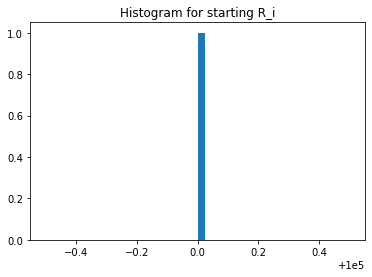

In [22]:
import matplotlib.pyplot as plt
a = starting_Ri.unique()
_ = plt.hist(a, bins=40)  # arguments are passed to np.histogram
plt.title("Histogram for starting R_i")
plt.show()

In [23]:
experiments.UNI_Qi.unique()

array([200000., 334924., 333496., ..., 202377., 204433., 205610.])

In [24]:
experiments.UNI_Si.unique()

array([10000., 15133., 15202., 15195., 15124., 15121., 15082., 15128.,
       15131., 15134., 15171., 15098., 15083., 15122., 15151., 15222.,
       15137., 15236., 15118., 15173., 15079., 15103., 15024., 15092.,
       15073., 15111., 15119., 15159., 15198., 15126., 15175., 15136.,
       15067., 15097., 15215., 15139., 15152., 15070., 15189., 15162.,
       15216., 15155., 15094., 15114., 15069., 15140., 15183., 15148.,
       15127., 15226., 15091., 15179., 15178., 15193., 15176., 15076.,
       15168., 15102., 15197., 15095., 15108., 15161., 15196., 15158.,
       15163., 15153., 15068., 15106., 15165., 15182., 15100., 15166.,
       15144., 15167., 15059., 15088., 15143., 15135., 15086., 15104.,
       15154., 15110., 15229., 15172., 15157., 15138., 15117., 15105.,
       15049., 15125., 15194., 15191., 15129., 15169., 15085., 15145.,
       15087., 15225., 15058., 15078., 15055., 15116., 15200., 15187.,
       15132., 15147., 15112., 15109., 15080., 15025., 15253., 15174.,
      

In [25]:
experiments.UNI_Qj.unique()

array([200000., 239901., 238719., ..., 242538., 245068., 261305.])

In [26]:
experiments.UNI_Rj.unique()

array([100000.,  83430.,  83841., ...,  99164.,  81681.,  76621.])

In [27]:
starting_Rj = experiments[experiments.timestep == 0]
starting_Rj = starting_Rj['UNI_Rj']
starting_Rj.reset_index(drop=True)
starting_Rj.unique()

array([100000.])

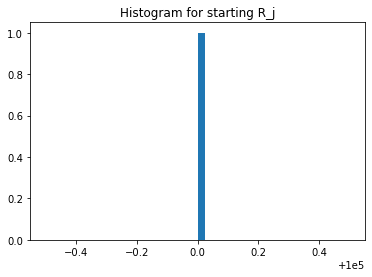

In [28]:
a = starting_Rj.unique()
_ = plt.hist(a, bins=40)  # arguments are passed to np.histogram
plt.title("Histogram for starting R_j")
plt.show()

In [29]:
experiments.UNI_Sj.unique()

array([10000], dtype=int64)

In [30]:
experiments.UNI_ij.unique()

array([100000.])

In [31]:
experiments.UNI_ji.unique()

array([100000.])

In [32]:
experiments.UNI_Sij.unique()

array([1.e+10])

In [33]:
def get_M(k, v):
    if k == 'sim_config':
        k, v = 'M', v['M']
    return k, v

config_ids = [
    dict(
        get_M(k, v) for k, v in config.__dict__.items() if k in ['simulation_id', 'run_id', 'sim_config', 'subset_id']
    ) for config in configs
]

# Agent sequences

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4459: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


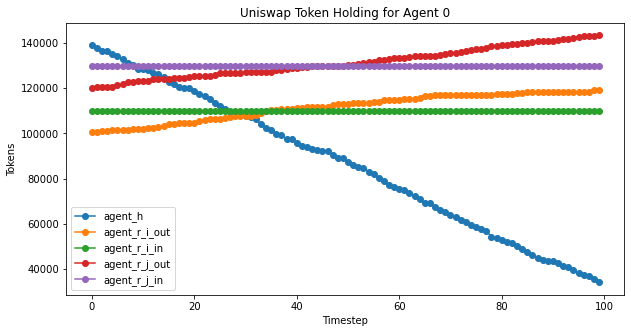

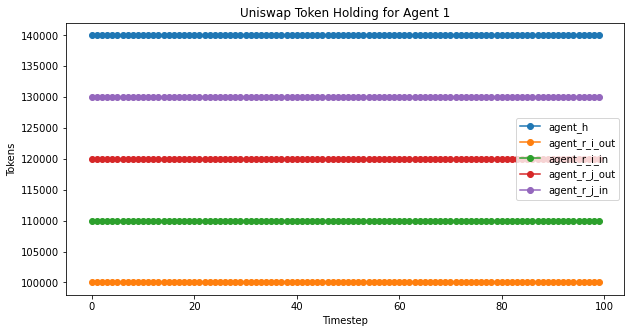

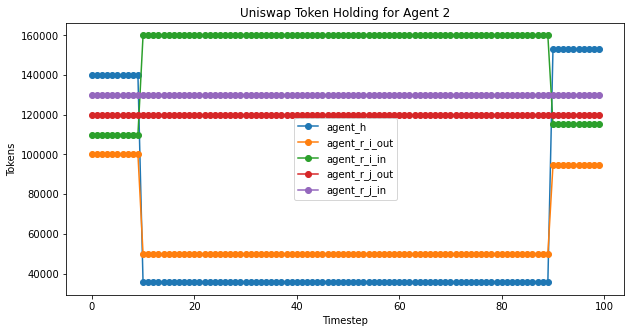

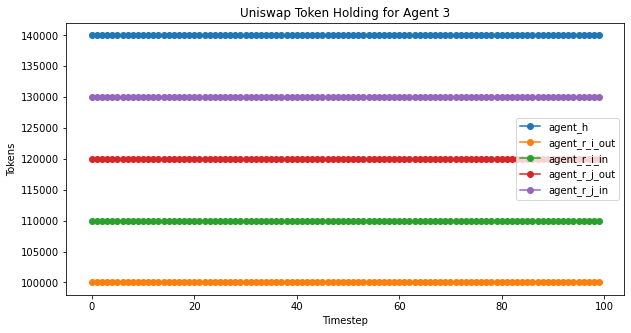

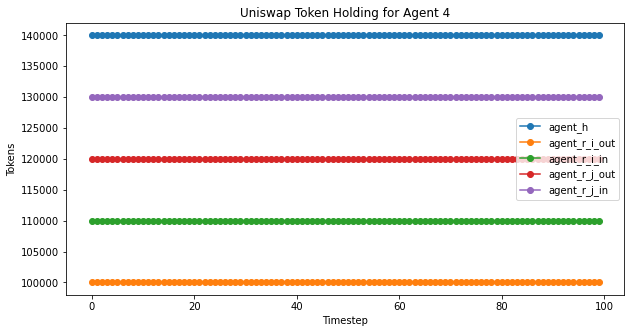

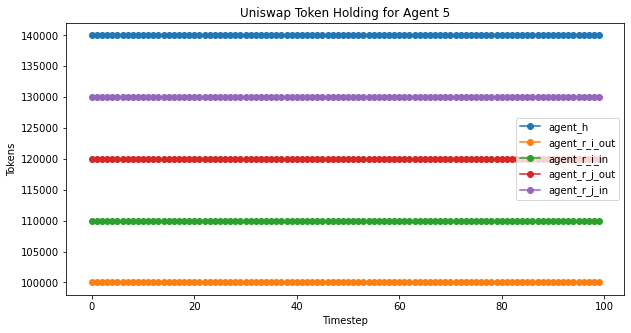

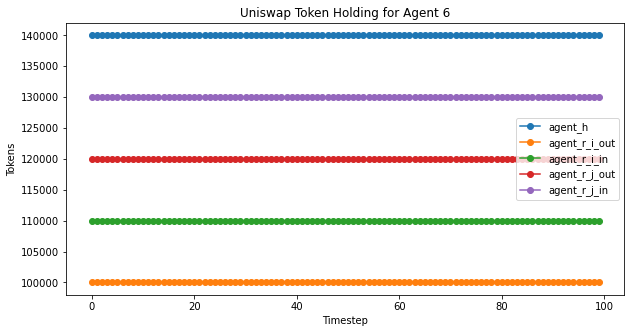

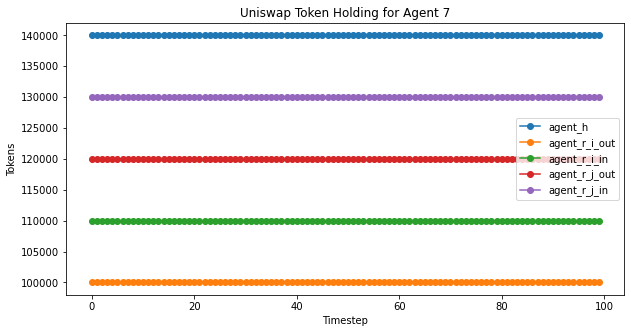

In [34]:
agent_plot(experiment2,'Uniswap Token Holding for Agent ', 100) #,4,'j')

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4459: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


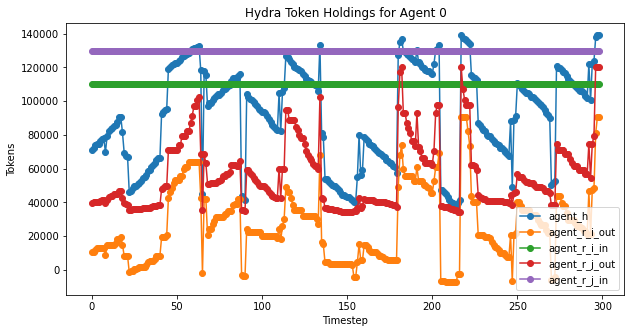

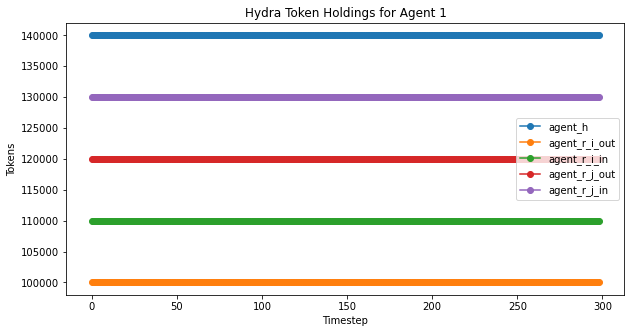

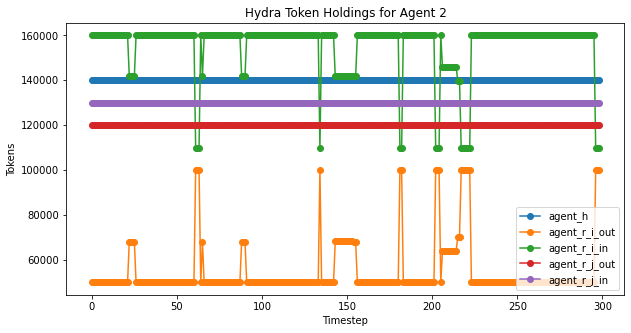

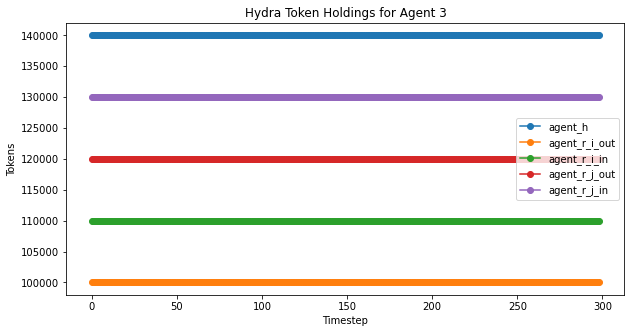

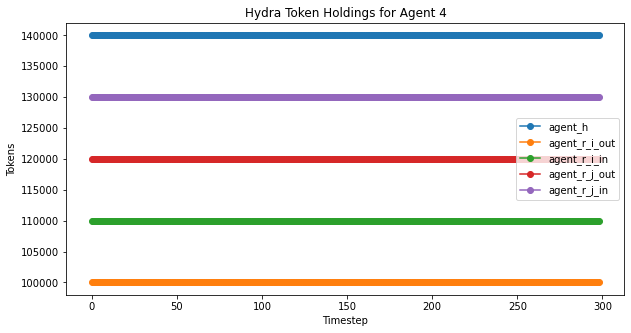

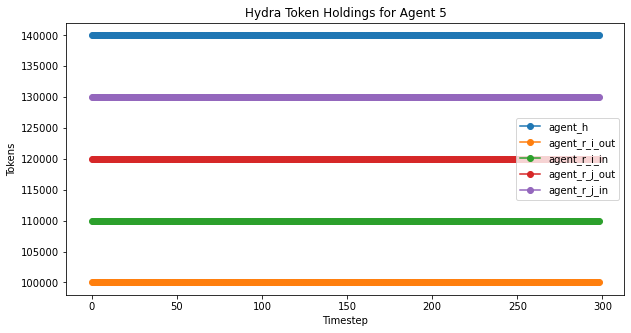

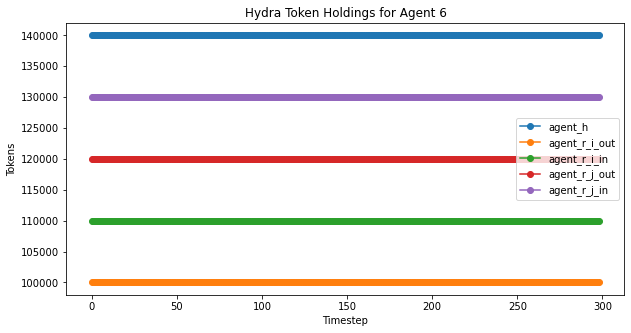

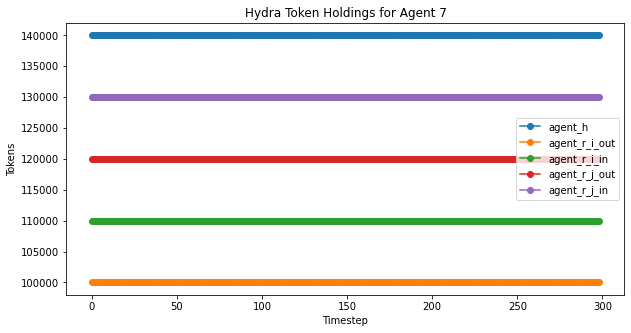

In [35]:
hydra_agent_plot(experiments,'Hydra Token Holdings for Agent ', 299)

# Liquidity dynamics

Movement of the Uniswap variables

- 'UNI_Ri', 'UNI_Qi', 'UNI_Si'
- 'UNI_Rj', 'UNI_Qj', 'UNI_Sj'
- 'UNI_ij', 'UNI_ji', 'UNI_Sij'

## Uniswap -- Ri-Q instance

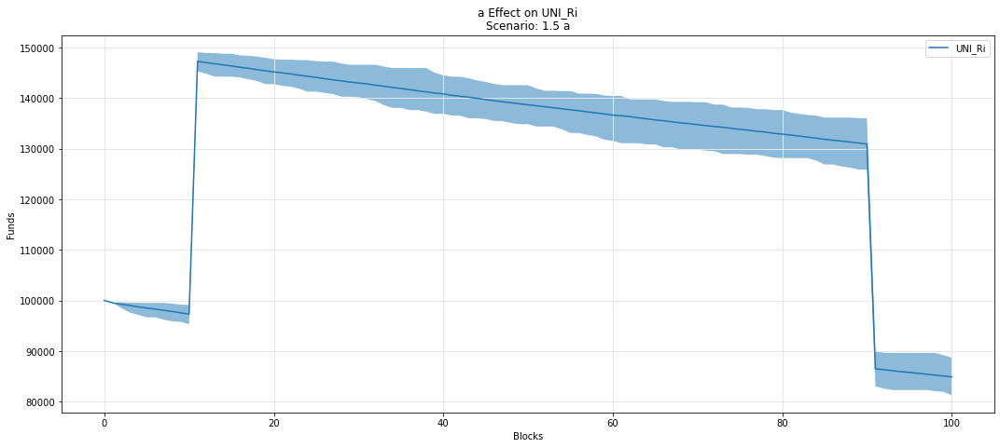

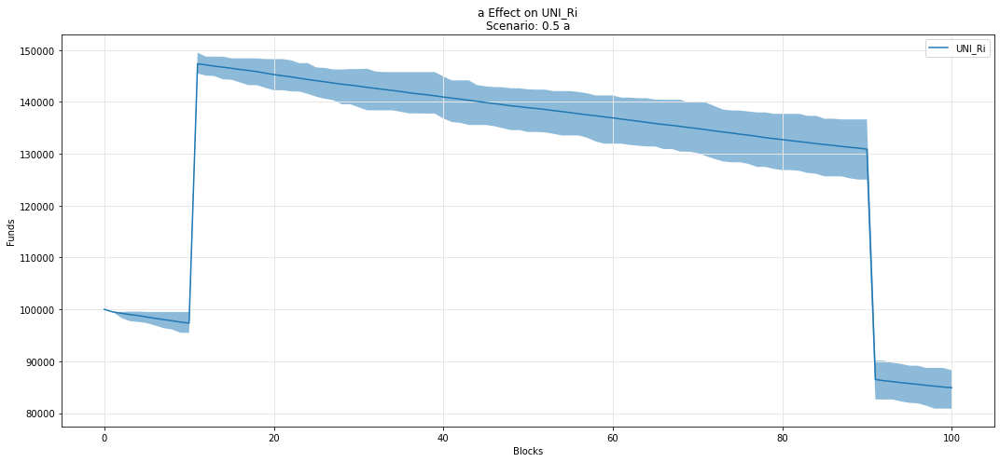

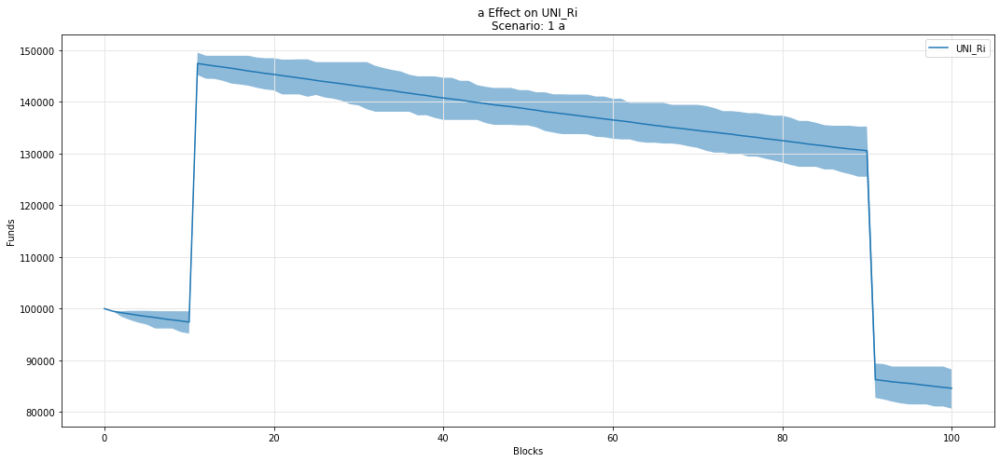

In [36]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Ri')

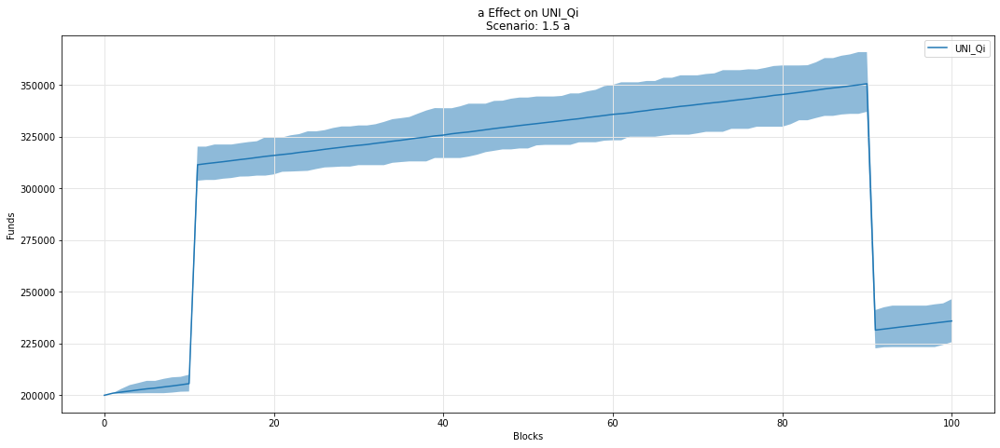

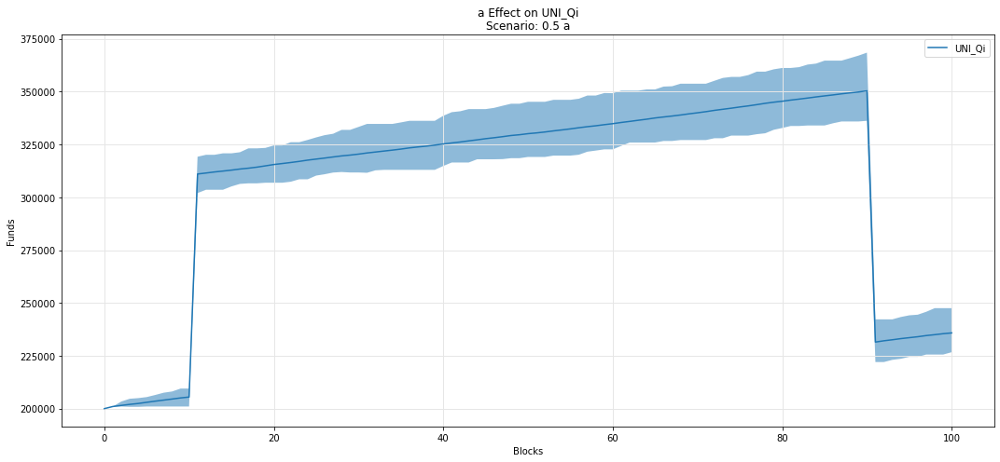

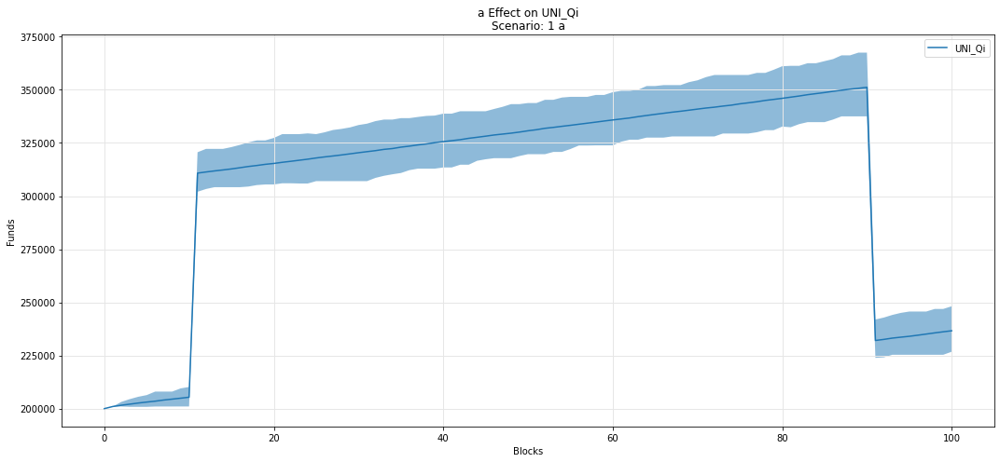

In [37]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Qi')

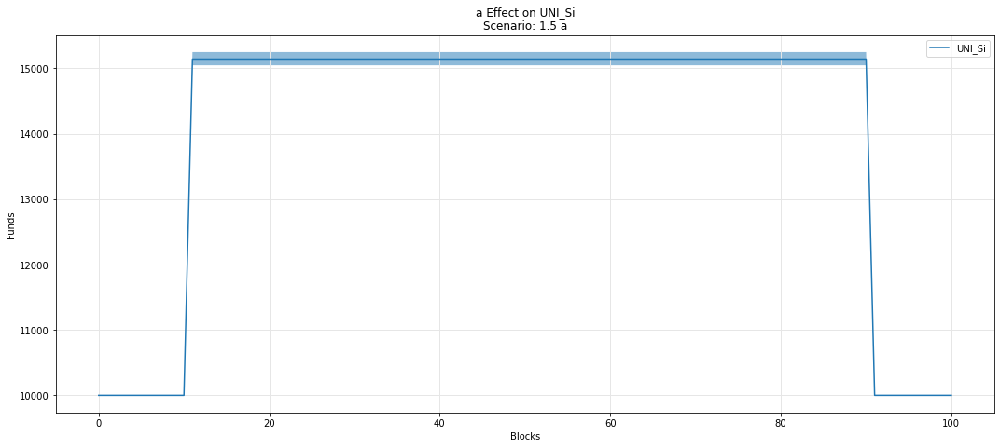

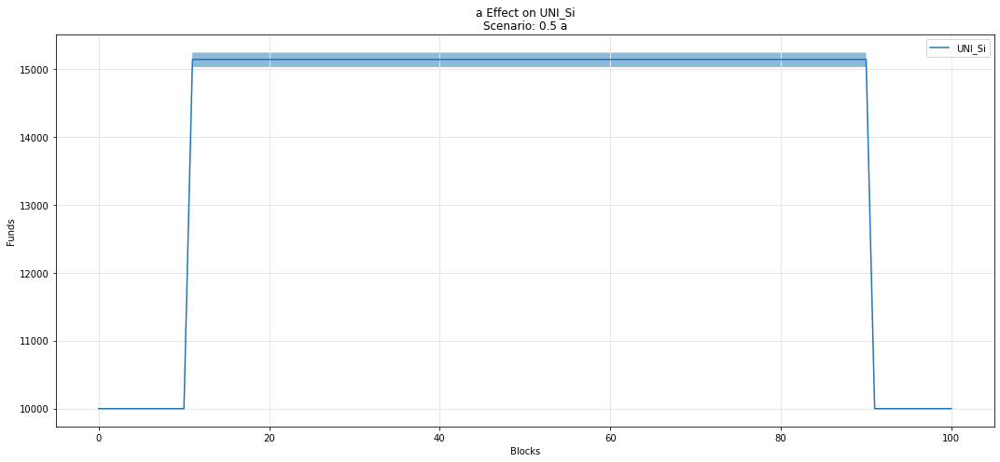

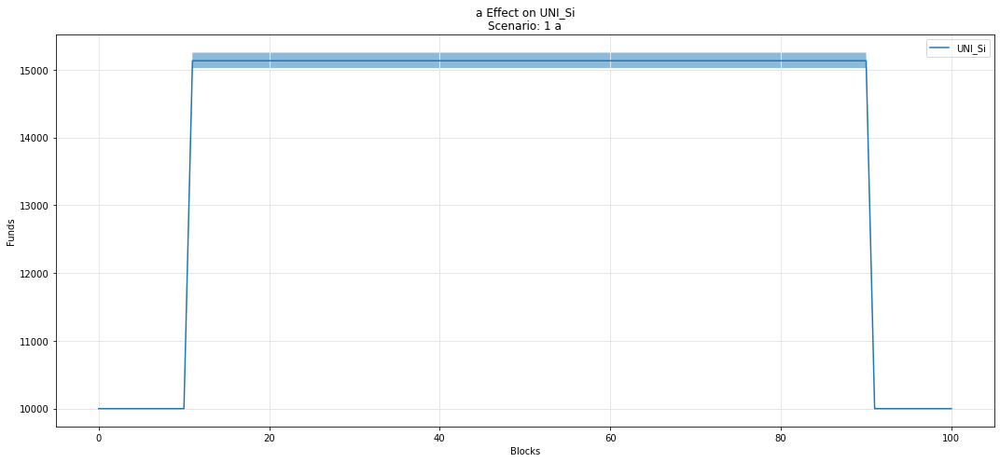

In [38]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Si')

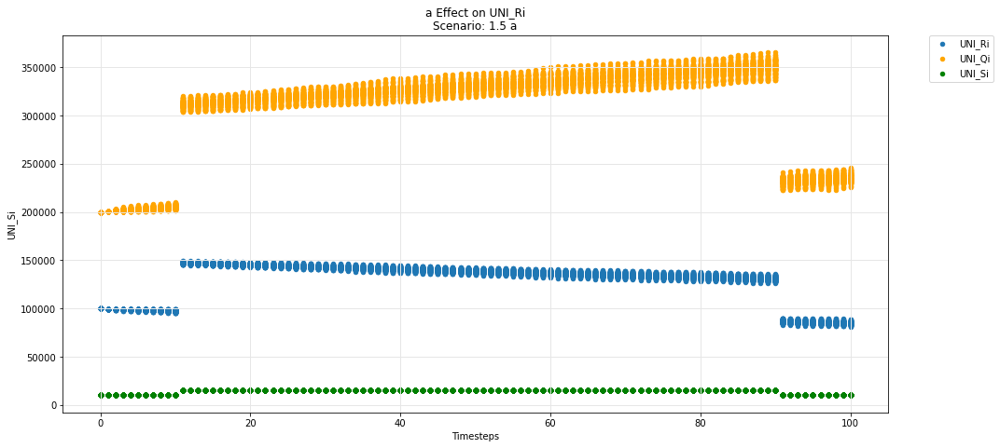

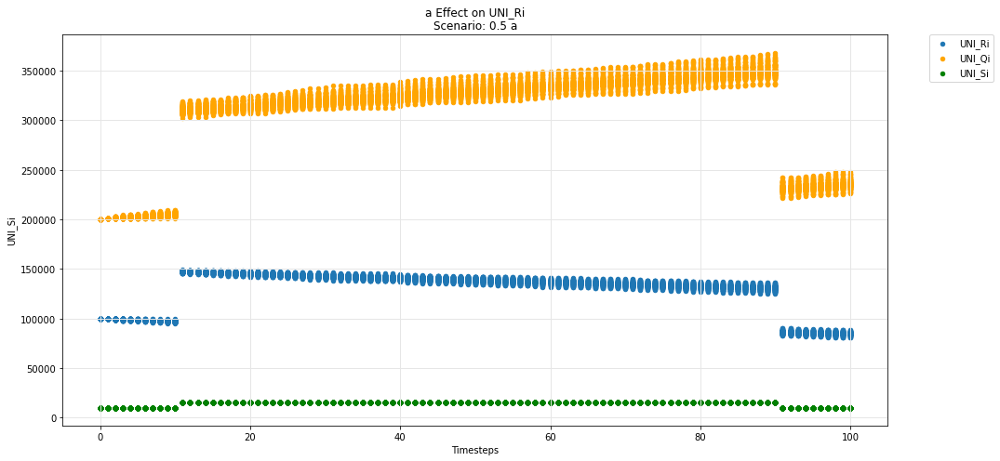

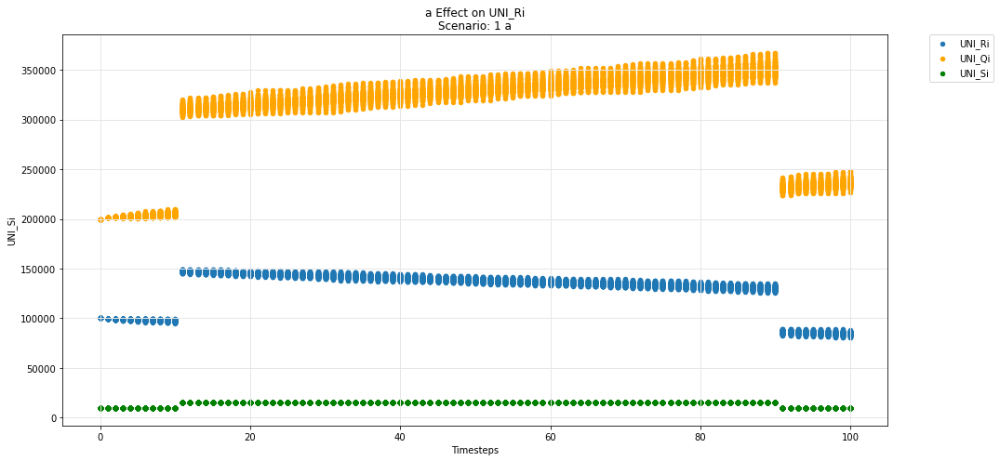

In [39]:
param_test_plot(experiments, config_ids, 'a', 'UNI_Ri', 'UNI_Qi', 'UNI_Si')

## Uniswap -- Rj-Q instance

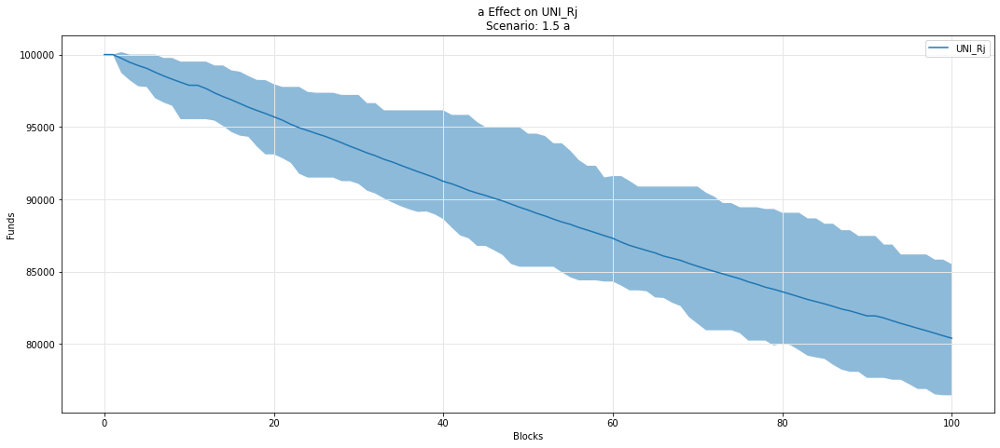

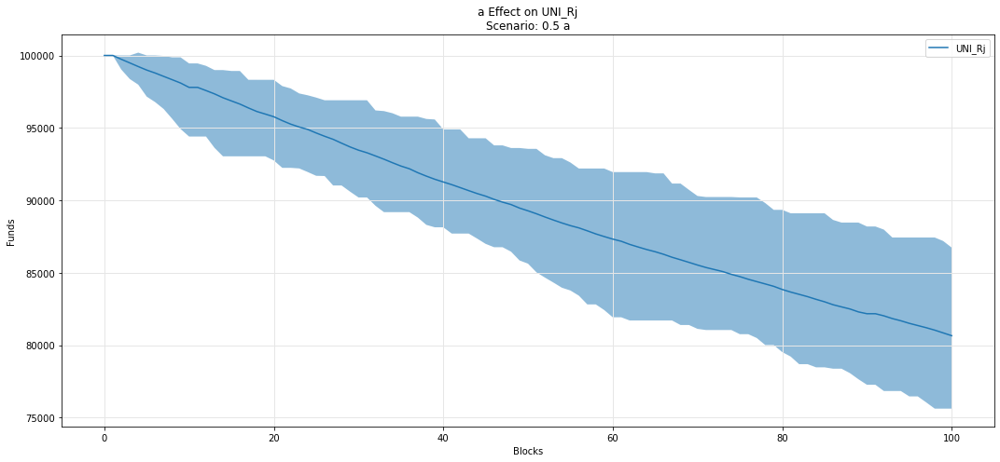

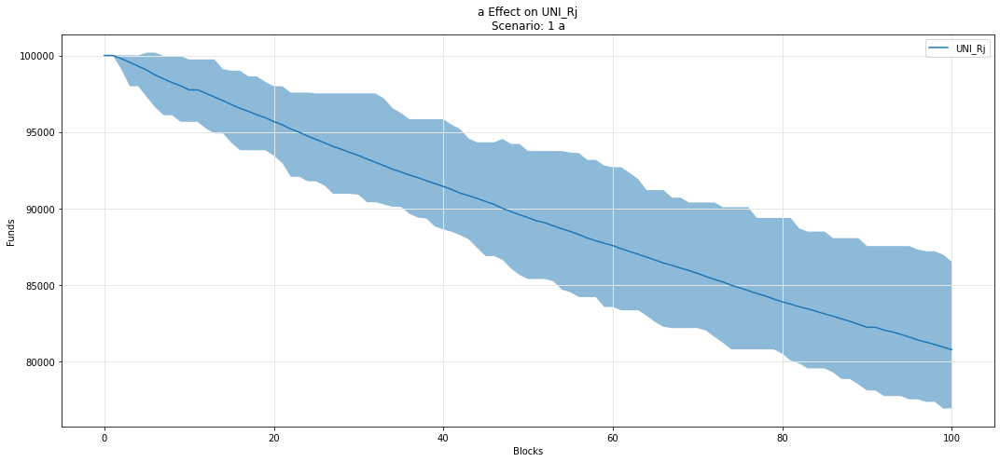

In [40]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Rj')

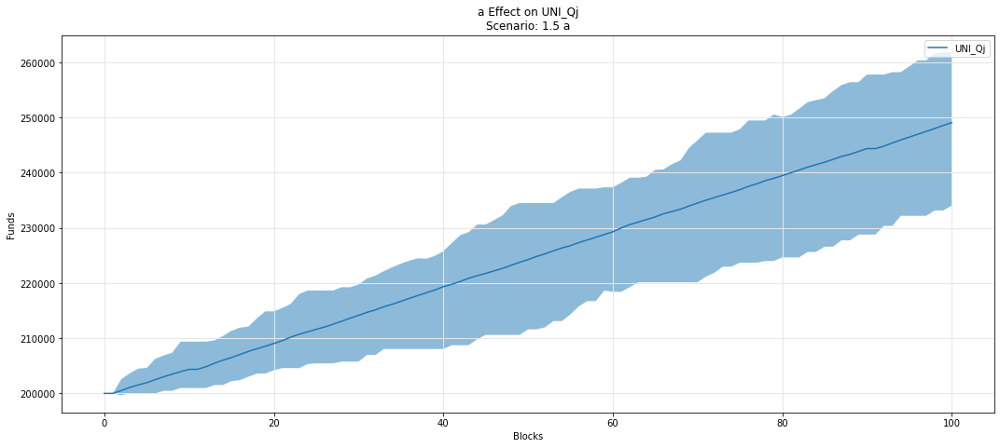

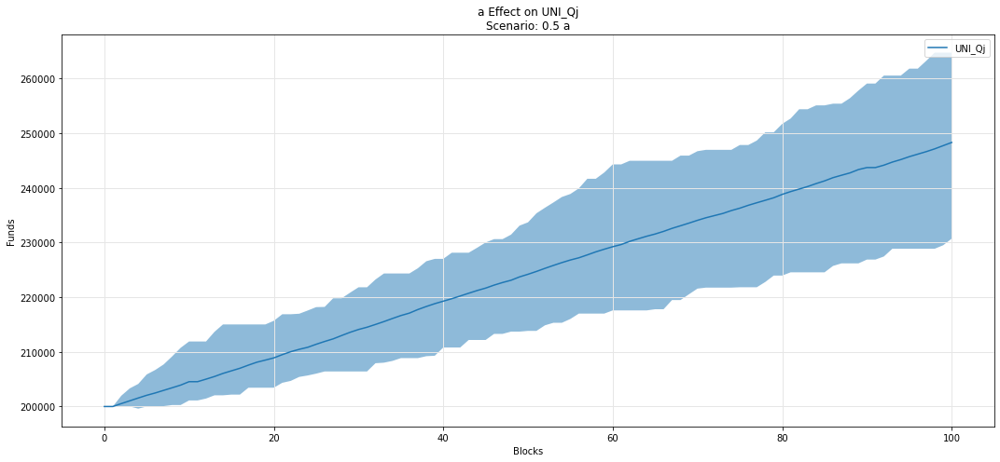

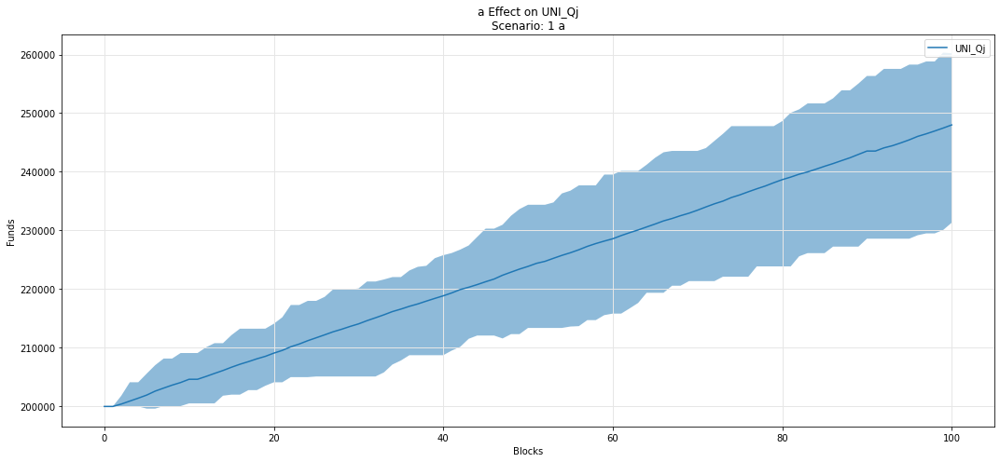

In [41]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Qj')

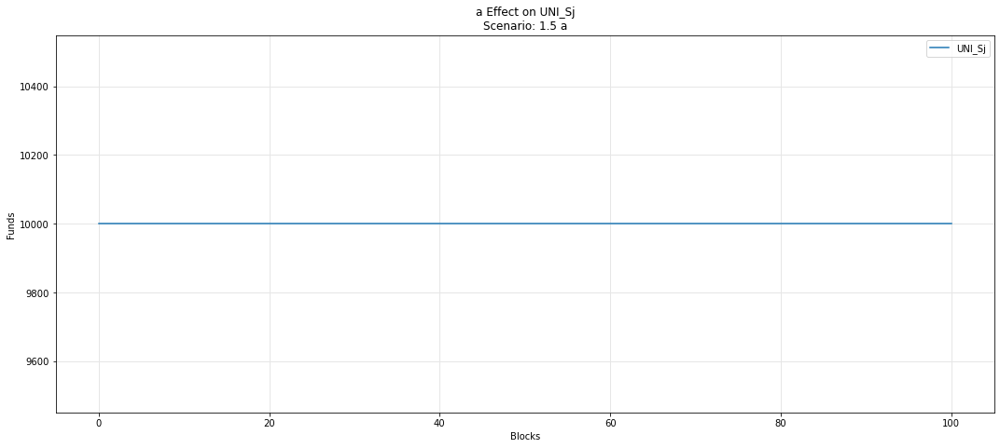

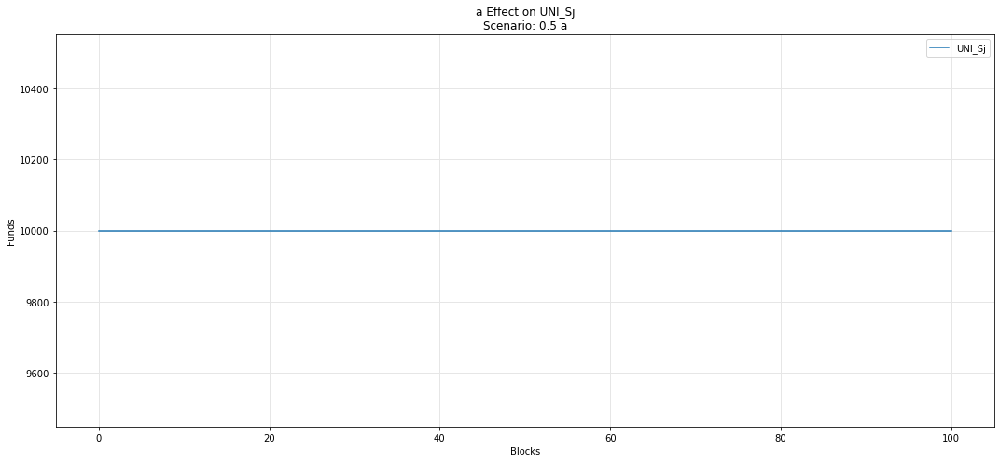

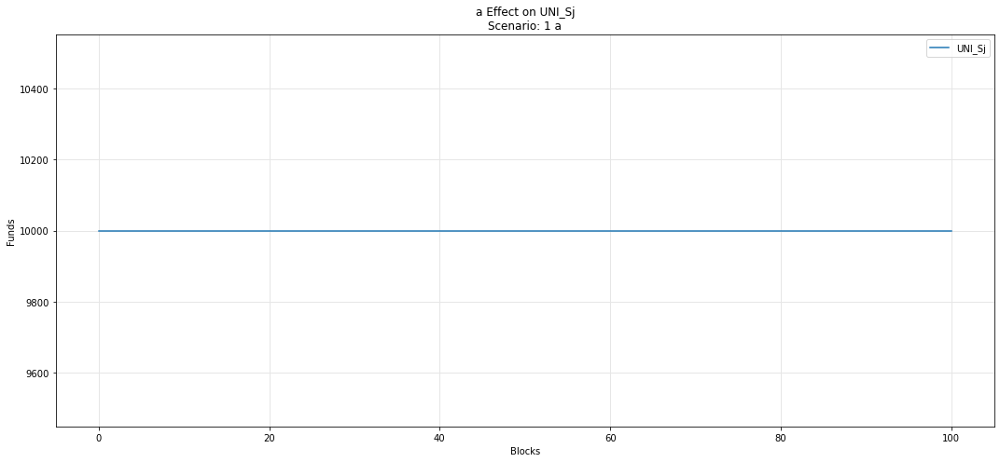

In [42]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Sj')

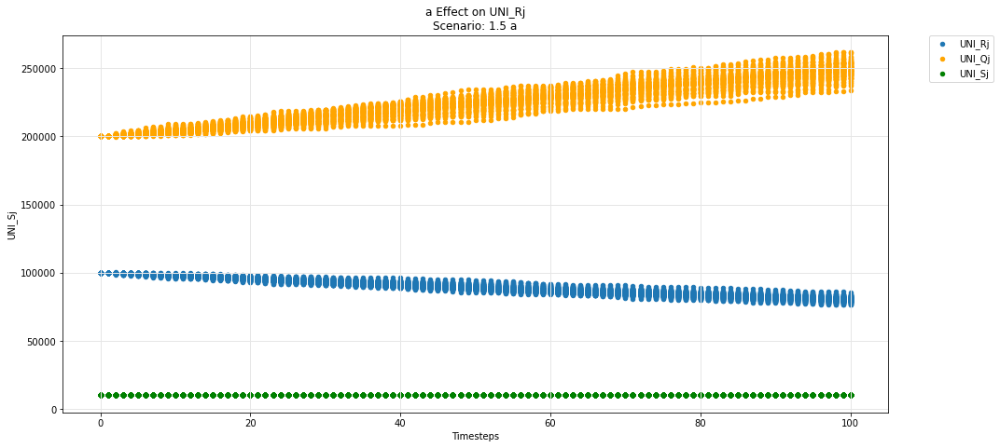

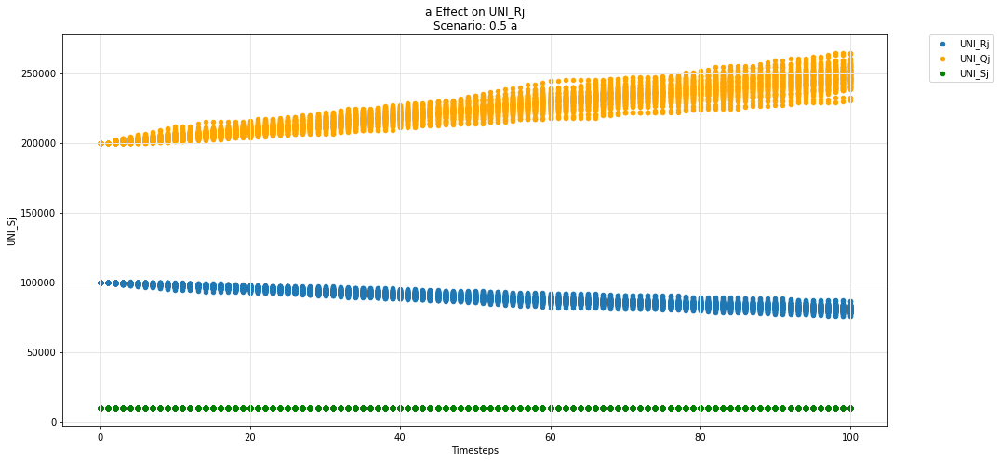

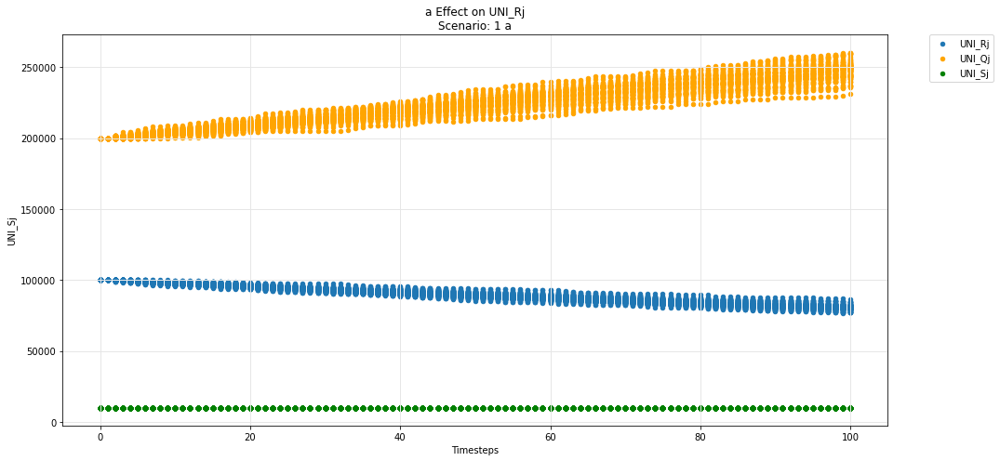

In [43]:
param_test_plot(experiments, config_ids, 'a', 'UNI_Rj', 'UNI_Qj', 'UNI_Sj')

## Uniswap -- ij-Q instance

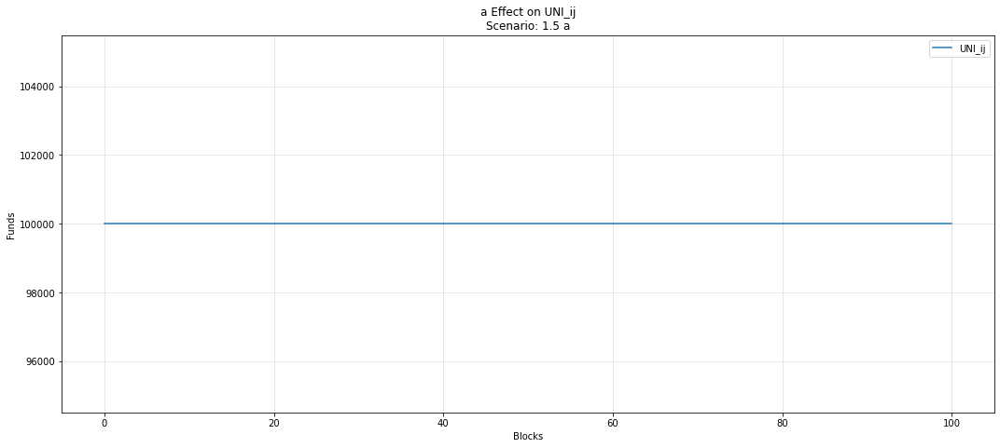

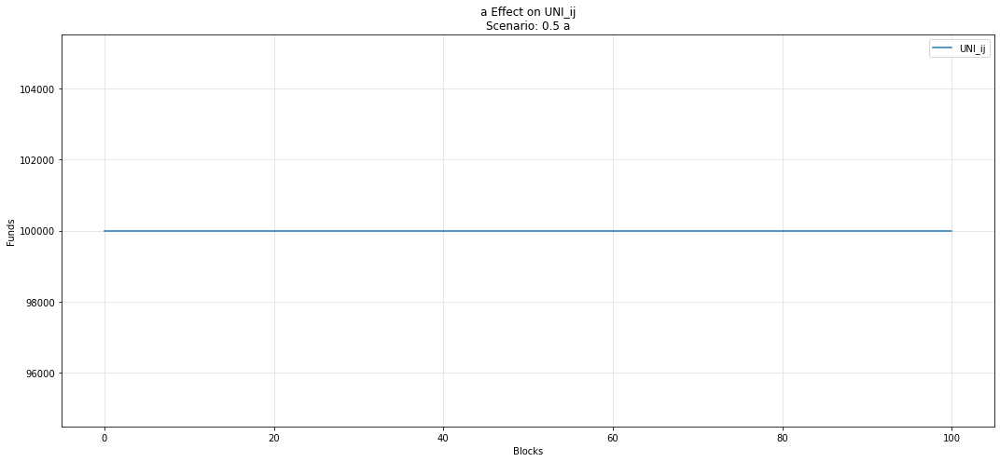

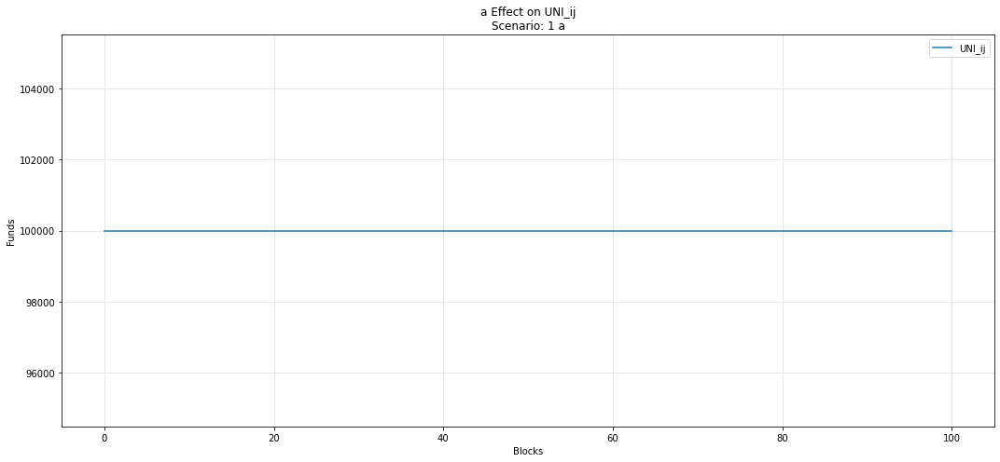

In [44]:
param_fan_plot3(experiments, config_ids, 'a','UNI_ij')

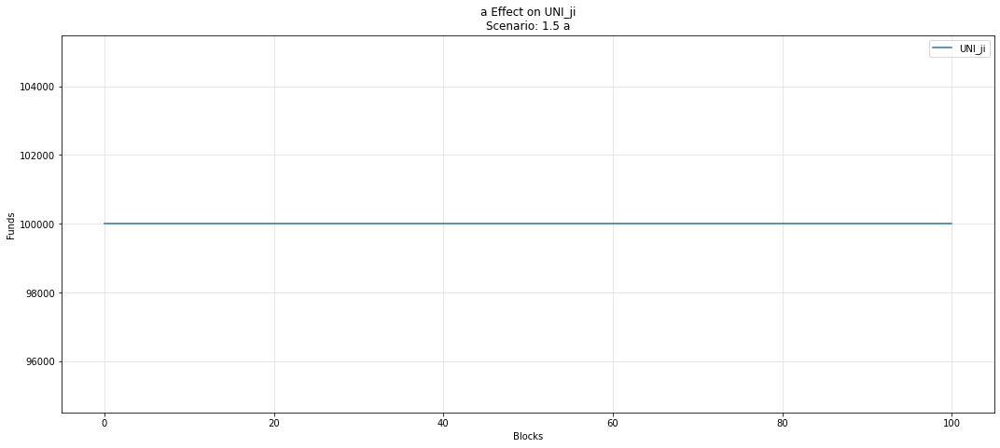

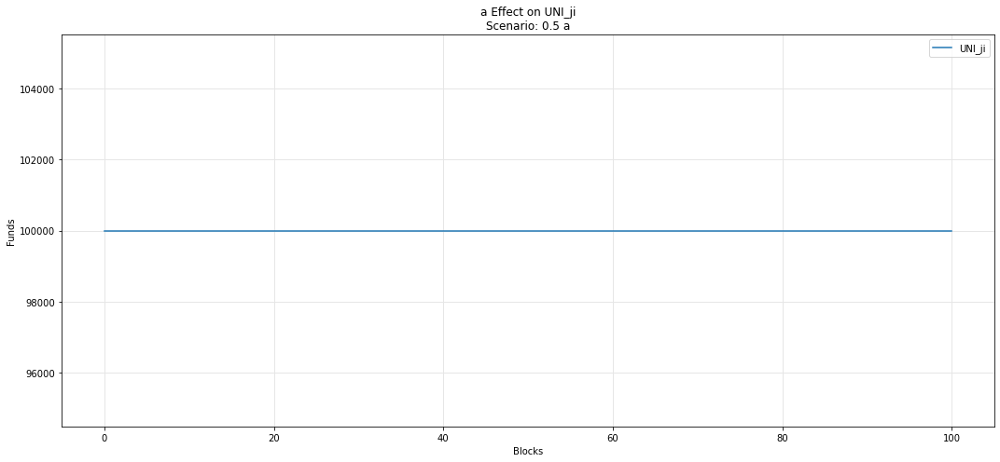

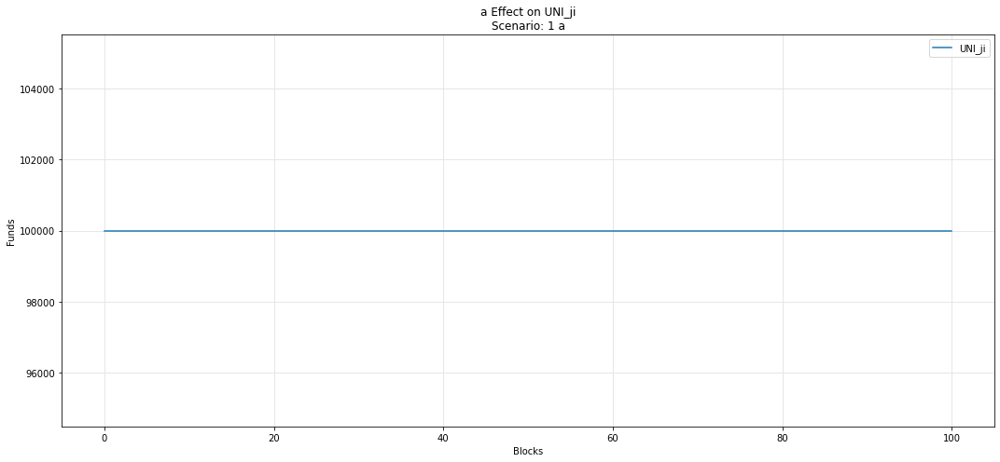

In [45]:
param_fan_plot3(experiments, config_ids, 'a','UNI_ji')

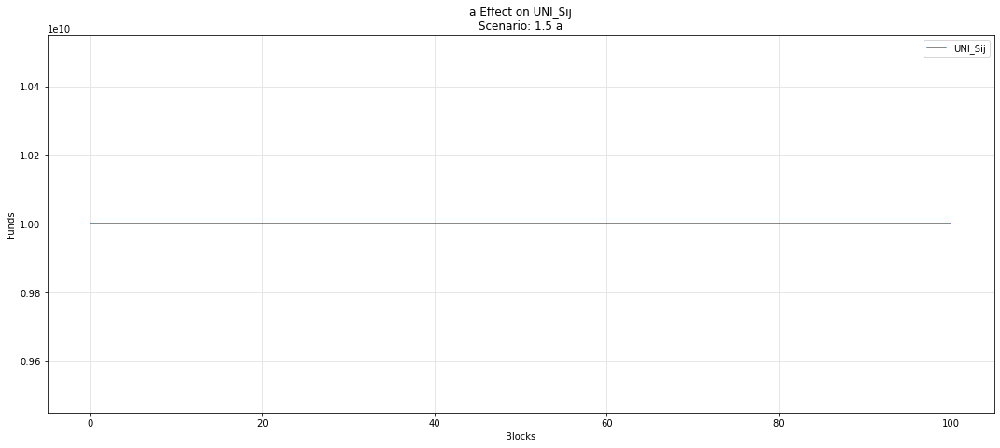

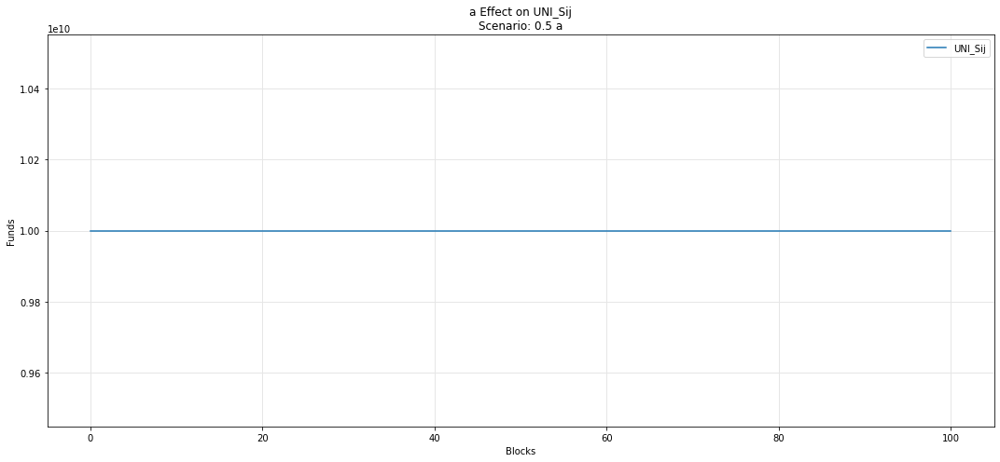

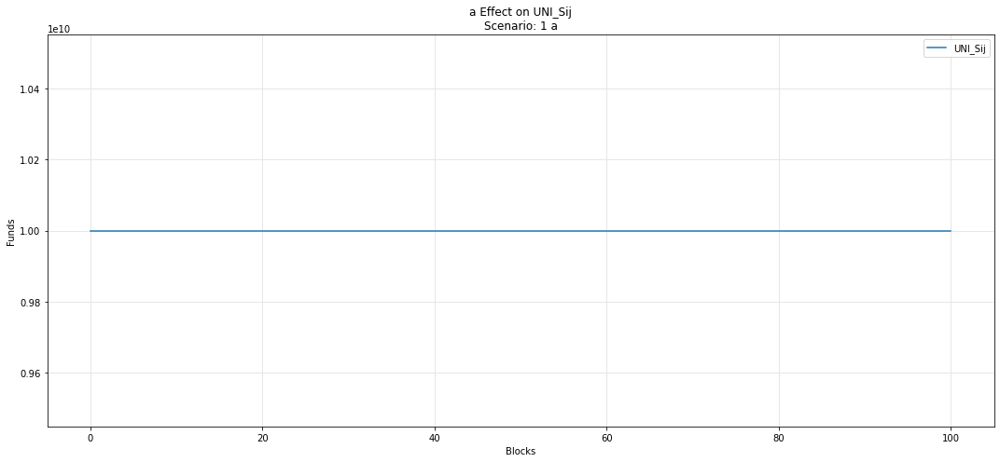

In [46]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Sij')

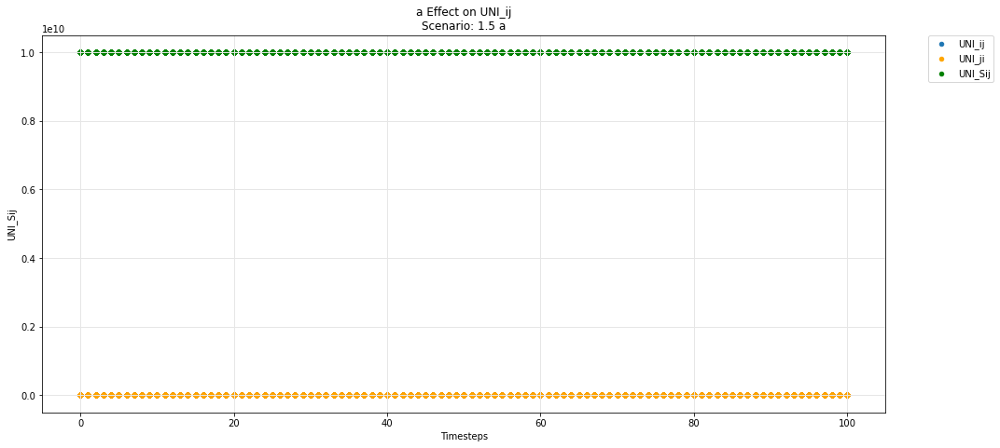

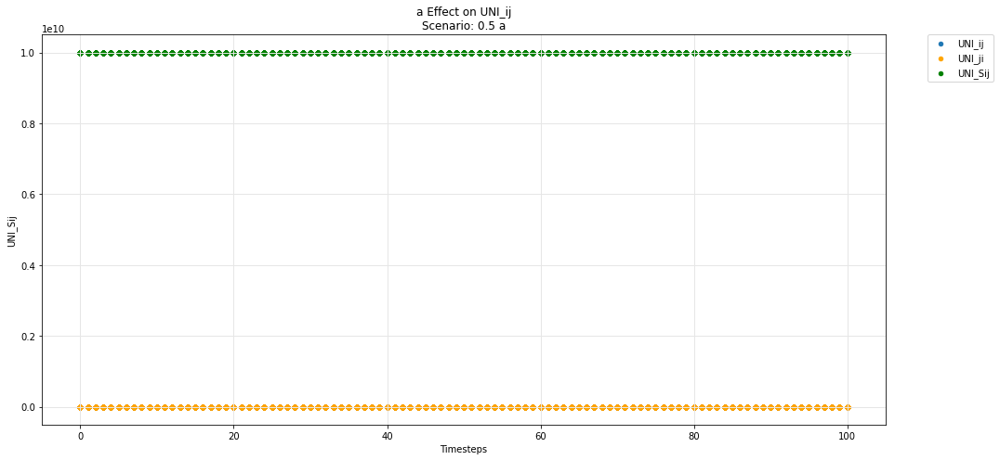

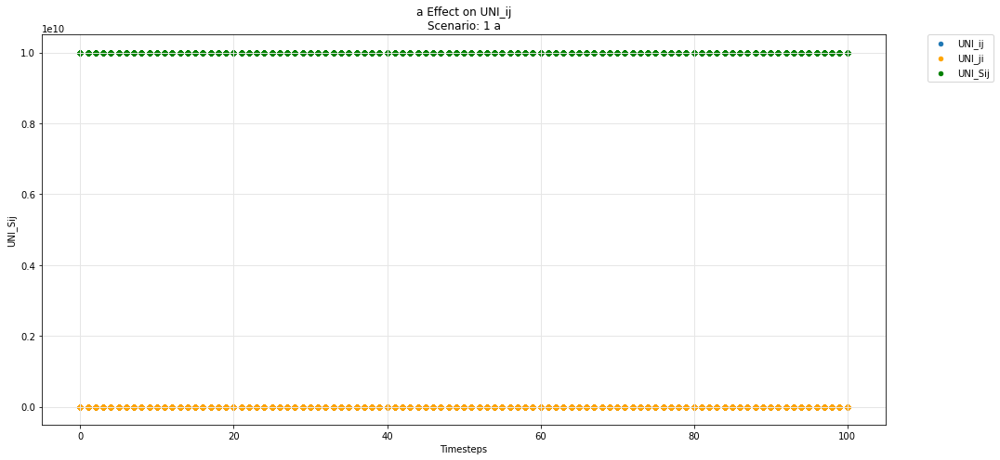

In [47]:
param_test_plot(experiments, config_ids, 'a', 'UNI_ij', 'UNI_ji', 'UNI_Sij')

## Hydra -- base

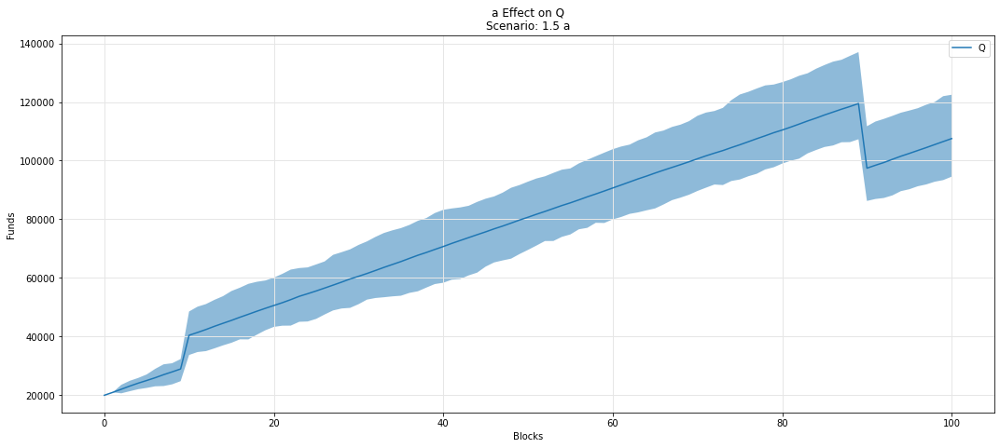

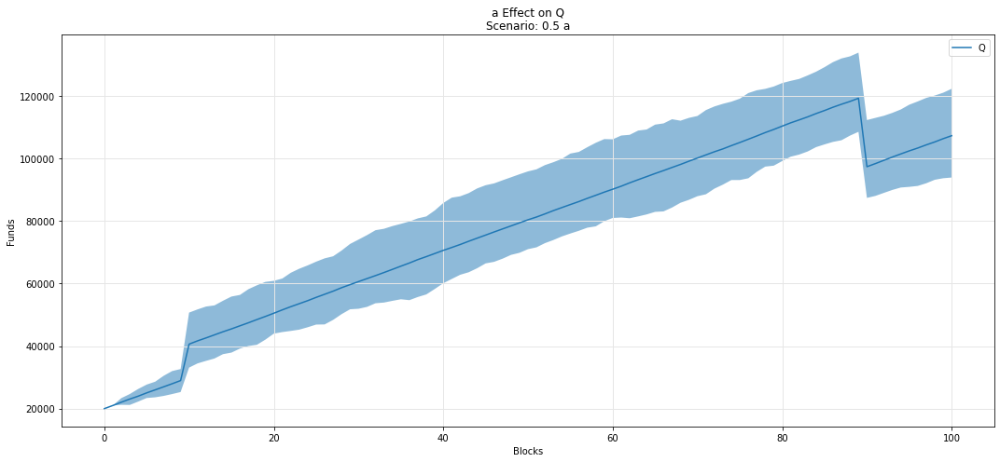

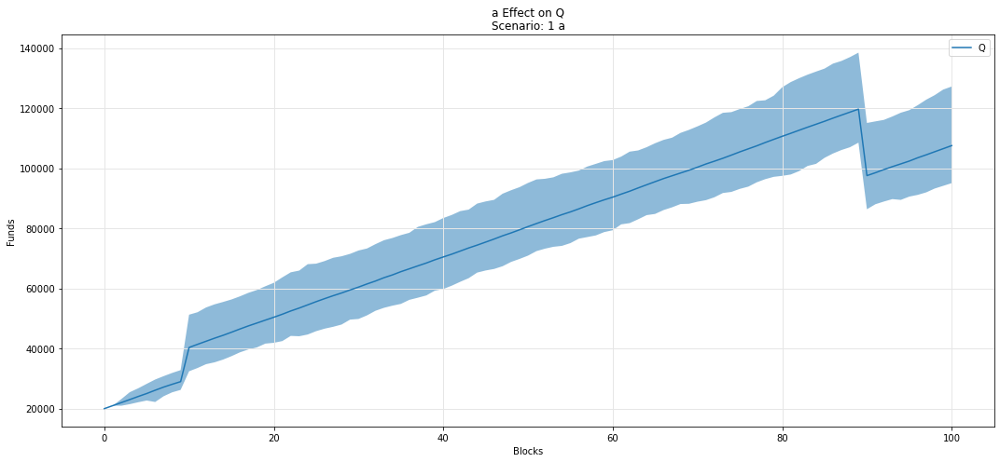

In [48]:
param_fan_plot3(experiments, config_ids, 'a','Q')

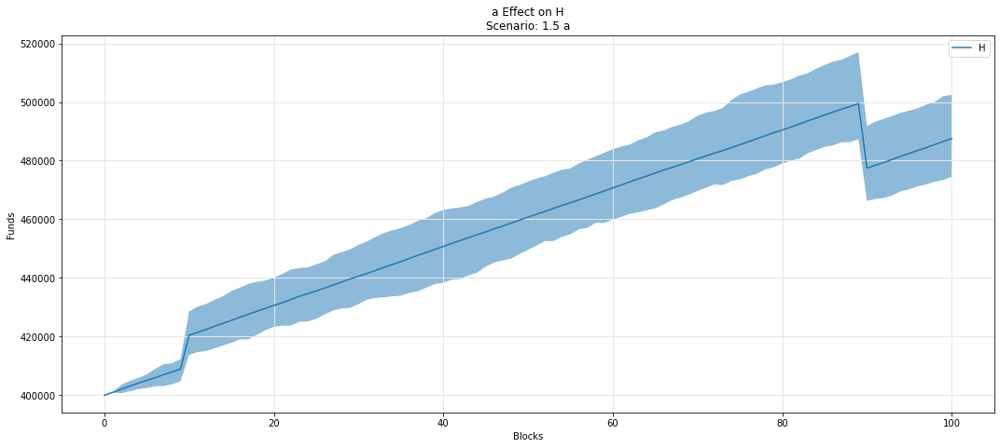

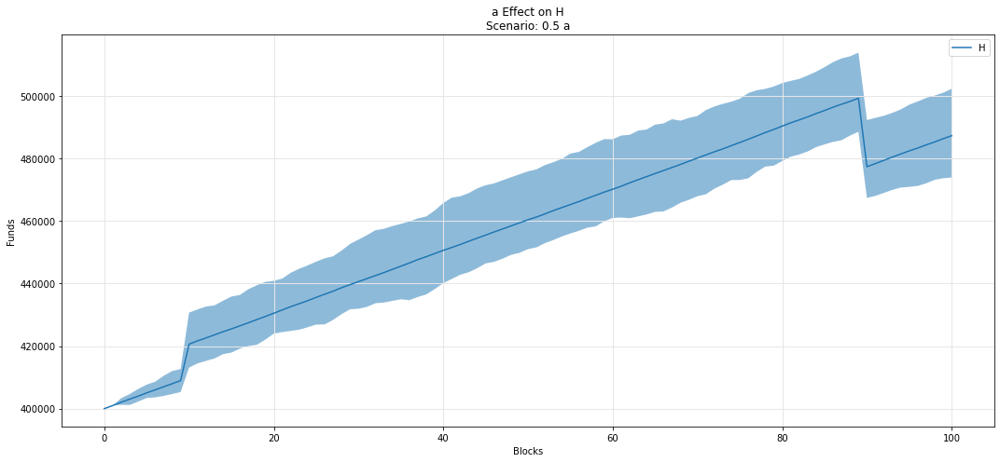

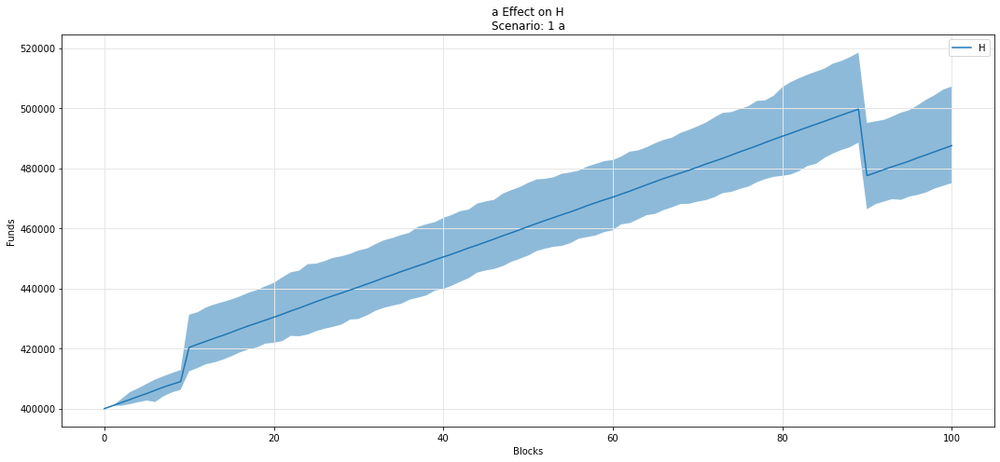

In [49]:
param_fan_plot3(experiments, config_ids, 'a','H')

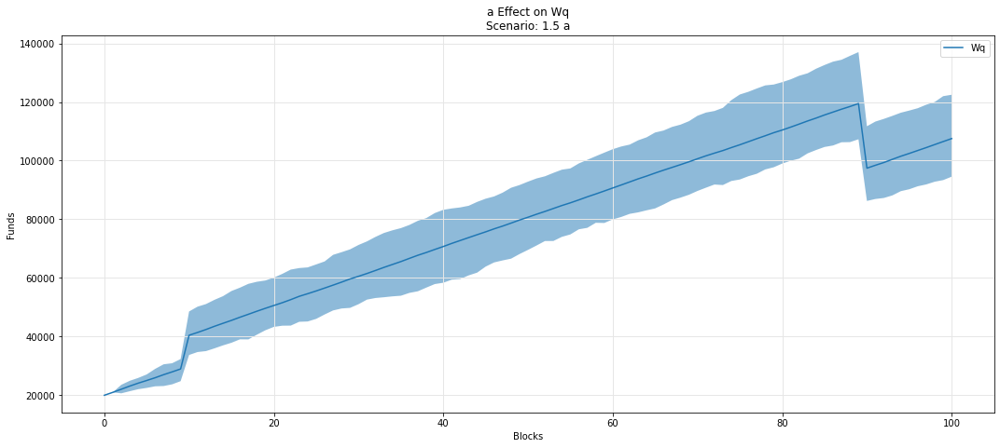

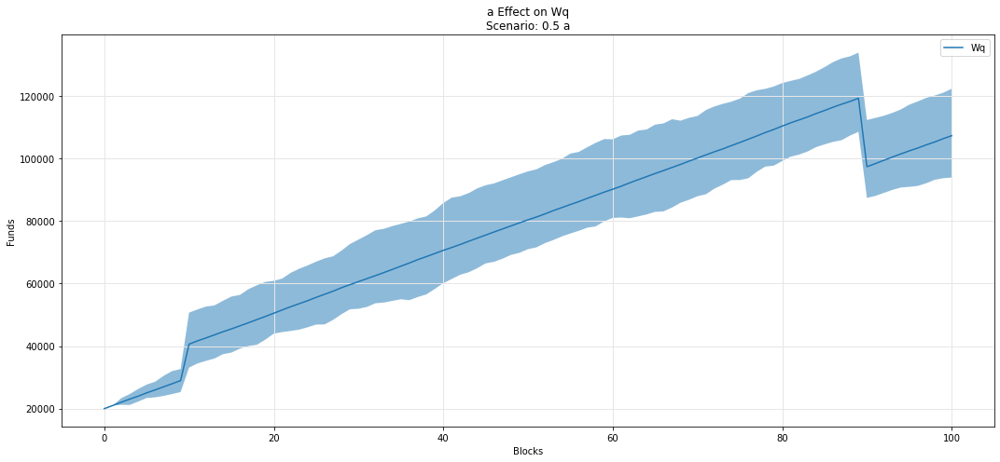

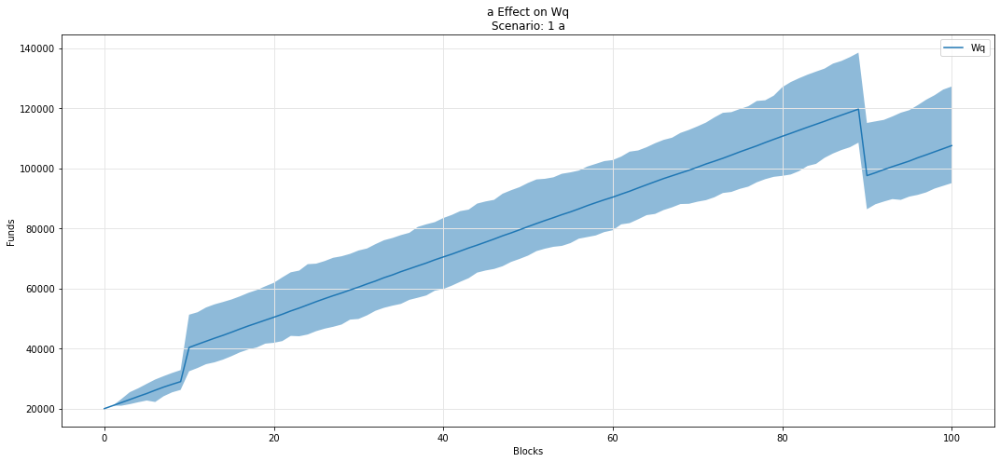

In [50]:
param_fan_plot3(experiments, config_ids, 'a','Wq')

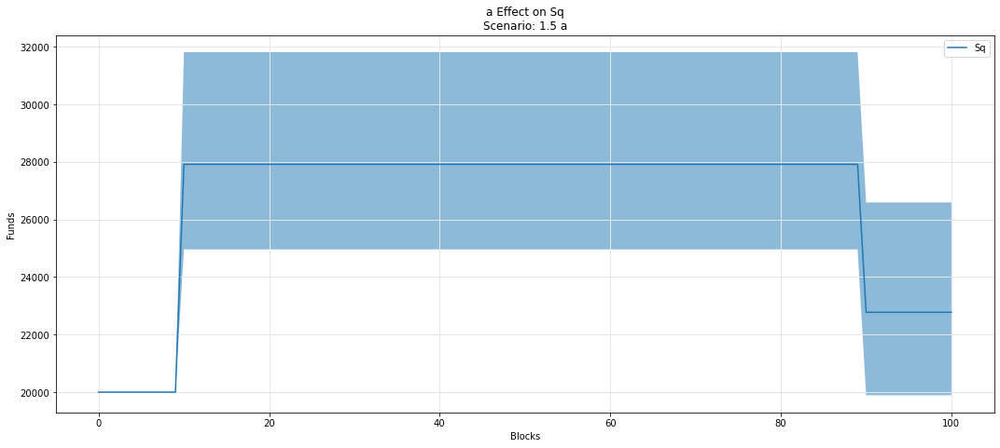

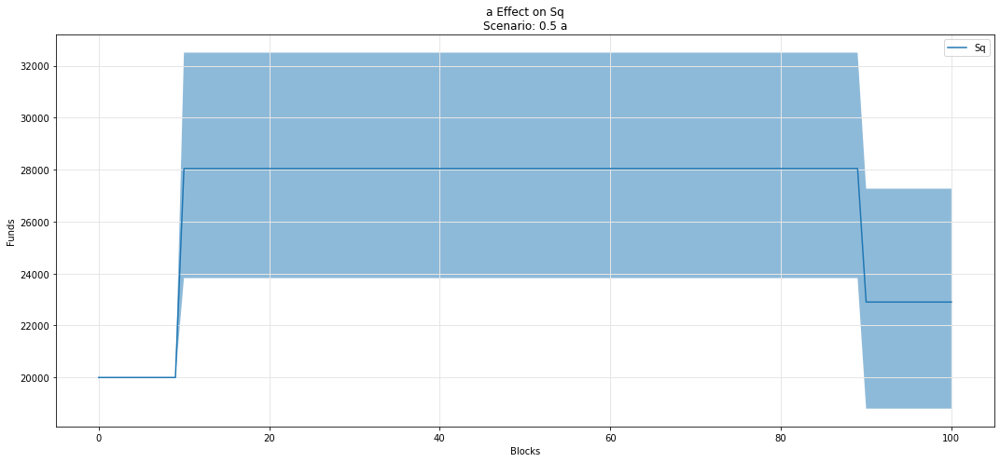

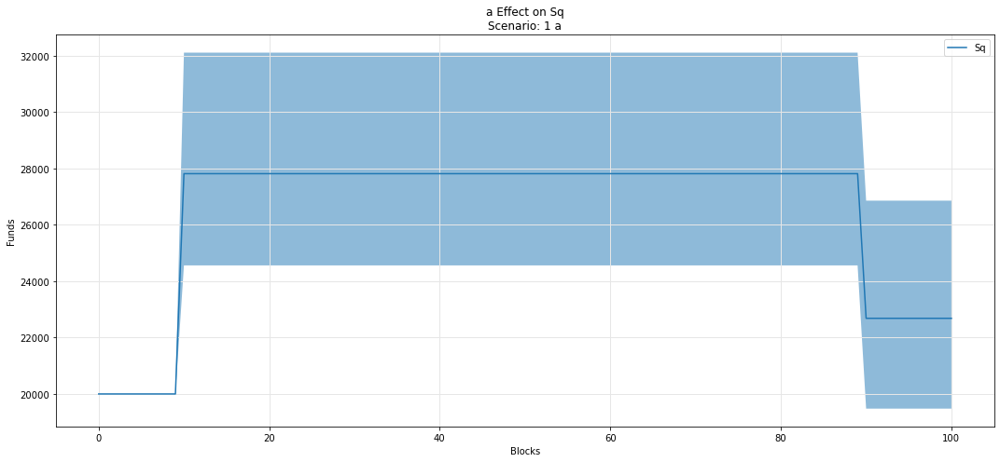

In [51]:
param_fan_plot3(experiments, config_ids, 'a','Sq')

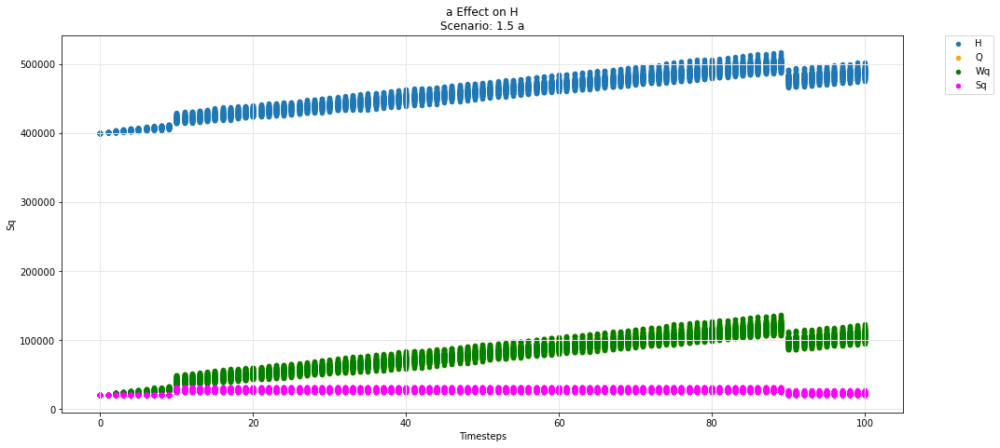

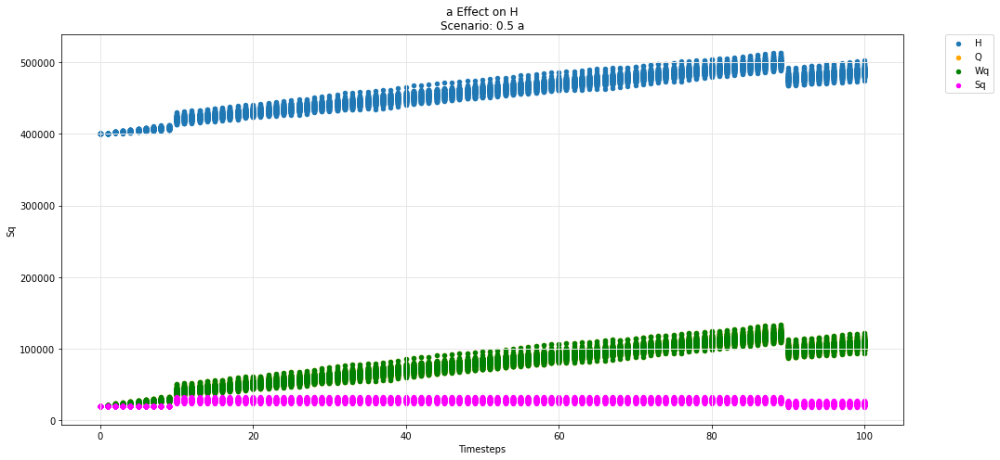

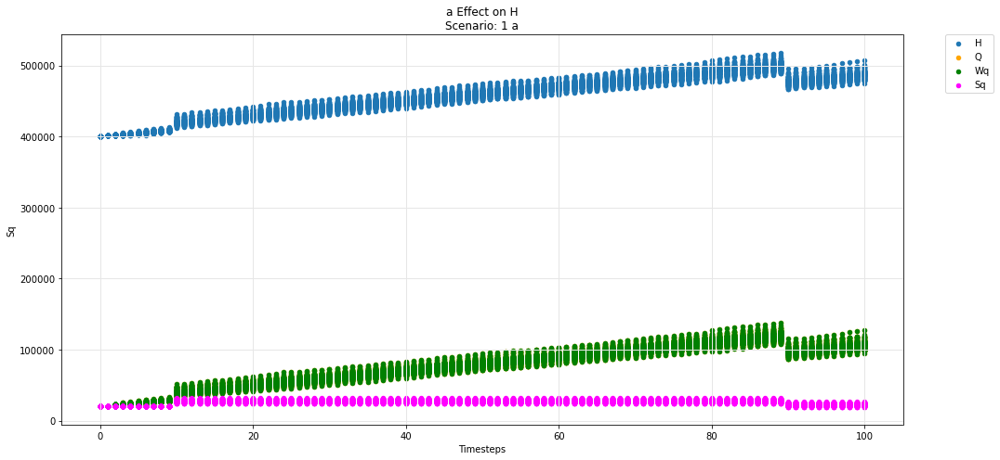

In [52]:
param_test_plot(experiments, config_ids, 'a', 'H', 'Q', 'Wq', 'Sq')

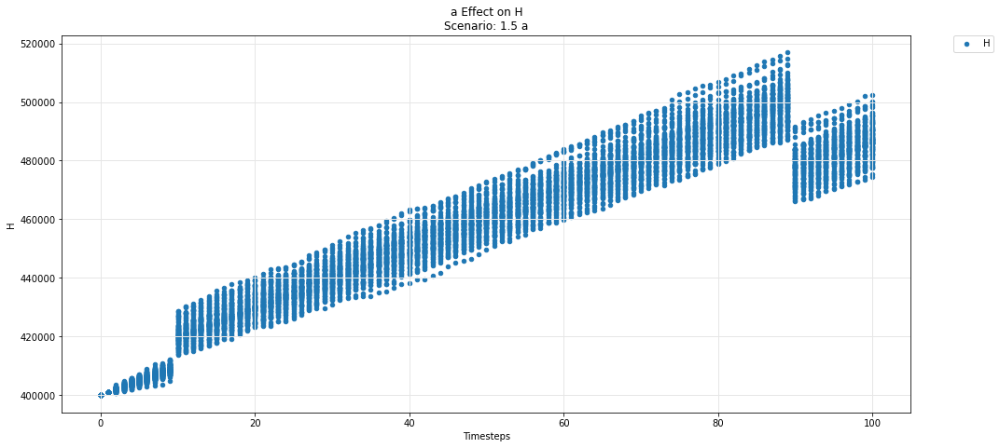

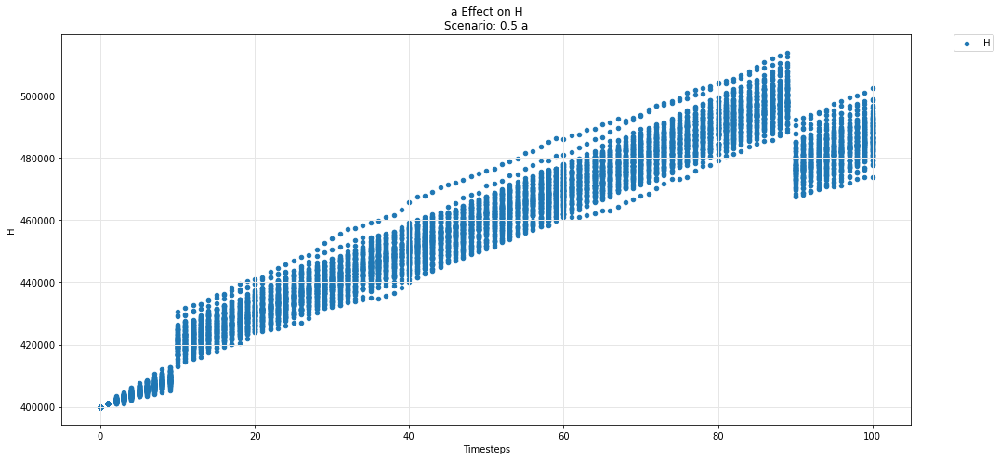

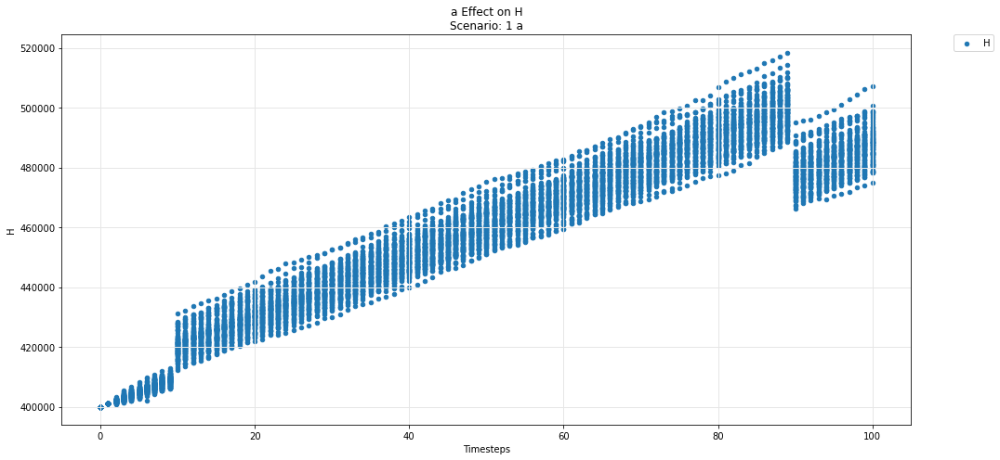

In [53]:
param_test_plot(experiments, config_ids, 'a', 'H')

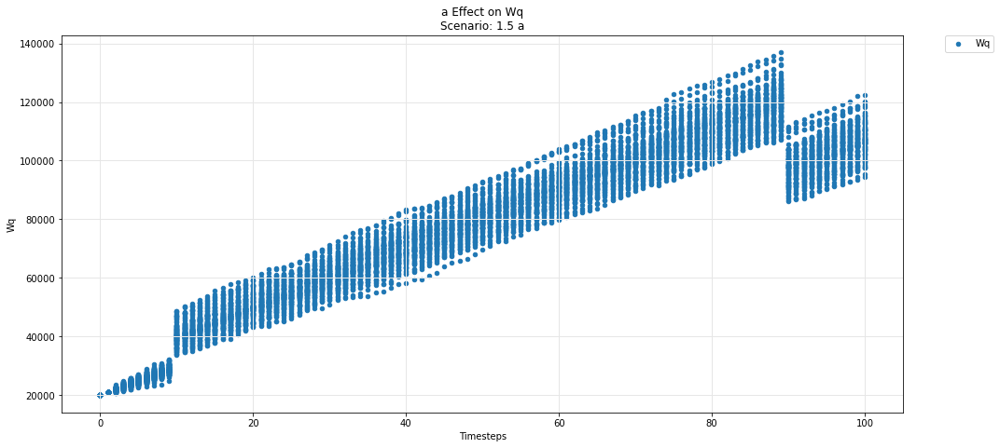

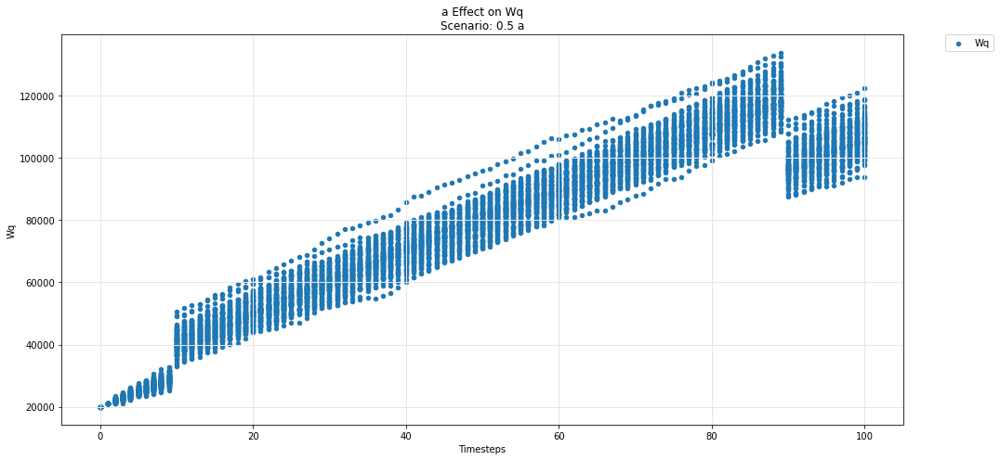

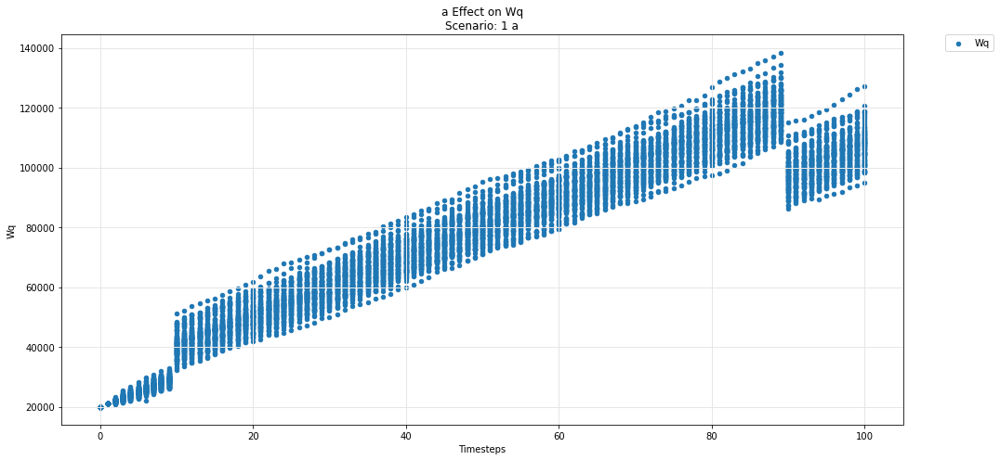

In [54]:
param_test_plot(experiments, config_ids, 'a', 'Wq')

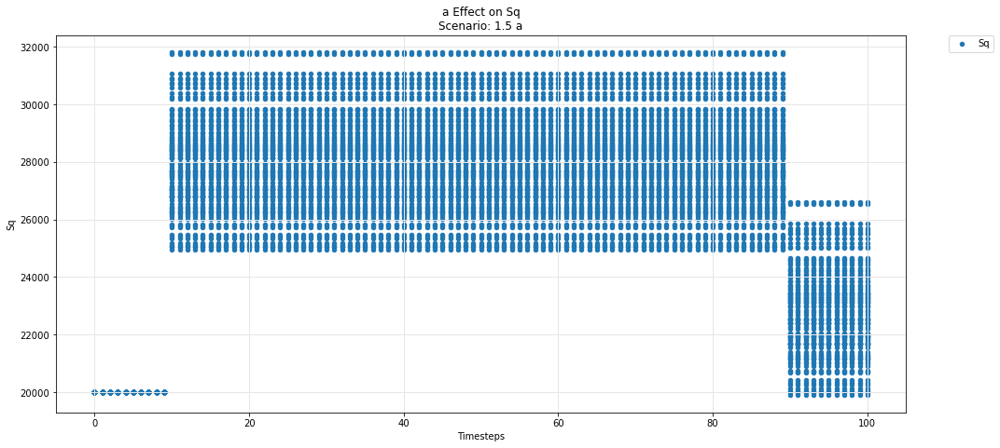

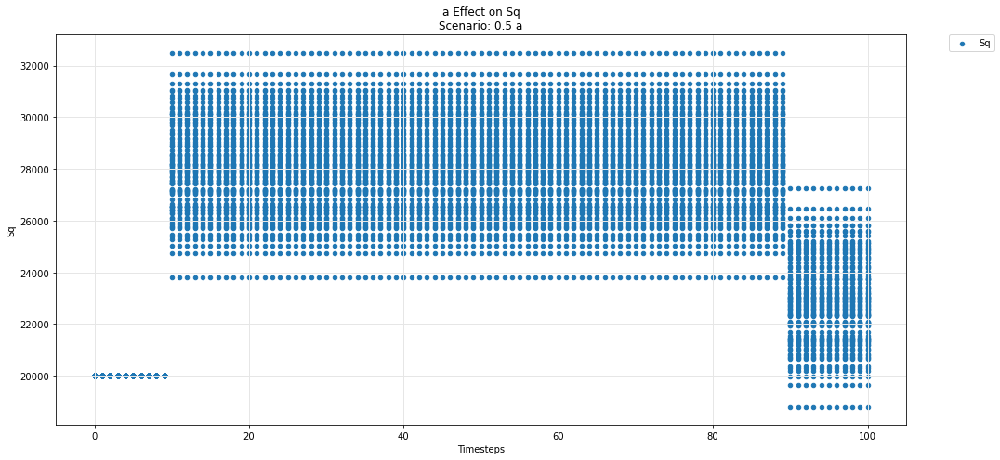

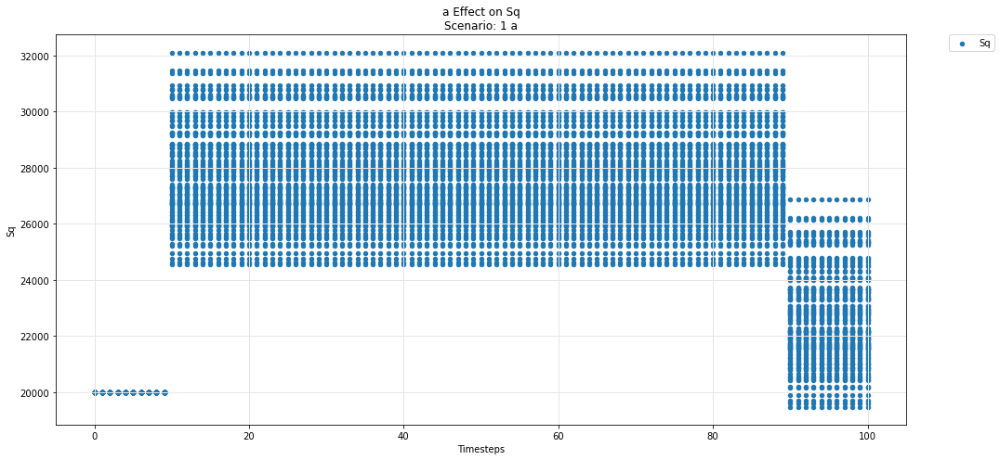

In [55]:
param_test_plot(experiments, config_ids, 'a', 'Sq')

## Hydra -- pool

Movement of the Omnipool variables
- Asset i
- Asset j
- Asset k

over the course of the simulation

In [56]:
def param_pool_simulation_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        df = df.groupby('timestep').agg({df_label: ['min', 'mean', 'max']}).reset_index()
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=(df_label,'mean'), label=df_label, ax=ax, legend=True, kind ='scatter')
        ax.fill_between(df.timestep, df[(df_label,'min')], df[(df_label,'max')], alpha=0.3)    
        for count, arg in enumerate(args):
            df = sub_experiments.copy()
            
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))
            df = df.groupby('timestep').agg({df_arg_label: ['min', 'mean', 'max']}).reset_index()

            df.plot(x='timestep', y=(df_arg_label,'mean'), label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')
            ax.fill_between(df.timestep, df[(df_arg_label,'min')], df[(df_arg_label,'max')], alpha=0.3)    

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

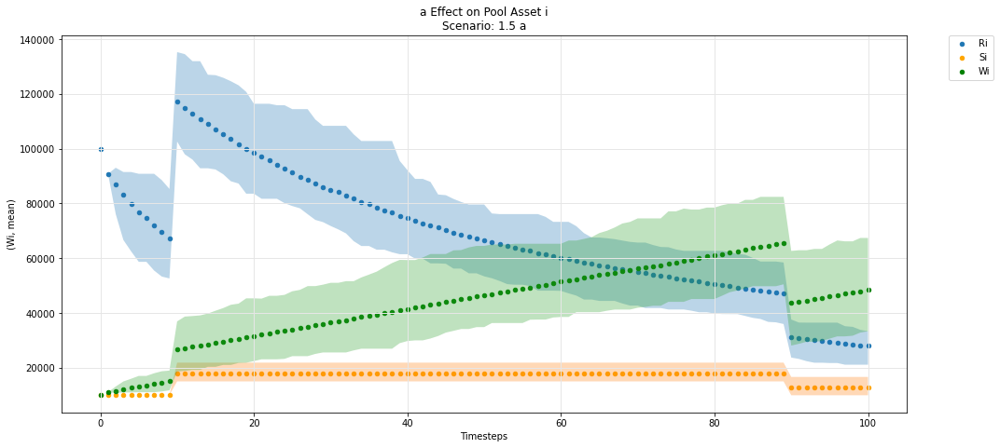

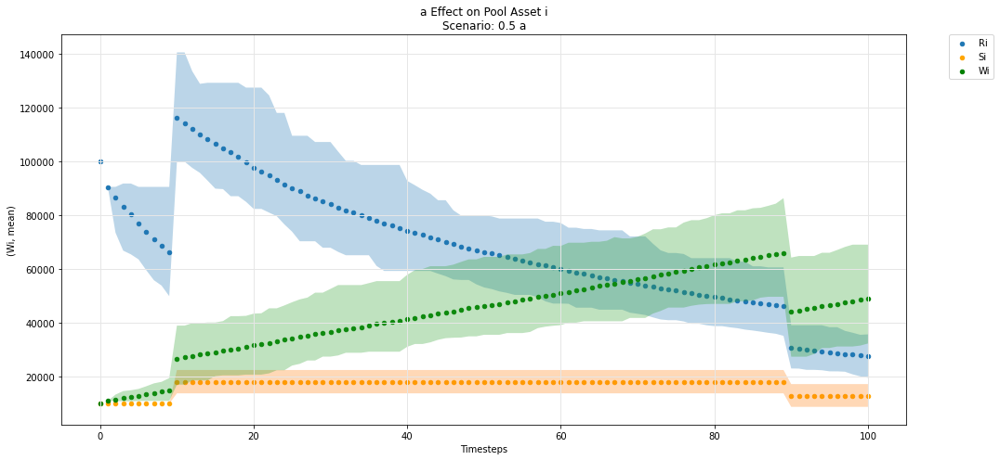

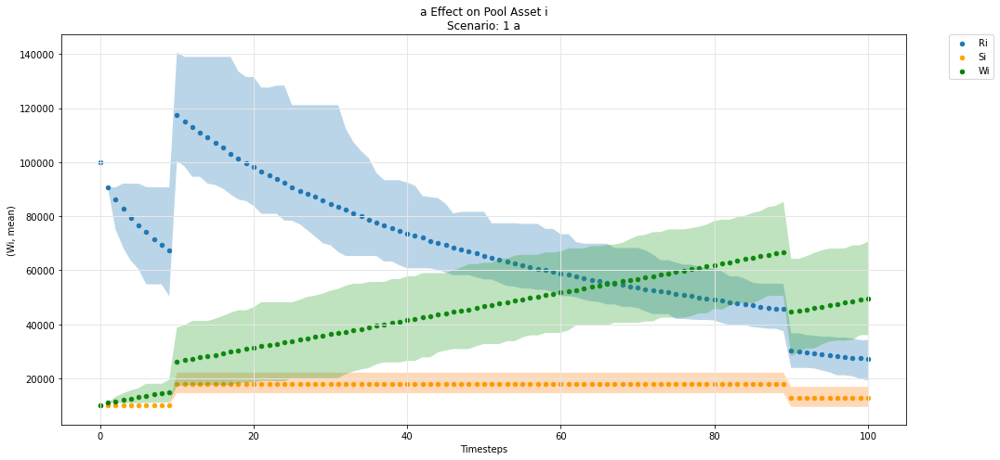

In [57]:
param_pool_simulation_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

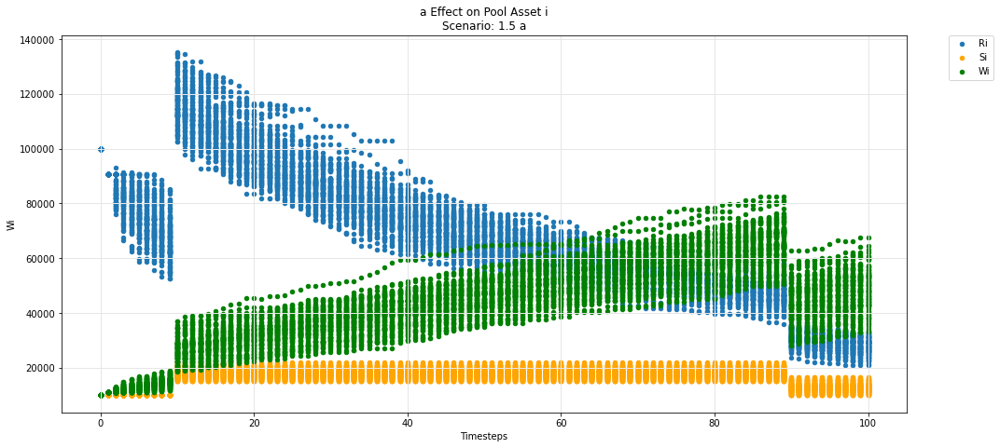

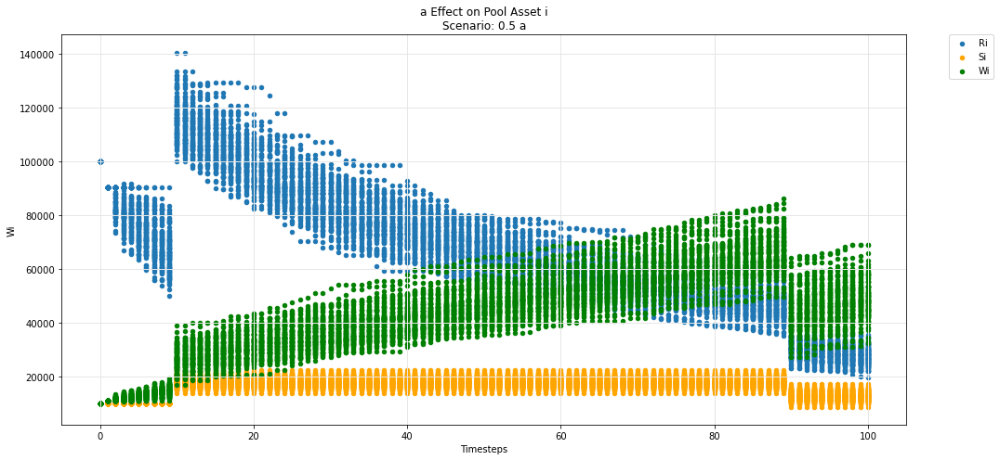

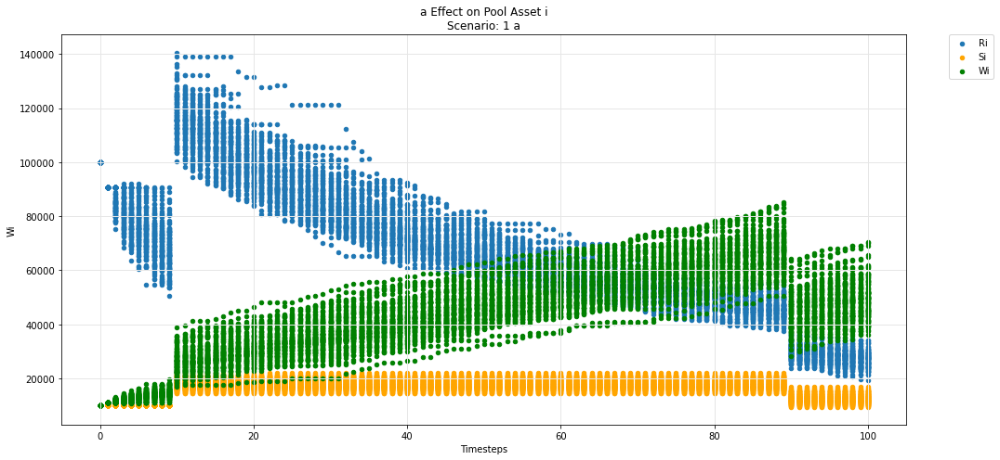

In [58]:
param_pool_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

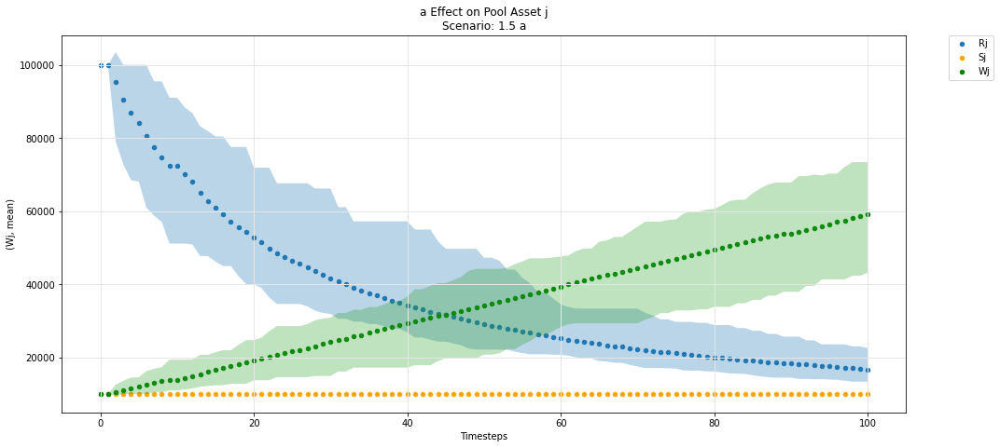

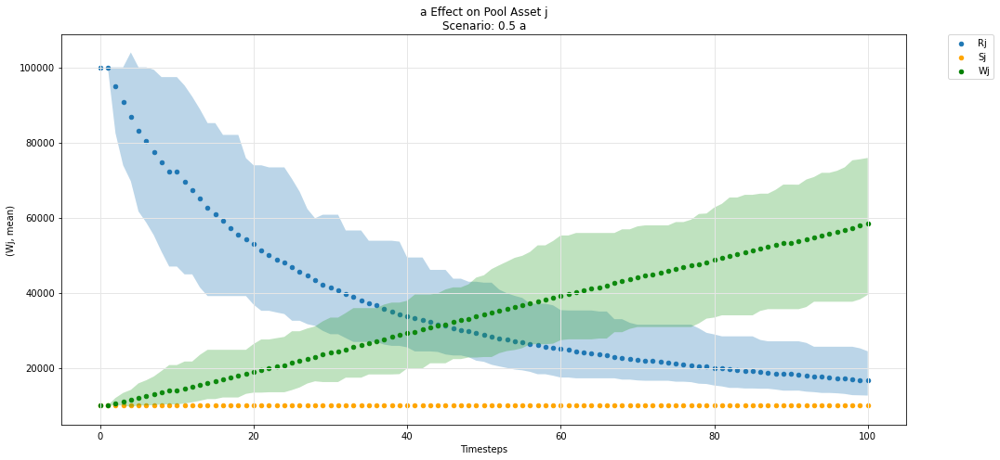

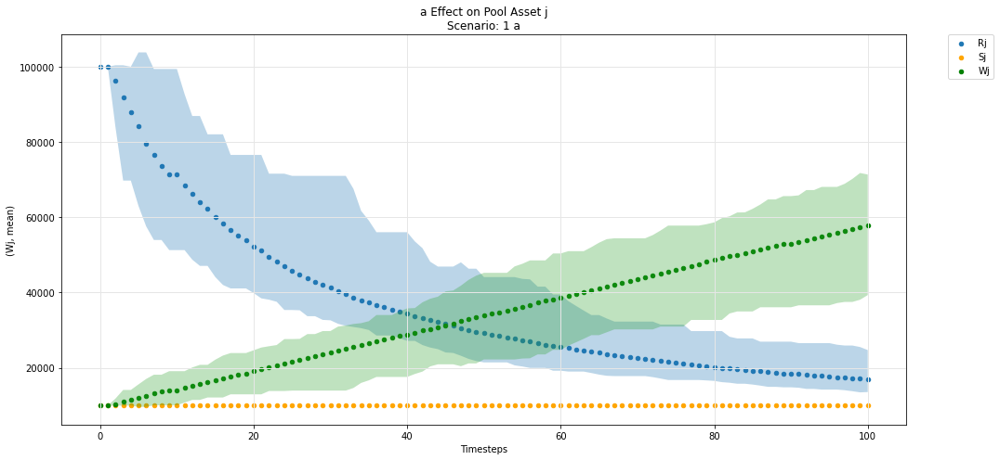

In [59]:
param_pool_simulation_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

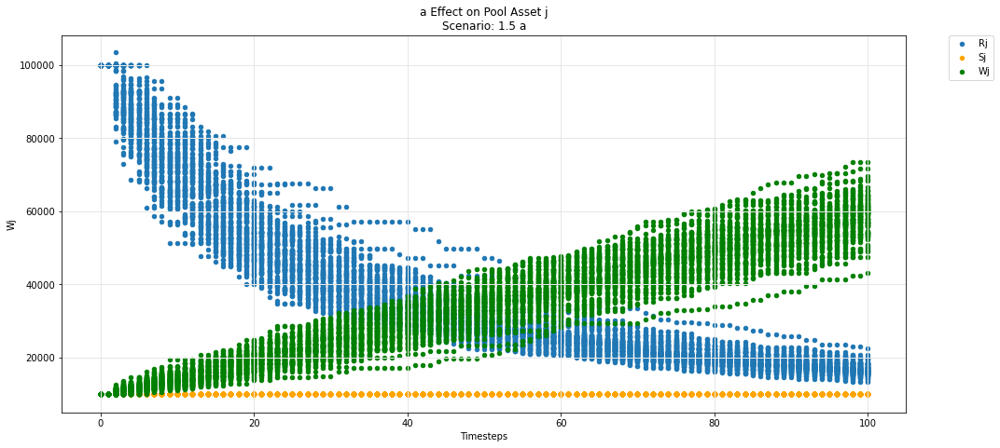

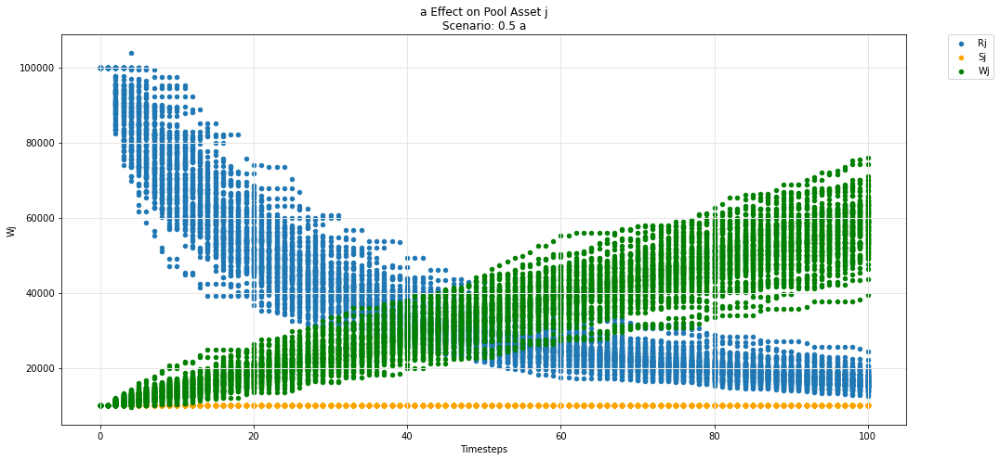

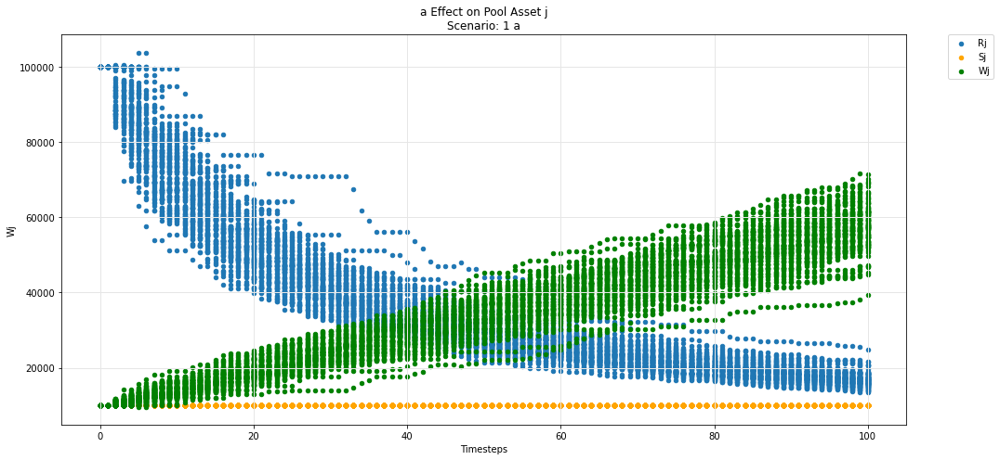

In [60]:
param_pool_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

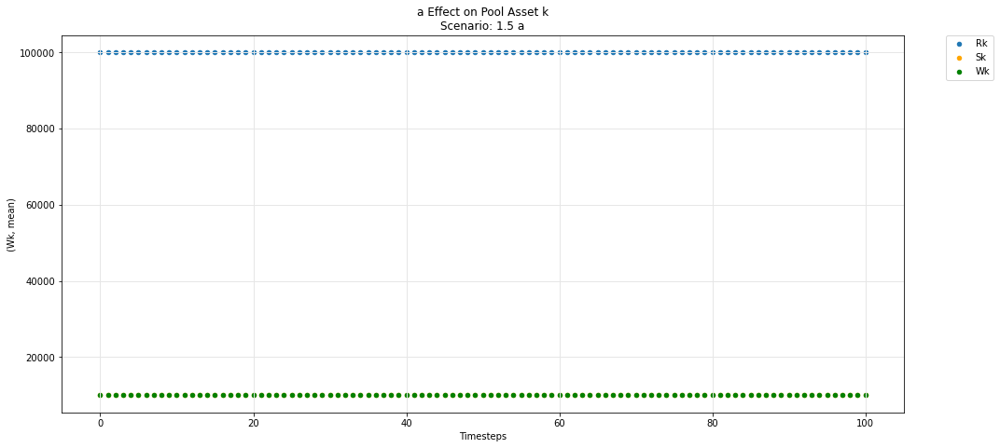

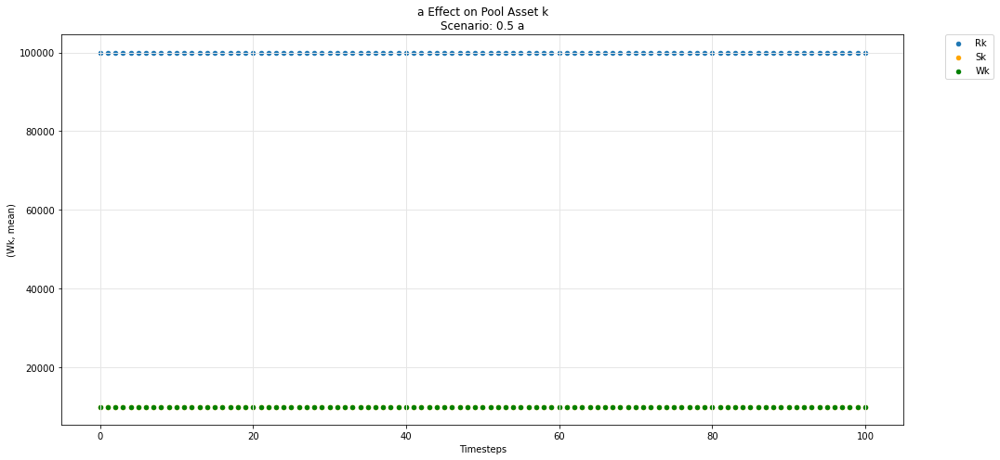

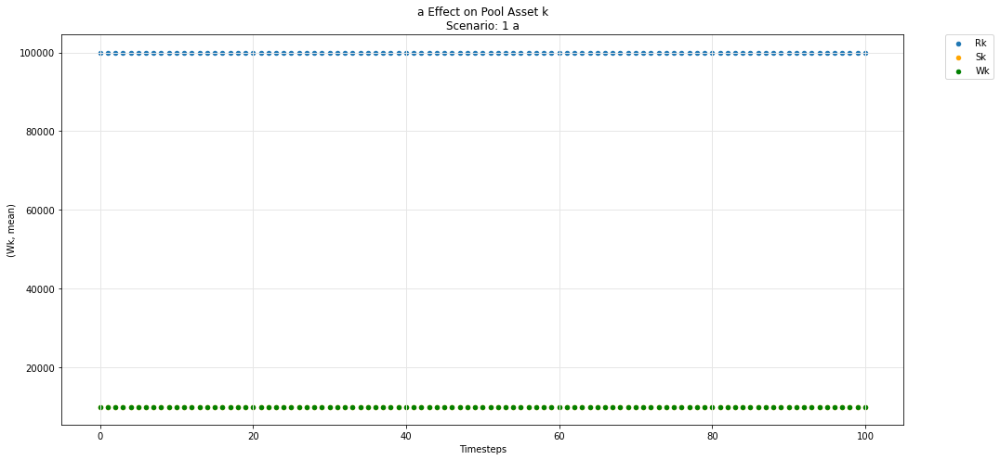

In [61]:
param_pool_simulation_plot(experiments, config_ids, 'a','k', 'R', 'S', 'W')

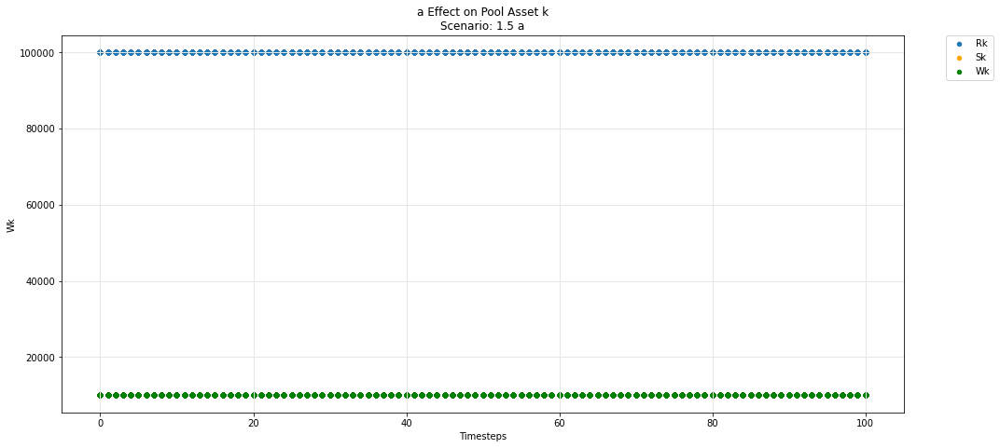

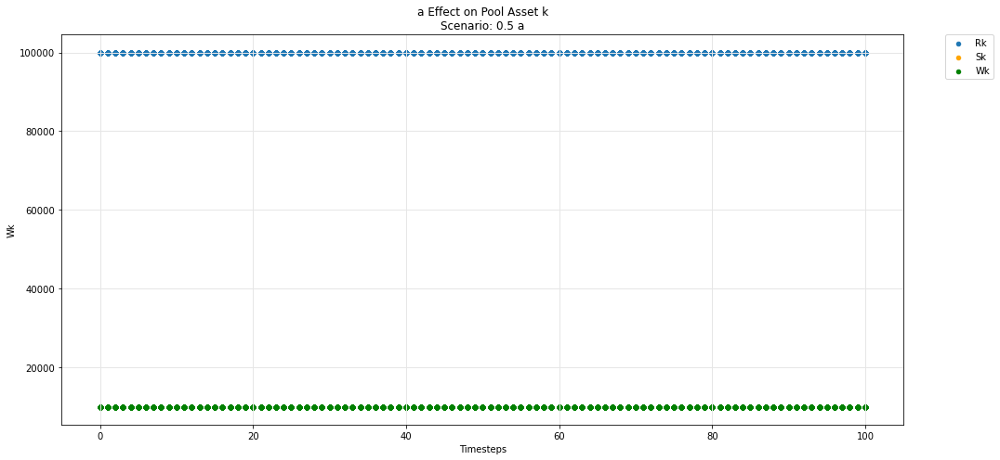

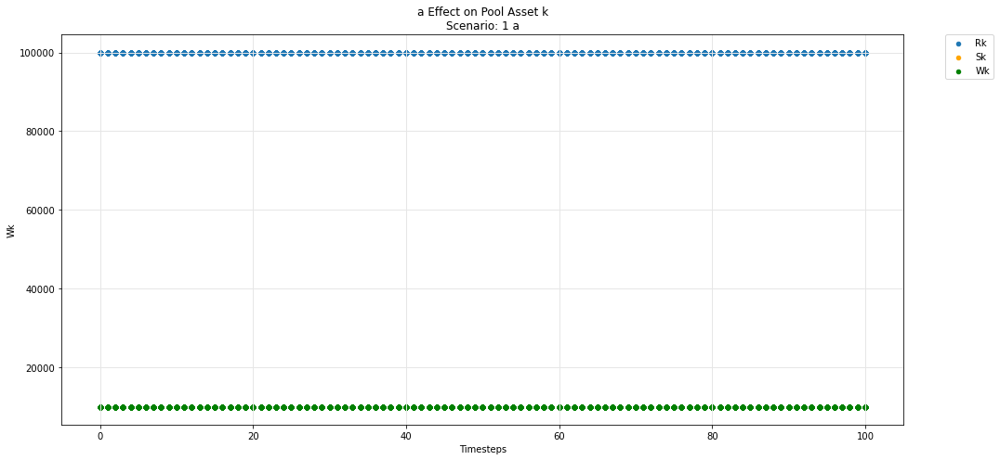

In [62]:
param_pool_plot(experiments, config_ids, 'a','k', 'R', 'S', 'W')

In [63]:
def param_pool_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=df_label, label=df_label, ax=ax, legend=True, kind ='scatter')

        for count, arg in enumerate(args):
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))

            df.plot(x='timestep', y=df_arg_label, label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

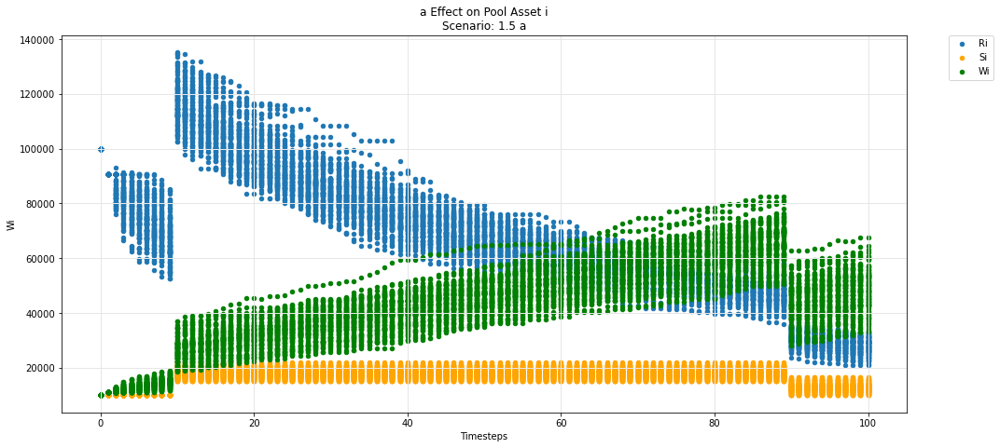

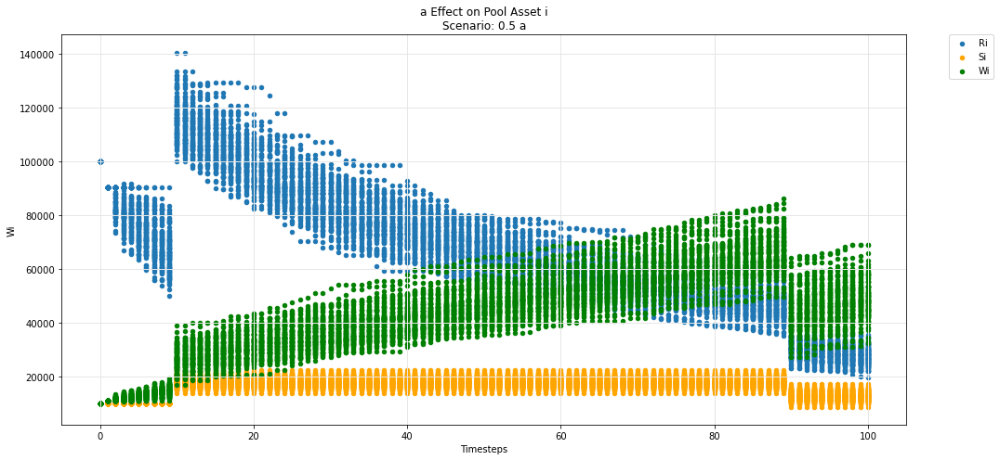

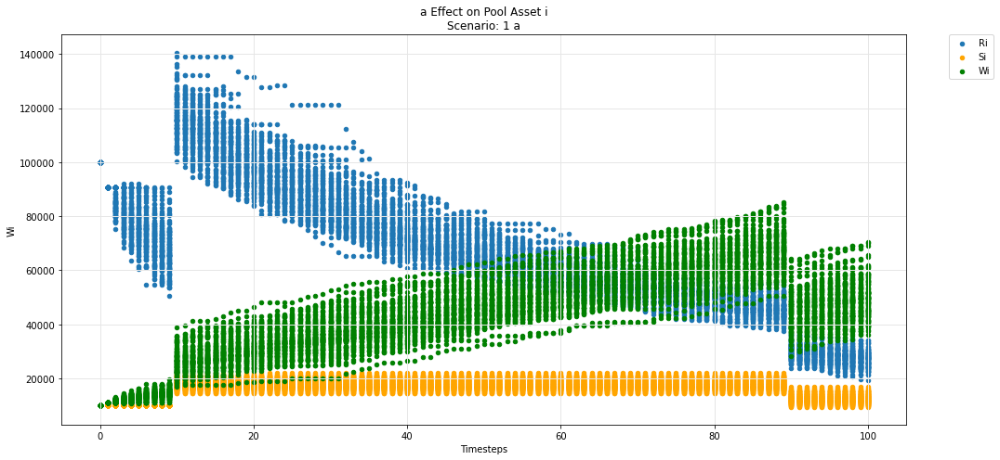

In [64]:
param_pool_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

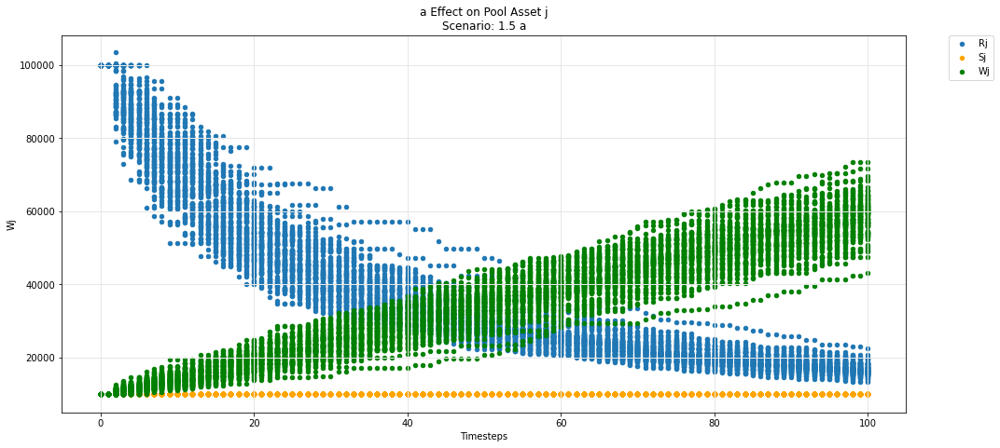

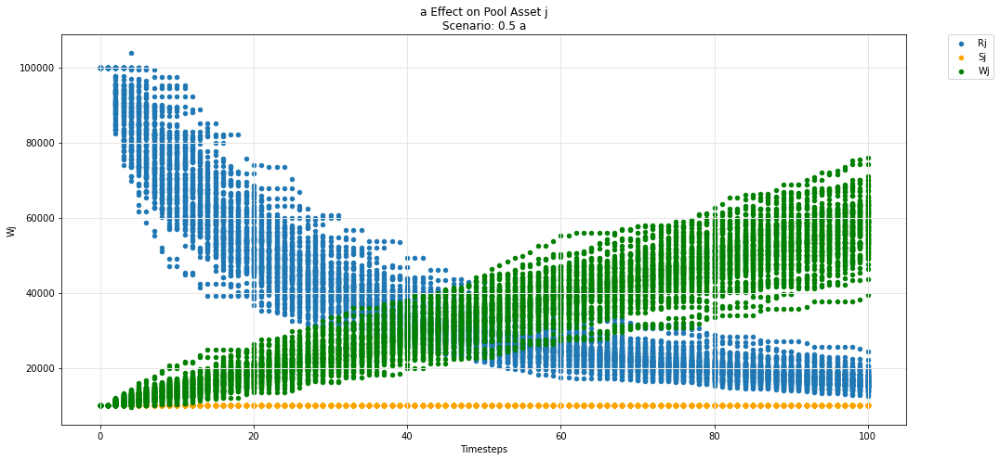

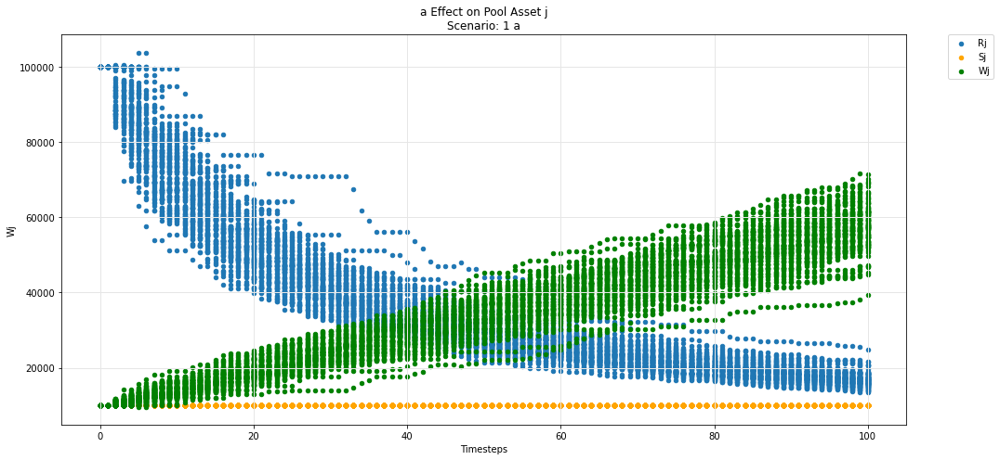

In [65]:
param_pool_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

In [66]:
def param_pool_simulation_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        df = df.groupby('timestep').agg({df_label: ['min', 'mean', 'max']}).reset_index()
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=(df_label,'mean'), label=df_label, ax=ax, legend=True, kind ='scatter')
        ax.fill_between(df.timestep, df[(df_label,'min')], df[(df_label,'max')], alpha=0.3)    
        for count, arg in enumerate(args):
            df = sub_experiments.copy()
            
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))
            df = df.groupby('timestep').agg({df_arg_label: ['min', 'mean', 'max']}).reset_index()

            df.plot(x='timestep', y=(df_arg_label,'mean'), label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')
            ax.fill_between(df.timestep, df[(df_arg_label,'min')], df[(df_arg_label,'max')], alpha=0.3)    

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

# Prices

## Uniswap

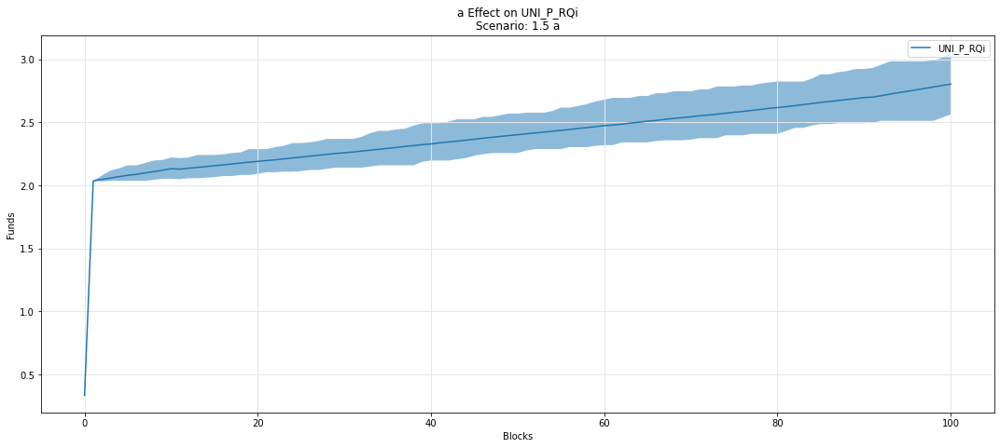

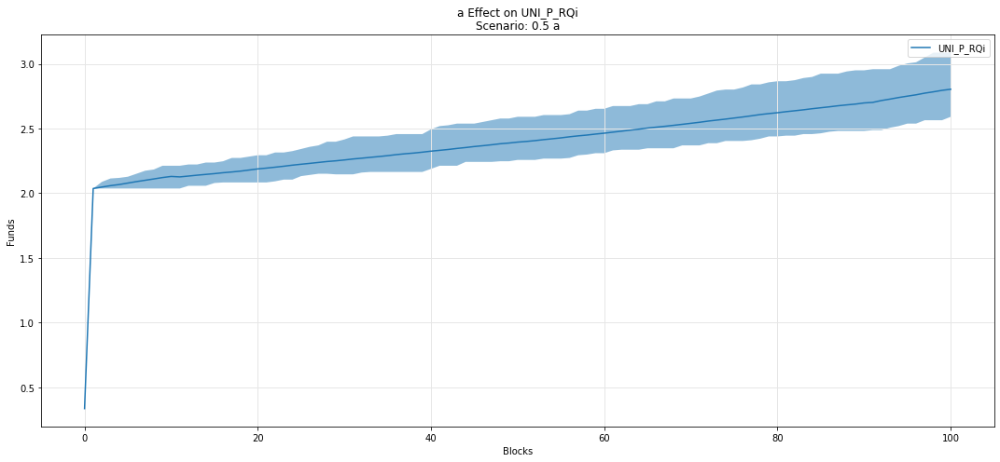

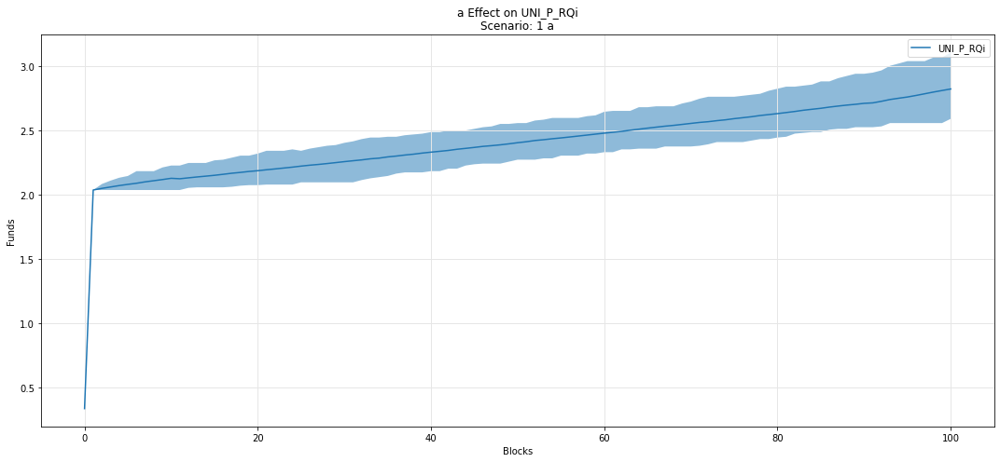

In [67]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_RQi')

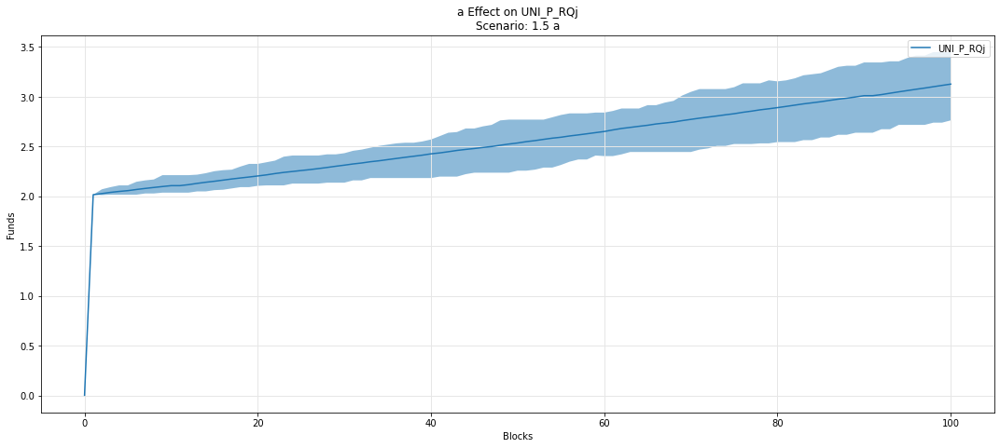

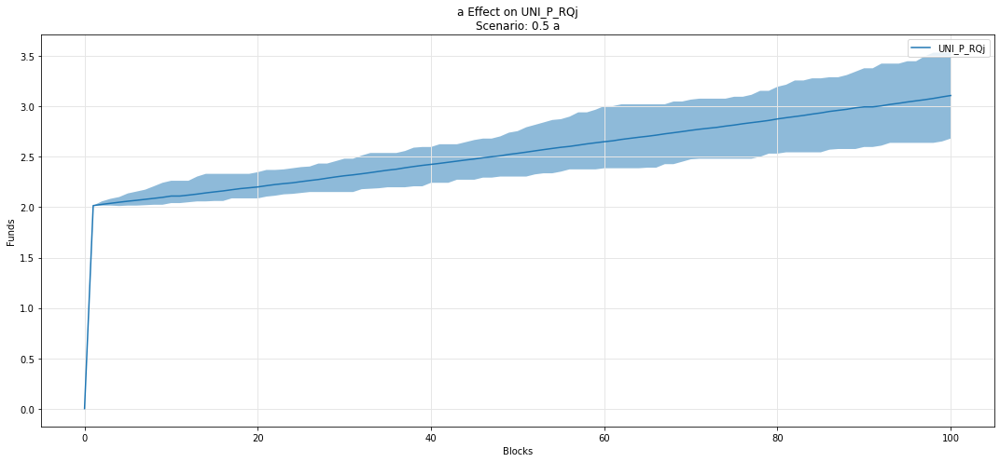

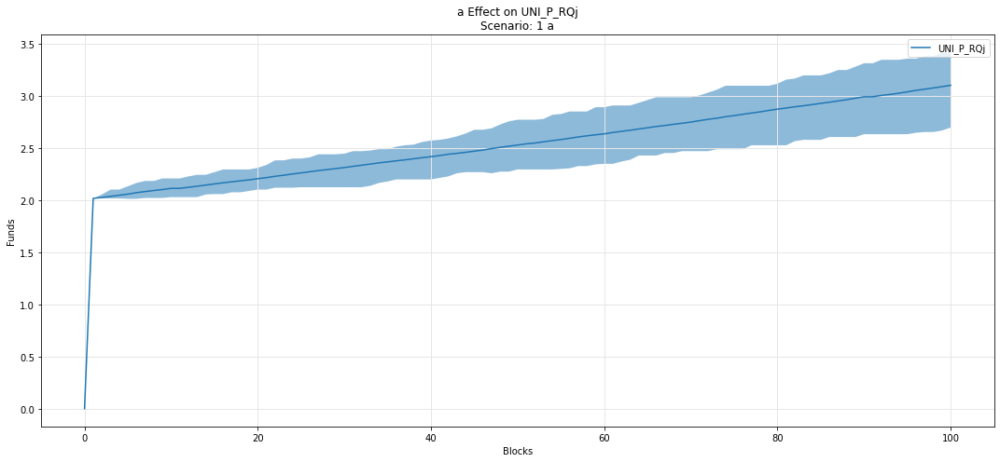

In [68]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_RQj')

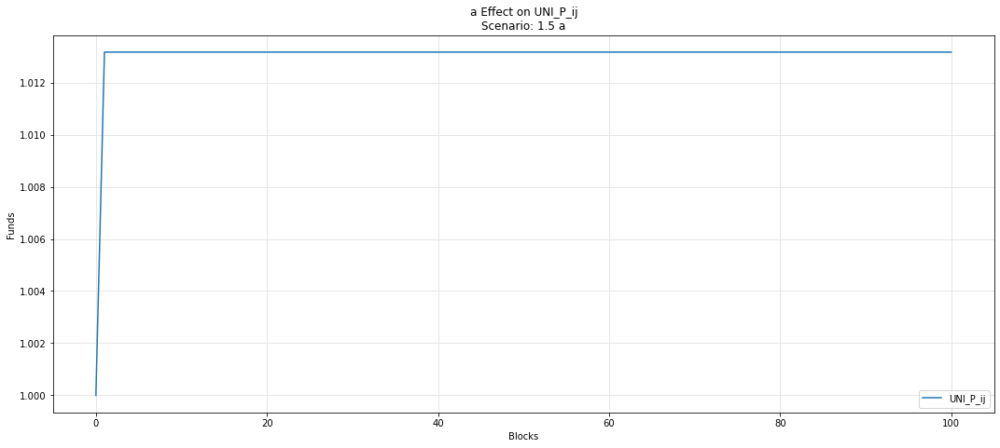

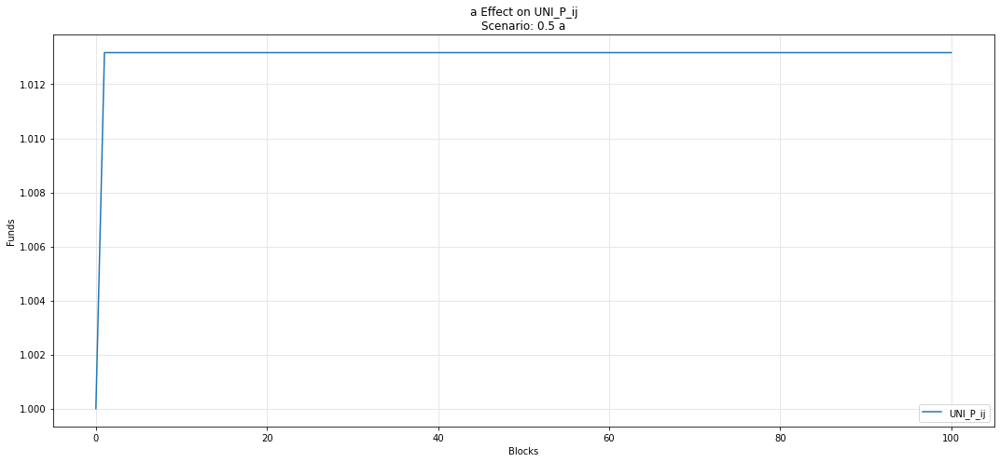

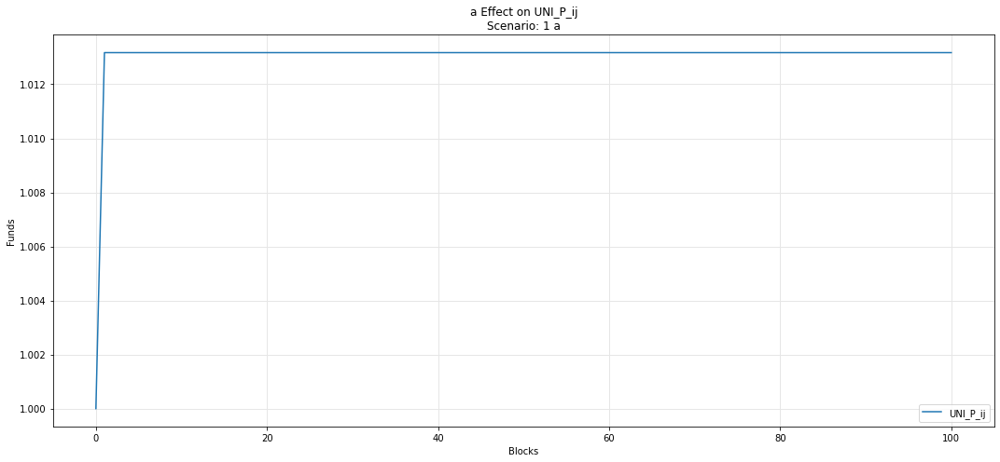

In [69]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_ij')

## Omnipool

## Asset i

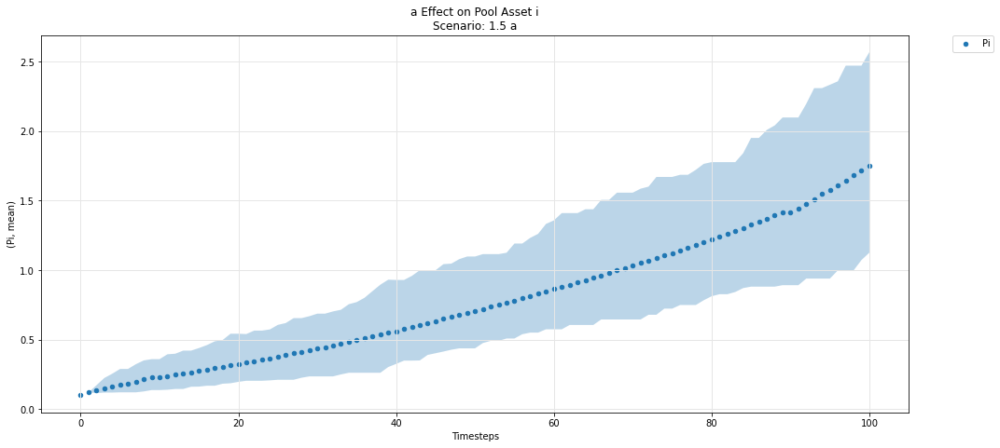

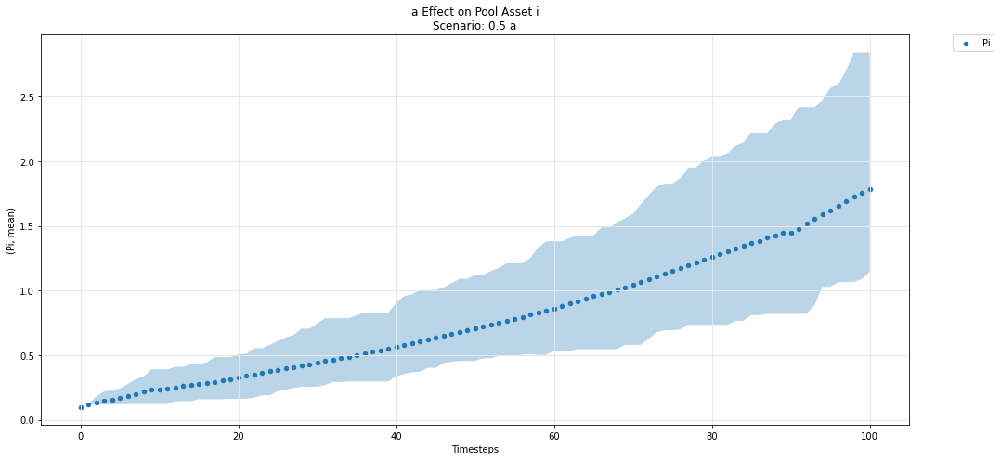

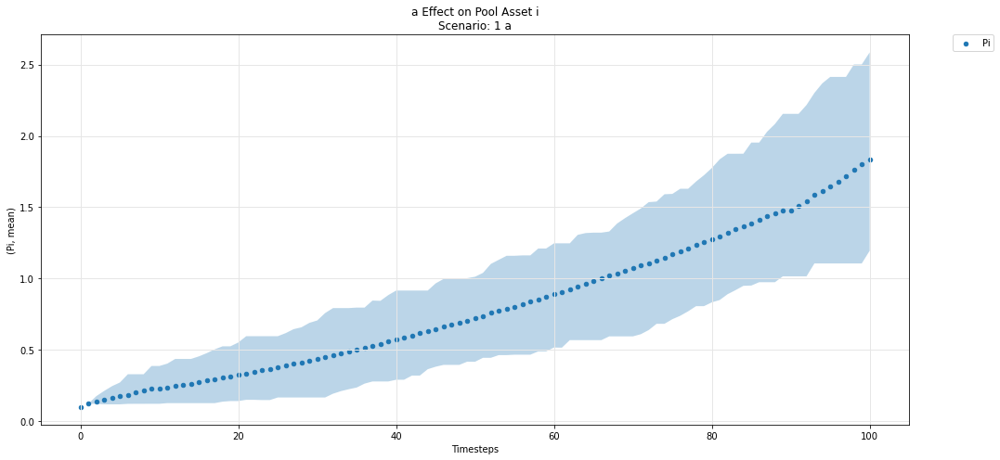

In [70]:
param_pool_simulation_plot(experiments, config_ids, 'a','i','P')

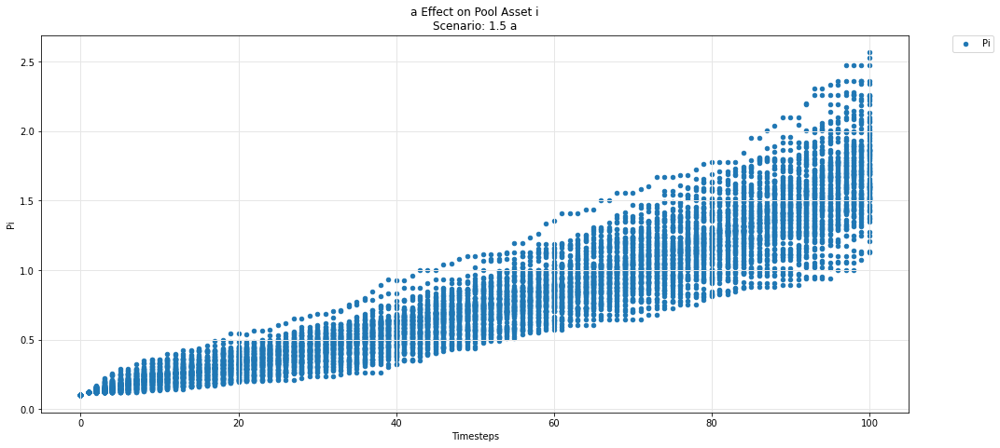

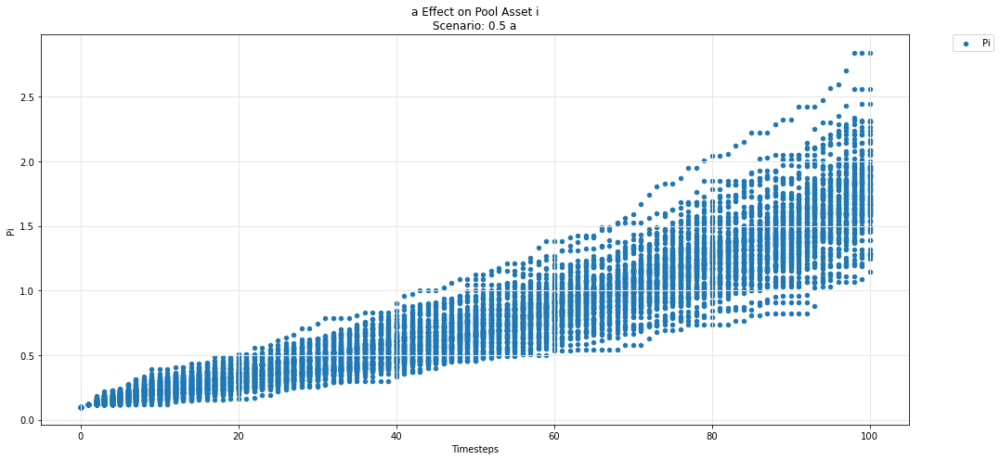

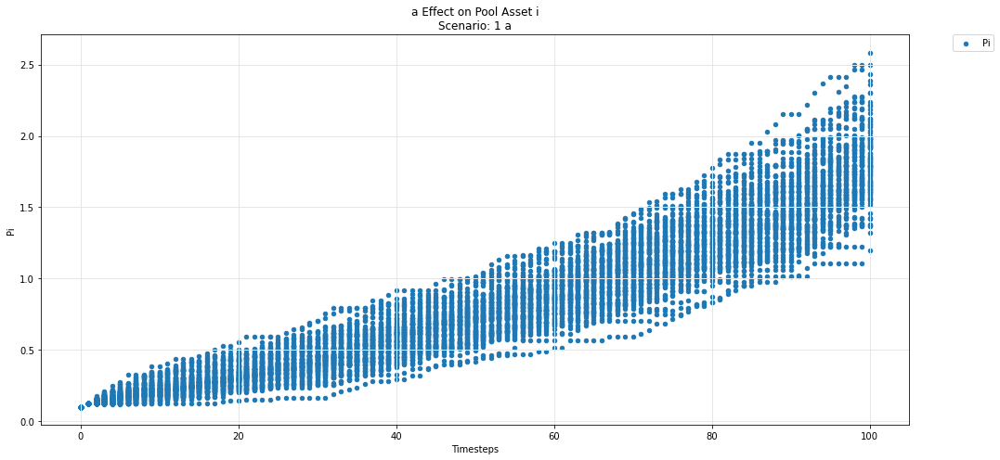

In [71]:
param_pool_plot(experiments, config_ids, 'a','i','P')

## Asset j

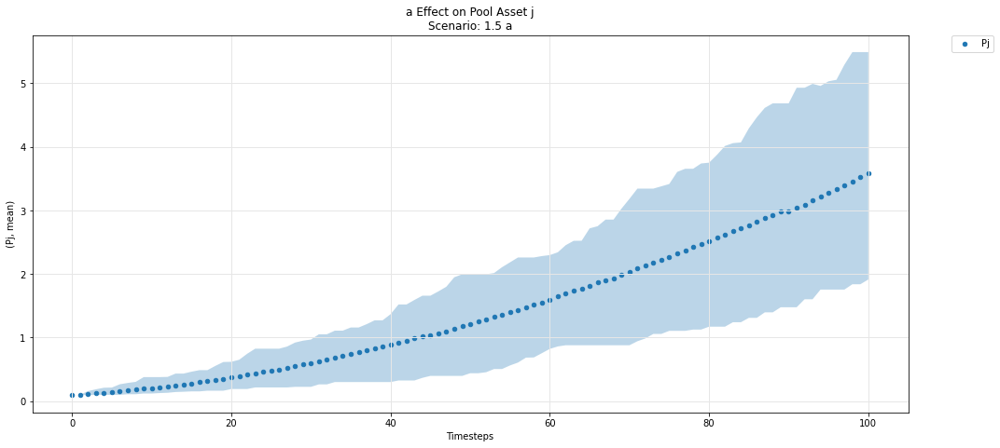

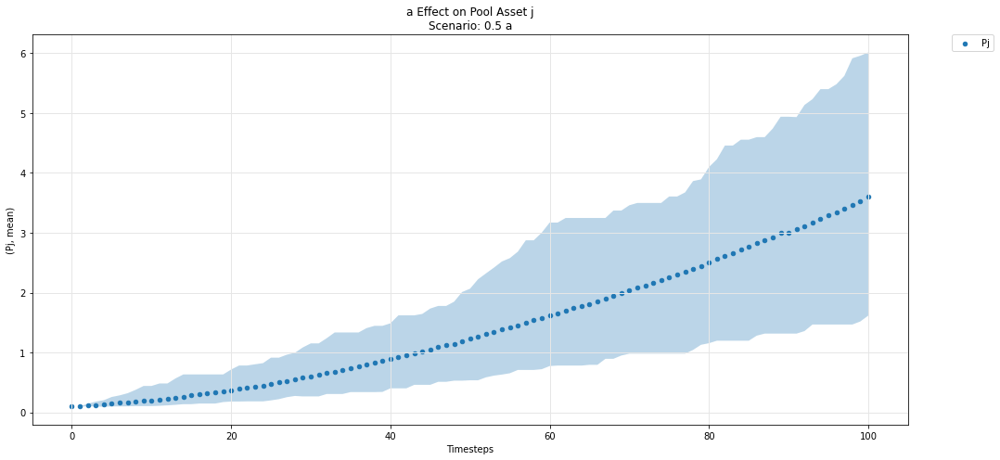

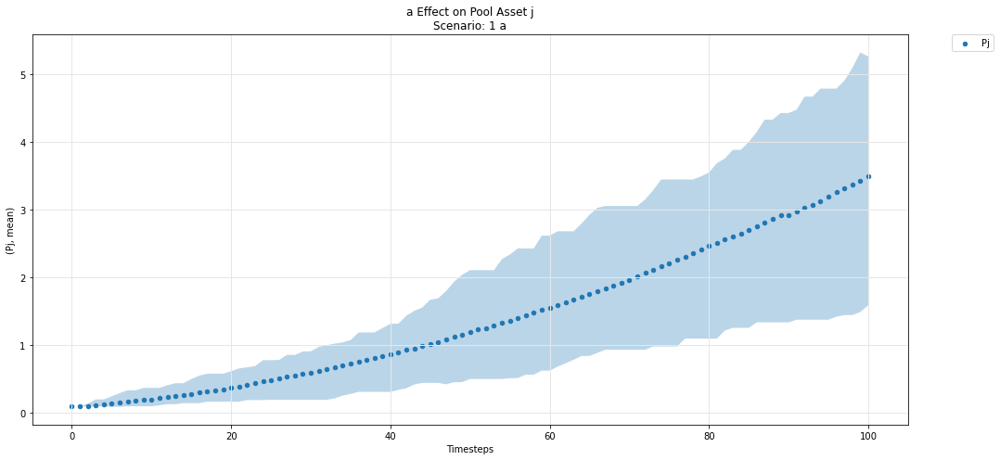

In [72]:
param_pool_simulation_plot(experiments, config_ids, 'a','j','P')

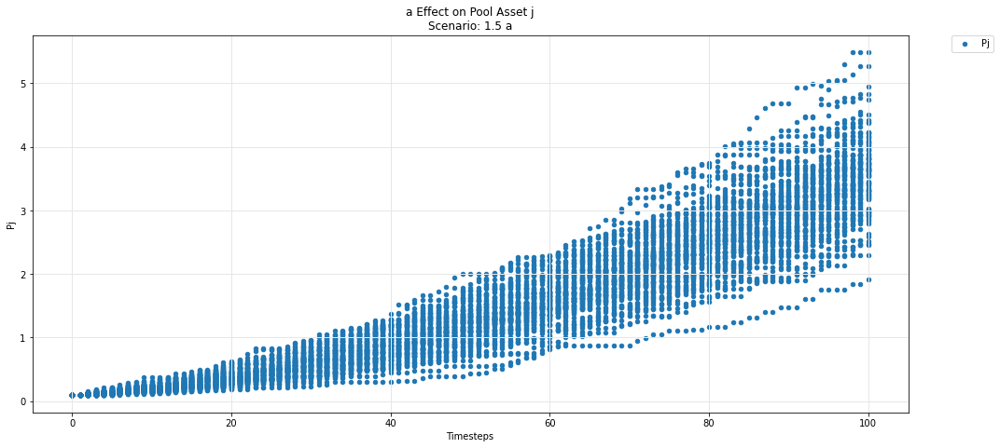

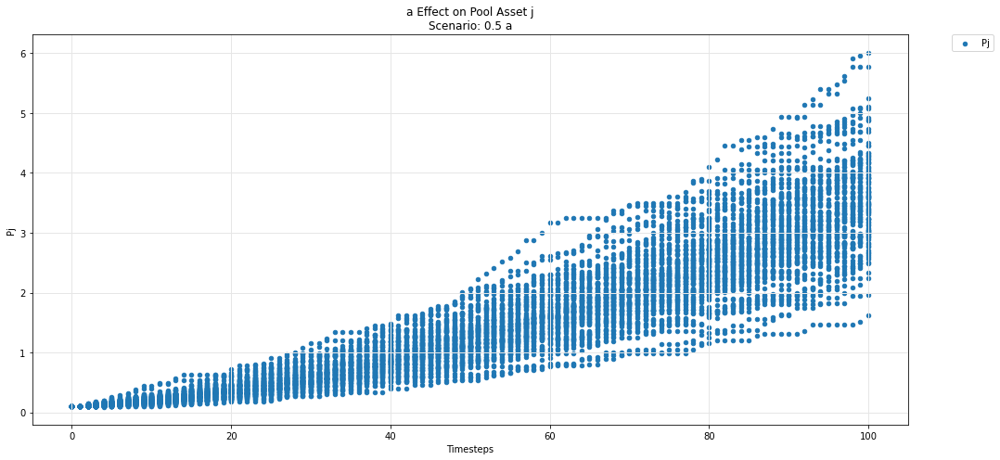

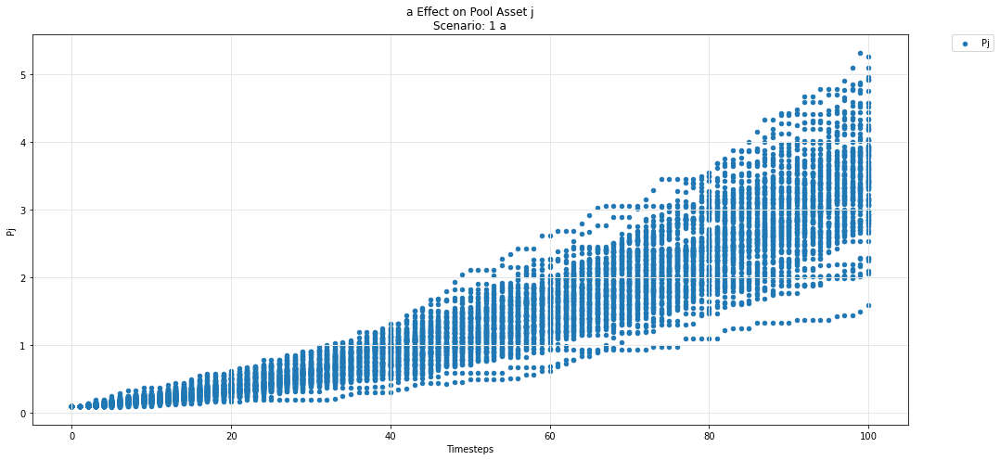

In [73]:
param_pool_plot(experiments, config_ids, 'a','j','P')

## Asset k

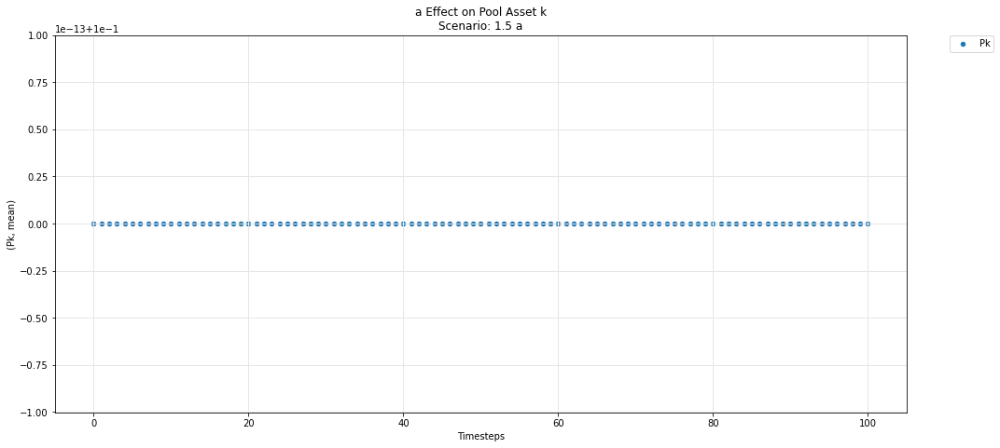

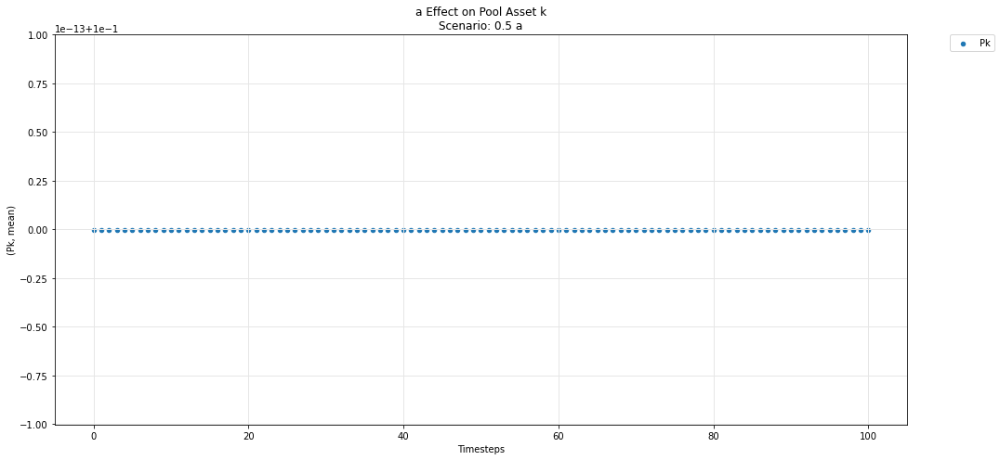

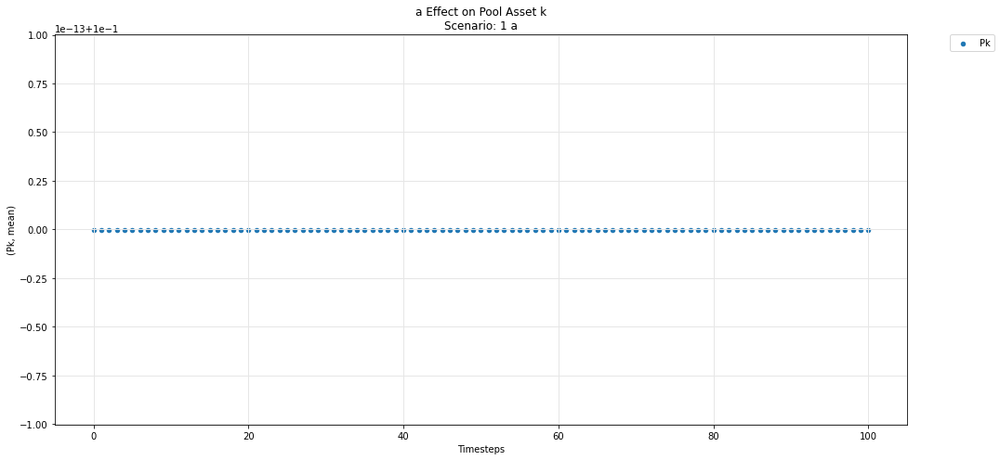

In [74]:
param_pool_simulation_plot(experiments, config_ids, 'a','k','P')

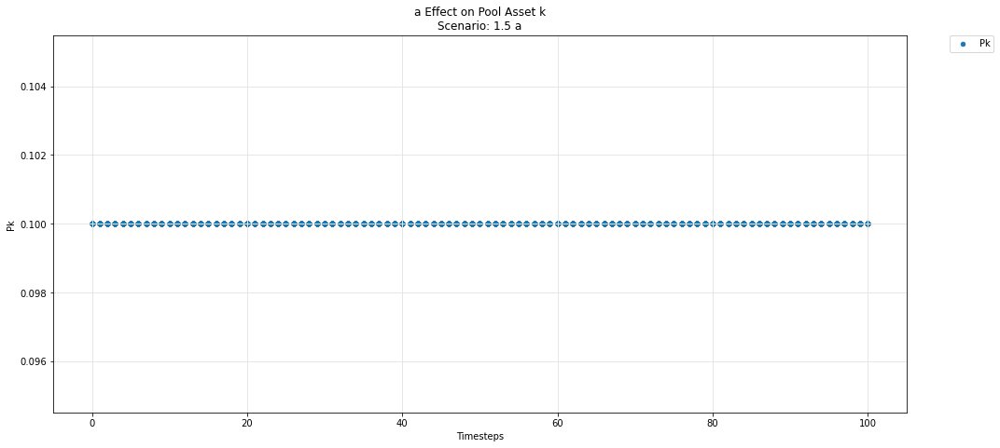

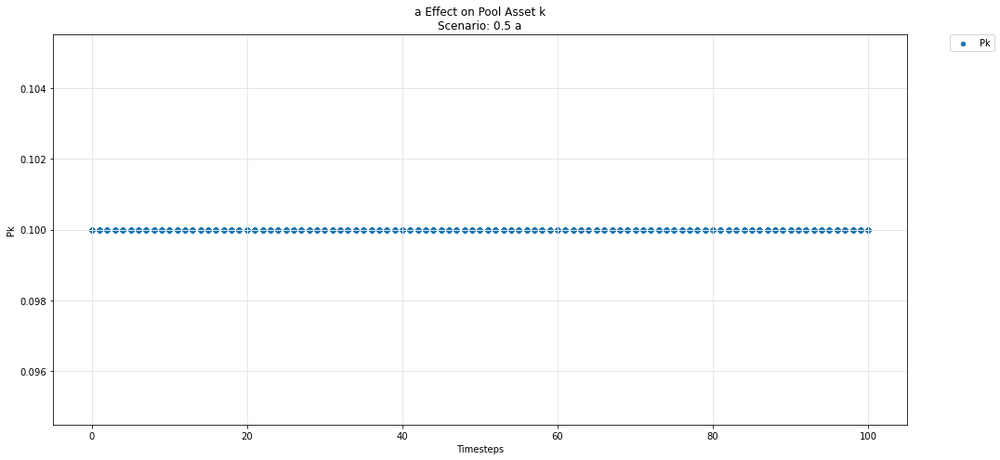

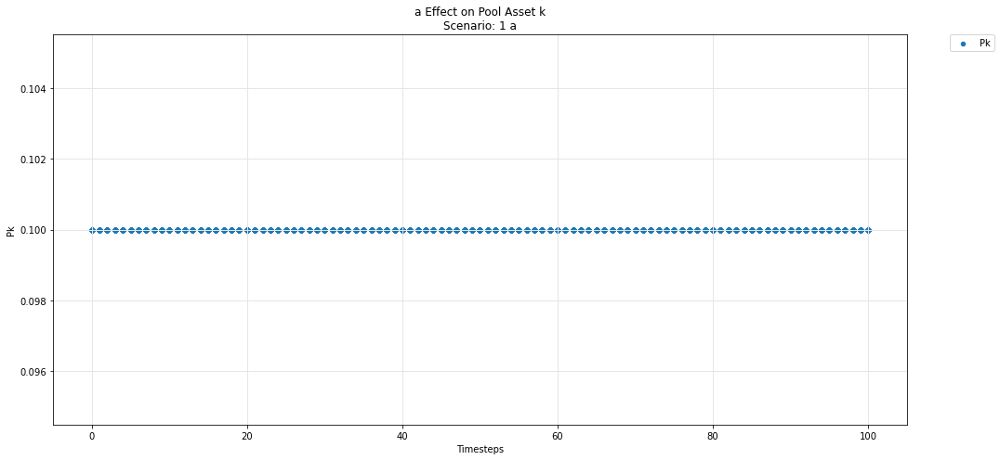

In [75]:
param_pool_plot(experiments, config_ids, 'a','k','P')